<center><h1> Relaxation time analysis from MD simulations </h1> </center>

In [5]:
"""Jupyter Notebook for relaxation time analysis"""
#The main analysis parts adapted from script by  H. Antila, with help from S. Ollila and T. Ferreira
#saved in relaxation_times.py
# Last modified by R. Nencini, 19.10.2021




import sys


sys.path.append("/home/nenciric/Documents/git/NMR_FF_tools/relaxation_times/")

import numpy as np
from scipy import optimize
import relaxation_times as rt
import matplotlib.pyplot as plt
import os
import re
#from numba import jit #

#gyromagnetic ratios for further developmant
# !!! NOTICE!!!
#values taken from matlab code and projecct work and slightly different than those in Wikipedia
#these values are also in the external file --> if change is needed; has to be changed there
#values here in jupyter just for the information and verify, why they are different
#!!! NOTICE END !!!
gammaD=41.695*10**6; #r*s^(-1)*T^(-1)
gammaH=267.513*10**6;
gammaC=67.262*10**6;
gammaN=-27.166*10**6;

<h3> 1) Create README.yaml file </h3>

Code exists and will be soon implemented for this particular case <br>
a special attention is put on extra xtc file that is used for correlation function calculation

In [6]:
import sys
sys.path.insert(1, '/home/nenciric/Documents/git/charged_molecules_binding/simulations_list/')

import AnalysisToolbox as AT

from datetime import date
today = date.today()

import fnmatch


#folder_path="/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/new_replicas/"
#systems=["hMff"]


folder_path="/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/GWALP_dimers/"
systems=["Gwalp"]


#folder_path="/DATA/hector/200POPC_PN_NAs150mM/"
#systems=["PN_m"]


import sys
import numpy as np
import MDAnalysis as mda
import matplotlib.pyplot as plt
import os
import fnmatch
import yaml
import gc
import math
import warnings
import re
import time

In [17]:




for file in os.listdir(folder_path):
    input_corr_file = folder_path+os.fsdecode(file)
    for system in systems:
        if fnmatch.fnmatch(os.fsdecode(file), "*"+system+"*"):
            newcomer=AT.AnalysisToolbox(folder_path,os.fsdecode(file),system,["BOX_DIMENSIONS"])
            #newcomer=AT.AnalysisToolbox(folder_path,os.fsdecode(file),"etidocaine",["ORDER_PARAMETER","BOX_DIMENSIONS"])
            alku = time.time()
            newcomer.add_new_folders()
            loppu = time.time()
            print("aikaa kului", loppu-alku, "s")
            #newcomer.analysis_module()

non-Water_6_Gwalp_dimer_60SDS_micelle_37C_CHARMM_OPC_mahti.xtc
none
6_Gwalp_dimer_60SDS_micelle_37C_CHARMM_OPC_mahti.tpr
none
none
none
6_Gwalp_dimer_60SDS_micelle_37C_CHARMM_OPC_mahti.gro
none
none
Checking for new trajectories within defiened conditions is succesfully finished
/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/GWALP_dimers/
Exporting information with gmx dump


                       :-) GROMACS - gmx dump, 2021.5 (-:

                            GROMACS is written by:
     Andrey Alekseenko              Emile Apol              Rossen Apostolov     
         Paul Bauer           Herman J.C. Berendsen           Par Bjelkmar       
       Christian Blau           Viacheslav Bolnykh             Kevin Boyd        
     Aldert van Buuren           Rudi van Drunen             Anton Feenstra      
    Gilles Gouaillardet             Alan Gray               Gerrit Groenhof      
       Anca Hamuraru            Vincent Hindriksen          M. Eric Irrgang      
      Aleksei Iupinov           Christoph Junghans             Joe Jordan        
    Dimitrios Karkoulis            Peter Kasson                Jiri Kraus        
      Carsten Kutzner              Per Larsson              Justin A. Lemkul     
       Viveca Lindahl            Magnus Lundborg             Erik Marklund       
        Pascal Merz             Pieter Meulenhoff            Teemu Mur

great success!!!
aikaa kului 0.6759748458862305 s
non-Water_9_Gwalp_dimer_40SDS_micelle_37C_CHARMM_OPC_solvated_Neut_local_run_20ps_mahti.xtc
none
9_Gwalp_dimer_40SDS_micelle_37C_CHARMM_OPC_solvated_Neut_local_run_20ps_mahti.tpr
none
none
index_N_HN.ndx
9_Gwalp_dimer_40SDS_micelle_37C_CHARMM_OPC_solvated_Neut_local_run_20ps_mahti.gro
none
none
Checking for new trajectories within defiened conditions is succesfully finished
/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/GWALP_dimers/
Exporting information with gmx dump



GROMACS reminds you: "You Could Make More Money As a Butcher" (F. Zappa)

                       :-) GROMACS - gmx dump, 2021.5 (-:

                            GROMACS is written by:
     Andrey Alekseenko              Emile Apol              Rossen Apostolov     
         Paul Bauer           Herman J.C. Berendsen           Par Bjelkmar       
       Christian Blau           Viacheslav Bolnykh             Kevin Boyd        
     Aldert van Buuren           Rudi van Drunen             Anton Feenstra      
    Gilles Gouaillardet             Alan Gray               Gerrit Groenhof      
       Anca Hamuraru            Vincent Hindriksen          M. Eric Irrgang      
      Aleksei Iupinov           Christoph Junghans             Joe Jordan        
    Dimitrios Karkoulis            Peter Kasson                Jiri Kraus        
      Carsten Kutzner              Per Larsson              Justin A. Lemkul     
       Viveca Lindahl            Magnus Lundborg             Erik Marklund   

great success!!!
aikaa kului 0.5565738677978516 s
non-Water_6_Gwalp_Dimer_70SDS_micelle_37C_CHARMM_OPC_mahti.xtc
none
6_Gwalp_Dimer_70SDS_micelle_37C_CHARMM_OPC_mahti.tpr
none
none
index_N_HN.ndx
6_Gwalp_Dimer_70SDS_micelle_37C_CHARMM_OPC_mahti.gro
none
none
Checking for new trajectories within defiened conditions is succesfully finished
/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/GWALP_dimers/
Exporting information with gmx dump



GROMACS reminds you: "Our struggle today is not to have a female Einstein get appointed as an assistant professor. It is for a woman schlemiel to get as quickly promoted as a male schlemiel." (Bella Abzug)

                       :-) GROMACS - gmx dump, 2021.5 (-:

                            GROMACS is written by:
     Andrey Alekseenko              Emile Apol              Rossen Apostolov     
         Paul Bauer           Herman J.C. Berendsen           Par Bjelkmar       
       Christian Blau           Viacheslav Bolnykh             Kevin Boyd        
     Aldert van Buuren           Rudi van Drunen             Anton Feenstra      
    Gilles Gouaillardet             Alan Gray               Gerrit Groenhof      
       Anca Hamuraru            Vincent Hindriksen          M. Eric Irrgang      
      Aleksei Iupinov           Christoph Junghans             Joe Jordan        
    Dimitrios Karkoulis            Peter Kasson                Jiri Kraus        
      Carsten Kutzner     

great success!!!
aikaa kului 0.5612056255340576 s
non-Water_6_Gwalp_Dimer_70SDS_micelle_37C_CHARMM_OPC_mahti.xtc
none
6_Gwalp_Dimer_70SDS_micelle_37C_CHARMM_OPC_mahti.tpr
none
none
index_N_HN.ndx
6_Gwalp_Dimer_70SDS_micelle_37C_CHARMM_OPC_mahti.gro
none
none
Checking for new trajectories within defiened conditions is succesfully finished
/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/GWALP_dimers/
Exporting information with gmx dump



GROMACS reminds you: "Our struggle today is not to have a female Einstein get appointed as an assistant professor. It is for a woman schlemiel to get as quickly promoted as a male schlemiel." (Bella Abzug)

                       :-) GROMACS - gmx dump, 2021.5 (-:

                            GROMACS is written by:
     Andrey Alekseenko              Emile Apol              Rossen Apostolov     
         Paul Bauer           Herman J.C. Berendsen           Par Bjelkmar       
       Christian Blau           Viacheslav Bolnykh             Kevin Boyd        
     Aldert van Buuren           Rudi van Drunen             Anton Feenstra      
    Gilles Gouaillardet             Alan Gray               Gerrit Groenhof      
       Anca Hamuraru            Vincent Hindriksen          M. Eric Irrgang      
      Aleksei Iupinov           Christoph Junghans             Joe Jordan        
    Dimitrios Karkoulis            Peter Kasson                Jiri Kraus        
      Carsten Kutzner     

great success!!!
aikaa kului 0.5601658821105957 s
non-Water_8_Gwalp_dimer_50SDS_micelle_37C_CHARMM_OPC_solvated_Neut_local_run_20ps_mahti.xtc
none
8_Gwalp_dimer_50SDS_micelle_37C_CHARMM_OPC_solvated_Neut_local_run_20ps_mahti.tpr
none
none
index_N_HN.ndx
8_Gwalp_dimer_50SDS_micelle_37C_CHARMM_OPC_solvated_Neut_local_run_20ps_mahti.gro
none
none
Checking for new trajectories within defiened conditions is succesfully finished
/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/GWALP_dimers/
Exporting information with gmx dump



GROMACS reminds you: "Computers are incredibly fast, accurate and stupid. Humans are incredibly slow, inaccurate and... also stupid." (Anonymous)



great success!!!
aikaa kului 0.6137778759002686 s
non-Water_9_Gwalp_dimer_45SDS_micelle_37C_CHARMM_OPC_solvated_Neut_local_run_10ps_mahti.xtc
none
9_Gwalp_dimer_45SDS_micelle_37C_CHARMM_OPC_solvated_Neut_local_run_10ps_mahti.tpr
none
none
none
9_Gwalp_dimer_45SDS_micelle_37C_CHARMM_OPC_solvated_Neut_local_run_10ps_mahti.gro
none
none
The topology and XTC trajectory files don't have the same number of atoms!
Topology number of atoms 97859
Trajectory: /media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/GWALP_dimers/11_Gwalp_dimer_45SDS_37C_CHARMM_Na_Neut_OPC_Water_Model/non-Water_9_Gwalp_dimer_45SDS_micelle_37C_CHARMM_OPC_solvated_Neut_local_run_10ps_mahti.xtc Number of atoms 2619
gro or xtc do not exist in the folder, or they do not match
Checking for new trajectories within defiened conditions is succesfully finished
/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/GWALP_dimers/
Exporting information with gmx dump


                       :-) GROMACS - gmx dump, 2021.5 (-:

                            GROMACS is written by:
     Andrey Alekseenko              Emile Apol              Rossen Apostolov     
         Paul Bauer           Herman J.C. Berendsen           Par Bjelkmar       
       Christian Blau           Viacheslav Bolnykh             Kevin Boyd        
     Aldert van Buuren           Rudi van Drunen             Anton Feenstra      
    Gilles Gouaillardet             Alan Gray               Gerrit Groenhof      
       Anca Hamuraru            Vincent Hindriksen          M. Eric Irrgang      
      Aleksei Iupinov           Christoph Junghans             Joe Jordan        
    Dimitrios Karkoulis            Peter Kasson                Jiri Kraus        
      Carsten Kutzner              Per Larsson              Justin A. Lemkul     
       Viveca Lindahl            Magnus Lundborg             Erik Marklund       
        Pascal Merz             Pieter Meulenhoff            Teemu Mur

great success!!!
aikaa kului 1.074281930923462 s



GROMACS reminds you: "No One Could Foresee the End That Came So Fast" (Slayer)



In [16]:
fol=folder_path+"/11_Gwalp_dimer_45SDS_37C_CHARMM_Na_Neut_OPC_Water_Model/"
rt.remove_water(fol)

non-Water
non-Water
Selected 17: 'non-Water'


                   :-) GROMACS - gmx convert-tpr, 2021.5 (-:

                            GROMACS is written by:
     Andrey Alekseenko              Emile Apol              Rossen Apostolov     
         Paul Bauer           Herman J.C. Berendsen           Par Bjelkmar       
       Christian Blau           Viacheslav Bolnykh             Kevin Boyd        
     Aldert van Buuren           Rudi van Drunen             Anton Feenstra      
    Gilles Gouaillardet             Alan Gray               Gerrit Groenhof      
       Anca Hamuraru            Vincent Hindriksen          M. Eric Irrgang      
      Aleksei Iupinov           Christoph Junghans             Joe Jordan        
    Dimitrios Karkoulis            Peter Kasson                Jiri Kraus        
      Carsten Kutzner              Per Larsson              Justin A. Lemkul     
       Viveca Lindahl            Magnus Lundborg             Erik Marklund       
        Pascal Merz             Pieter Meulenhoff            Teemu 

Selected 17: 'non-Water'
Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for output
Selected 0: 'System'
Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for output
Selected 0: 'System'


Reading file /media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/GWALP_dimers//11_Gwalp_dimer_45SDS_37C_CHARMM_Na_Neut_OPC_Water_Model//non-Water_9_Gwalp_dimer_45SDS_micelle_37C_CHARMM_OPC_solvated_Neut_local_run_10ps_mahti.tpr, VERSION 2021.5 (single precision)
Group     0 (         System) has  2619 elements
Group     1 (        Protein) has   684 elements
Group     2 (      Protein-H) has   324 elements
Group     3 (        C-alpha) has    46 elements
Group     4 (       Backbone) has   138 elements
Group     5 (      MainChain) has   184 elements
Group     6 (   MainChain+Cb) has   224 elements
Group     7 (    MainChain+H) has   230 elements
Group     8 (      SideChain) has   454 elements
Group     9 (    SideChain-H) has   140 elements
Group    10 (    Prot-Masses) has   684 elements
Group    11 (    non-Protein) has  1935 elements
Group    12 (          Other) has  1935 elements
Group    13 (            SDS) has  1890 elements
Group    14 (            SOD) h

In [6]:
for file in os.listdir(folder_path):
    readme = folder_path+os.fsdecode(file)+"/README.yaml"
    with open(readme) as yaml_file:
        content = yaml.load(yaml_file, Loader=yaml.FullLoader)
        
    print("{} : {}".format(content["FILES"]["xtc"]["NAME"][:-4],content["FILES"]["xtc"]["LENGTH"]))
    try:
        print("     without water: ",content["FILES_FOR_RELAXATION"]["xtc"]["LENGTH"])
        for folder in content['ANALYSIS']['CORRELATION_FUNCTIONS']:
            print("         analyzed: ",content['ANALYSIS']['CORRELATION_FUNCTIONS'][folder]['ANALYZED'],
                 ", from xtc ", content['ANALYSIS']['CORRELATION_FUNCTIONS'][folder]['FROM_XTC'])
            print("         length",content['ANALYSIS']['CORRELATION_FUNCTIONS'][folder]['LENGTH'], " \n")
    except:
        pass
    


hMff_micelle_60SDS_CHARMM_310K_Na_Neut_OPC_replica2 : 3000010.0
     without water:  3000010.0
         analyzed:  2022-10-07 , from xtc  2022-10-06 17:26:59
         length 3000000  

hMff_micelle_45SDS_CHARMM_310K_Na_Neut_OPC_replica2 : 2782810.0
     without water:  3000010.0
hMff_micelle_50SDS_CHARMM_310K_Na_Neut_OPC_replica2 : 3000010.0
     without water:  3000010.0
         analyzed:  2022-10-18 , from xtc  2022-10-18 13:14:32
         length Problem at 8000  

hMff_micelle_60SDS_CHARMM_310K_Na_Neut_OPC_replica3 : 3000010.0
     without water:  3000010.0
         analyzed:  2022-10-18 , from xtc  2022-10-18 11:04:32
         length 3000000  

hMff_micelle_45SDS_CHARMM_310K_Na_Neut_OPC_replica3 : 3000010.0
     without water:  3000010.0
hMff_micelle_50SDS_CHARMM_310K_Na_Neut_OPC_replica3 : 2090180.0
hMff_micelle_40SDS_CHARMM_310K_Na_Neut_OPC_replica2 : 2531400.0
     without water:  3000010.0
hMff_micelle_40SDS_CHARMM_310K_Na_Neut_OPC_replica3 : 2776020.0
     without water:  300

In [8]:
files=["hMff_micelle_50SDS_CHARMM_310K_Na_Neut_OPC_replica3",
]


for file in files:
    folder_path="/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/new_replicas/"
    folder_path=folder_path+file
    readme = folder_path+"/README.yaml"
    rt.remove_water(readme,folder_path)



non-Water
non-Water


                   :-) GROMACS - gmx convert-tpr, 2021.5 (-:

                            GROMACS is written by:
     Andrey Alekseenko              Emile Apol              Rossen Apostolov     
         Paul Bauer           Herman J.C. Berendsen           Par Bjelkmar       
       Christian Blau           Viacheslav Bolnykh             Kevin Boyd        
     Aldert van Buuren           Rudi van Drunen             Anton Feenstra      
    Gilles Gouaillardet             Alan Gray               Gerrit Groenhof      
       Anca Hamuraru            Vincent Hindriksen          M. Eric Irrgang      
      Aleksei Iupinov           Christoph Junghans             Joe Jordan        
    Dimitrios Karkoulis            Peter Kasson                Jiri Kraus        
      Carsten Kutzner              Per Larsson              Justin A. Lemkul     
       Viveca Lindahl            Magnus Lundborg             Erik Marklund       
        Pascal Merz             Pieter Meulenhoff            Teemu 

Selected 17: 'non-Water'
Selected 17: 'non-Water'


                     :-) GROMACS - gmx trjconv, 2021.5 (-:

                            GROMACS is written by:
     Andrey Alekseenko              Emile Apol              Rossen Apostolov     
         Paul Bauer           Herman J.C. Berendsen           Par Bjelkmar       
       Christian Blau           Viacheslav Bolnykh             Kevin Boyd        
     Aldert van Buuren           Rudi van Drunen             Anton Feenstra      
    Gilles Gouaillardet             Alan Gray               Gerrit Groenhof      
       Anca Hamuraru            Vincent Hindriksen          M. Eric Irrgang      
      Aleksei Iupinov           Christoph Junghans             Joe Jordan        
    Dimitrios Karkoulis            Peter Kasson                Jiri Kraus        
      Carsten Kutzner              Per Larsson              Justin A. Lemkul     
       Viveca Lindahl            Magnus Lundborg             Erik Marklund       
        Pascal Merz             Pieter Meulenhoff            Teemu Mu

Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for output
Selected 17: 'non-Water'
Note that major changes are planned in future for trjconv, to improve usability and utility.
Select group for output
Selected 17: 'non-Water'


Group     0 (         System) has 160300 elements
Group     1 (          Other) has  2147 elements
Group     2 (            SDS) has  2100 elements
Group     3 (            SOD) has    47 elements
Group     4 (        Protein) has   457 elements
Group     5 (      Protein-H) has   227 elements
Group     6 (        C-alpha) has    25 elements
Group     7 (       Backbone) has    75 elements
Group     8 (      MainChain) has    99 elements
Group     9 (   MainChain+Cb) has   124 elements
Group    10 (    MainChain+H) has   123 elements
Group    11 (      SideChain) has   334 elements
Group    12 (    SideChain-H) has   128 elements
Group    13 (    Prot-Masses) has   457 elements
Group    14 (    non-Protein) has 159843 elements
Group    15 (          Water) has 157696 elements
Group    16 (            SOL) has 157696 elements
Group    17 (      non-Water) has  2604 elements
Reading frame       0 time    0.000   
Precision of /media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPepti

<h3> 2) Calculate correlation functions </h3>
Code exists and will be soon implemented <br> 
Includes creation of ndx file and calling gromacs for corellation function analysis

In [10]:
def CalculateCorrelationFunctions(path,begin,end,RM_avail,atom1,atom2,moleculeType,grofile=None,xtcfile=None,tprfile=None):
    if RM_avail:
        readmeS = path+ "/README.yaml"
        with open(readmeS) as yaml_file:
            readme = yaml.load(yaml_file, Loader=yaml.FullLoader)
        grofile=readme["FILES_FOR_RELAXATION"]["gro"]["NAME"]
        xtcfile=readme["FILES_FOR_RELAXATION"]["xtc"]["NAME"]
        tprfile=readme["FILES_FOR_RELAXATION"]["tpr"]["NAME"]
    
    if end==-1:
        end=int(readme["FILES_FOR_RELAXATION"]["xtc"]["LENGTH"])
    
    if RM_avail:
        new_folder=readme["FILES"]["xtc"]["NAME"][:-4] + "_" + str(int(begin/1000)) + "_" + str(int(end/1000)) + "_" + str(atom1) + "_" + str(atom2)
    else:
        new_folder="corr_func"+ "_"  +   grofile[:-4] + "_" + str(int(begin/1000)) + "_" + str(int(end/1000)) + "_" + str(atom1) + "_" + str(atom2)
    
    
    
    grofile=path+grofile
    xtcfile=path+xtcfile
    tprfile=path+tprfile
    
    ##### MAKE NDX FILE #####
    if RM_avail:
        readme["FILES_FOR_RELAXATION"]["ndx_"+atom1+"_"+atom2]={}
        readme["FILES_FOR_RELAXATION"]["ndx_"+atom1+"_"+atom2]["NAME"]="index_"+atom1+"_"+atom2+".ndx"
        output_ndx=path+readme["FILES_FOR_RELAXATION"]["ndx_"+atom1+"_"+atom2]["NAME"]
    else:
        output_ndx="index_"+atom1+"_"+atom2+".ndx"
    
    if moleculeType=="Protein":    
        with open(grofile, 'rt') as gro_file:
            residue=""
            residues=0
            with open(output_ndx, 'w') as fo:
                for line in gro_file:
                    if 'Title' in line or len(line.split())==1 or len(line.split())==3:
                        pass
                    else:    
                    
                        if line.split()[1]==atom1:
                            residue=line.split()[0]
                            N=int(line.split()[2])
                        if line.split()[1]==atom2:
                            HN=int(line.split()[2])
                            if residue==line.split()[0]:
                                fo.write("[ {} ]\n {} {}\n".format(residue,N,HN))
                                residues+=1
                                
    else:
        with open(grofile, 'rt') as gro_file:
            residue=""
            residues=1
            with open(output_ndx, 'w') as fo:
                fo.write("[ {}_{} ] \n".format(atom1,atom2))
                for line in gro_file:
                    if 'Title' in line or len(line.split())==1 or len(line.split())==3:
                        pass
                    else:    
                    
                        if line.split()[1]==atom1:
                            residue=line.split()[0]
                            N=int(line.split()[2])
                        if line.split()[1]==atom2:
                            HN=int(line.split()[2])
                            if residue==line.split()[0]:
                                fo.write(" {} {}\n".format(N,HN))
                                
    #########################
    
    ##### GET CORRELATION FUNCTIONS #####
    
    if RM_avail:
        if not 'ANALYSIS' in readme:
            readme['ANALYSIS']={}

        if not 'CORRELATION_FUNCTIONS' in readme['ANALYSIS']:
            readme['ANALYSIS']['CORRELATION_FUNCTIONS']={}

        if not 'RELAXATION_TIMES' in readme['ANALYSIS']:
            readme['ANALYSIS']['RELAXATION_TIMES']={}

        if not new_folder in readme['ANALYSIS']['RELAXATION_TIMES']:
            readme['ANALYSIS']['RELAXATION_TIMES'][new_folder]={}

        if not new_folder in readme['ANALYSIS']['CORRELATION_FUNCTIONS']:
            readme['ANALYSIS']['CORRELATION_FUNCTIONS'][new_folder]={}


        #check if the analysis was already performed
        file_adress = path+"/"+readme["FILES_FOR_RELAXATION"]["xtc"]["NAME"]
        timepre=os.path.getmtime(file_adress)
        file_mod = time.strftime('%Y-%m-%d %H:%M:%S', time.localtime(timepre))


        if "FROM_XTC" in readme['ANALYSIS']['CORRELATION_FUNCTIONS'][new_folder]:
            if readme['ANALYSIS']['CORRELATION_FUNCTIONS'][new_folder]["FROM_XTC"]==file_mod:
                analyze=False
            else:
                analyze=True
        else:
            analyze=True
    else:
        analyze=True

    
    if analyze:
        last_frame_should=int(readme["FILES_FOR_RELAXATION"]["xtc"]["LENGTH"])-int(readme["FILES_FOR_RELAXATION"]["xtc"]["SAVING_FREQUENCY"])
        all_alright=True
        if os.path.isdir(new_folder):
            os.system("rm -r "+new_folder)
        os.system("mkdir " + new_folder)
        print("Number of corelation functions to calculate: {} \n".format(residues))
        for i in range(0,residues):
            print("Calculatin correlation function {}".format(i+1),end=", ")
            
            os.system("echo " + str(i) + ' | gmx rotacf -f ' + xtcfile + ' -s ' + tprfile + '  -n ' + output_ndx + '  -o ' + new_folder + '/NHrotaCF_' + str(i) + ' -P 2 -d -e ' + str(end) + ' -b ' +str(begin)+' 2> corr.log')
            groups=[]
            with open("corr.log", 'rt') as corr_log:
                for line in corr_log:
                    if "Reading frame" in line:
                        last_frame=int(float(line.split()[4]))
                    if "Last frame" in line:
                        last_frame=int(float(line.split()[4]))
                    if "Group" in line:
                        groups.append(line.split()[3])
            if not last_frame==last_frame_should:
                all_alright=False
            print(" last frame",last_frame)
            
            readme['ANALYSIS']['RELAXATION_TIMES'][new_folder][i]={}
            readme['ANALYSIS']['RELAXATION_TIMES'][new_folder][i]["RESIDUE"]=groups[i][0:len(groups[i])-1]
    
        if all_alright:
            readme['ANALYSIS']['CORRELATION_FUNCTIONS'][new_folder]["LENGTH"]=last_frame
        else:
            readme['ANALYSIS']['CORRELATION_FUNCTIONS'][new_folder]["LENGTH"]="Problem at "+str(last_frame)
    
    os.system("rm corr.log")
    directory = os.getcwd()

    readme['ANALYSIS']['CORRELATION_FUNCTIONS'][new_folder]["PATH"]=directory
    
    today = str(date.today())
    readme['ANALYSIS']['CORRELATION_FUNCTIONS'][new_folder]["ANALYZED"]=today
    readme['ANALYSIS']['CORRELATION_FUNCTIONS'][new_folder]["FROM_XTC"]=file_mod
    
    
    if RM_avail:
        with open(readmeS, 'w') as f:
            yaml.dump(readme,f, sort_keys=False)

In [4]:
folder_path="/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/GWALP_dimers/"
files=[#"1_Gwalp_dimer_50SDS_37C_CHARMM_Na_Neut_OPC_Water_Model",
      #"142_Gwalp_dimer_70SDS_37C_CHARMM_Na_Neut_OPC_Water_Model",
      #"12_Gwalp_dimer_40SDS_37C_CHARMM_Na_Neut_OPC_Water_Model",
    #"13_Gwalp_dimer_60SDS_37C_CHARMM_Na_Neut_OPC_Water_Model",
    "11_Gwalp_dimer_45SDS_37C_CHARMM_Na_Neut_OPC_Water_Model"
      ]
begin=0
end=-1
RM_avail=True
atom1="N"
atom2="HN"
moleculeType="Protein"

for file in files:
    path=folder_path+file+"/"
    print(file)
    print(path)
    rt.CalculateCorrelationFunctions(path,begin,end,RM_avail,atom1,atom2,moleculeType)

11_Gwalp_dimer_45SDS_37C_CHARMM_Na_Neut_OPC_Water_Model
/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/GWALP_dimers/11_Gwalp_dimer_45SDS_37C_CHARMM_Na_Neut_OPC_Water_Model/


rm: cannot remove 'corr.log': No such file or directory


<h3> 3) Get spin relaxation data and time scales of dynamics </h3>



<h4> 3.1) Set analysis parameters</h4>

In [80]:
"""Parameters to be specified by the user"""
OP=0 # order parameter
smallest_corr_time=0 # enter in log scale -3 fs; 0 ps; 3 ns; 6 us;
biggest_corr_time=5 # same as above
N_exp_to_fit=100 # number of exponential functions to be fitted between the samlles and biggest corr time
analyze=1/50 # the proportin of correlation data to be used for fitting, ex. 1/2 uses first half of the data
#magnetic_field=2.35 # 5.99 # 8.49 T (values used in SDS paper, J.Chem. Soc.,, Faraday Trans. 1, 1988, 84(12), 4475-4486)
magn_field_MHz=600 # for values in MHz
magnetic_field=magn_field_MHz*2*np.pi/gammaH*10**6
nuclei="15N" #nuclei to calculate: 2H-deutherium; 13C - carbon; 15N - nitrogen 

<h4>3.2) Set paths and names</h4>

In [135]:
all_systems={"40SDS":{"1":{},"2":{},"3":{}},
             "45SDS":{"1":{},"2":{},"3":{}},
             "50SDS":{"1":{},"2":{},"3":{}},
             "60SDS":{"1":{},"2":{},"3":{}}}
morgan_path="/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/"
morgan=["22_hMff_micelle_40SDS_CHARMM_310K_Na_Neut_OPC",
        "21_hMff_micelle_45SDS_CHARMM_310K_Na_Neut_OPC",
        "2_hMff_micelle_50SDS_CHARMM_310K_Na_Neut_OPC",
        "23_hMff_micelle_60SDS_CHARMM_310K_Na_Neut_OPC"]

 
replicas=["2","3"]    
ricky_path="/home/nenciric/Documents/git/CorysPeptides/relaxation_times_micelles_replicas/hMff_micelle_"

for j,sds in enumerate(all_systems):
    for i,folder in enumerate(morgan):
        if i==j:
            all_systems[sds]["1"]=morgan_path+morgan[i]+"/correlationFUNCTfolderNH/"
 
    for replica in replicas:
        all_systems[sds][replica]=ricky_path+sds+"_CHARMM_310K_Na_Neut_OPC_replica"+replica+"_0_3000_N_HN/"


In [125]:

    
folder_path="/home/nenciric/Documents/git/CorysPeptides/relaxation_times_micelles_replicas/hMff_micelle_60SDS_CHARMM_310K_Na_Neut_OPC_replica3_0_3000_N_HN/"
folder_path="/media/nenciric/7686706b-e3c8-4ac3-a074-769f122a69d6/CoryPeptides/mahti/23_hMff_micelle_60SDS_CHARMM_310K_Na_Neut_OPC/correlationFUNCTfolderNH/"
output_path="/home/nenciric/Documents/git/CorysPeptides/relaxation_times_micelles_replicas/"
output_name="hMff_60SDS_3_600MHz"
#output_name=output_path+output_name
author_name="Ricky Nencini"
yaml_output=output_path+output_name+".yaml"

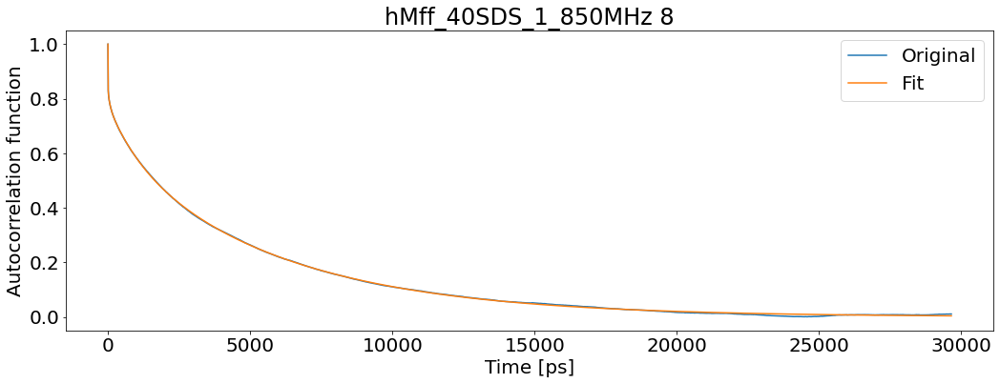

T1: 0.7797667778336128 T2: 0.13577653688104277 NOE: 0.6723756842733757


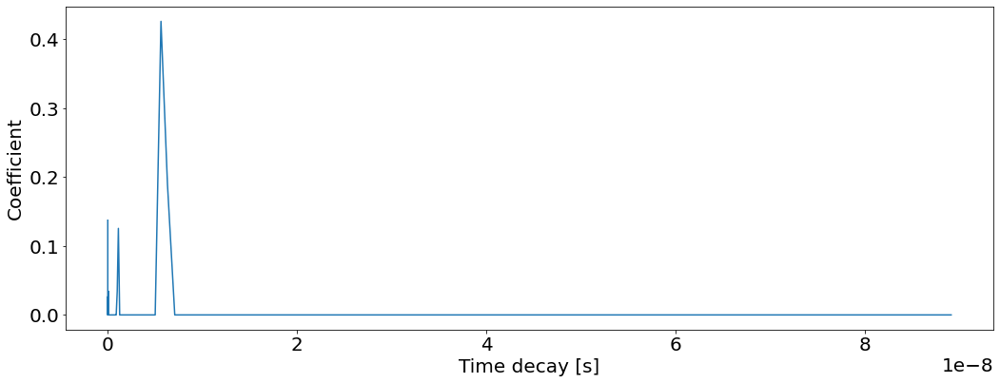

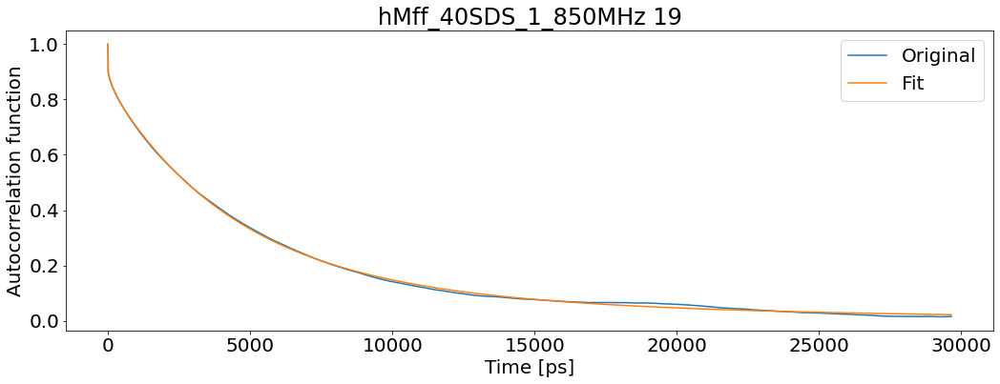

T1: 0.7156535951963103 T2: 0.09786885836413321 NOE: 0.754346194633089


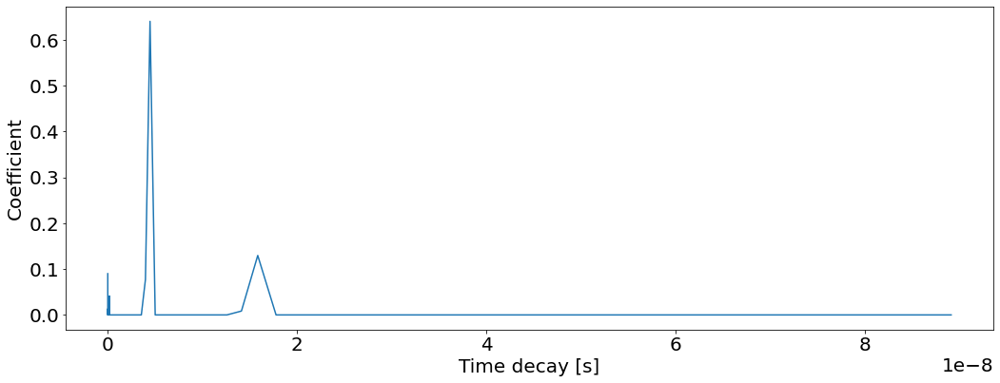

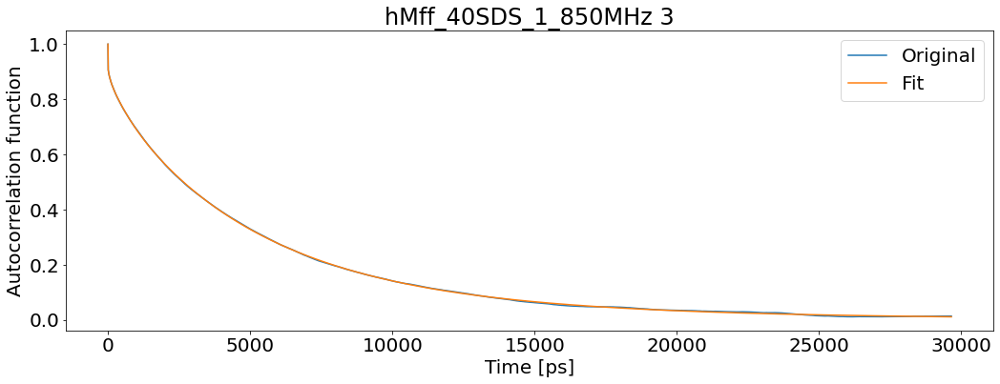

T1: 0.7290497528279261 T2: 0.10701855687539633 NOE: 0.734228067666824


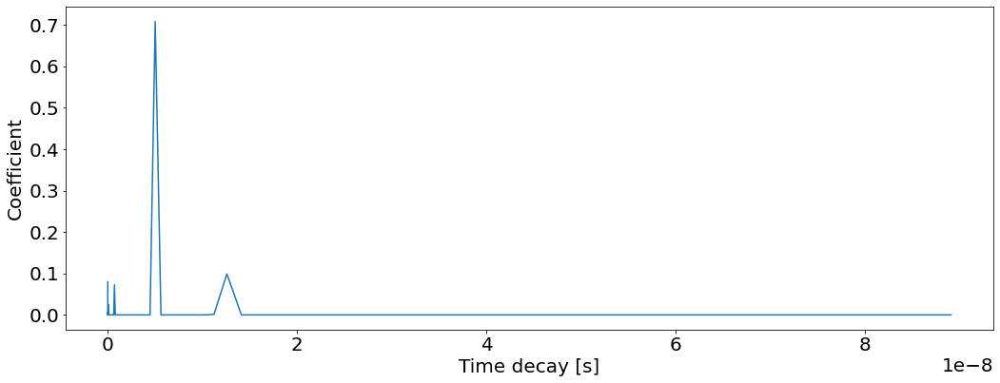

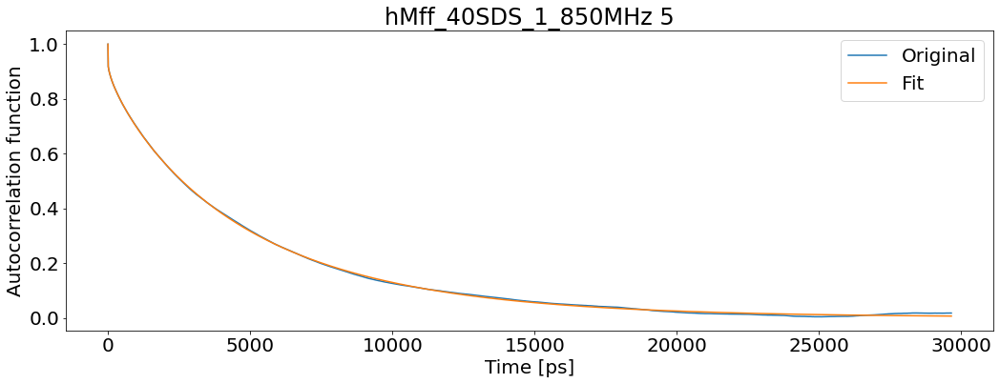

T1: 0.6834942646403352 T2: 0.10988689580067353 NOE: 0.7452650011803252


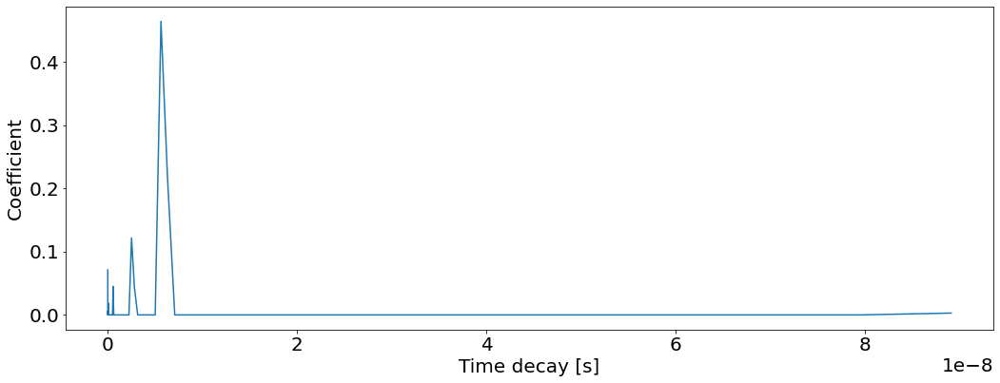

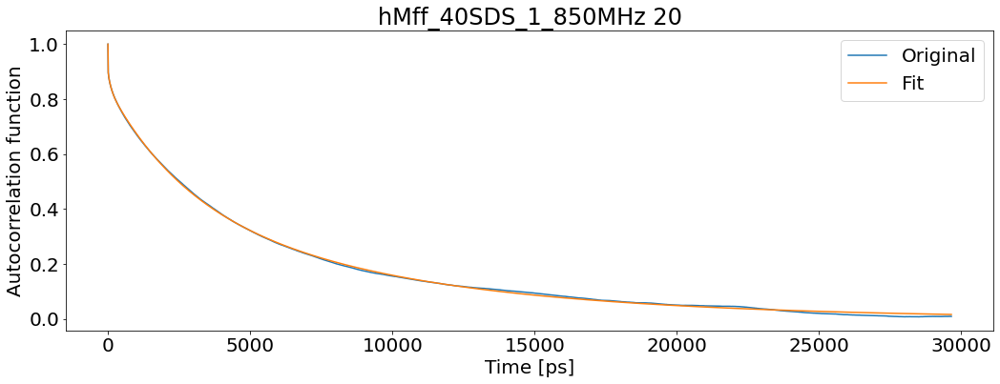

T1: 0.7193641291584223 T2: 0.10190780712200764 NOE: 0.725356099244372


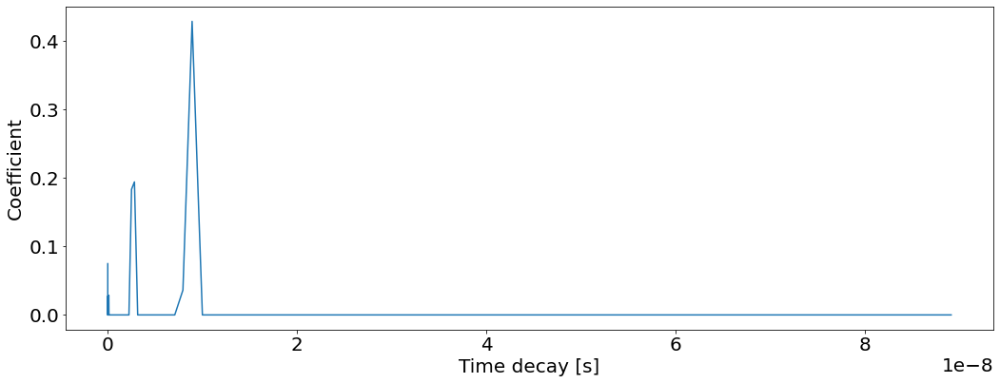

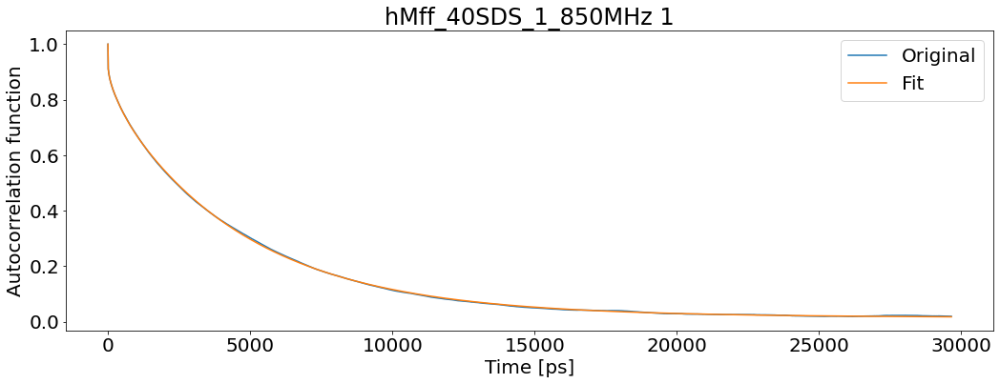

T1: 0.6838287535778462 T2: 0.09075993171838931 NOE: 0.7092731960197223


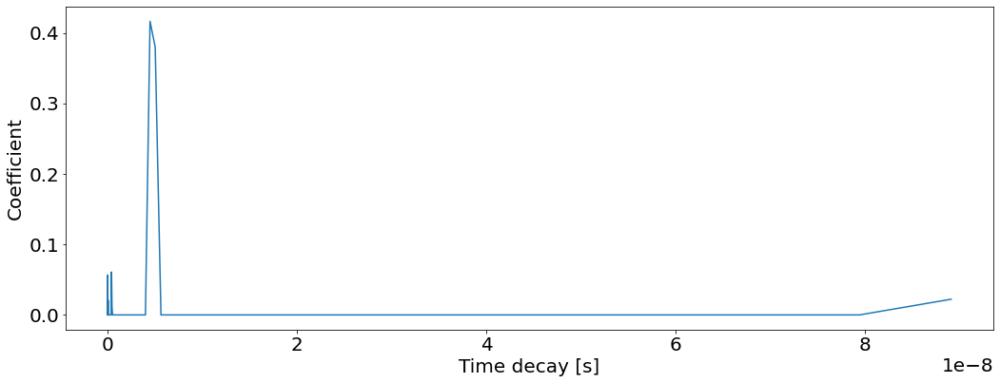

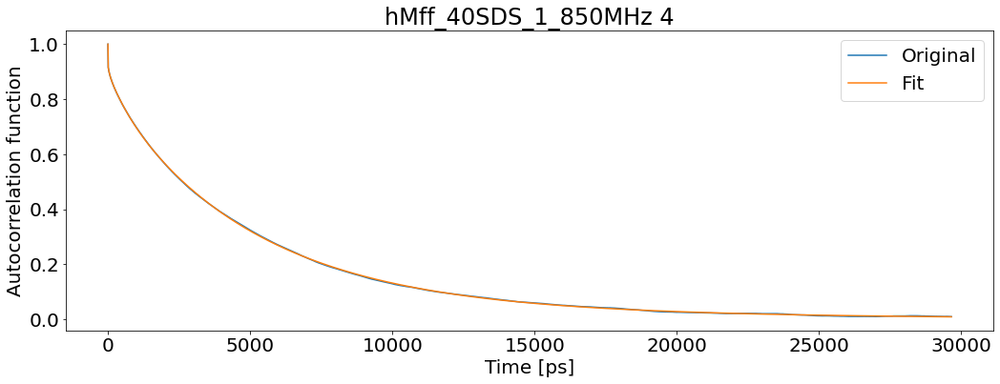

T1: 0.7010211125135033 T2: 0.10982651930799335 NOE: 0.7418857191598798


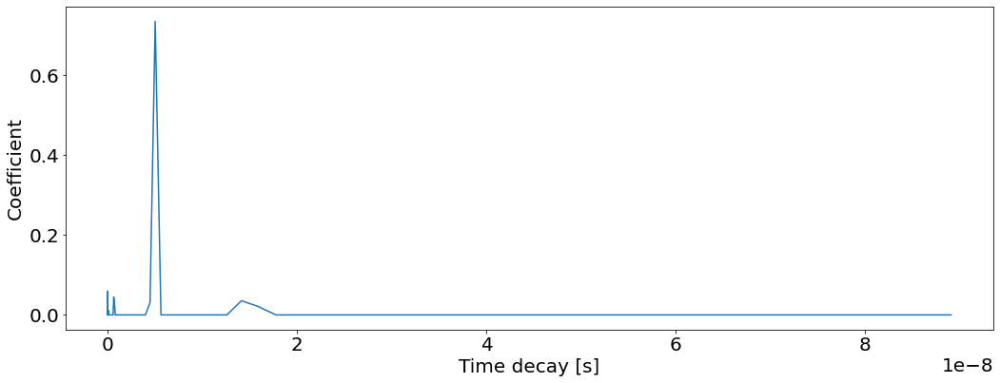

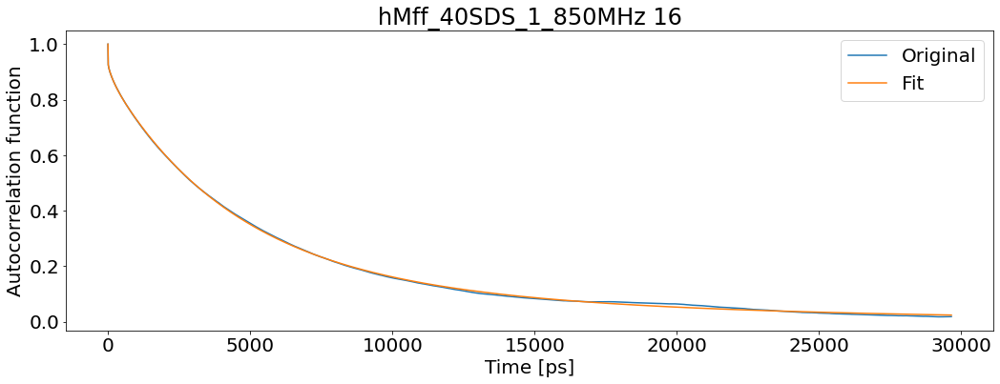

T1: 0.7029649733948167 T2: 0.09251111222831254 NOE: 0.7635515917168127


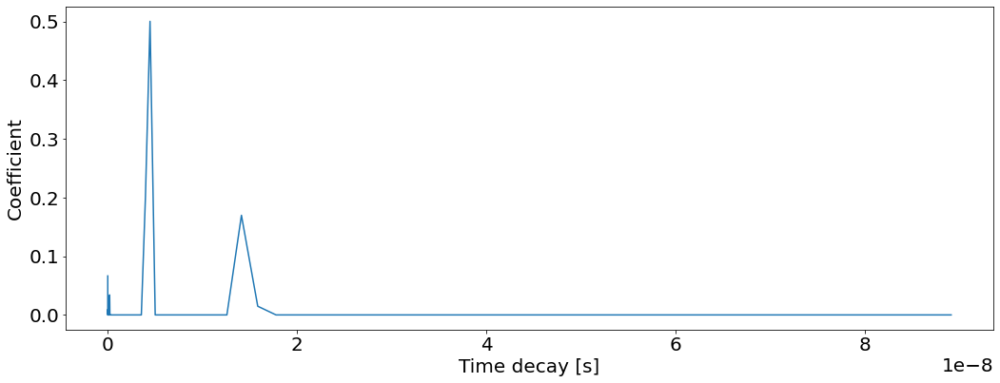

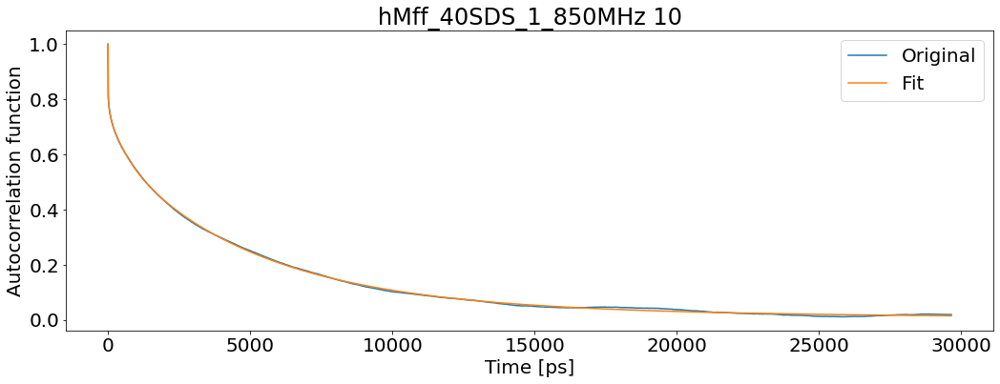

T1: 0.8216930982716453 T2: 0.12864849791343771 NOE: 0.5988576476414595


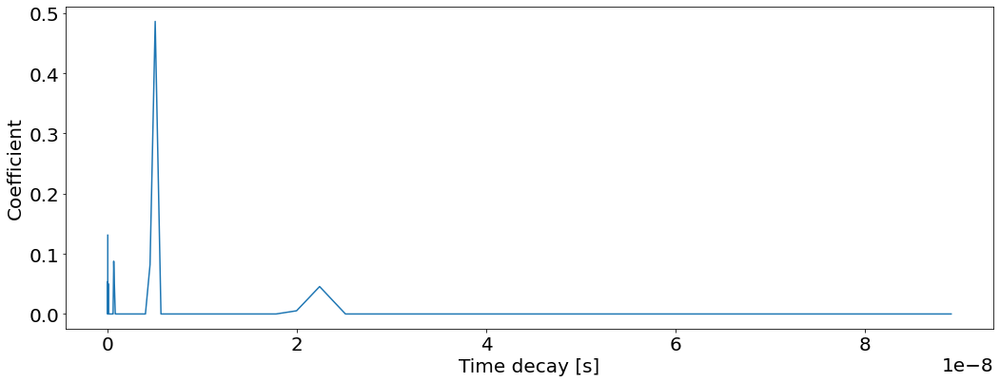

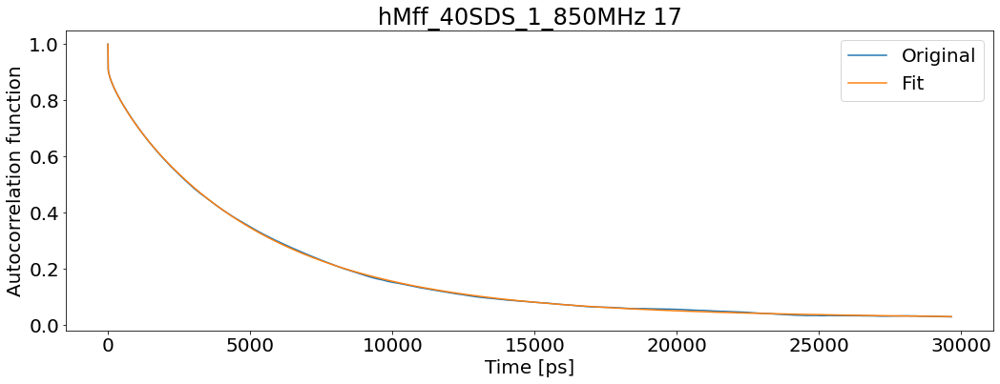

T1: 0.7375911626457066 T2: 0.08091808997593768 NOE: 0.7588432432706391


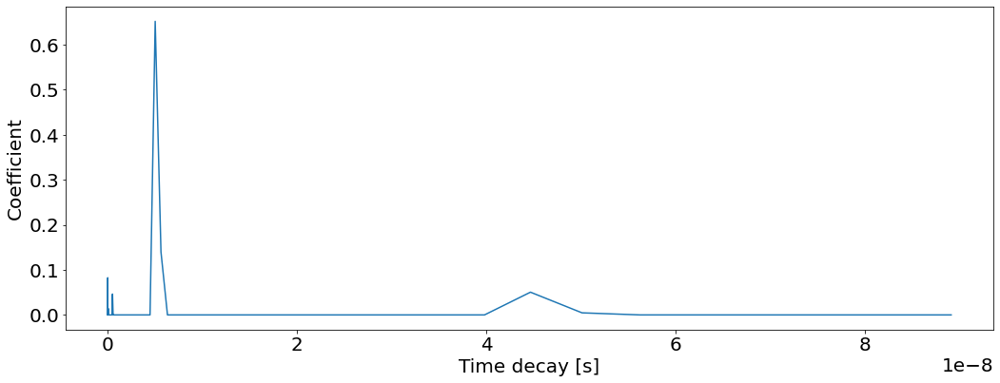

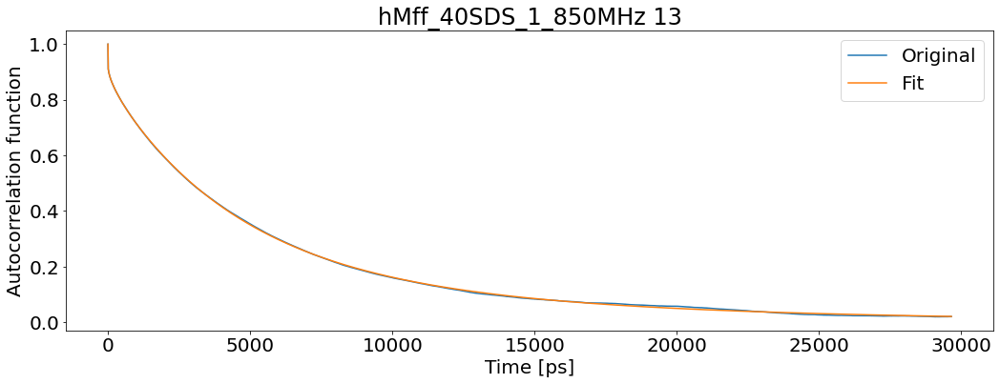

T1: 0.7344800257273677 T2: 0.0949274870682616 NOE: 0.7562108667261404


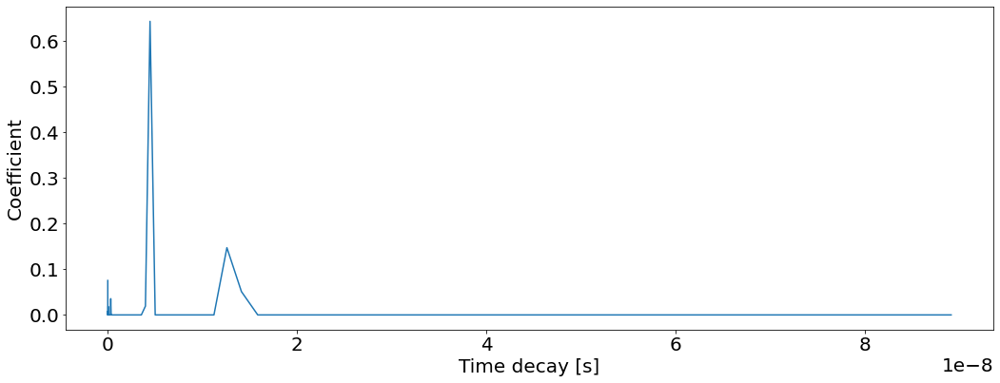

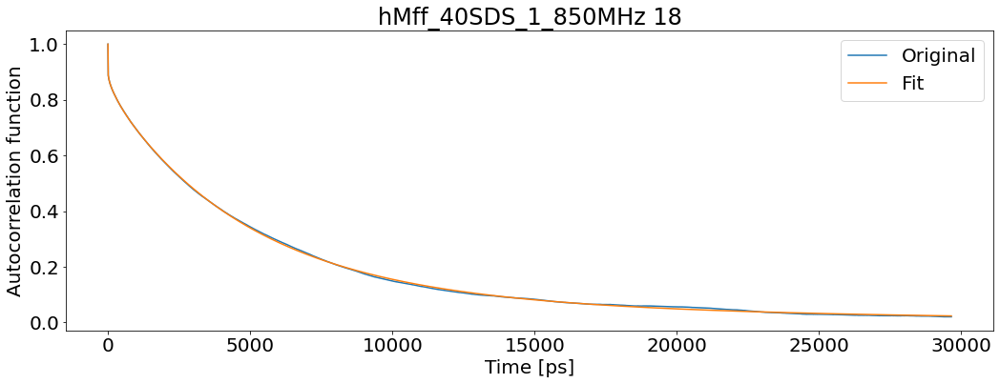

T1: 0.7558662854368962 T2: 0.09565034399794303 NOE: 0.7442598609726083


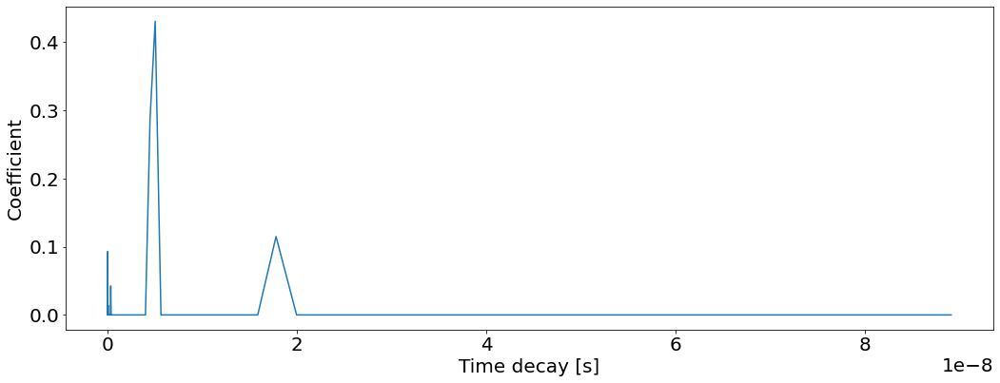

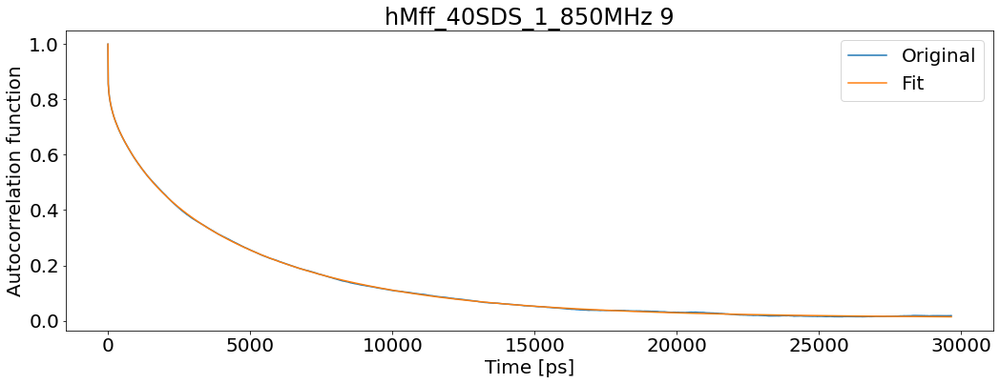

T1: 0.7497327296725829 T2: 0.10711229980466117 NOE: 0.6192262909410942


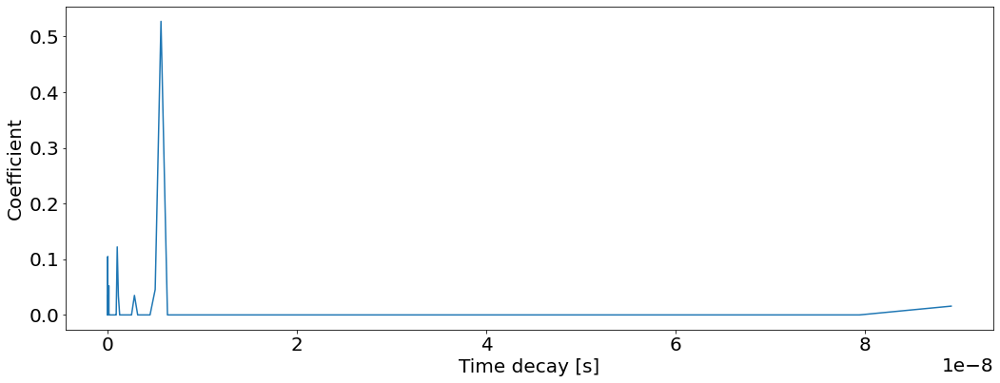

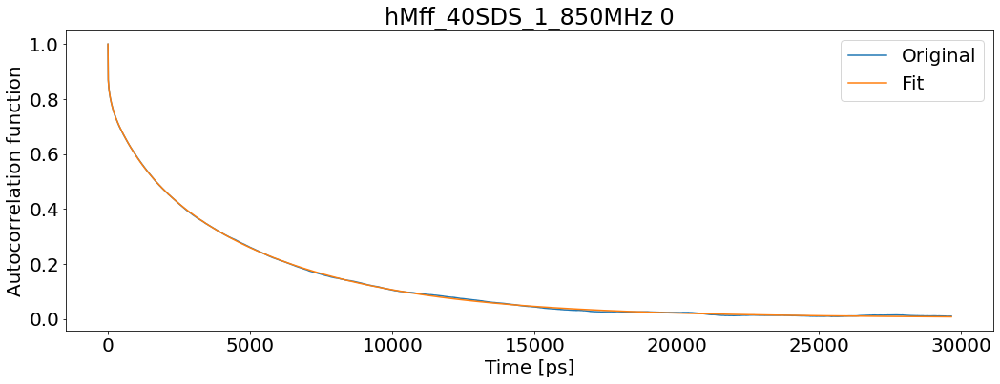

T1: 0.7362119423717496 T2: 0.12306805870182698 NOE: 0.6317973201796592


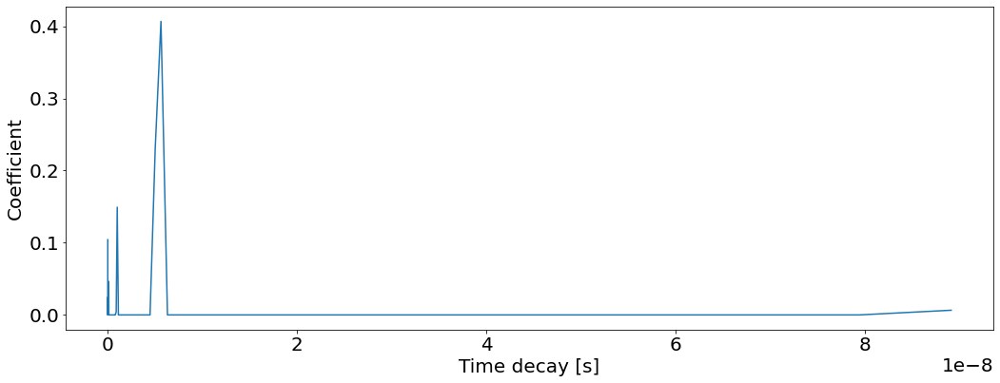

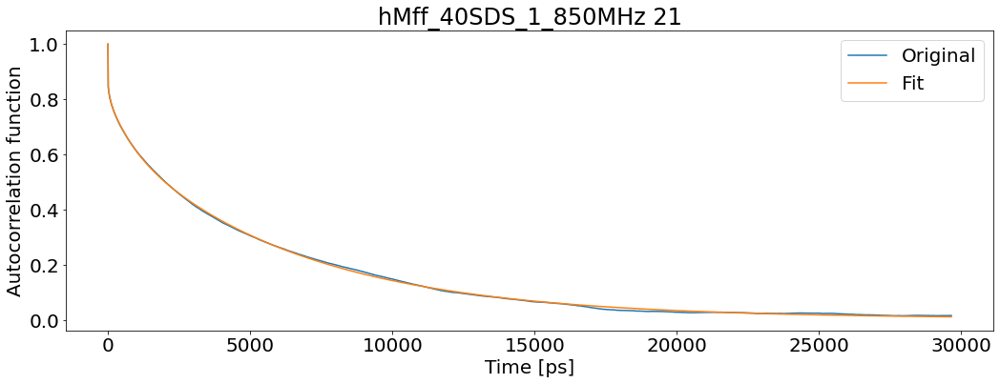

T1: 0.843610667766676 T2: 0.10275956653178382 NOE: 0.6454712675076497


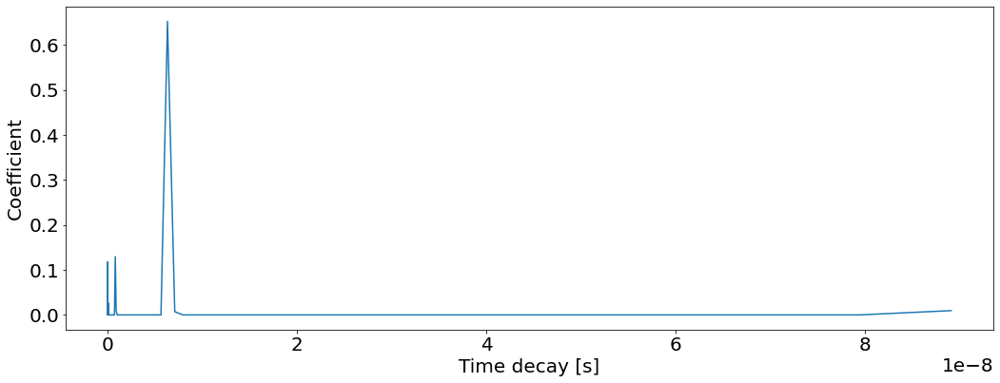

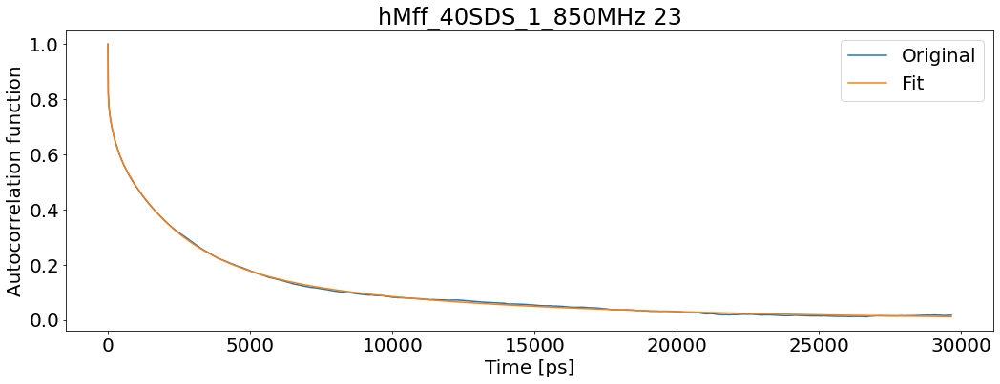

T1: 0.6918150029938497 T2: 0.15506288535309334 NOE: 0.5212652013582699


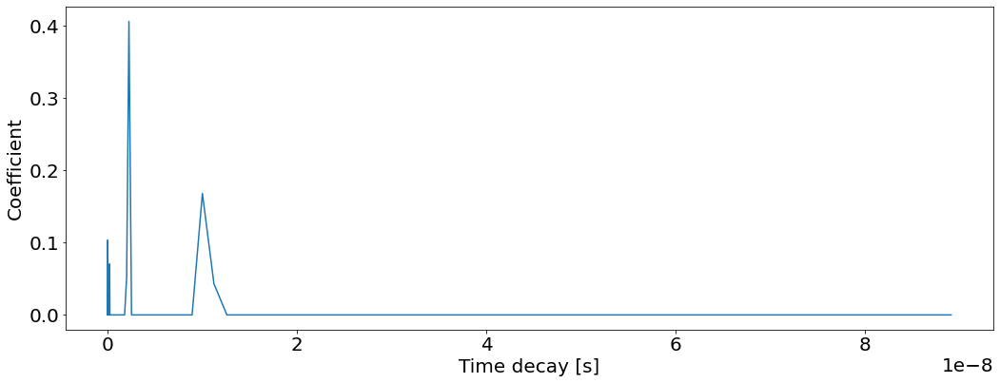

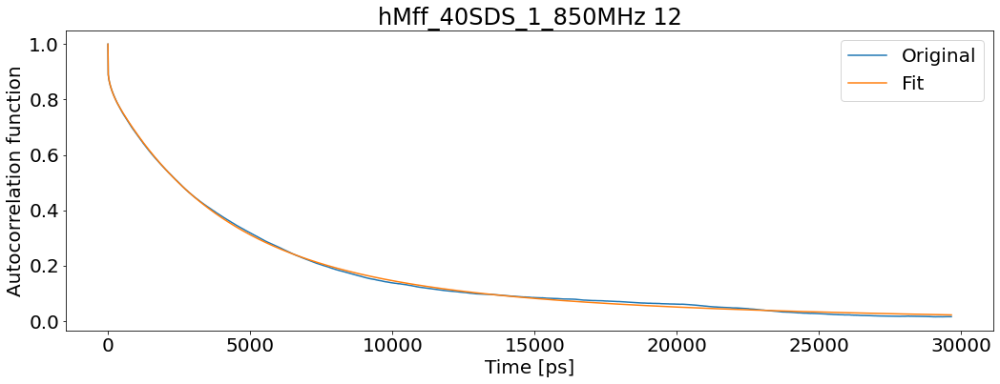

T1: 0.6972635577689985 T2: 0.10093236162672424 NOE: 0.7521296305276234


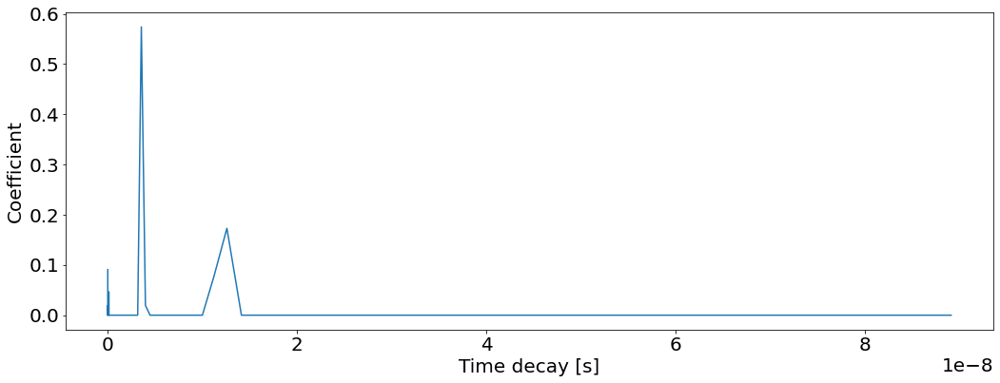

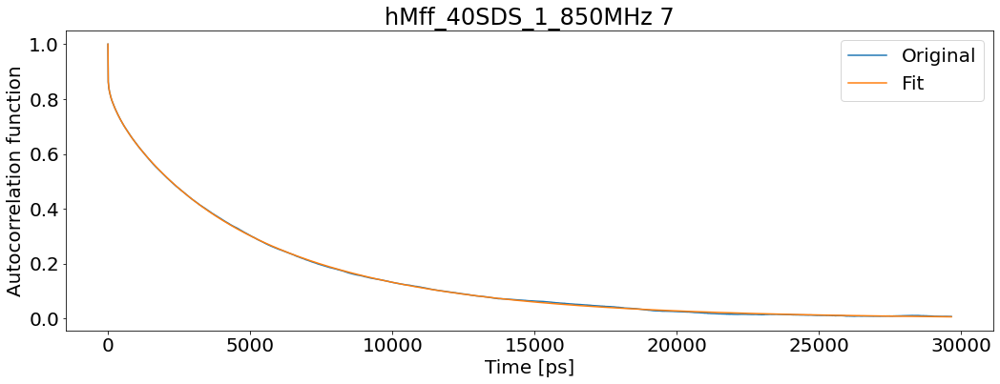

T1: 0.769502684047047 T2: 0.1185788599484429 NOE: 0.6886889641335027


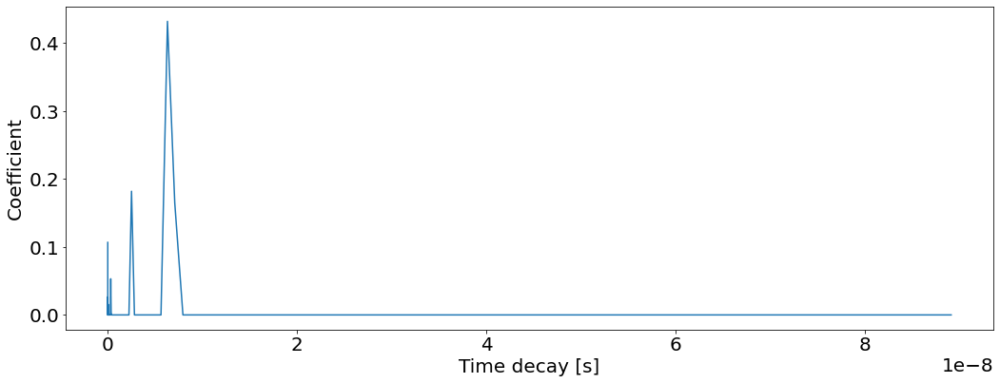

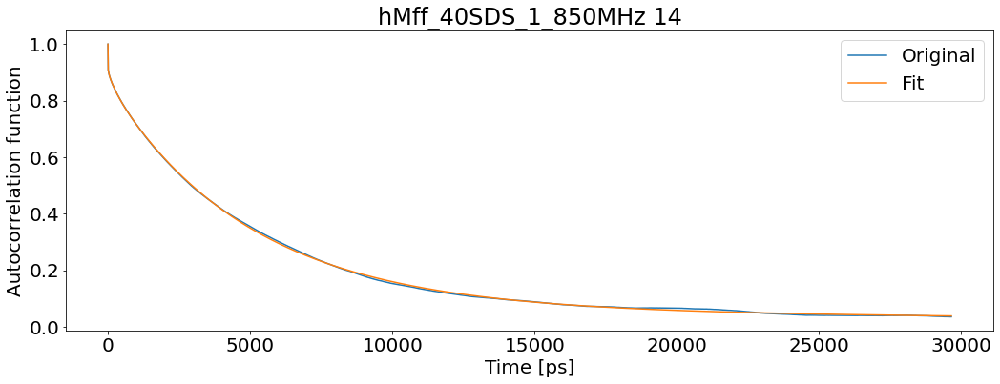

T1: 0.7332796494072421 T2: 0.07336565722304263 NOE: 0.756600909266732


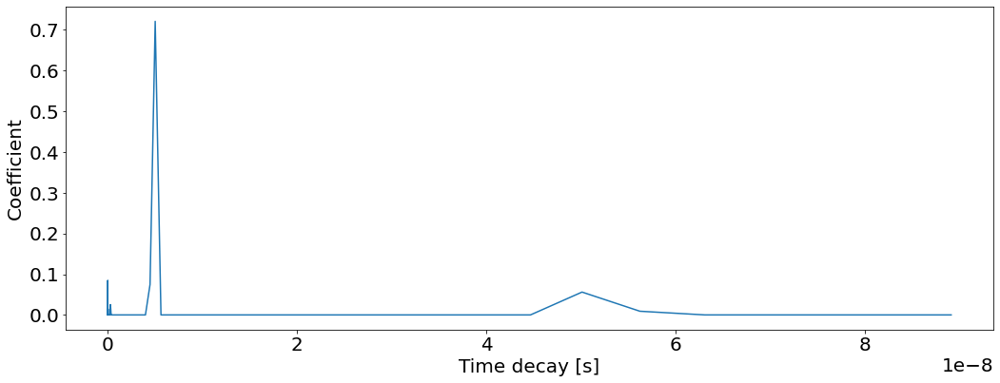

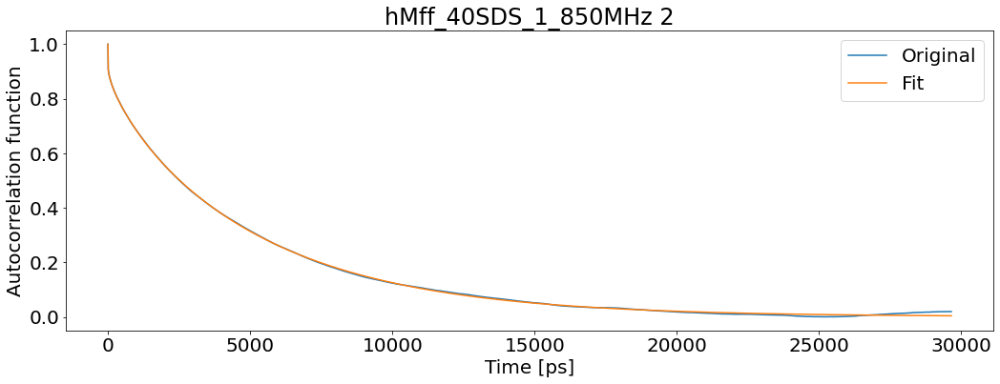

T1: 0.7100778251483472 T2: 0.1158978074297283 NOE: 0.7267197859781132


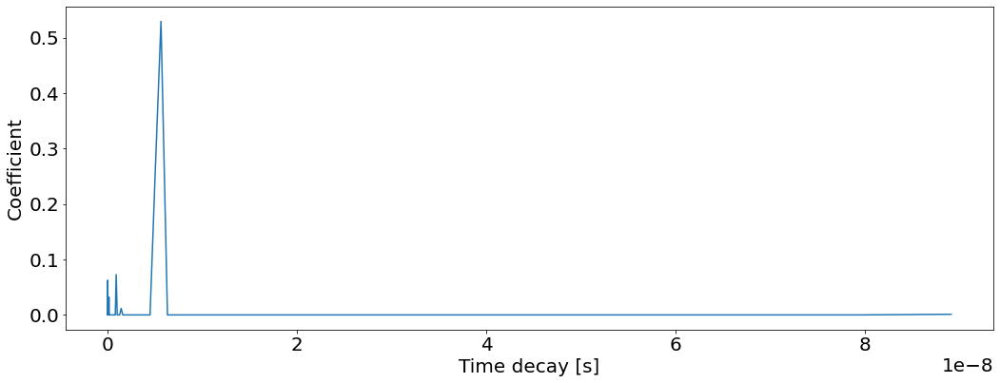

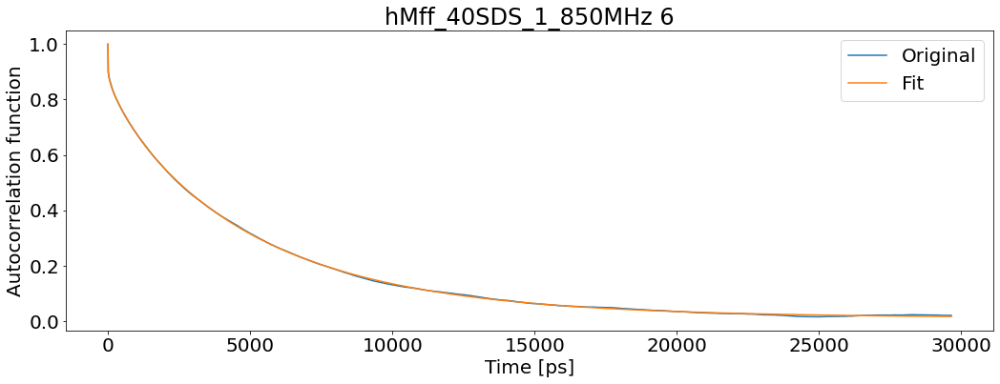

T1: 0.7198497290112951 T2: 0.09063527657740807 NOE: 0.7268233536653355


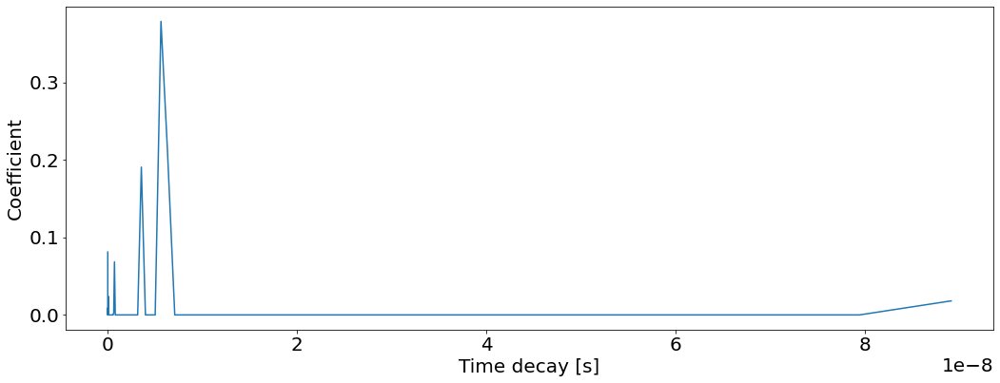

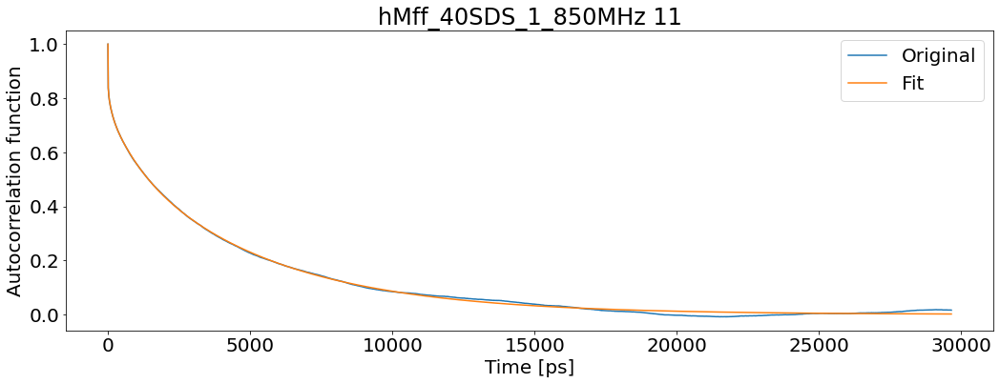

T1: 0.7349293289664856 T2: 0.15310506880018349 NOE: 0.6189440399717578


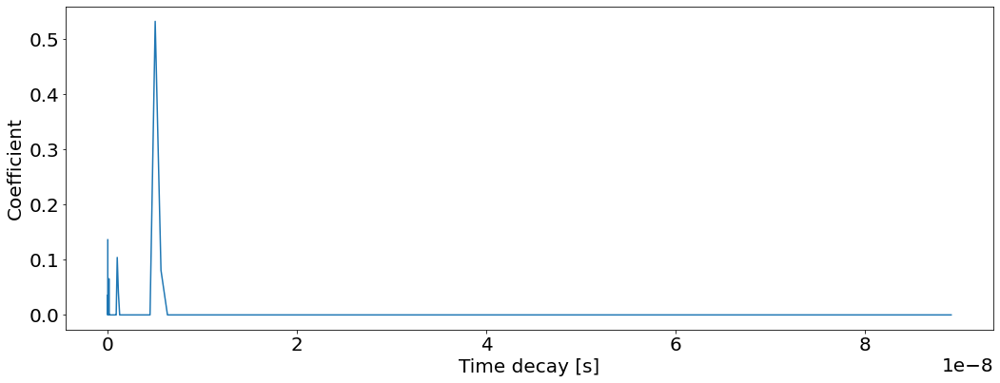

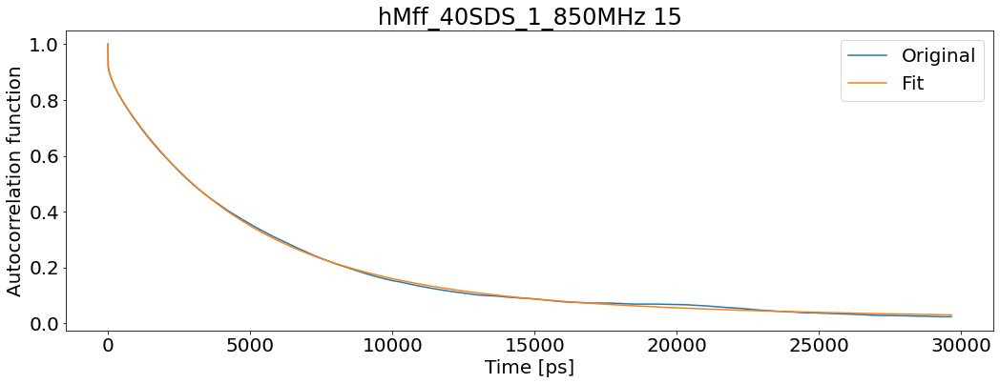

T1: 0.7145735584569577 T2: 0.08797971533693259 NOE: 0.7611837473580271


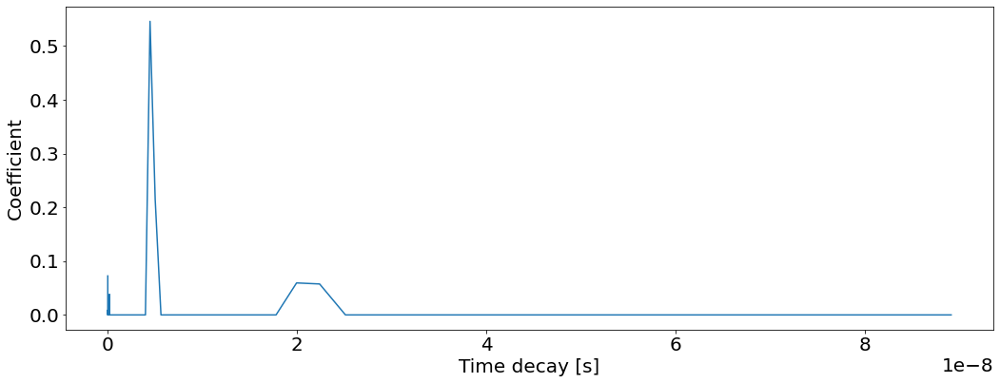

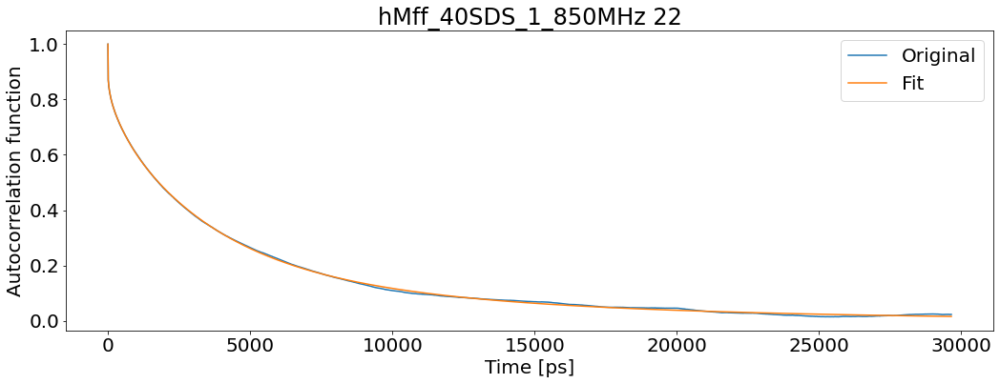

T1: 0.7035511464753741 T2: 0.11940509324180217 NOE: 0.6590190720989294


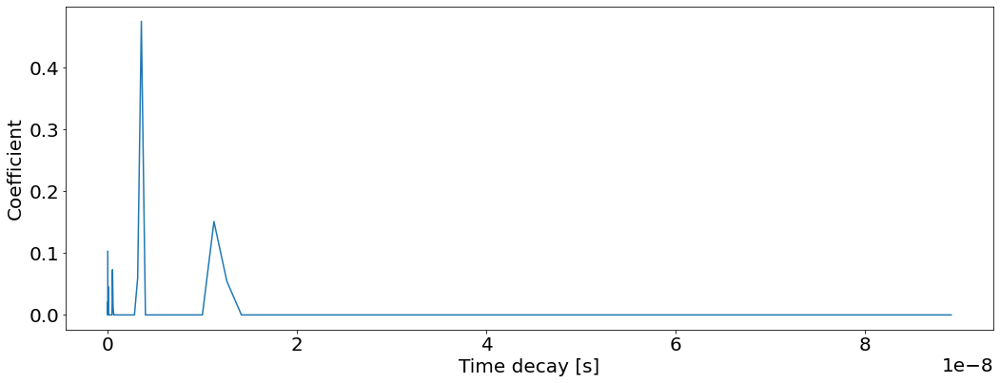

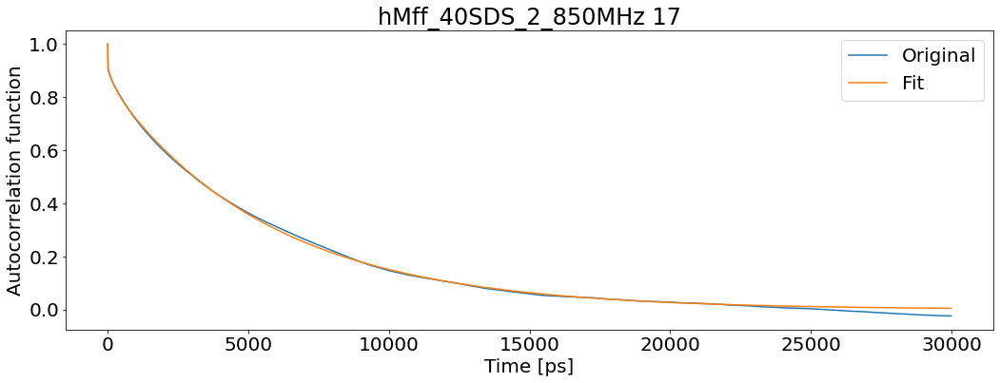

T1: 0.7681270729219859 T2: 0.105832605117349 NOE: 0.7339351824912326


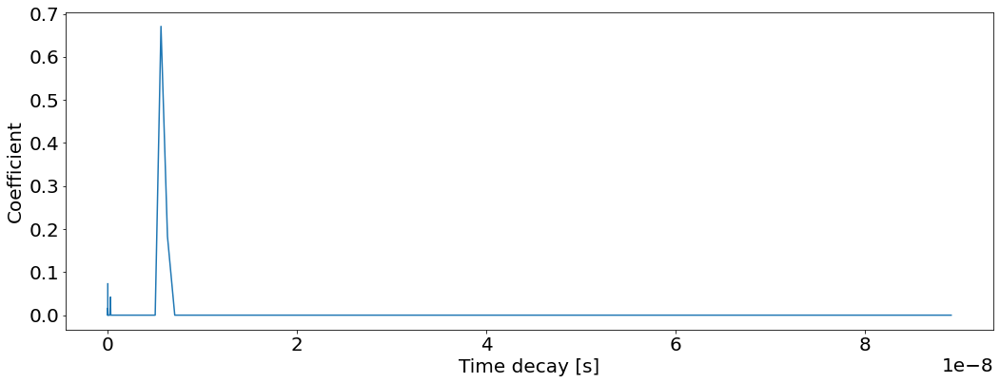

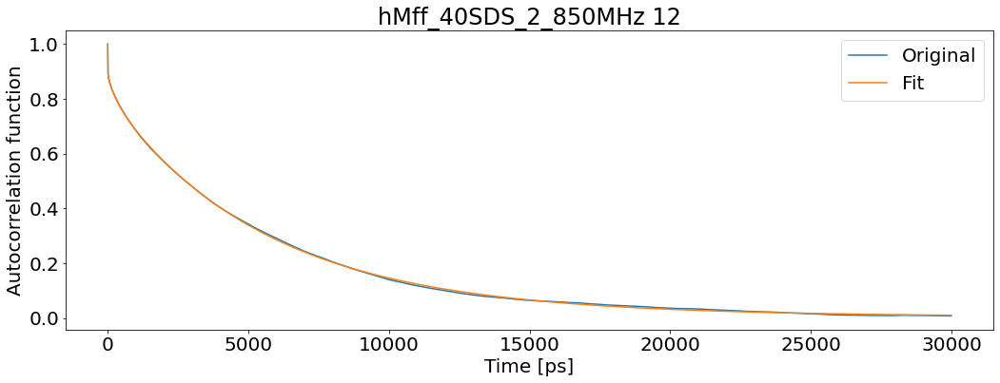

T1: 0.7804446131136724 T2: 0.10594038816799597 NOE: 0.7064165200990871


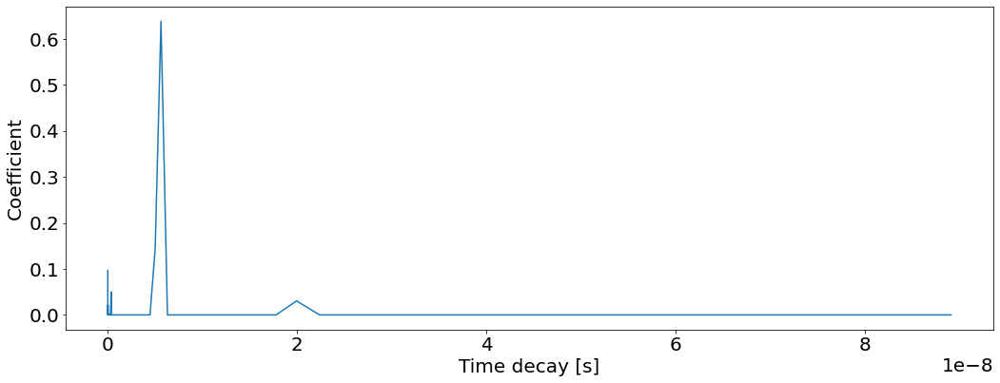

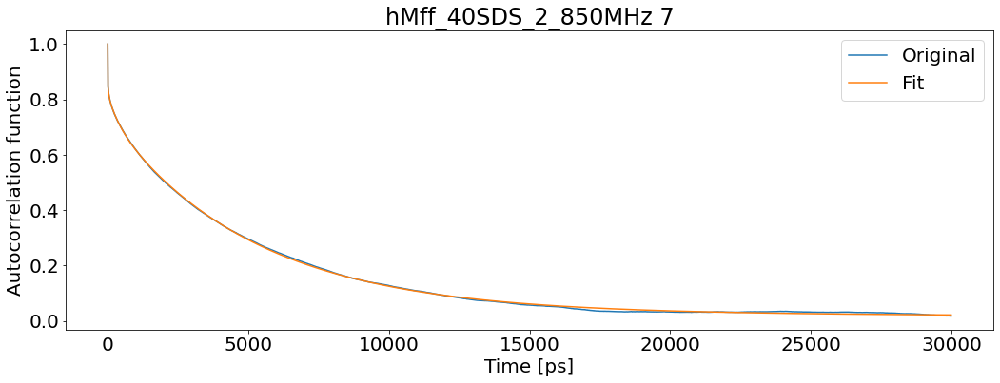

T1: 0.7979694416058 T2: 0.08628393816594264 NOE: 0.6662695164194263


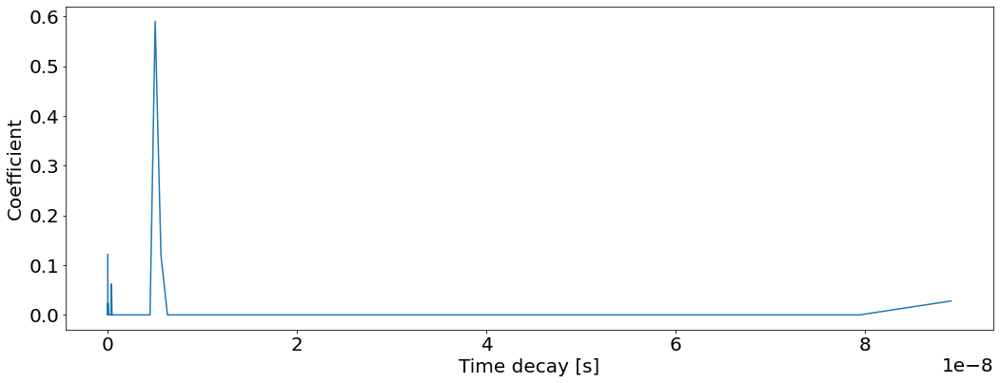

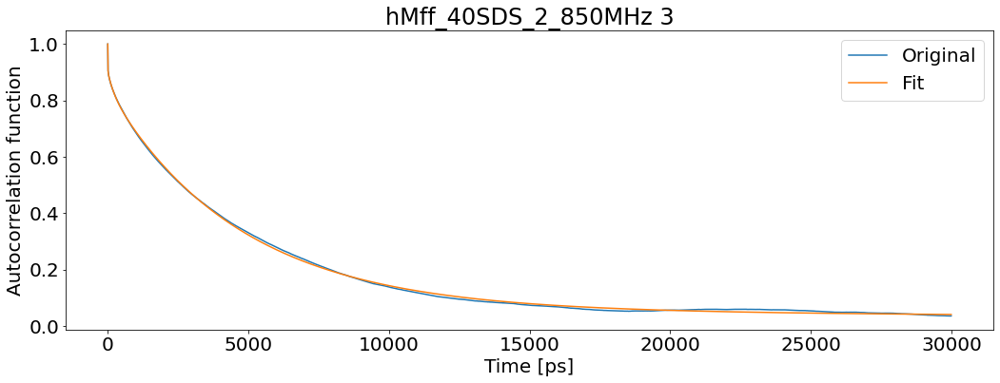

T1: 0.7111366242064832 T2: 0.06276852680733502 NOE: 0.7143945311327514


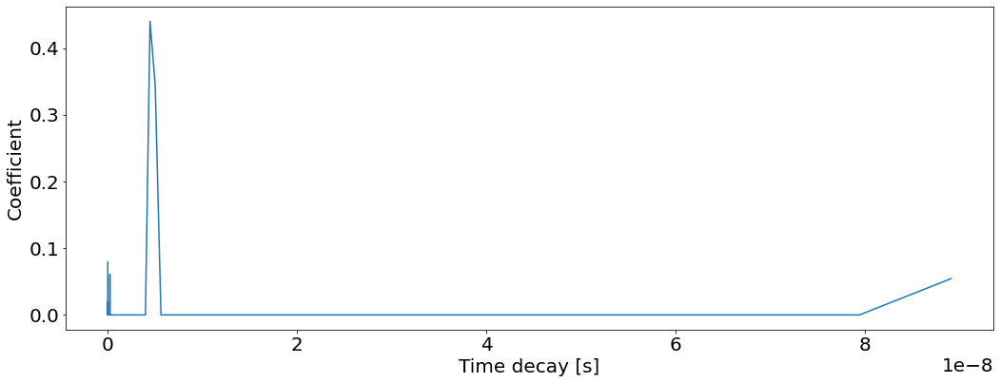

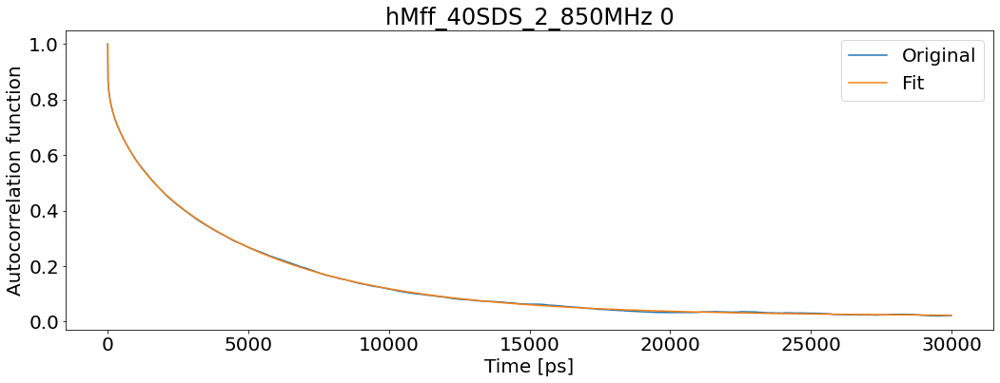

T1: 0.7685302088521885 T2: 0.08854791636049486 NOE: 0.5980236664971469


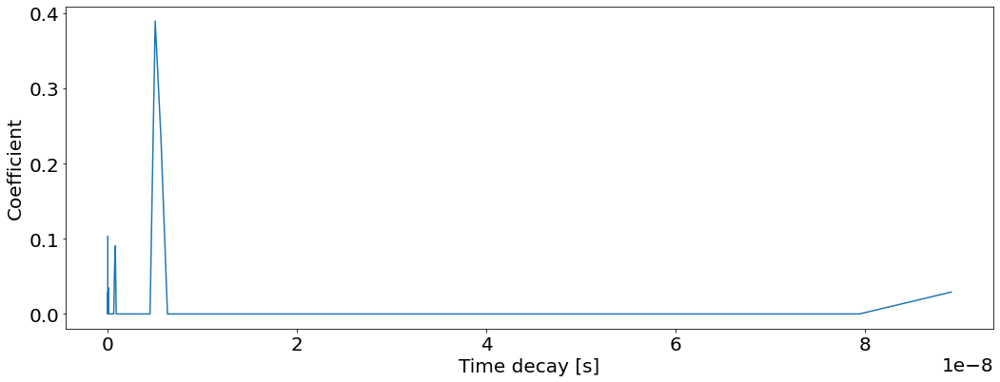

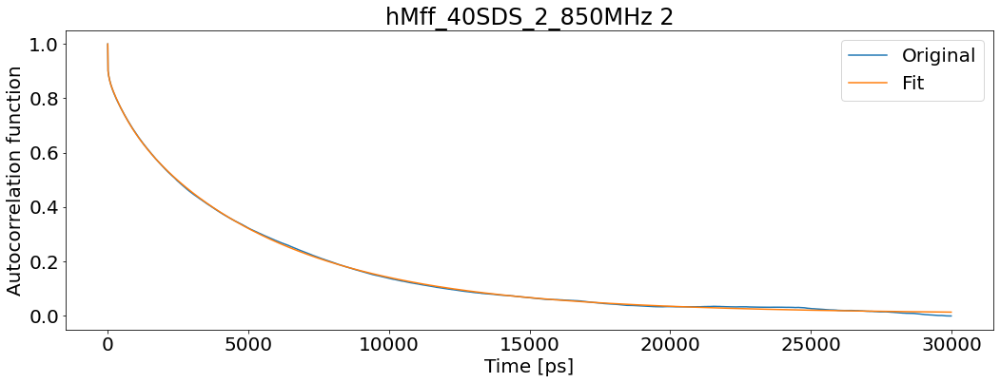

T1: 0.7437590564016816 T2: 0.10707235756326355 NOE: 0.7081506686681112


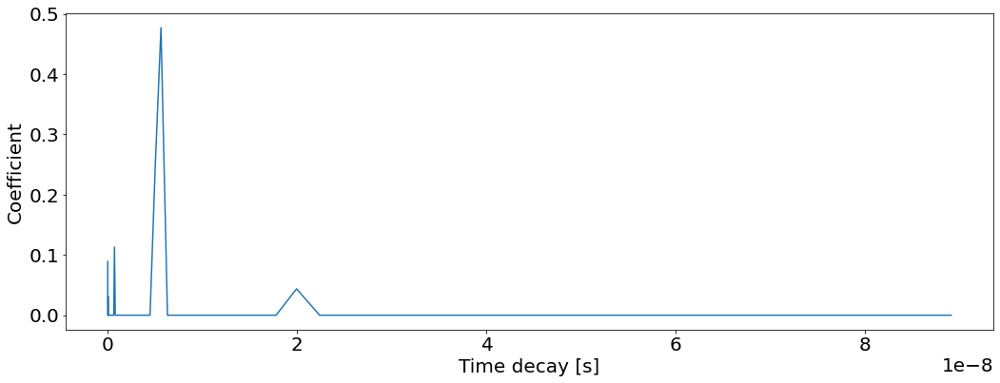

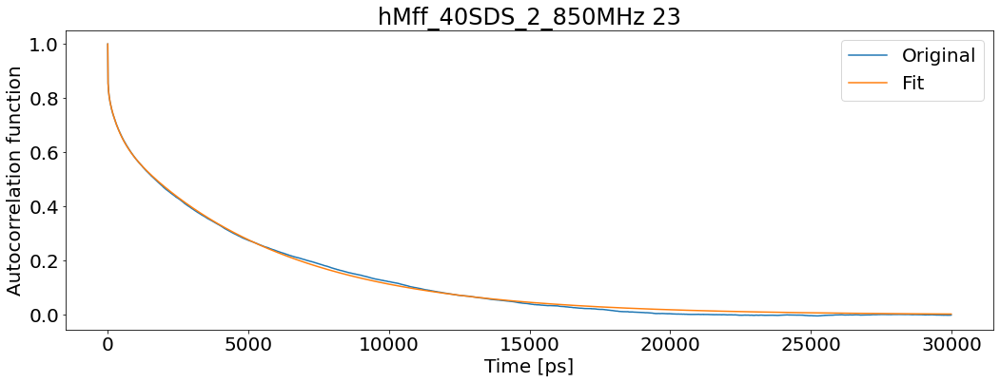

T1: 0.8312354030129959 T2: 0.13397958979782085 NOE: 0.5233383851453961


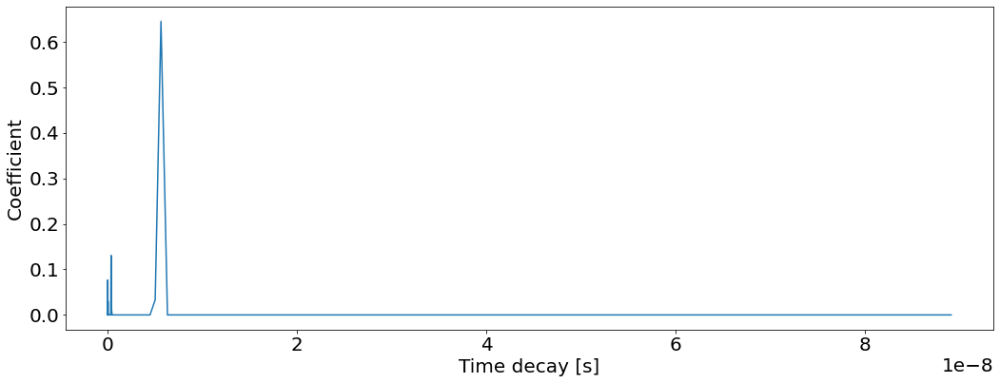

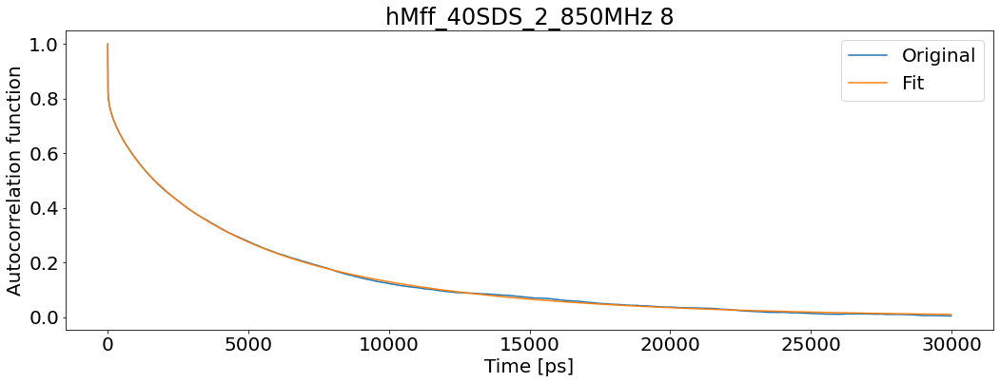

T1: 0.8111724611405696 T2: 0.12337054200048327 NOE: 0.646732048563915


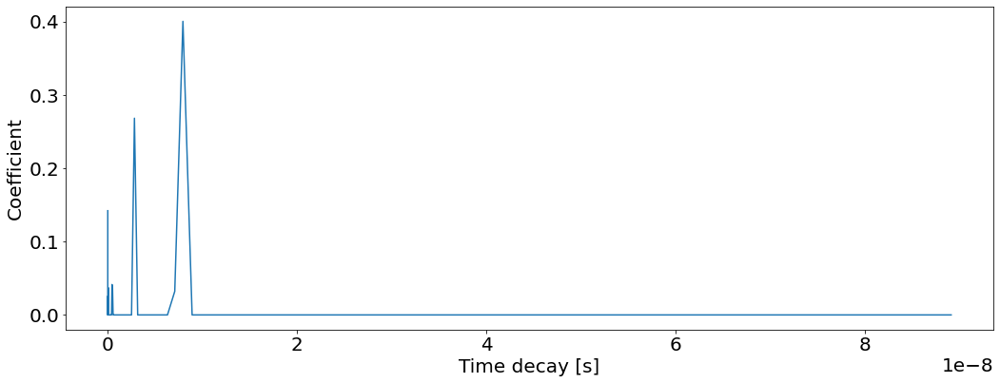

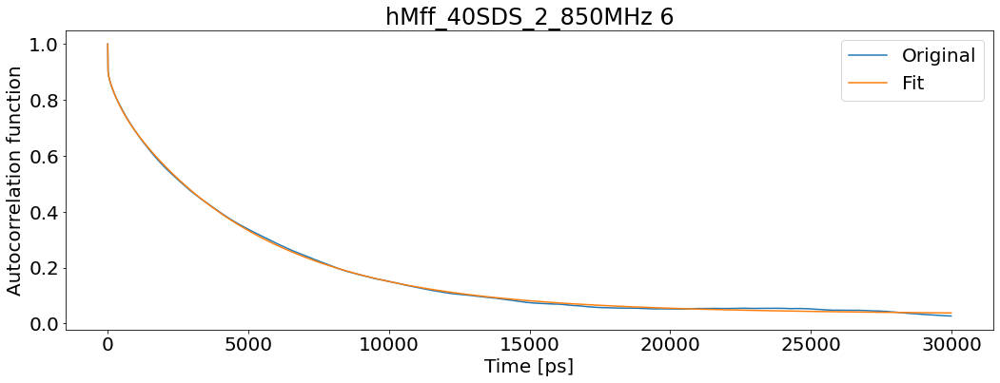

T1: 0.7420534870393993 T2: 0.06400992880604152 NOE: 0.7052596262809687


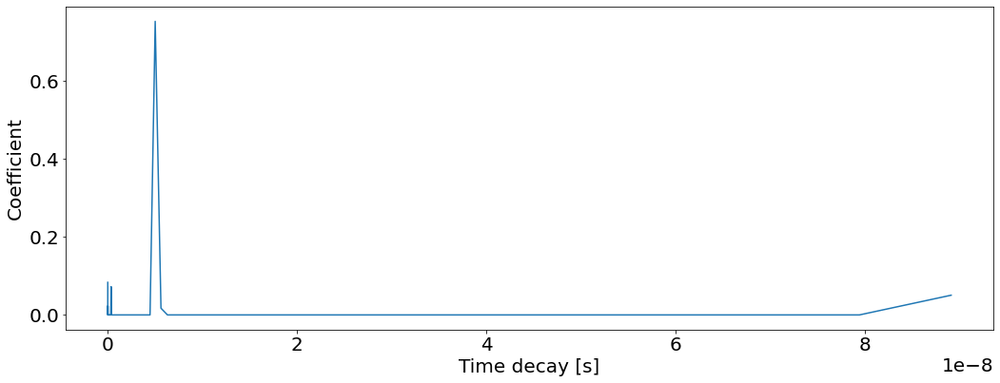

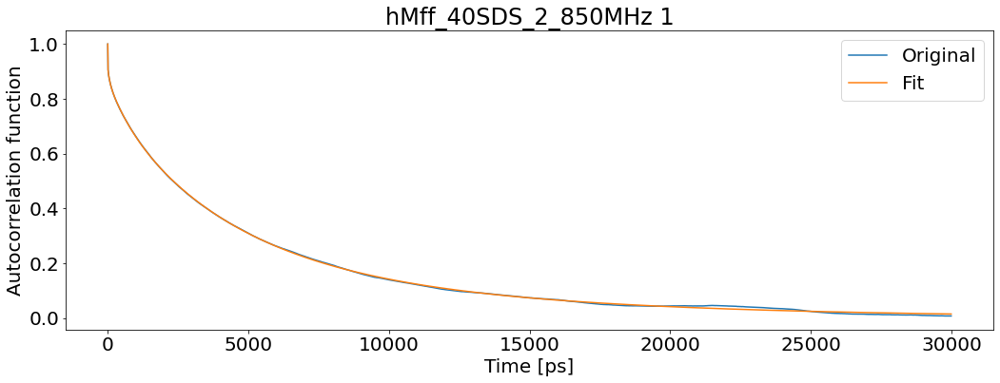

T1: 0.7142698368199637 T2: 0.10720676337196378 NOE: 0.6984103061844316


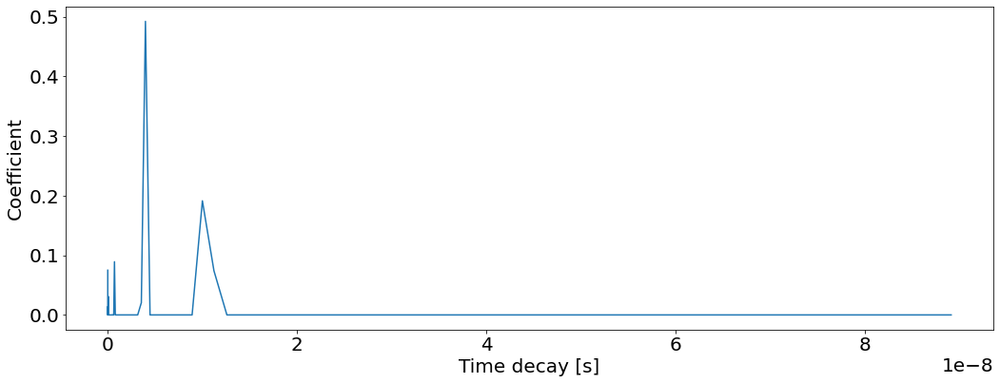

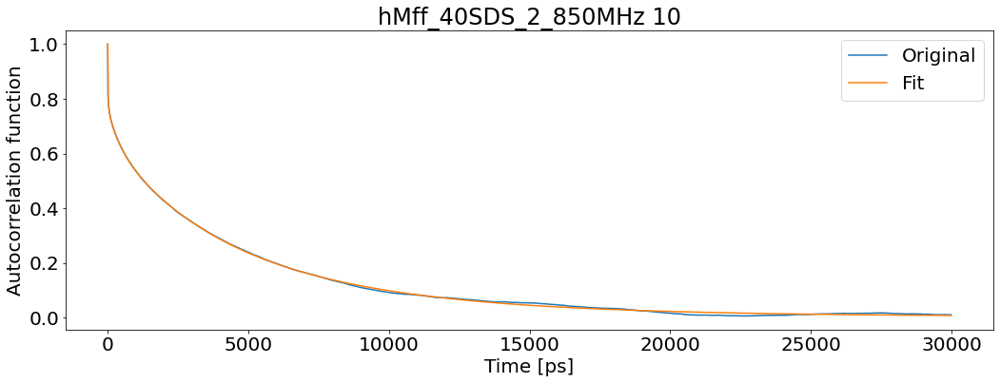

T1: 0.8017516037122383 T2: 0.12982914973139564 NOE: 0.5866261176261343


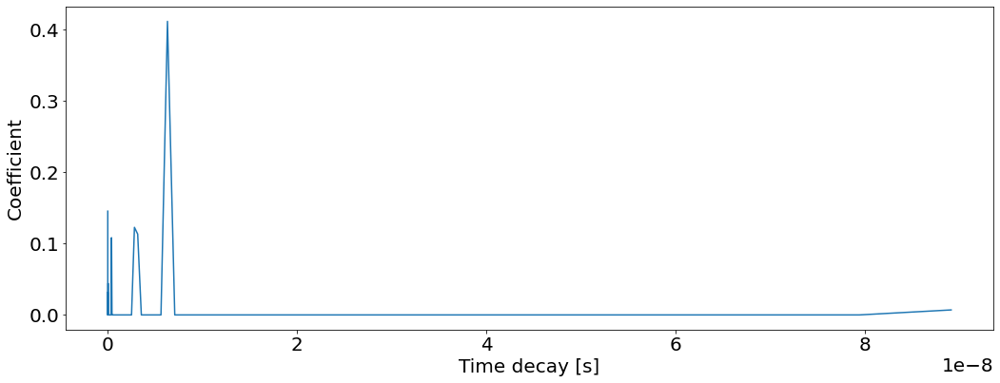

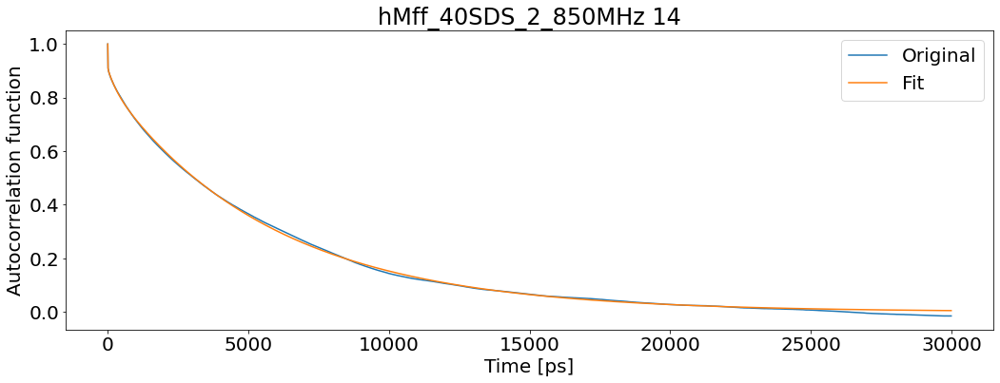

T1: 0.7721362857115593 T2: 0.10532620464604213 NOE: 0.7300484773354562


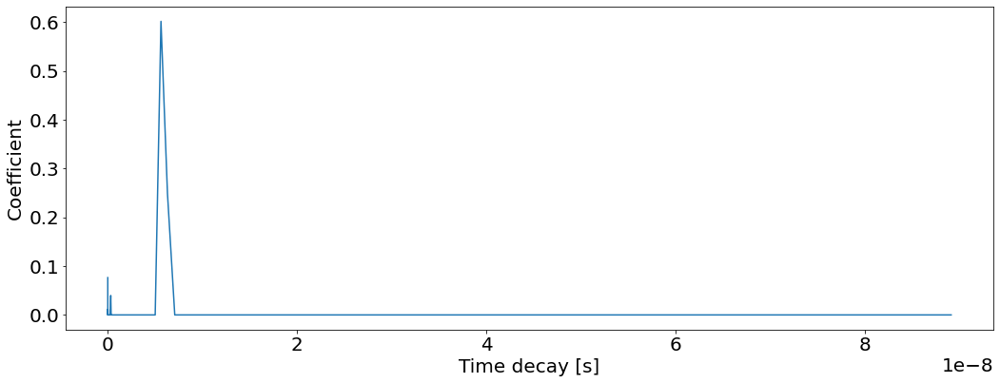

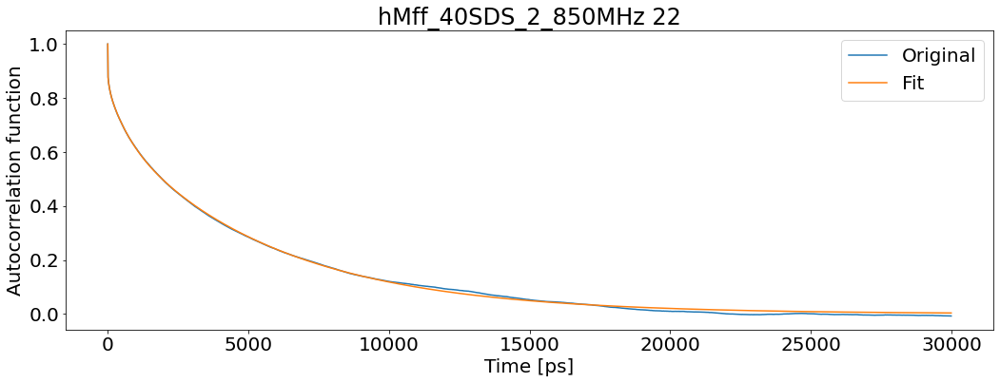

T1: 0.7641857911417469 T2: 0.12788769761226046 NOE: 0.6352266604851975


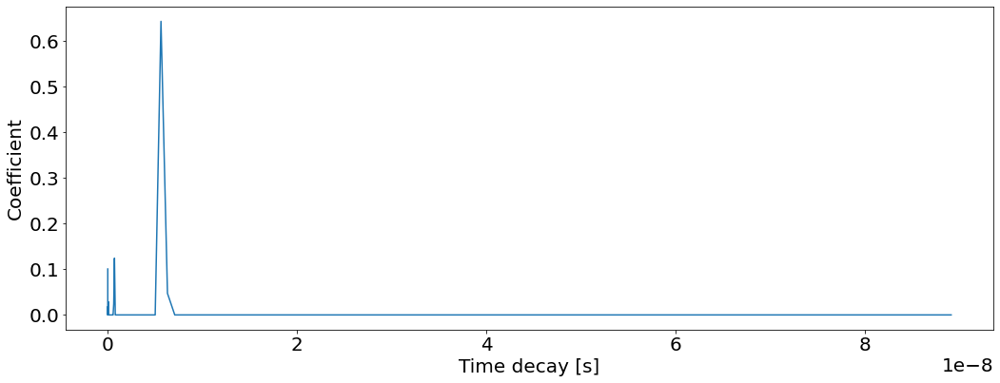

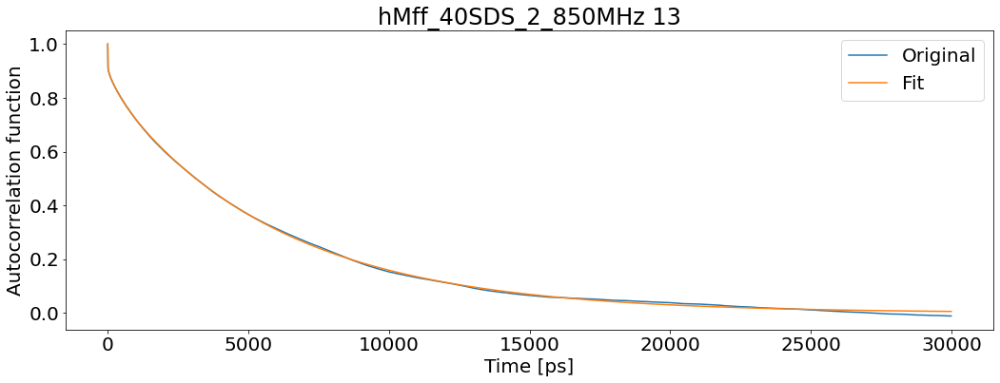

T1: 0.7848511915132932 T2: 0.10325839894077124 NOE: 0.7412235236396711


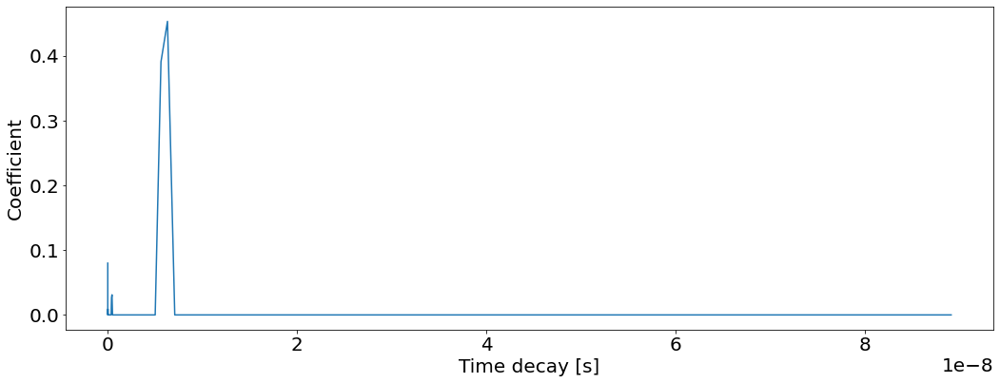

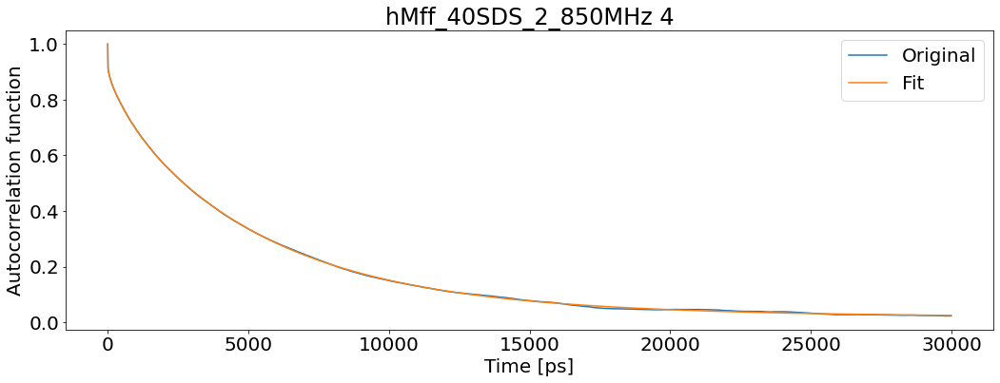

T1: 0.7333662435278548 T2: 0.0872496728736825 NOE: 0.7304782802471863


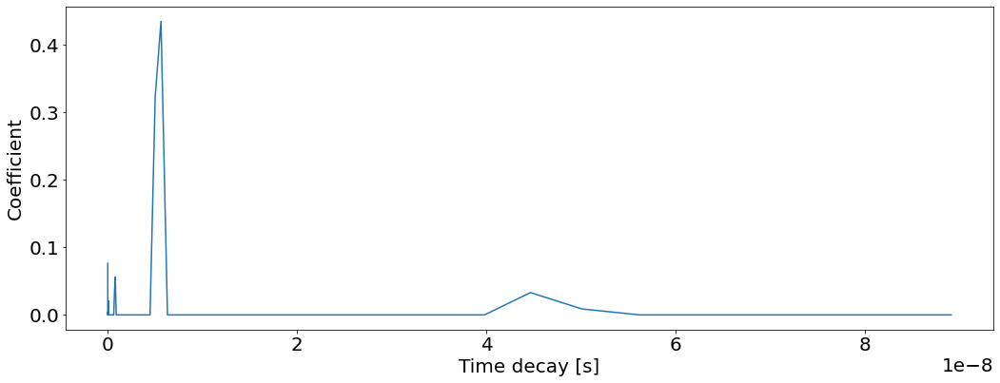

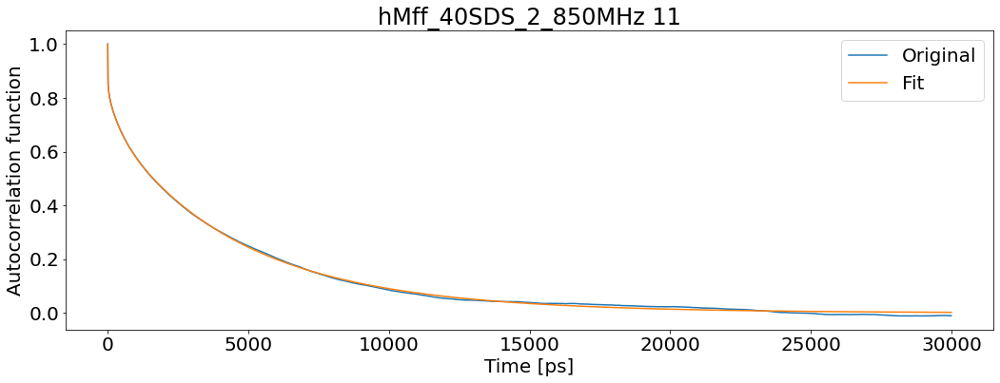

T1: 0.7270514749198781 T2: 0.14524946800343386 NOE: 0.6247176904609505


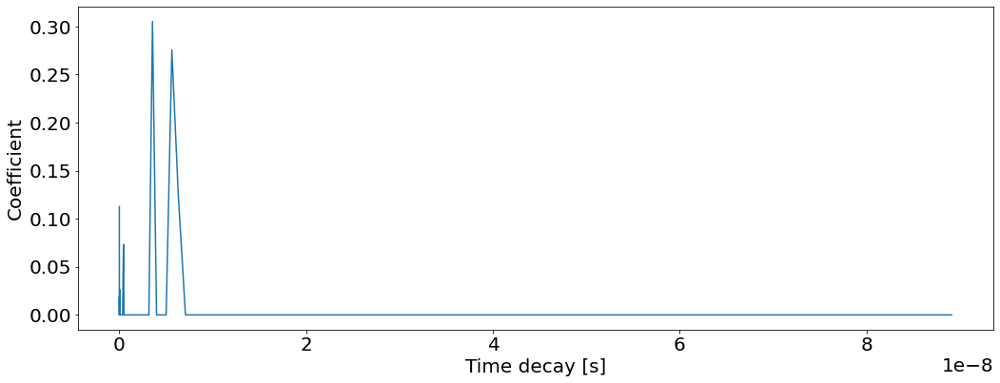

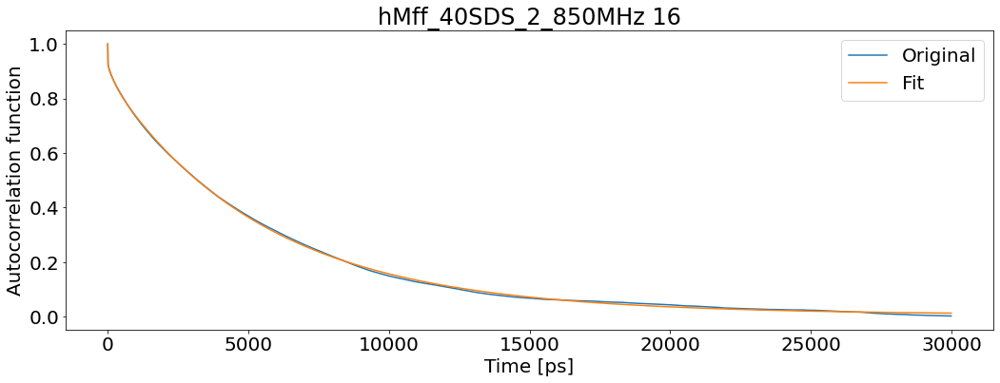

T1: 0.7433034550050154 T2: 0.09697823694150495 NOE: 0.7479113200275146


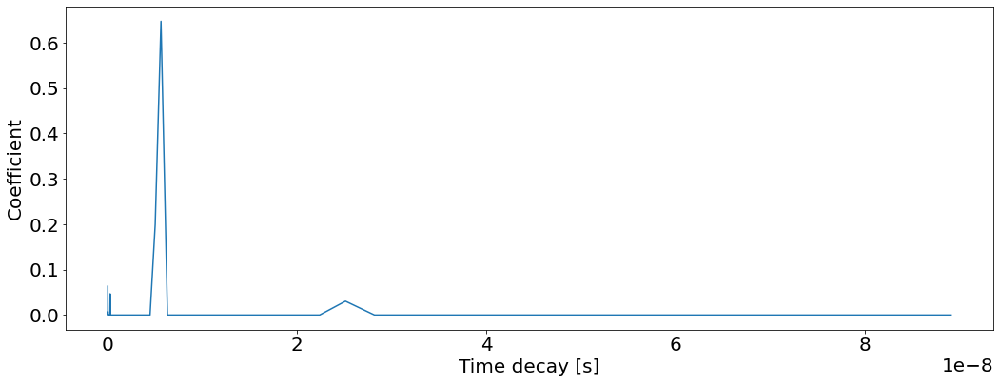

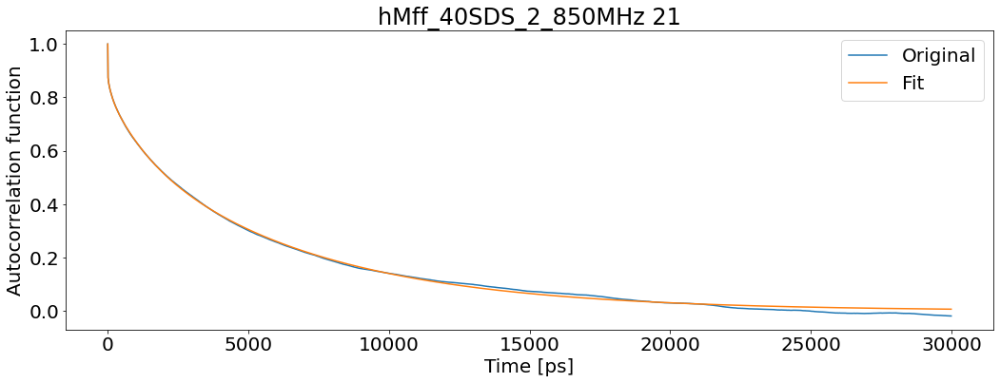

T1: 0.7676728063909412 T2: 0.11616722867202955 NOE: 0.662960886323431


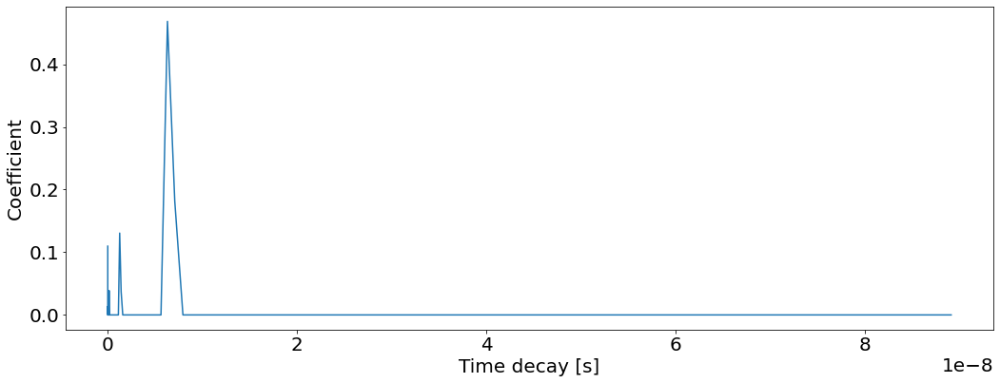

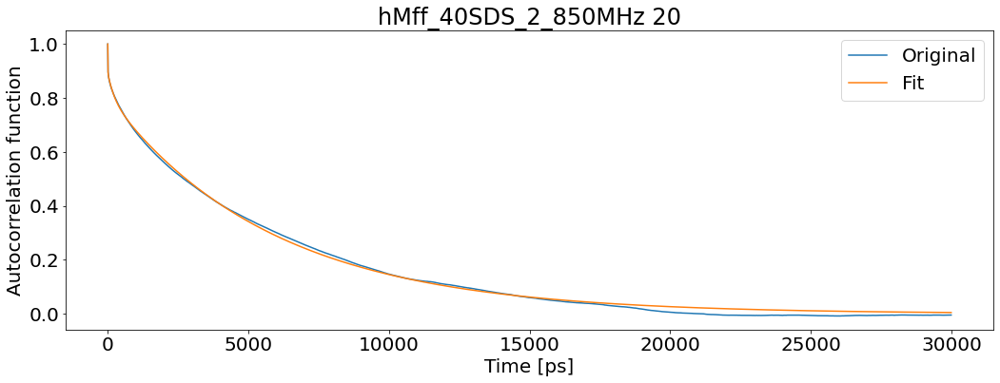

T1: 0.8020777430482688 T2: 0.11044792517268723 NOE: 0.649563378206016


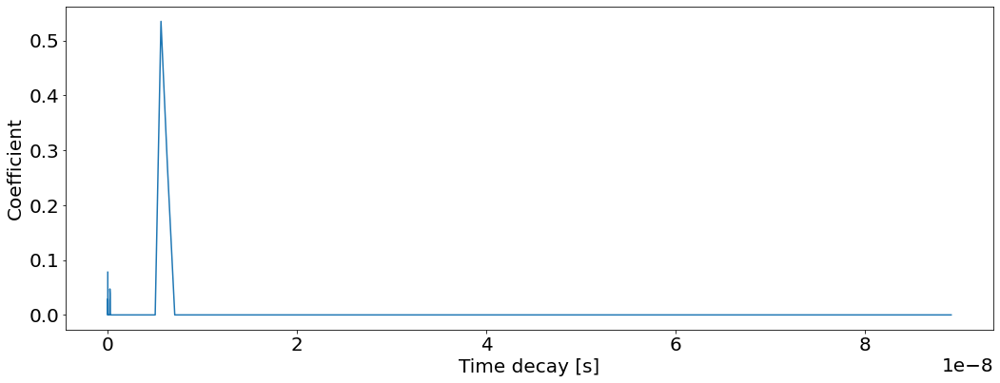

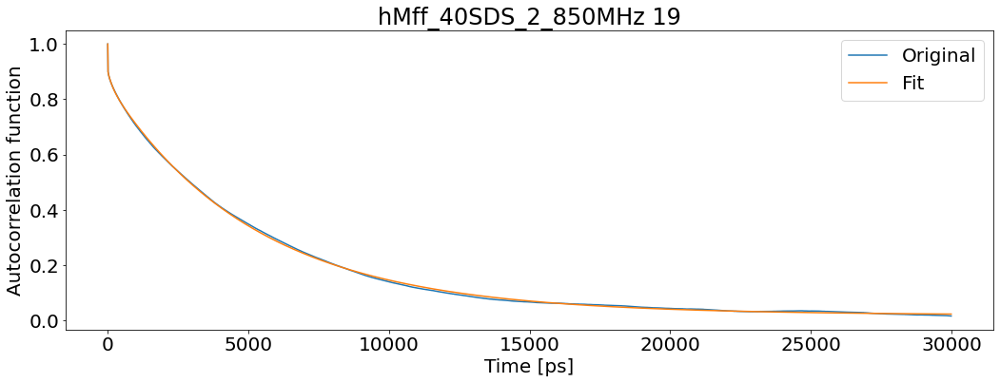

T1: 0.7398076706672962 T2: 0.07766334962526589 NOE: 0.7529122720703898


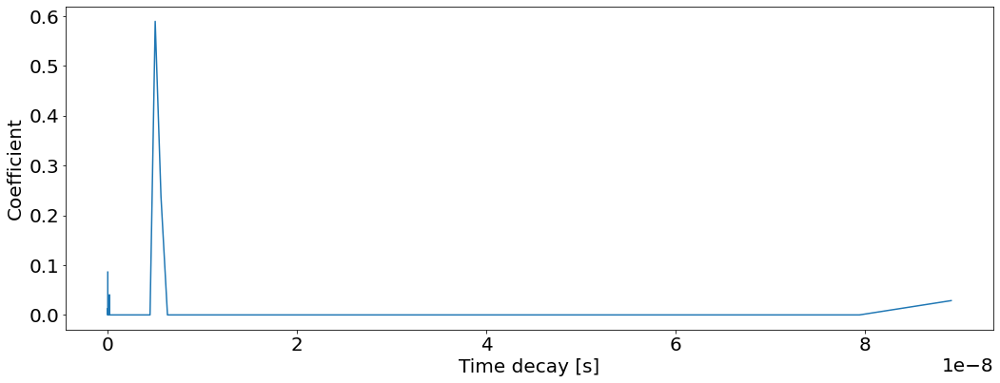

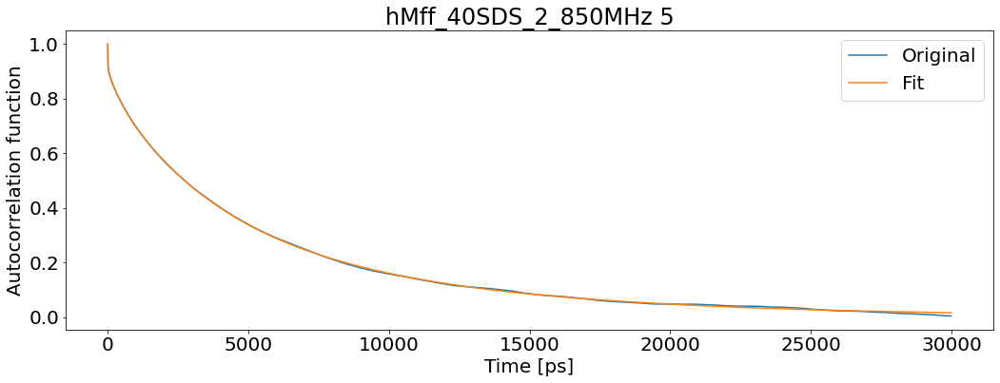

T1: 0.7186797045504886 T2: 0.09927734468740071 NOE: 0.7244931633139877


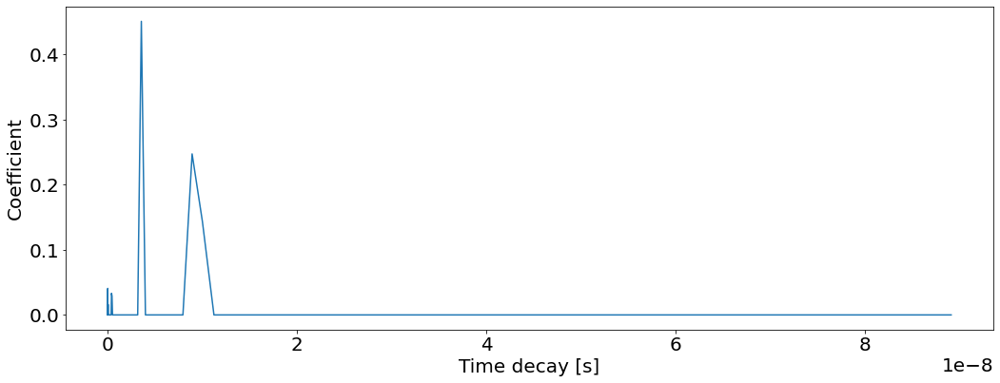

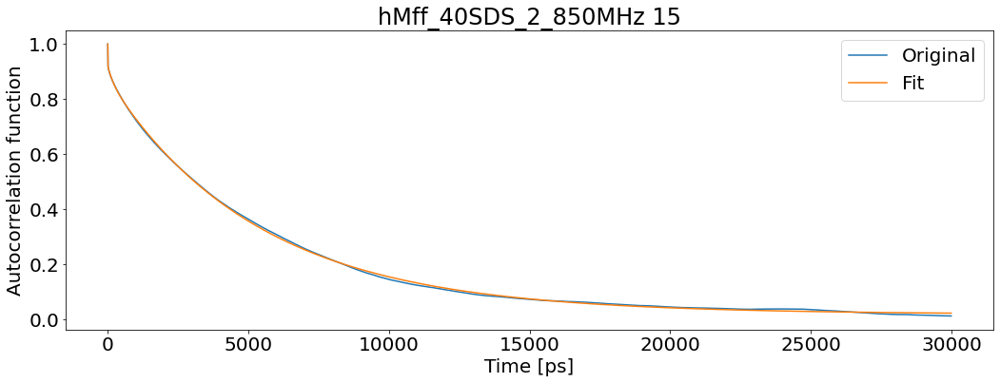

T1: 0.7385404965309162 T2: 0.07658831212502386 NOE: 0.7479463584668412


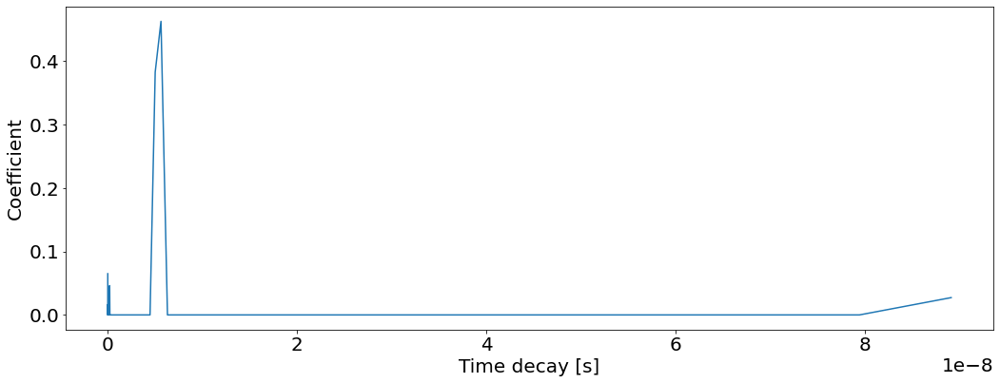

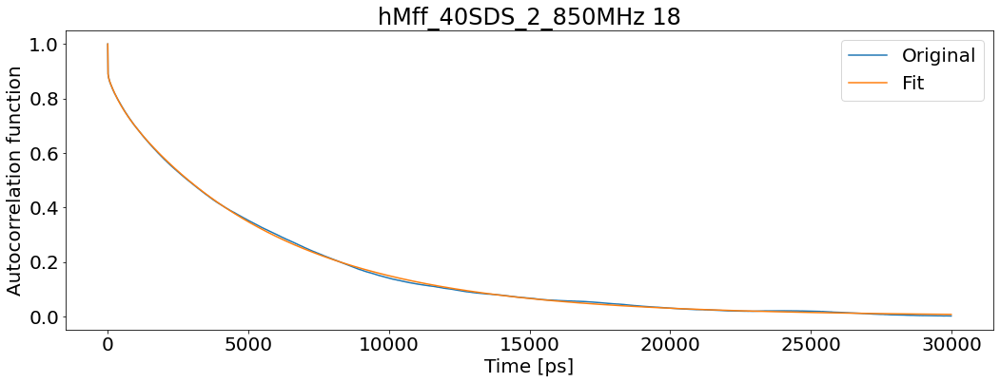

T1: 0.7877240012829787 T2: 0.10570543748845819 NOE: 0.7290591878111867


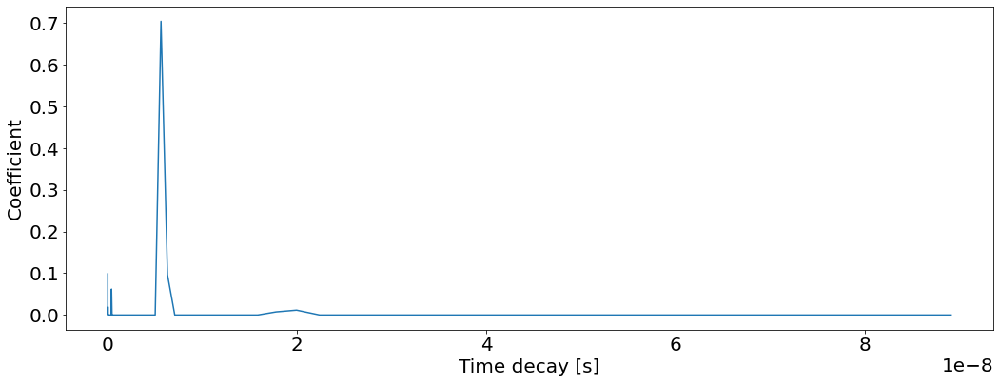

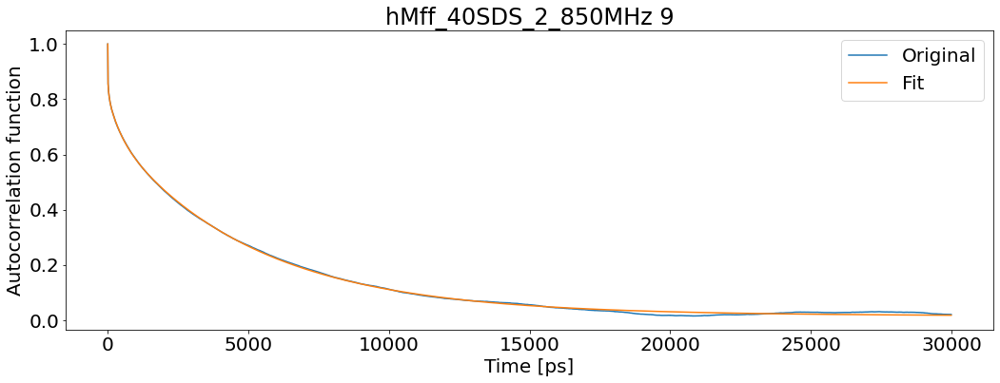

T1: 0.7839410248811123 T2: 0.09753205257958523 NOE: 0.5903464923130084


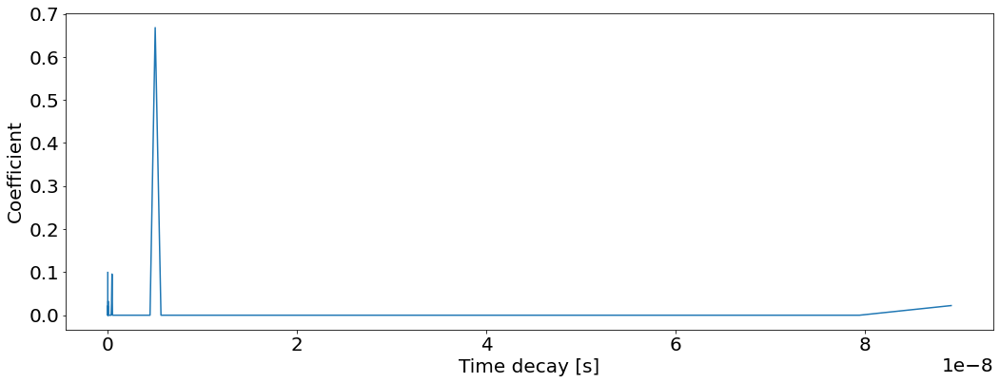

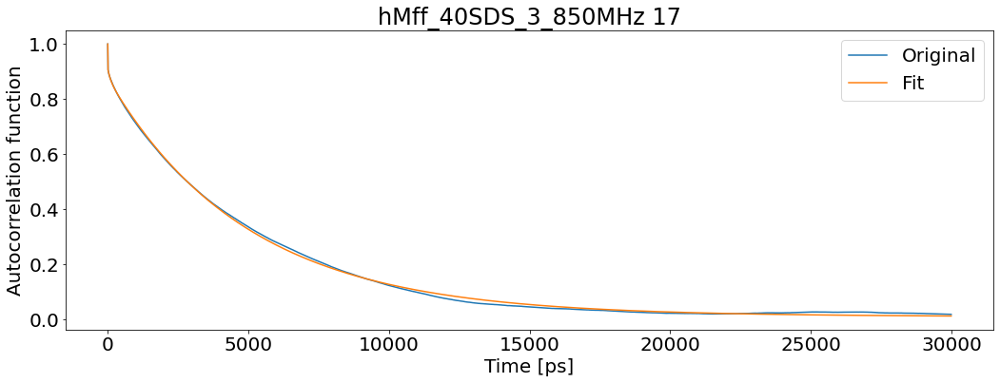

T1: 0.6966119033301689 T2: 0.09480016361787345 NOE: 0.787568231246571


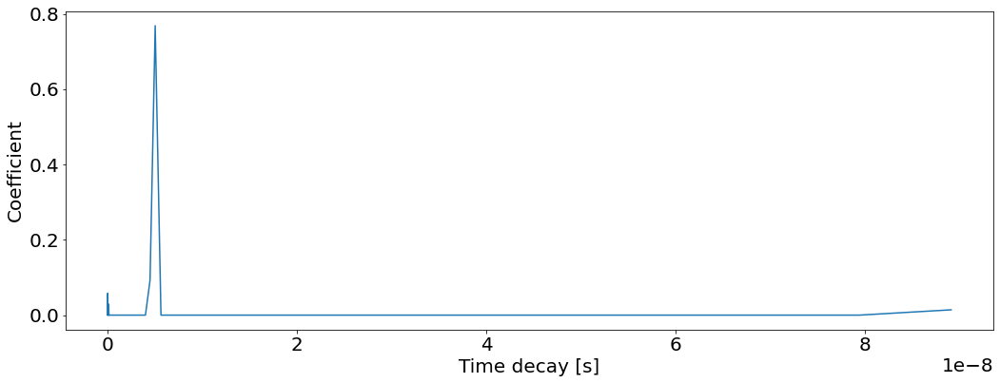

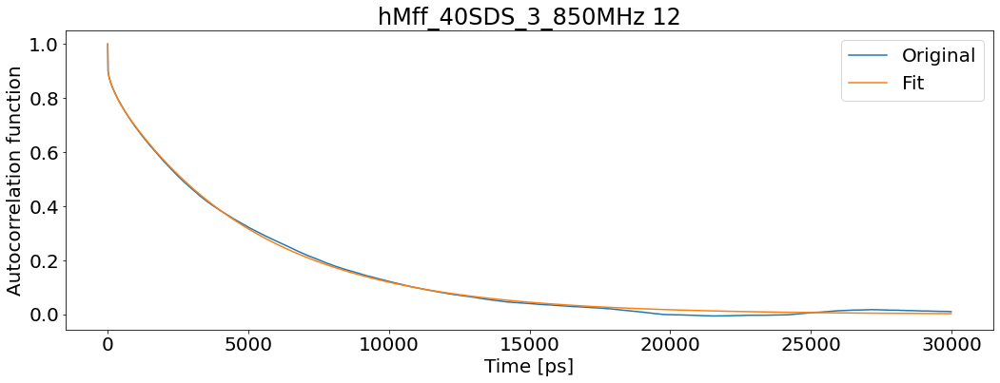

T1: 0.7124128376275144 T2: 0.11926777673439587 NOE: 0.7359464397646678


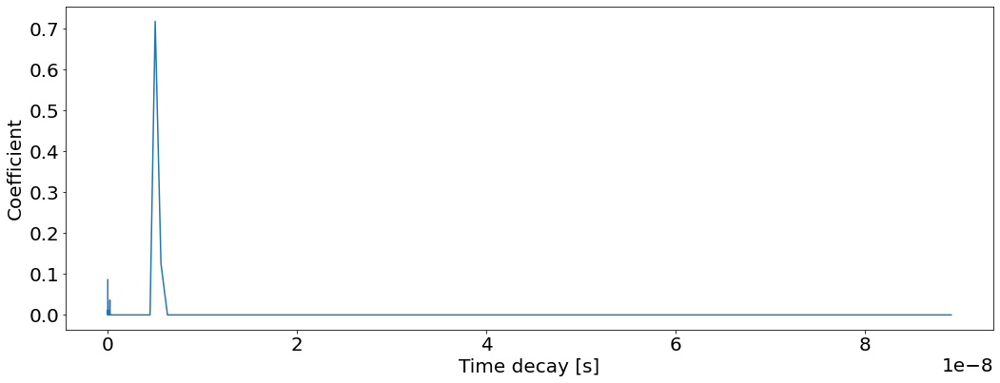

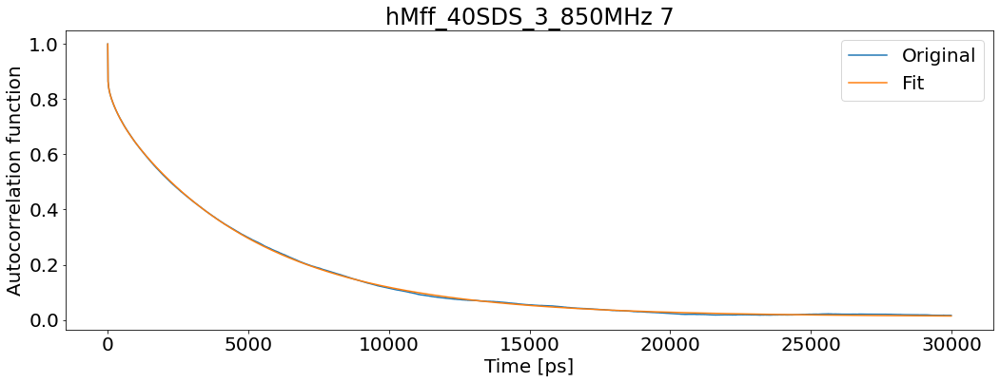

T1: 0.7554113913285723 T2: 0.0984507477569945 NOE: 0.6911314185448688


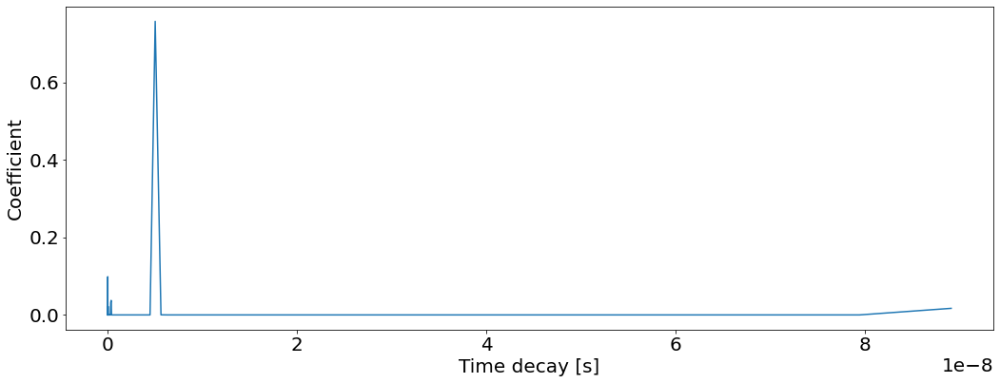

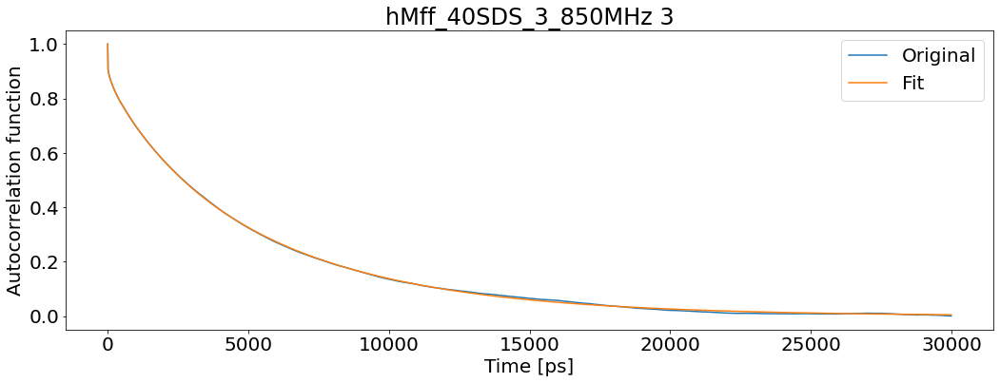

T1: 0.7081429466674776 T2: 0.11163729171576421 NOE: 0.7461839351580724


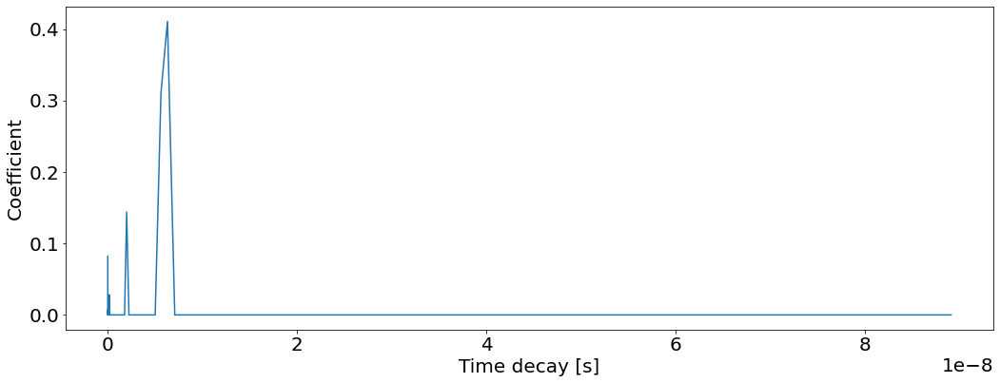

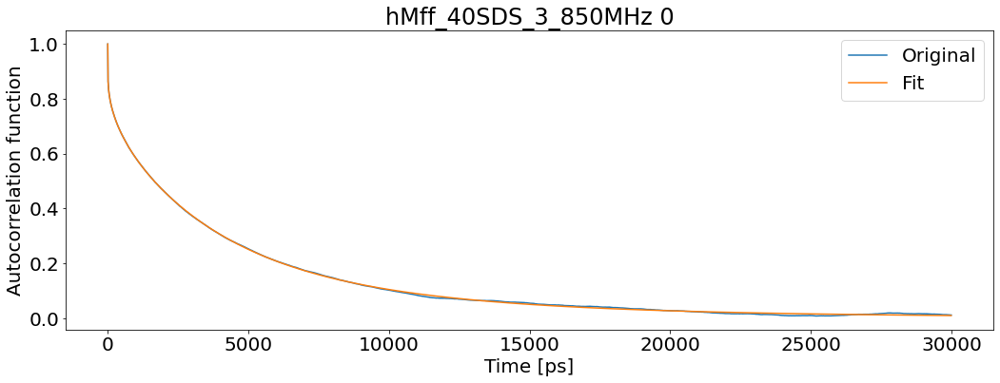

T1: 0.7231065754450883 T2: 0.1252560605009452 NOE: 0.6208593458947392


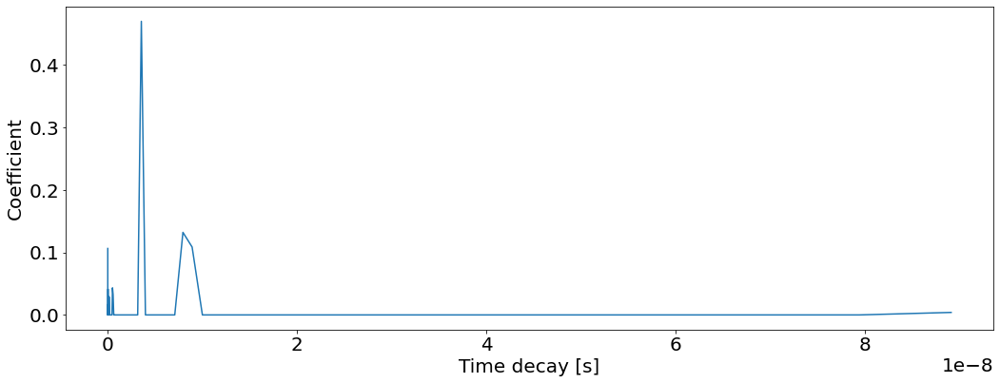

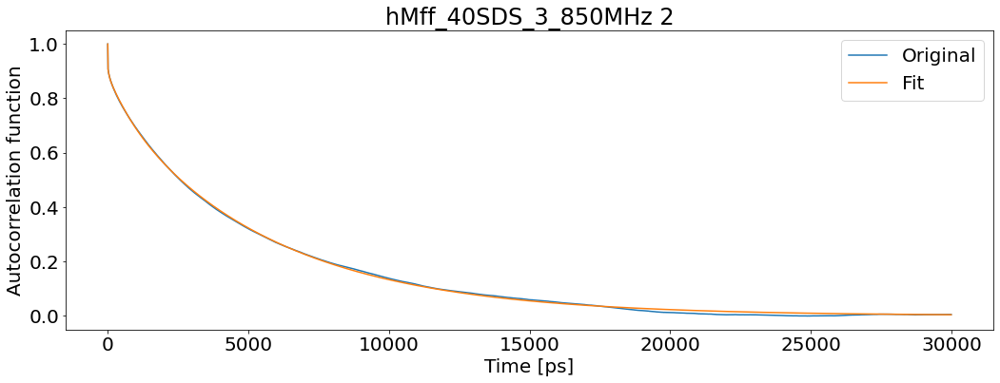

T1: 0.7214382706579431 T2: 0.11465301515507649 NOE: 0.7449483672865604


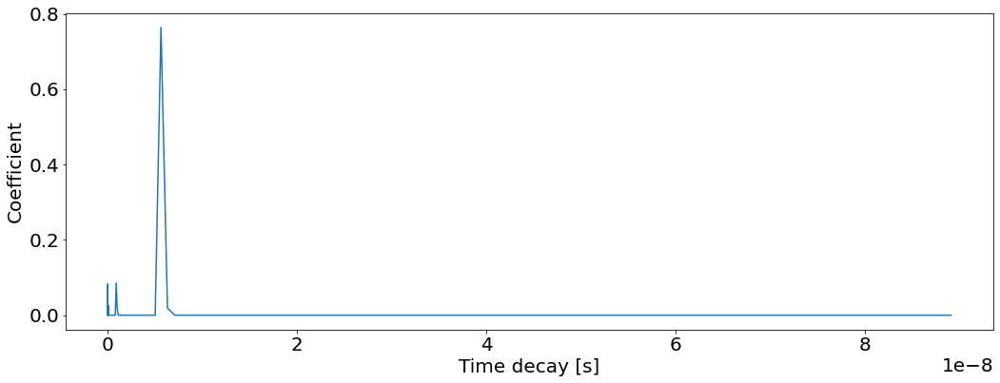

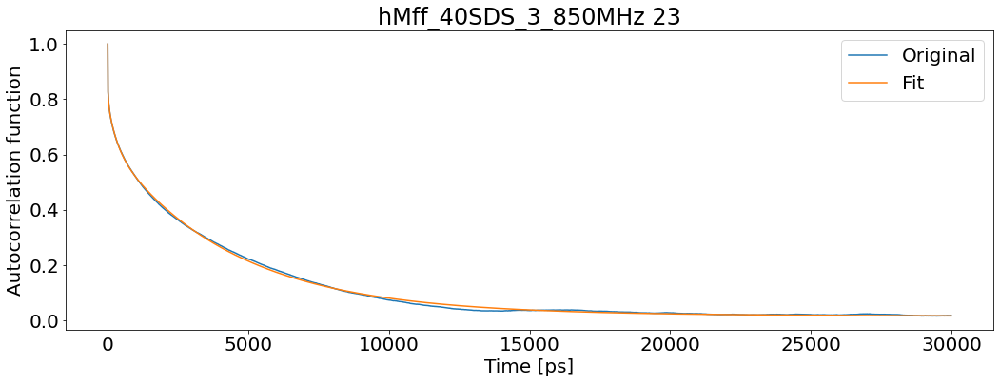

T1: 0.7618765297117152 T2: 0.11182992879604343 NOE: 0.5095061531941155


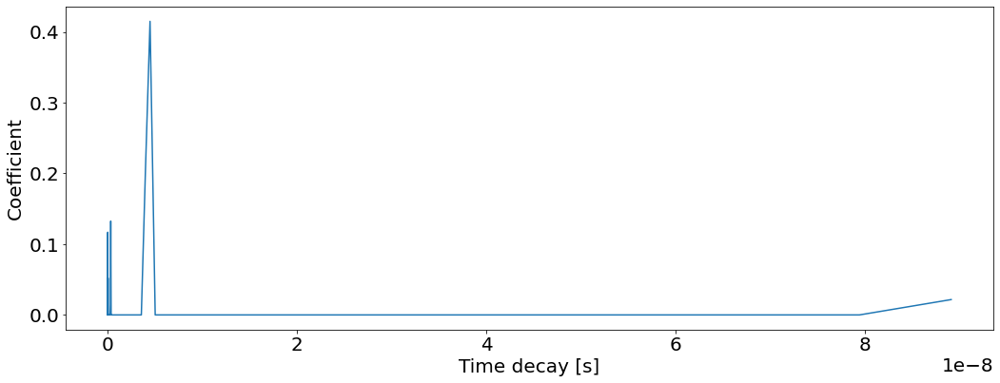

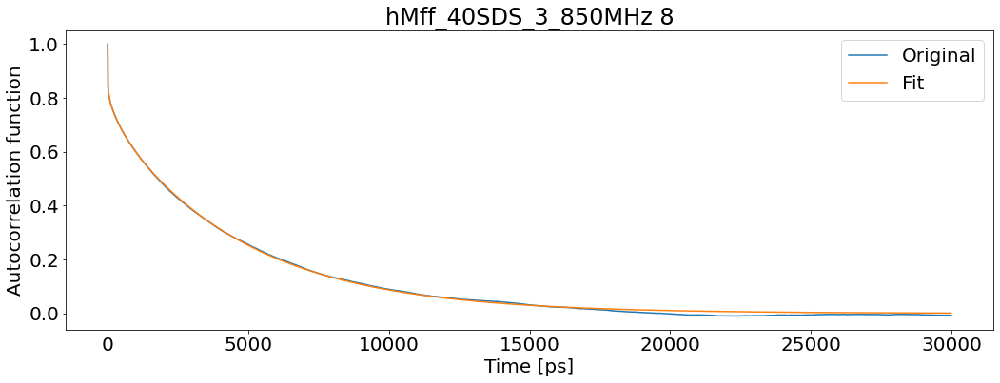

T1: 0.7314850353979755 T2: 0.14538727829811812 NOE: 0.6816297103539395


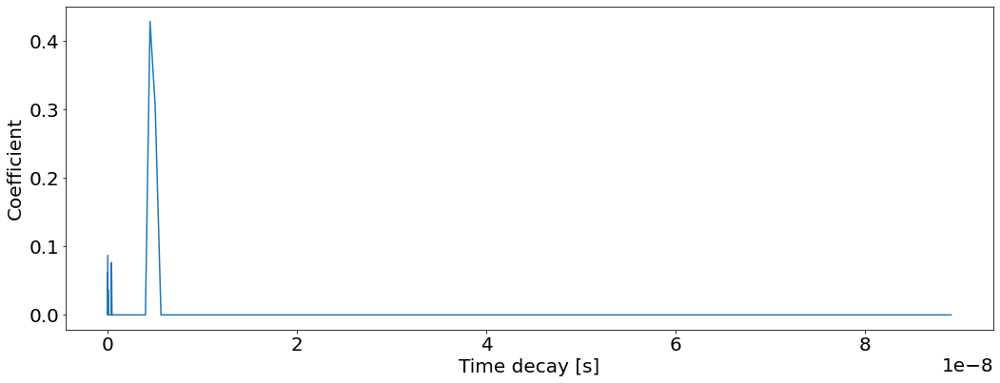

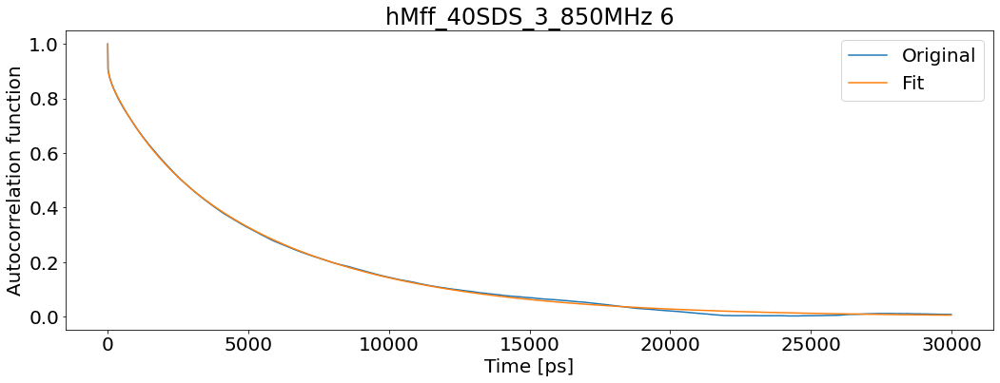

T1: 0.716926864078377 T2: 0.11052416879206792 NOE: 0.7538969399892853


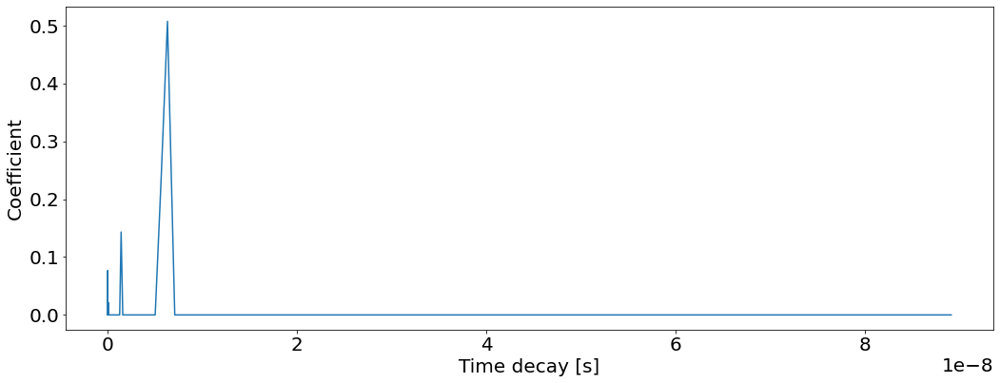

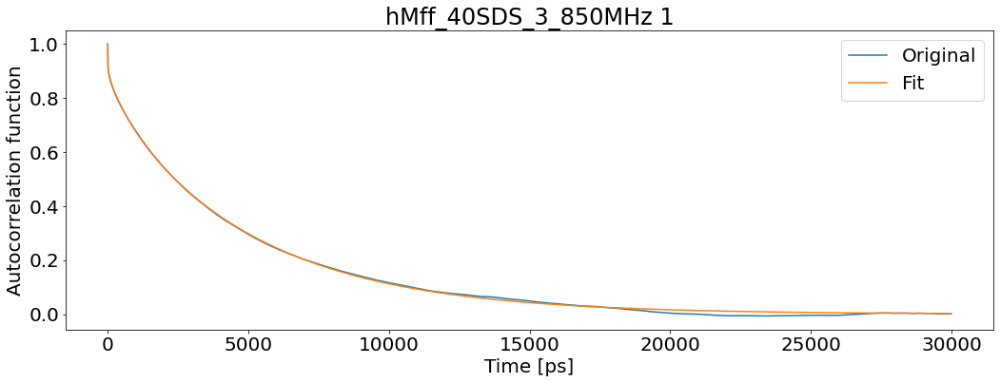

T1: 0.6854134775313163 T2: 0.12370318579845206 NOE: 0.7312829881137528


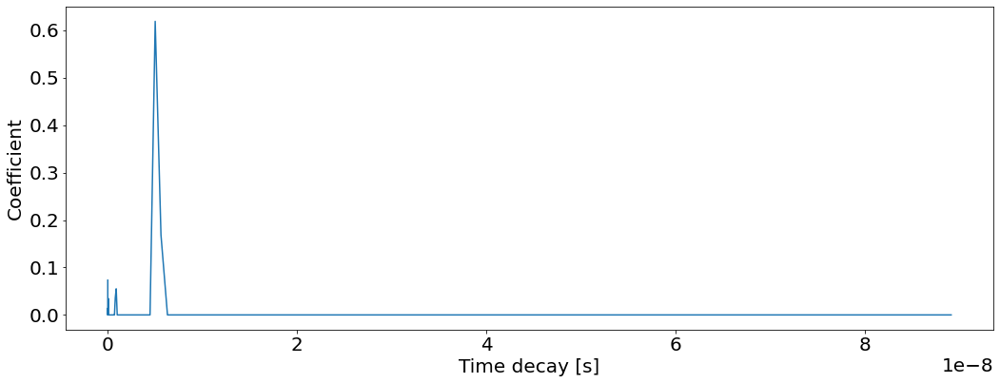

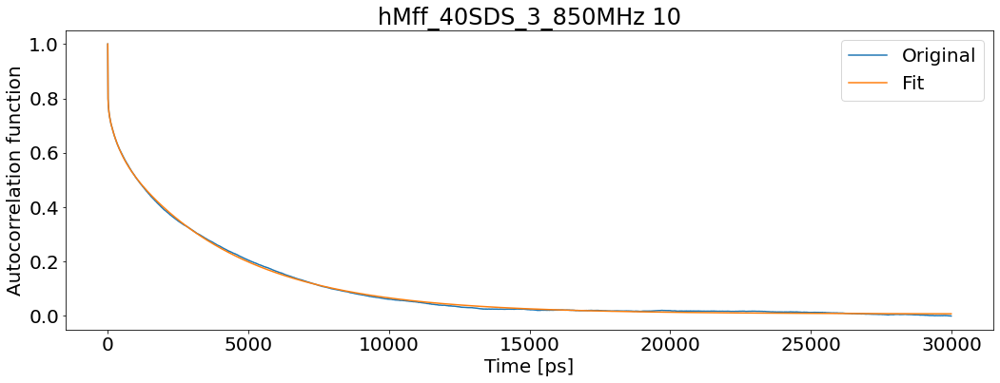

T1: 0.7539575505359342 T2: 0.14243998563183607 NOE: 0.5704278232007998


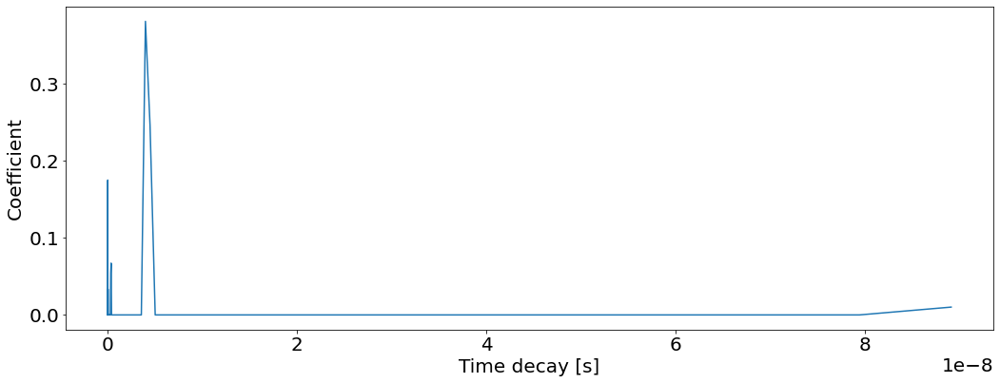

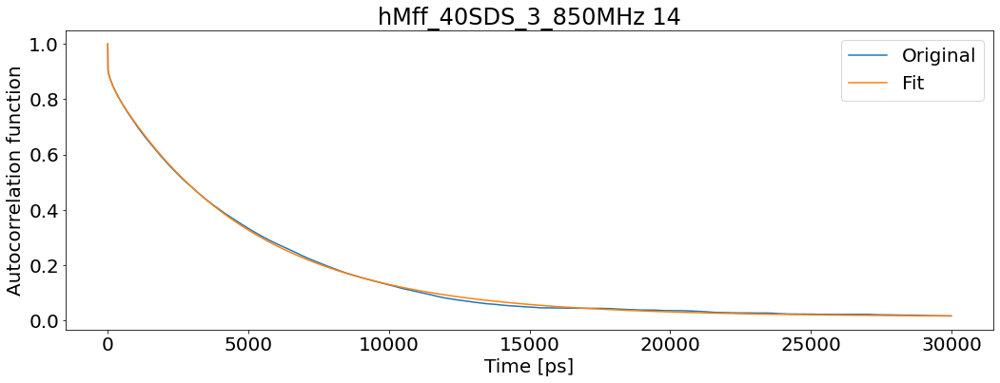

T1: 0.702063644217268 T2: 0.0883396591623591 NOE: 0.7713168950561557


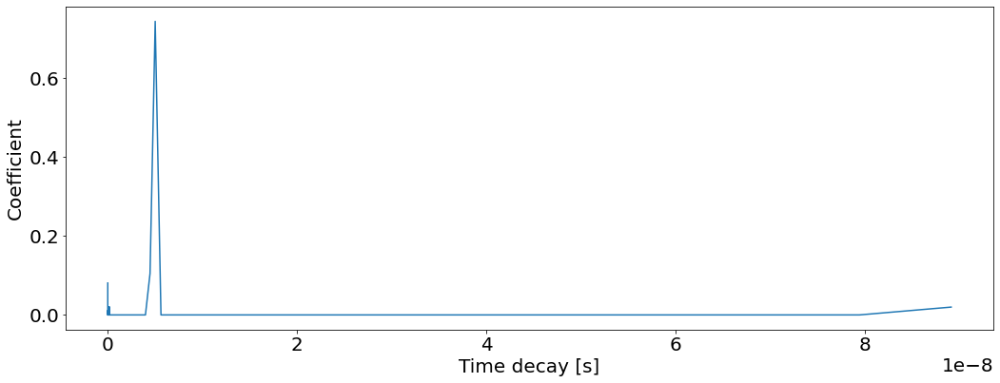

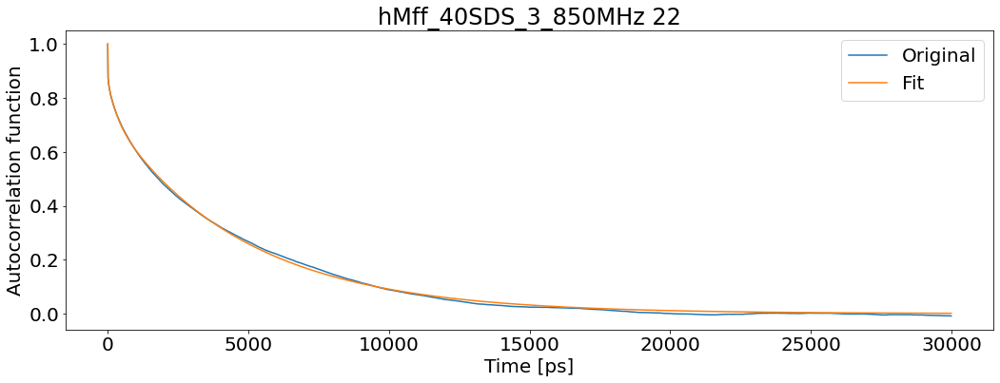

T1: 0.7144457853839343 T2: 0.14138670122411257 NOE: 0.6092836103843245


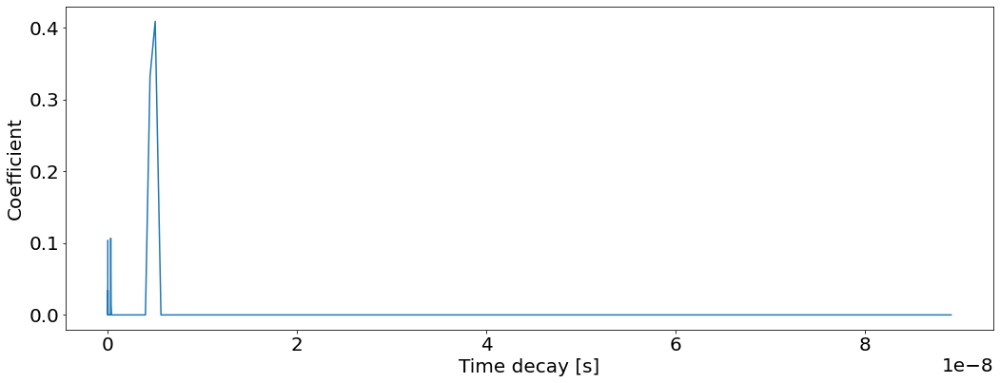

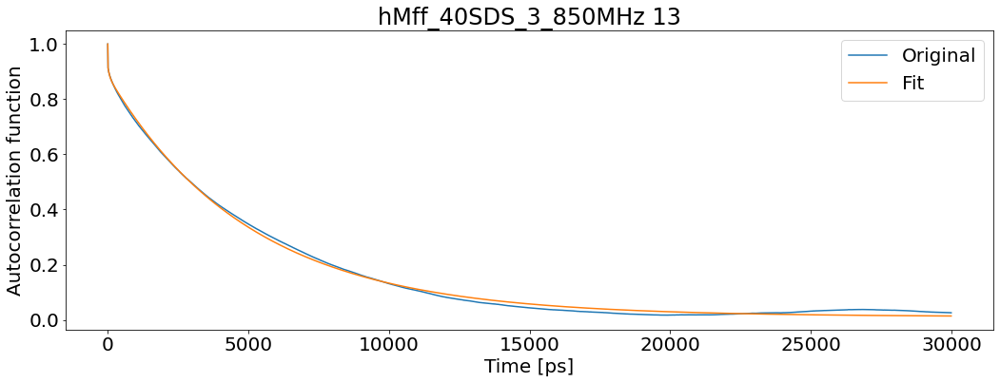

T1: 0.7011140498885973 T2: 0.09013371966451929 NOE: 0.8060138781474071


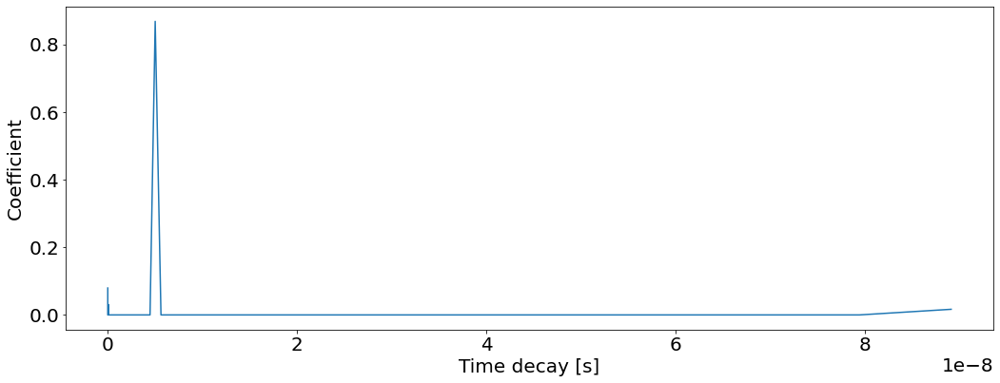

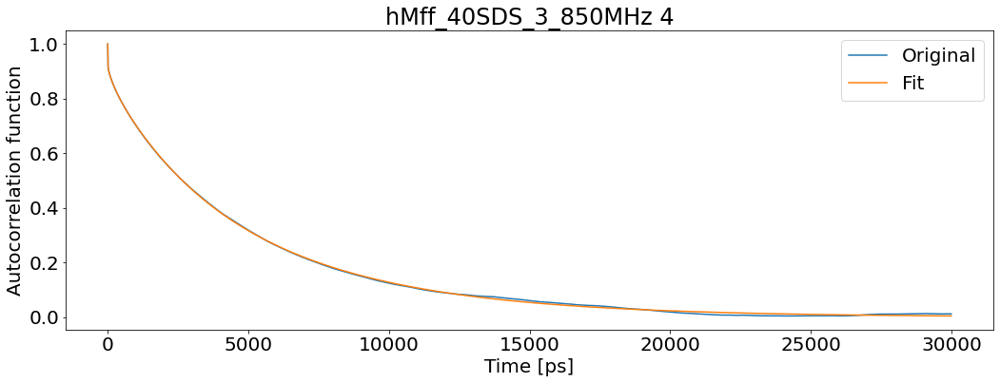

T1: 0.678048420482659 T2: 0.11440552651610263 NOE: 0.749876491807393


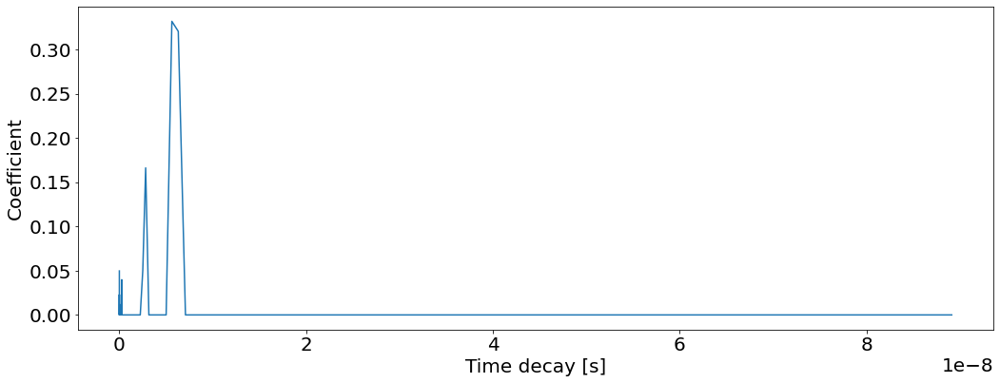

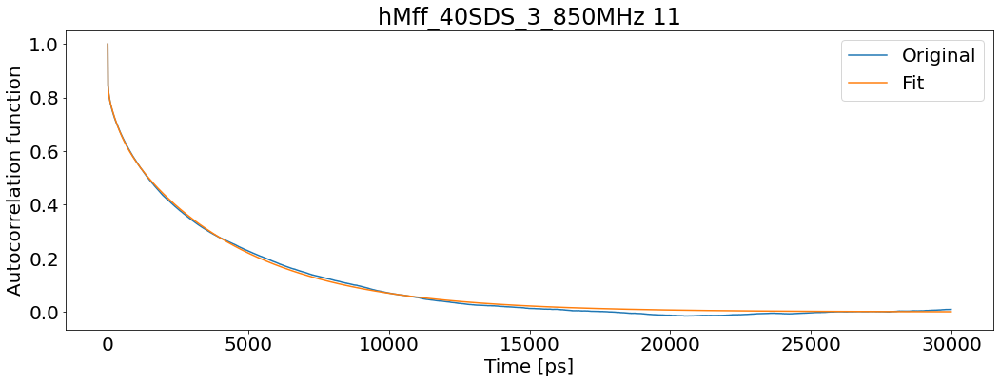

T1: 0.6992210360758169 T2: 0.16131845110426707 NOE: 0.6217139743444686


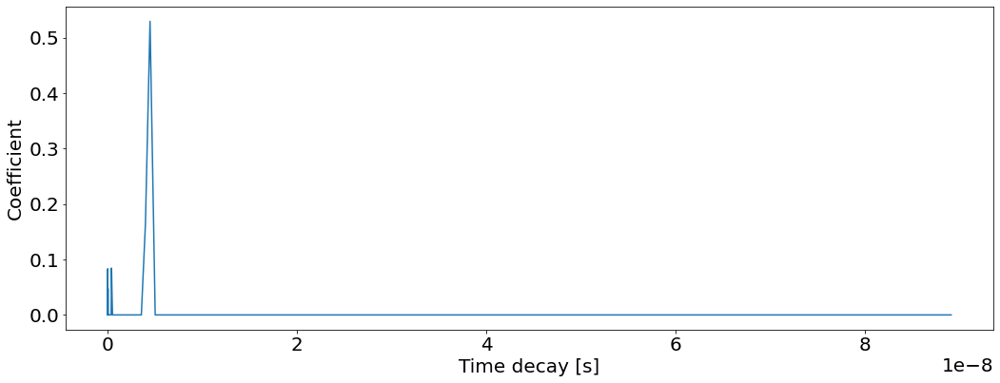

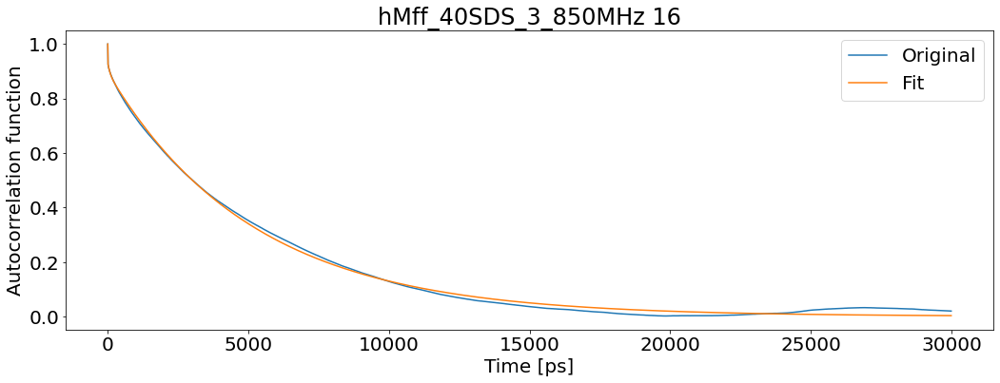

T1: 0.6953811407702759 T2: 0.10901453399408027 NOE: 0.7986909191991723


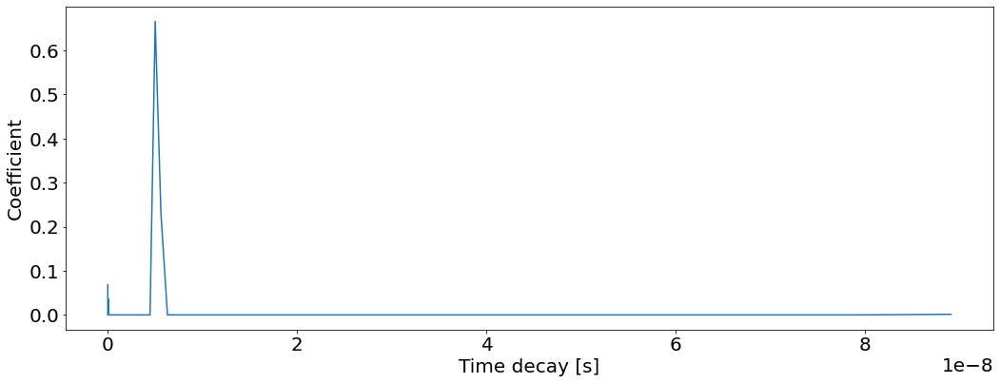

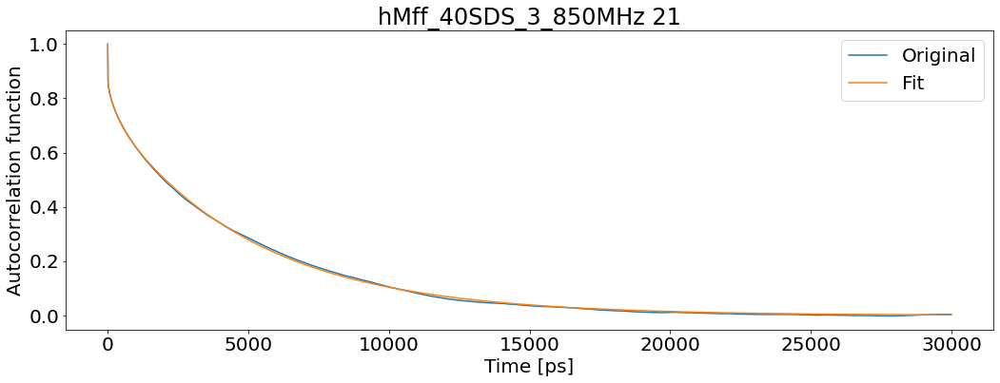

T1: 0.7520924723720955 T2: 0.1335386912973886 NOE: 0.6515857360578383


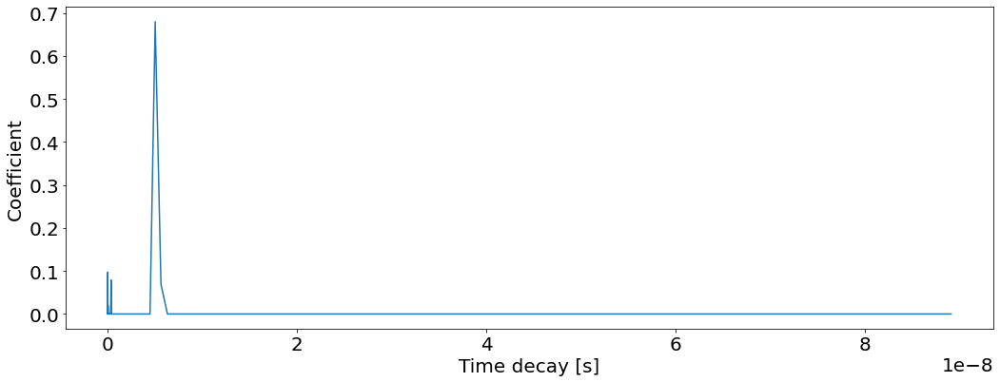

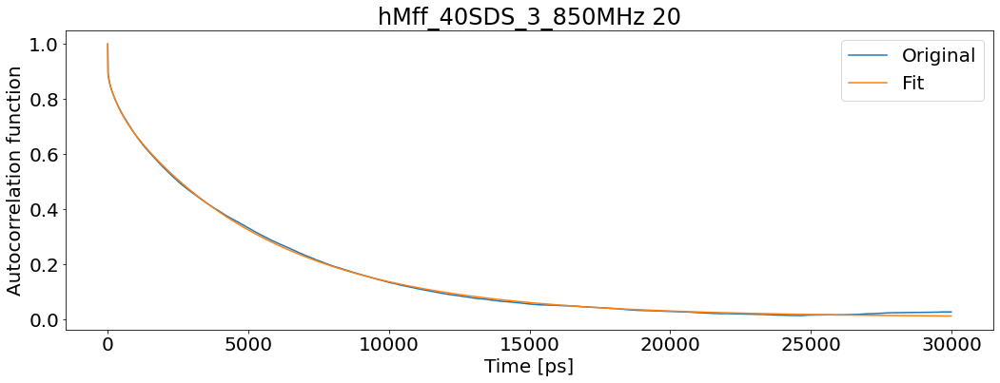

T1: 0.7680696855092521 T2: 0.09520793647158006 NOE: 0.6725940141410403


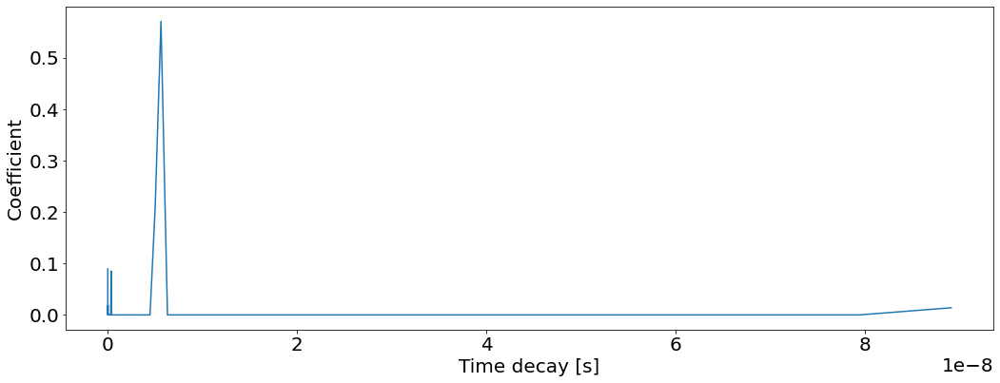

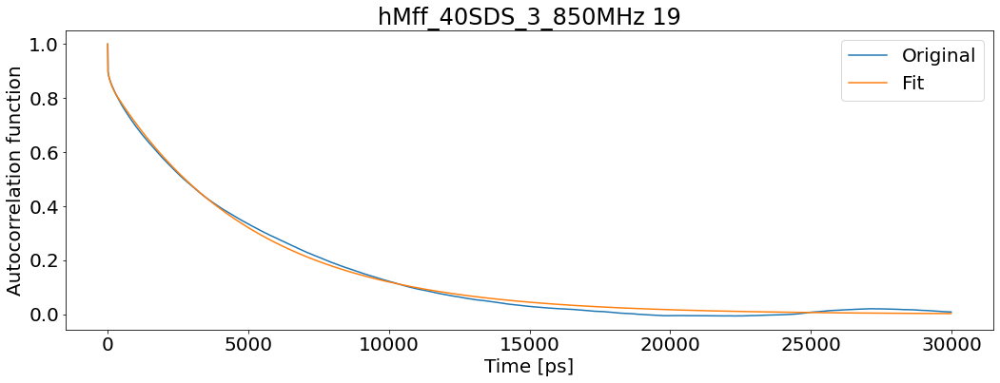

T1: 0.7087821399299532 T2: 0.11811501086879377 NOE: 0.785393444474836


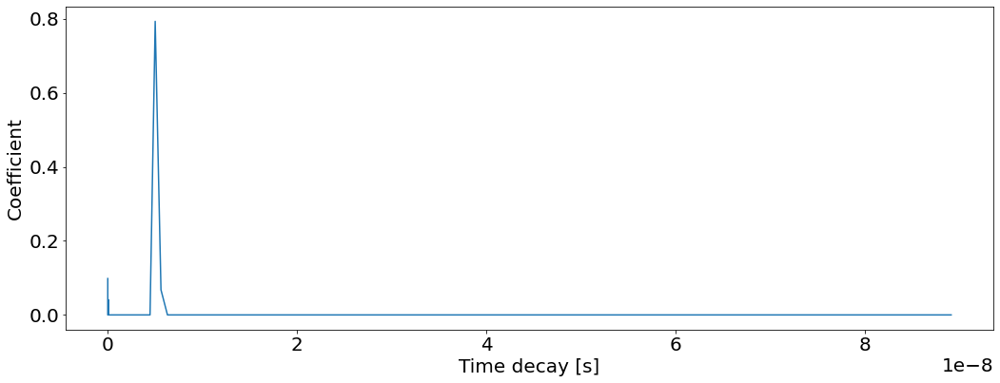

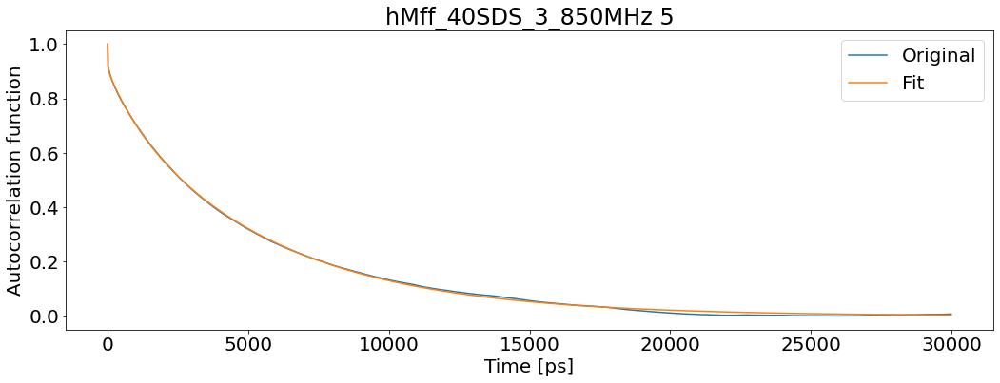

T1: 0.6888124972701731 T2: 0.11449031467873462 NOE: 0.7631663393498943


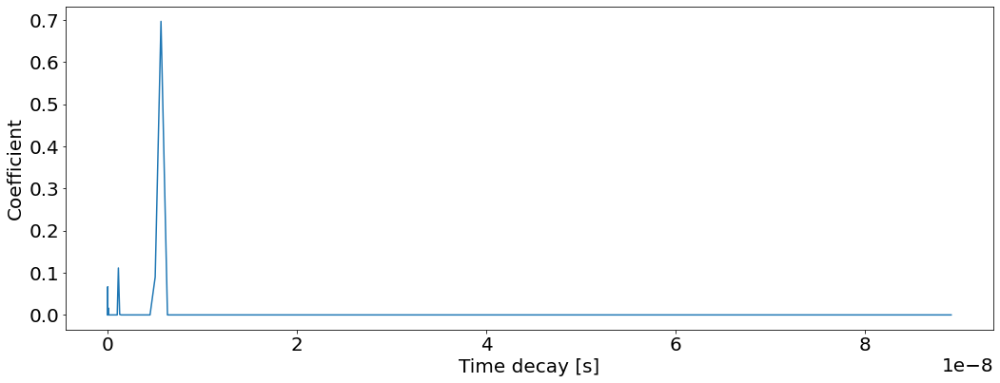

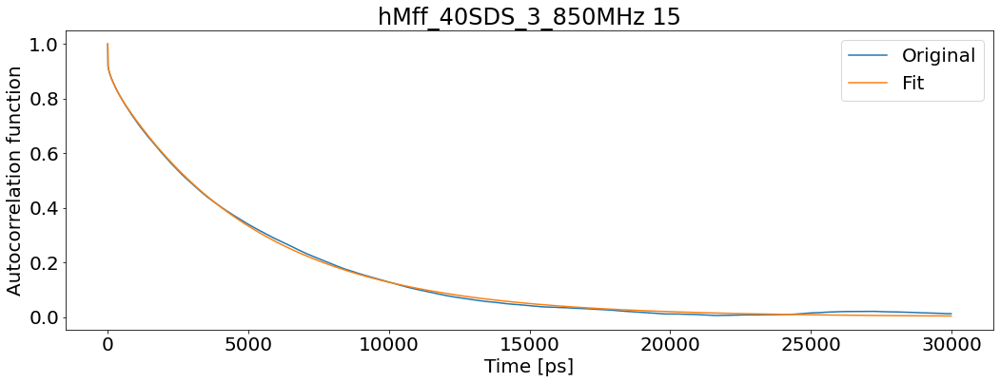

T1: 0.7003906259640881 T2: 0.11069395707775997 NOE: 0.7634302292229395


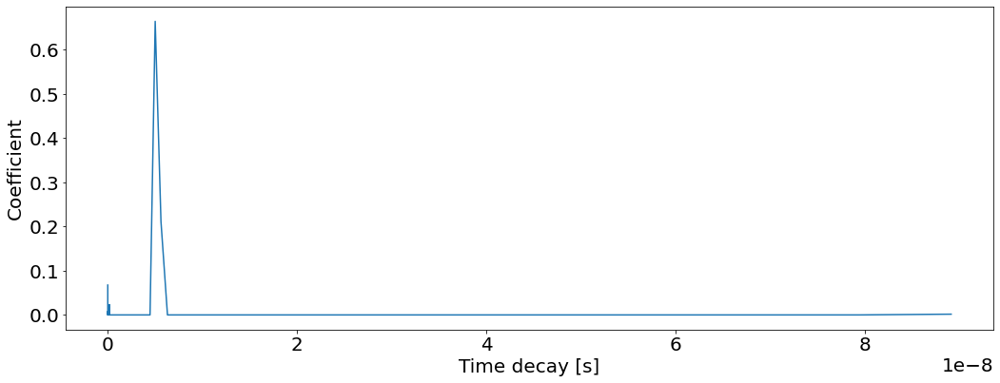

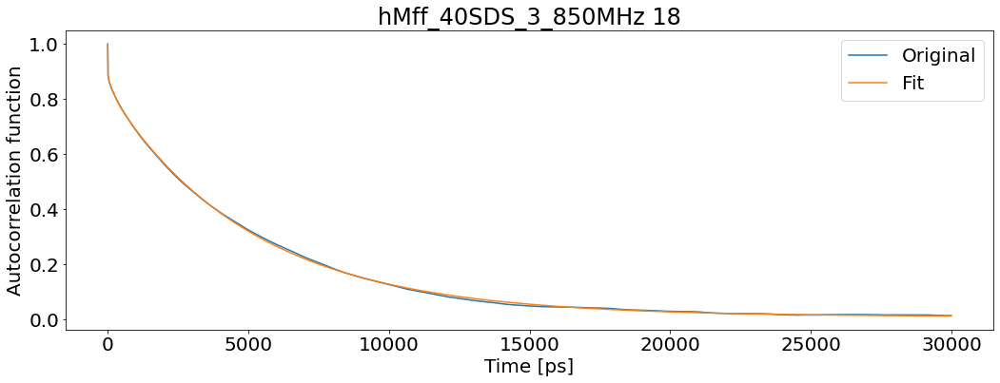

T1: 0.7308085869270696 T2: 0.09819830231964456 NOE: 0.7457515920766966


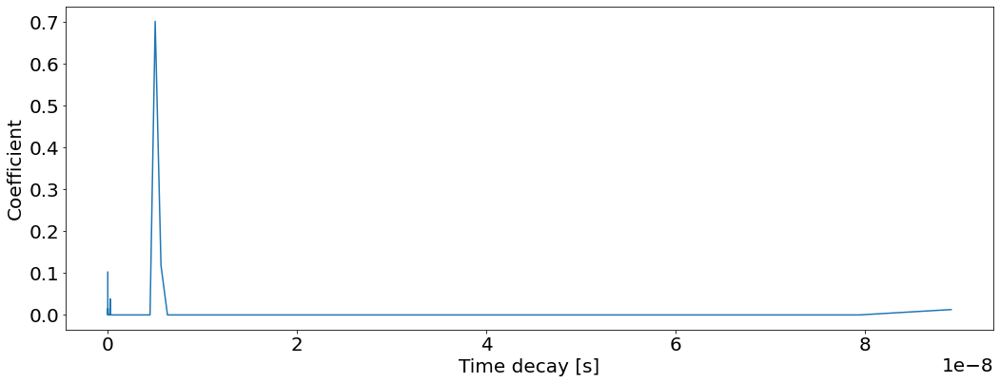

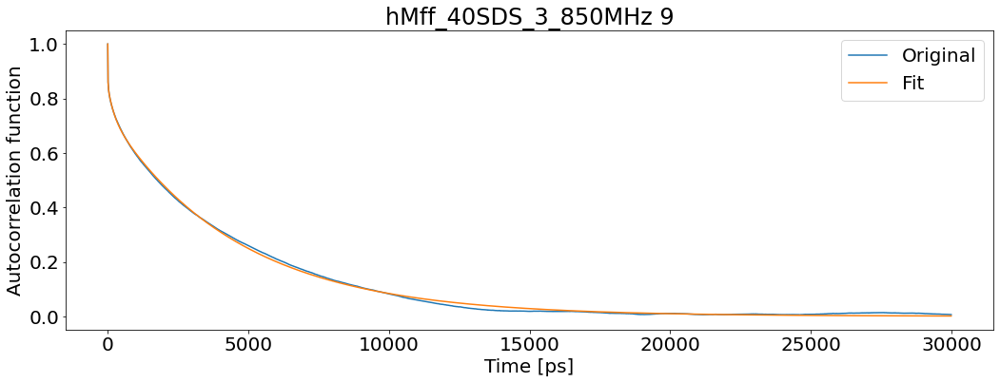

T1: 0.7167332496103729 T2: 0.14463084048682737 NOE: 0.6280325169523172


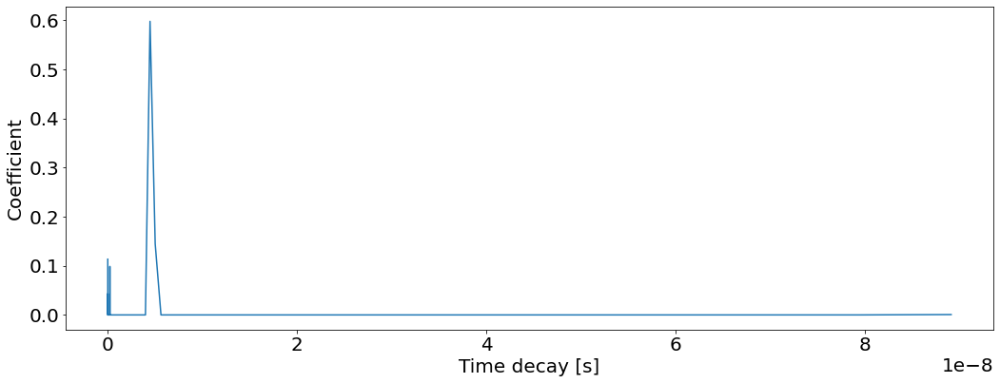

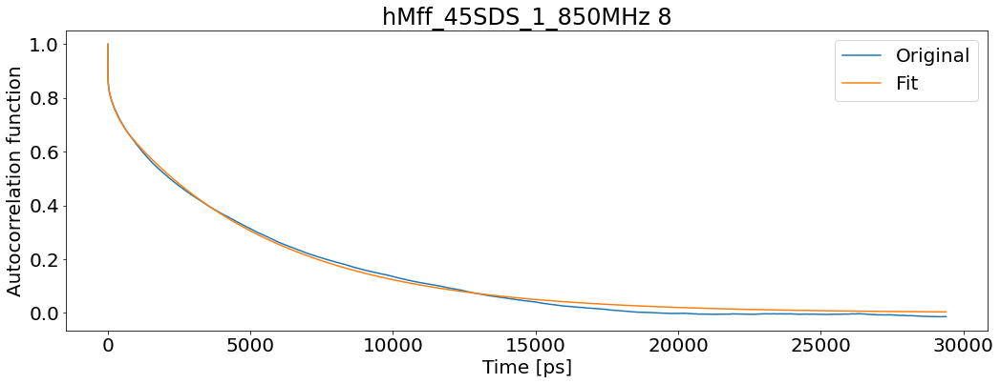

T1: 0.8065333028988853 T2: 0.12347804941430048 NOE: 0.6285483161608534


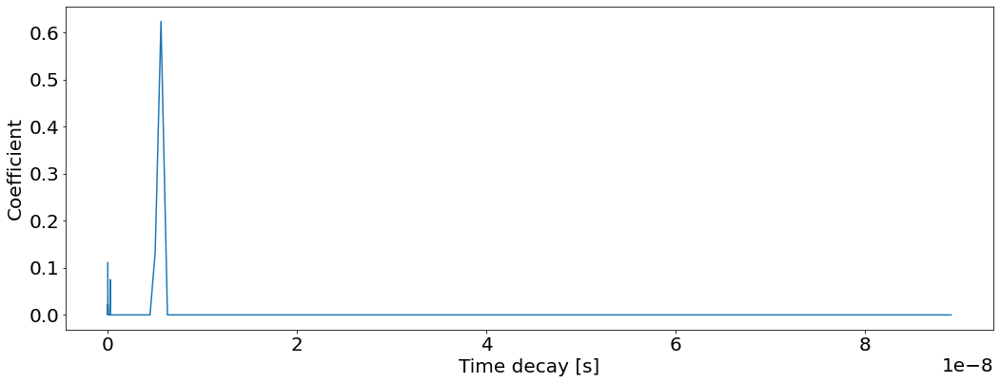

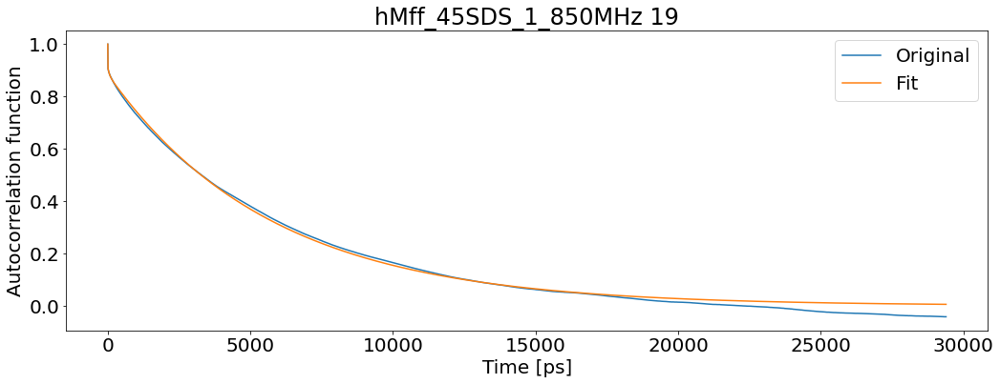

T1: 0.7660687345784762 T2: 0.10343856784564358 NOE: 0.8185317361090514


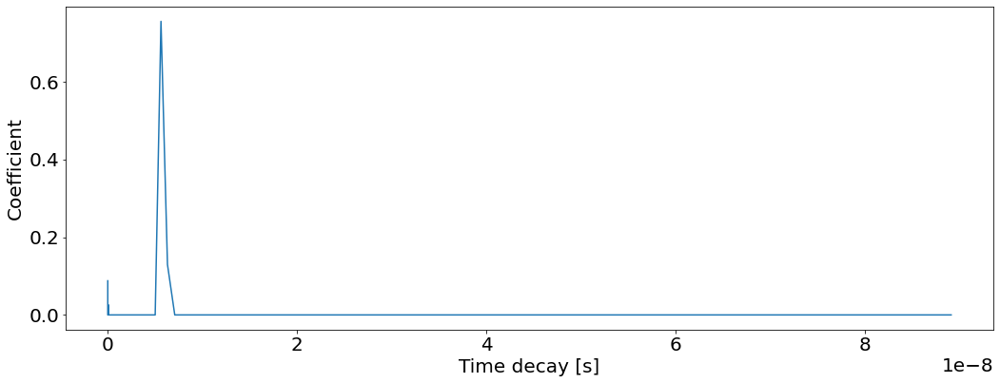

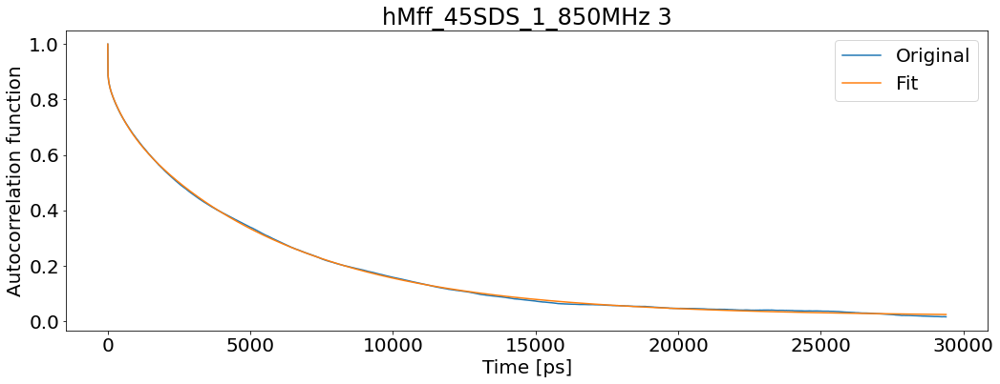

T1: 0.8086805138379203 T2: 0.07974709332656732 NOE: 0.6706927345433782


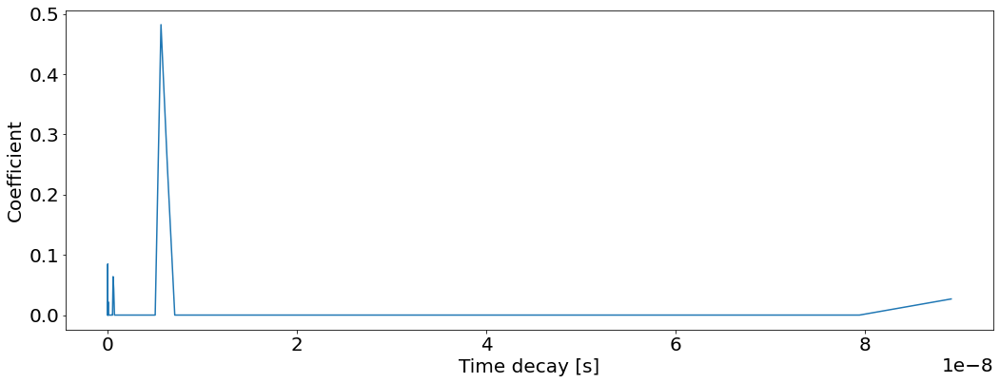

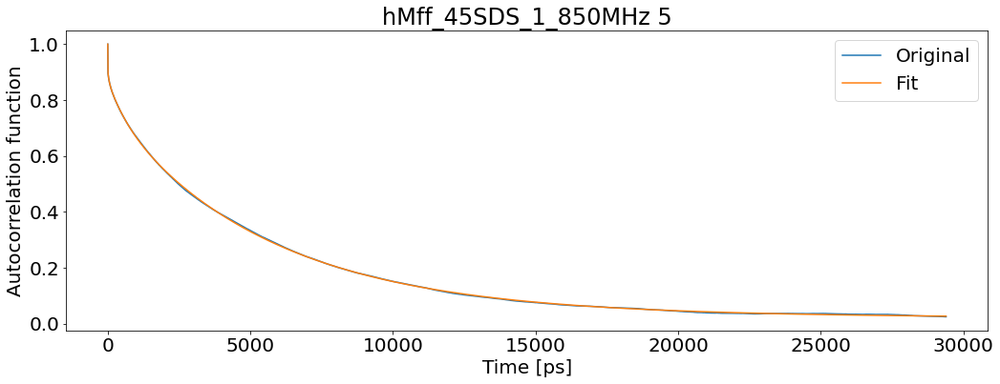

T1: 0.7738421075122116 T2: 0.07606421887282534 NOE: 0.6904977826751628


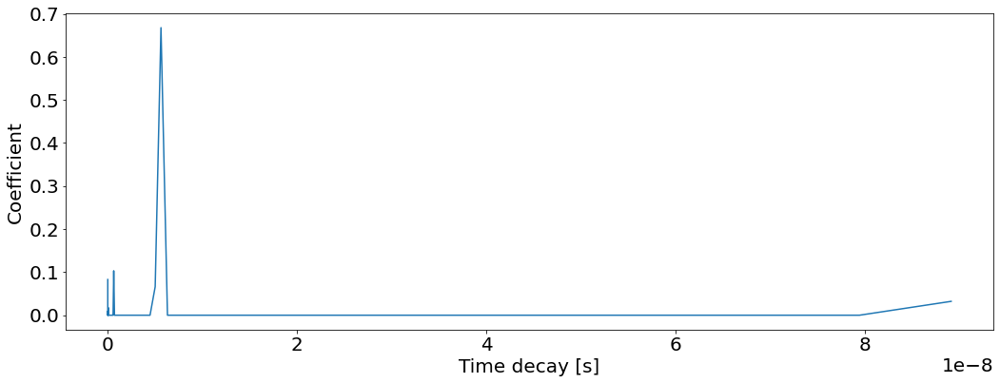

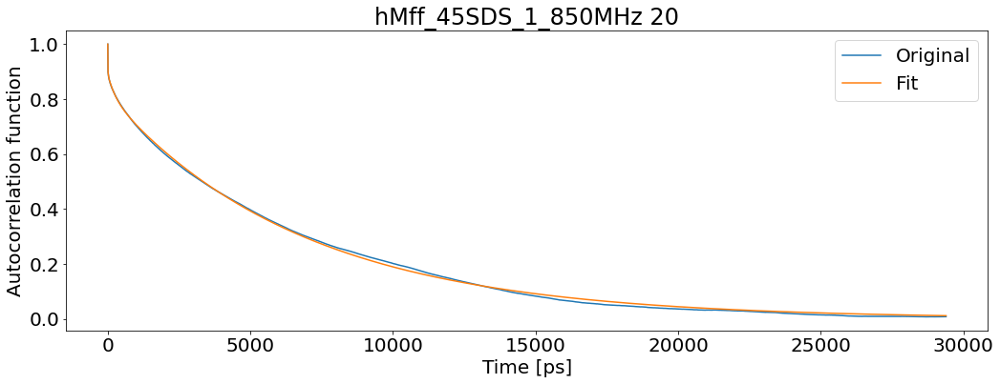

T1: 0.9008066754253784 T2: 0.09499483145637588 NOE: 0.66226029357021


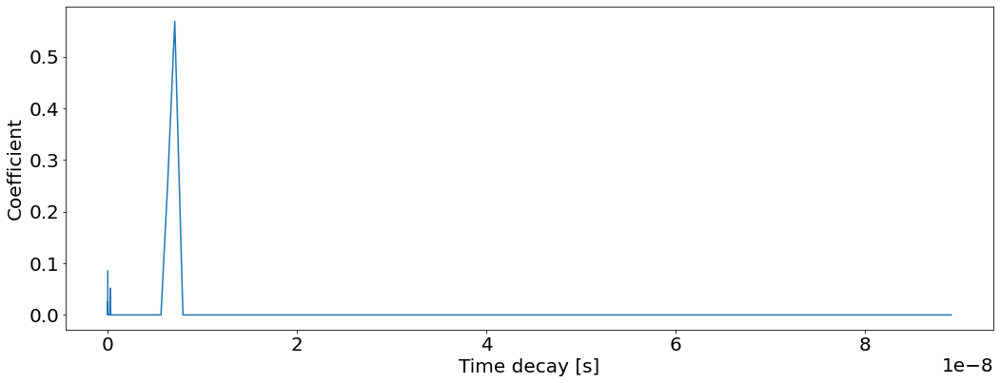

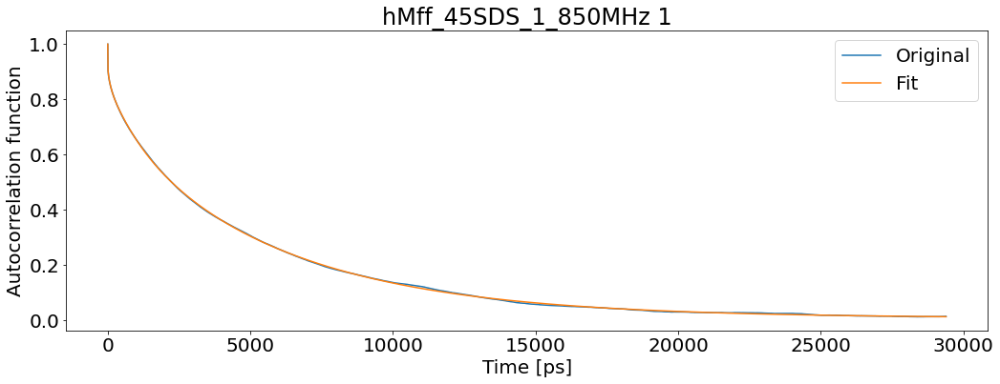

T1: 0.7230538616892825 T2: 0.10193344294971379 NOE: 0.6853779992353174


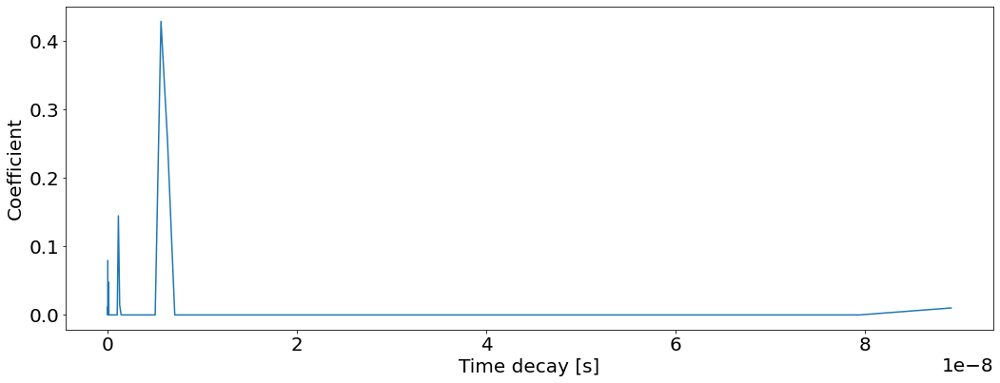

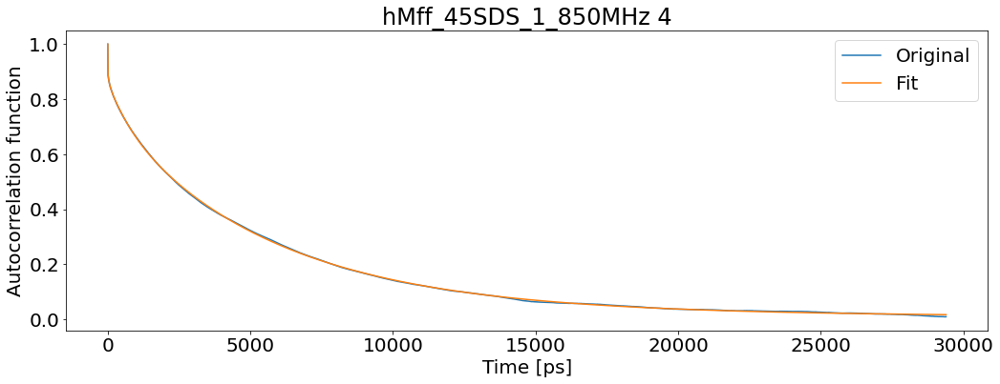

T1: 0.7628830373430276 T2: 0.10039593132444503 NOE: 0.7028090787126431


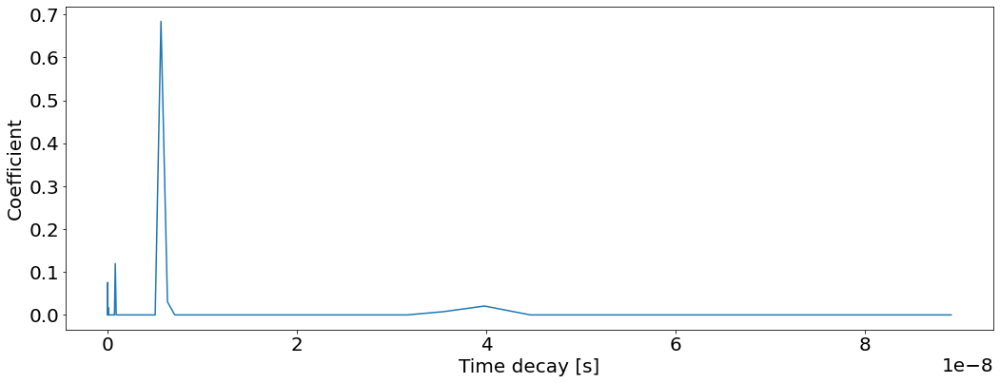

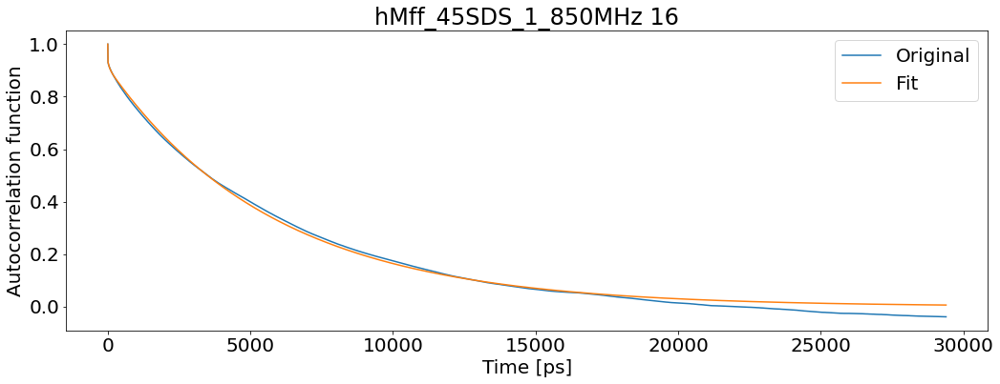

T1: 0.7559578518754085 T2: 0.09882855838849046 NOE: 0.8188345137221208


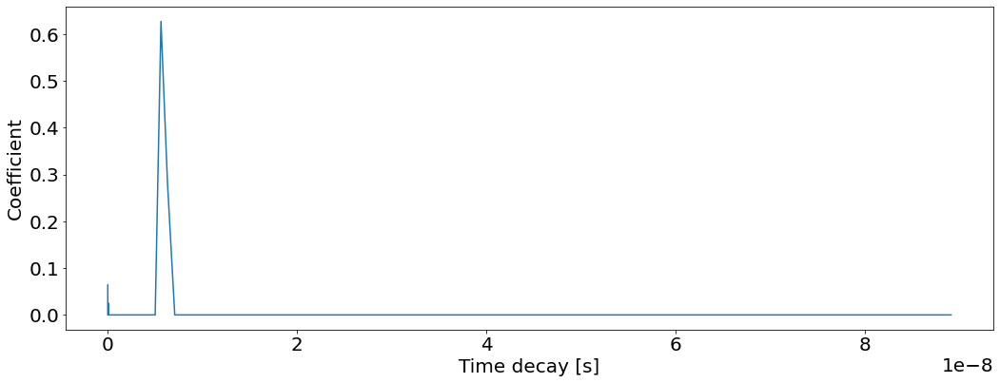

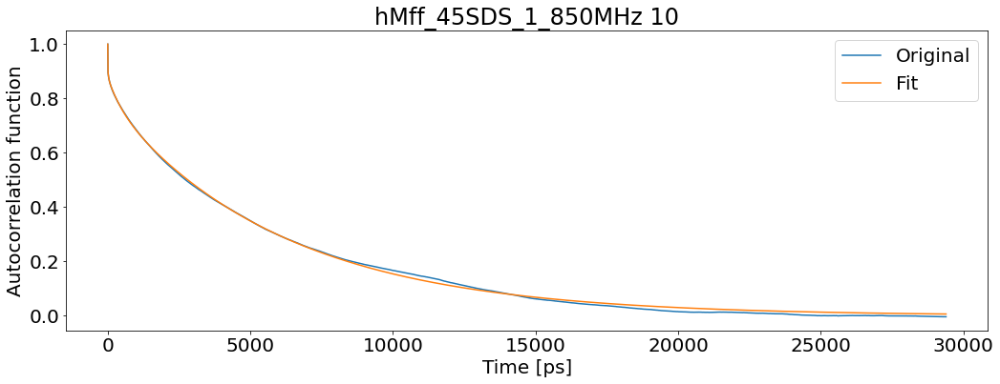

T1: 0.8136798720008096 T2: 0.10739907246419224 NOE: 0.6922248849286927


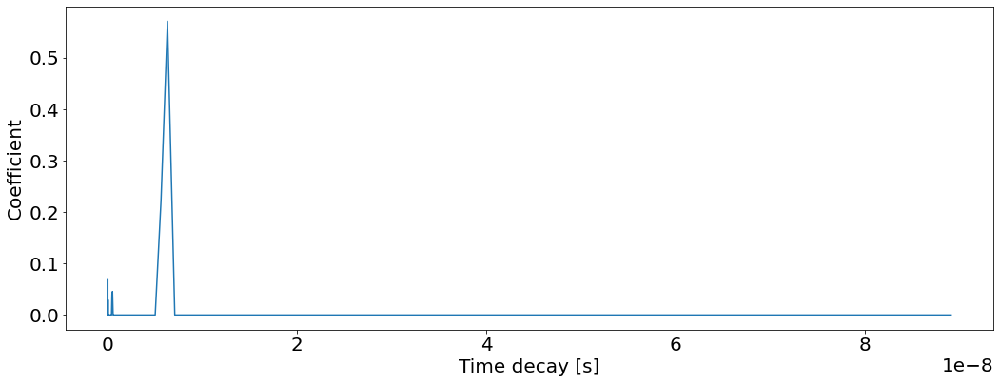

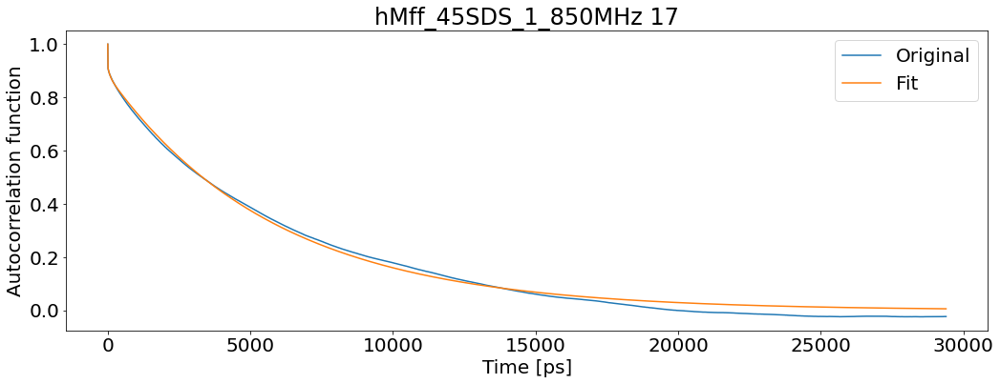

T1: 0.7787790174255385 T2: 0.10157996766945868 NOE: 0.8007850924983673


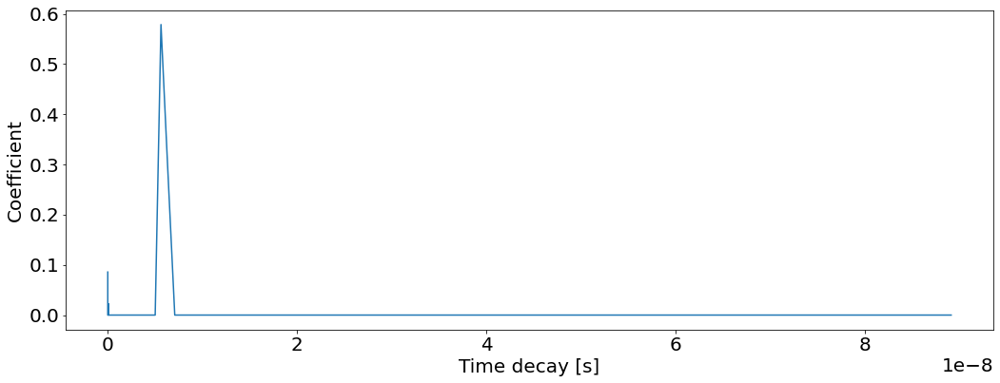

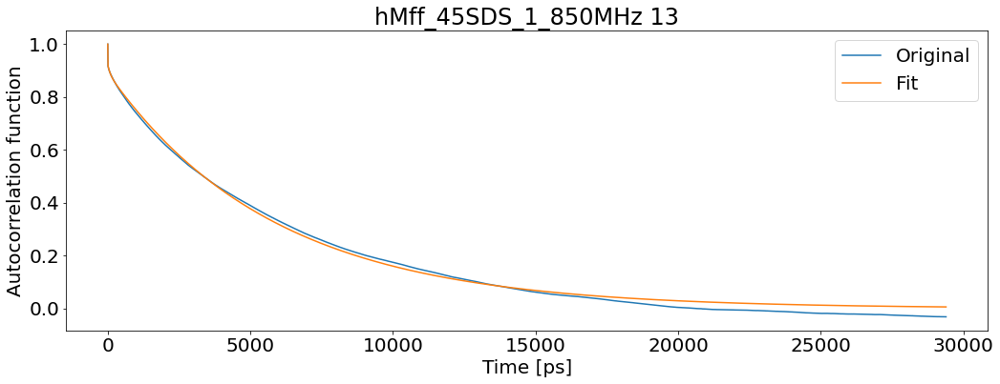

T1: 0.767890537684075 T2: 0.10107091196047667 NOE: 0.8007528393048444


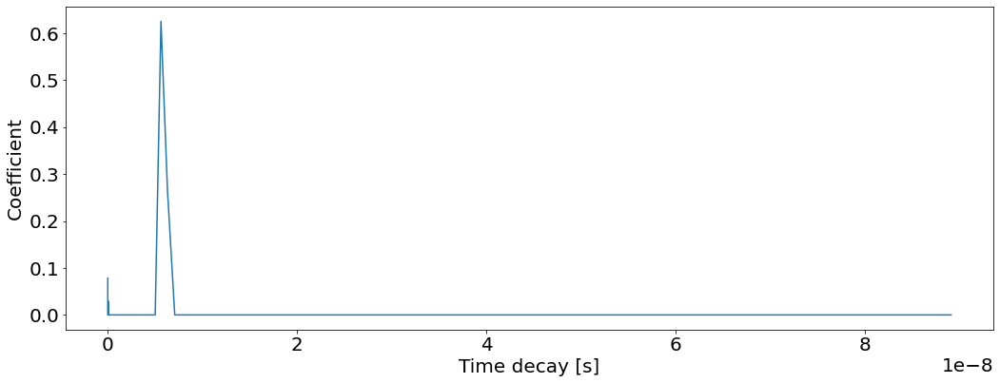

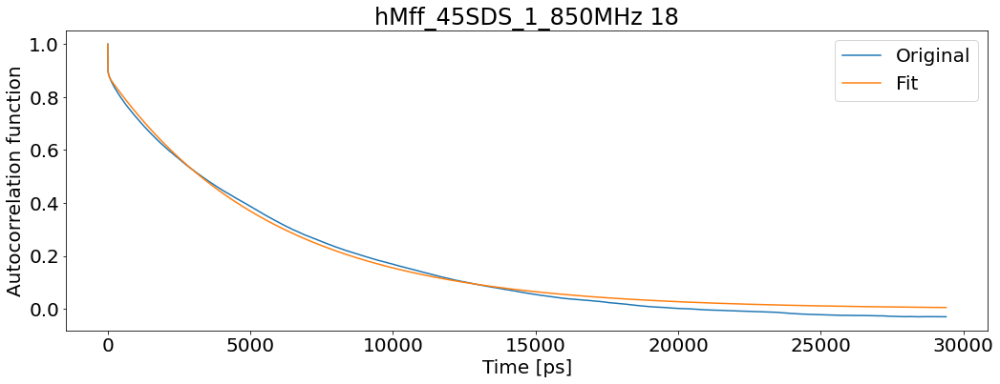

T1: 0.7753733443558316 T2: 0.10343492525619633 NOE: 0.8334320045768564


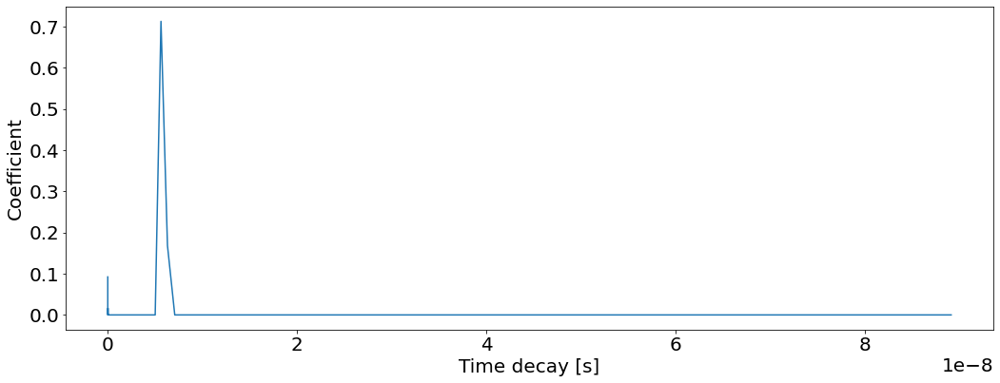

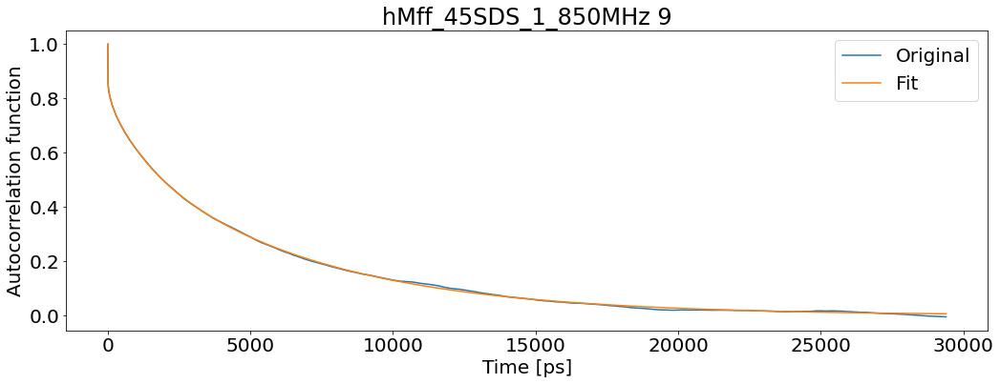

T1: 0.7782668731158761 T2: 0.12326701975528126 NOE: 0.66256892042648


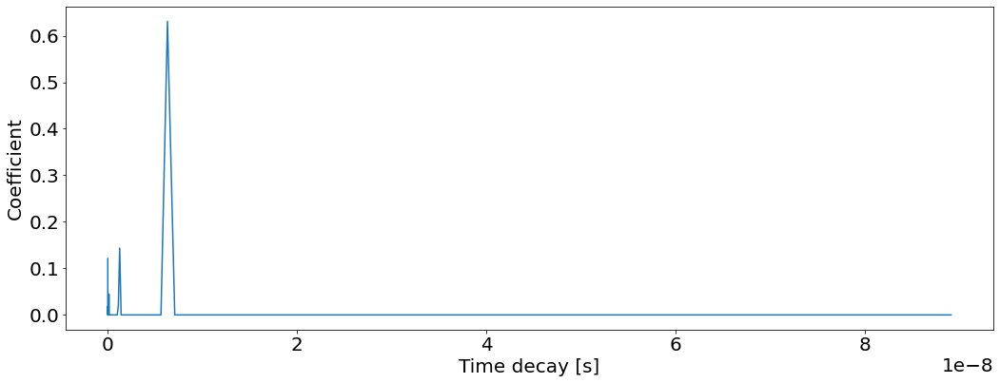

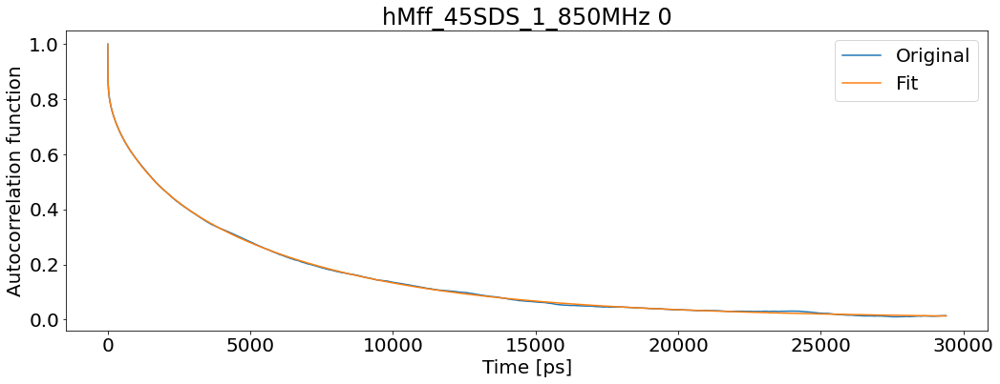

T1: 0.8006288162434556 T2: 0.11886274468778794 NOE: 0.5844906918107422


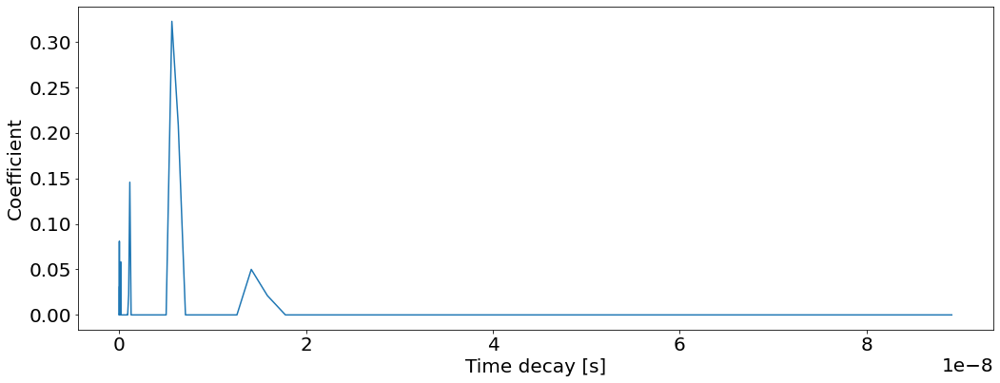

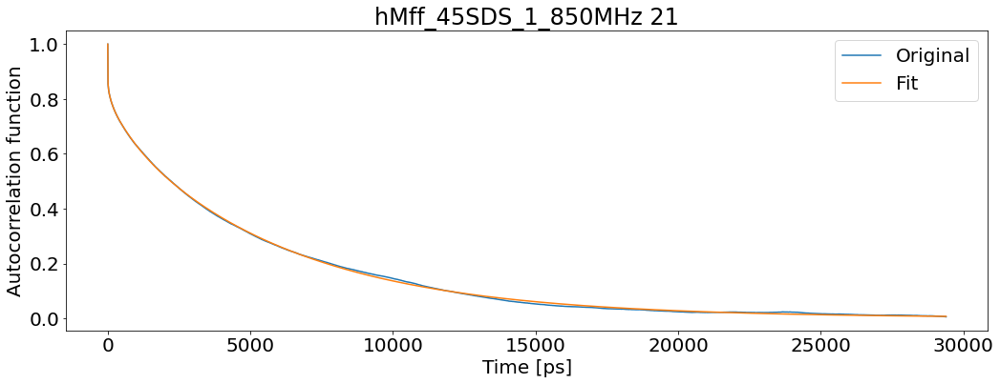

T1: 0.8222459896542725 T2: 0.11280144243978998 NOE: 0.673874577272396


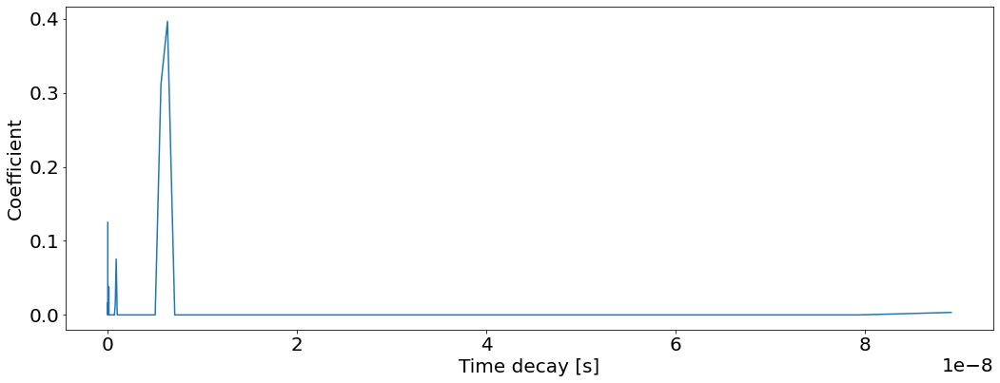

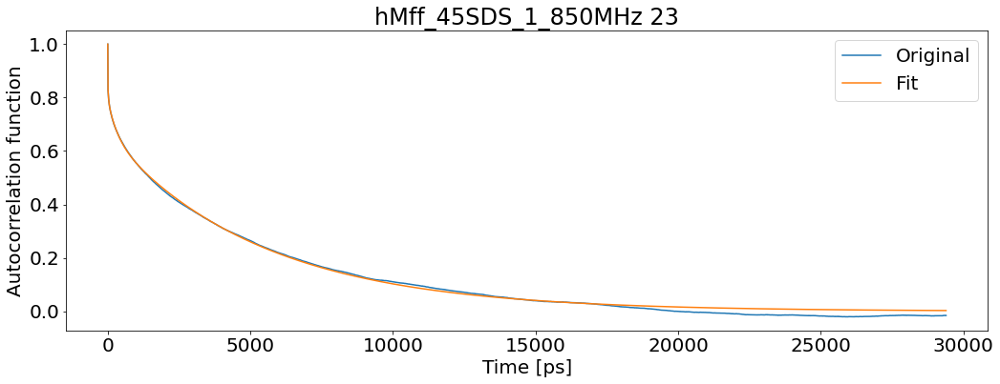

T1: 0.8417954172376154 T2: 0.14273009858398253 NOE: 0.5313387349738623


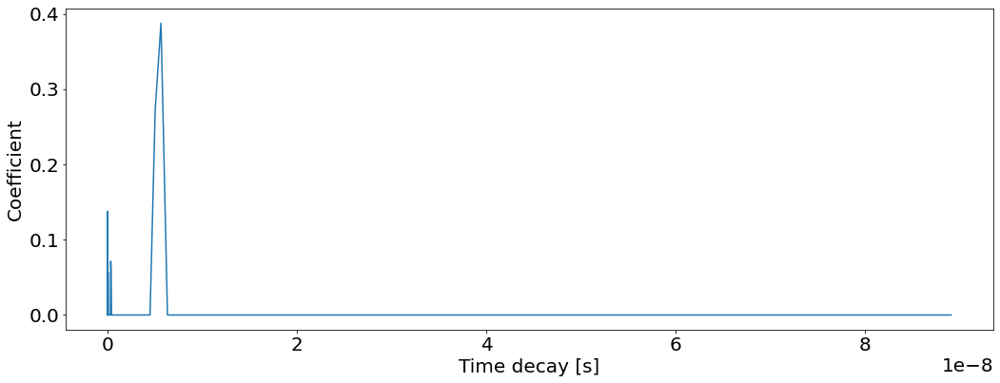

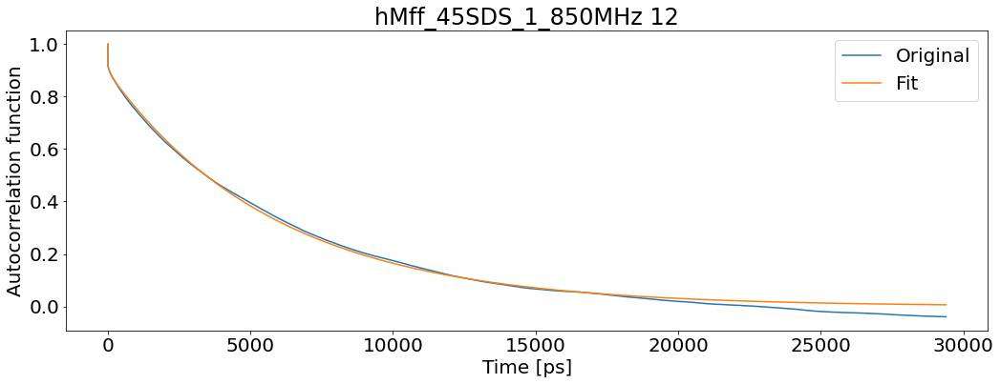

T1: 0.7759394260326119 T2: 0.09943791657228437 NOE: 0.812864795455645


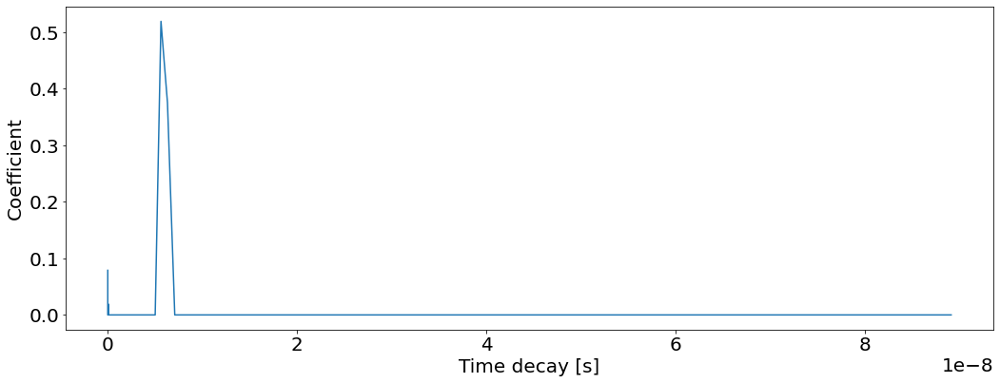

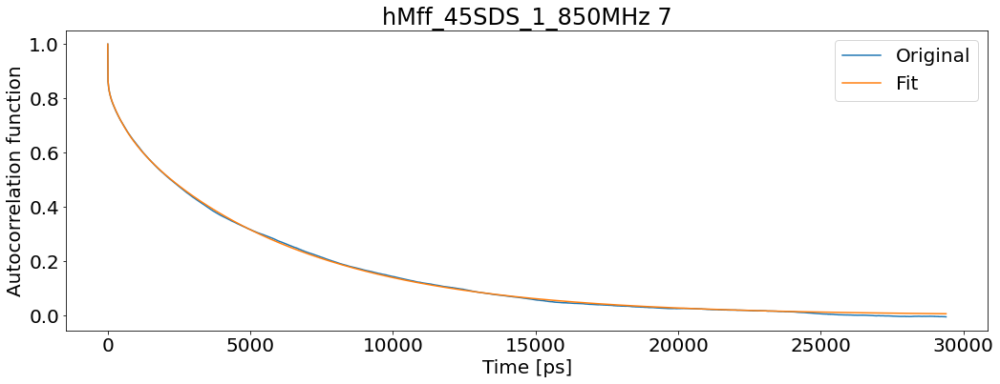

T1: 0.8336728096345626 T2: 0.11740945272975135 NOE: 0.6540719501986065


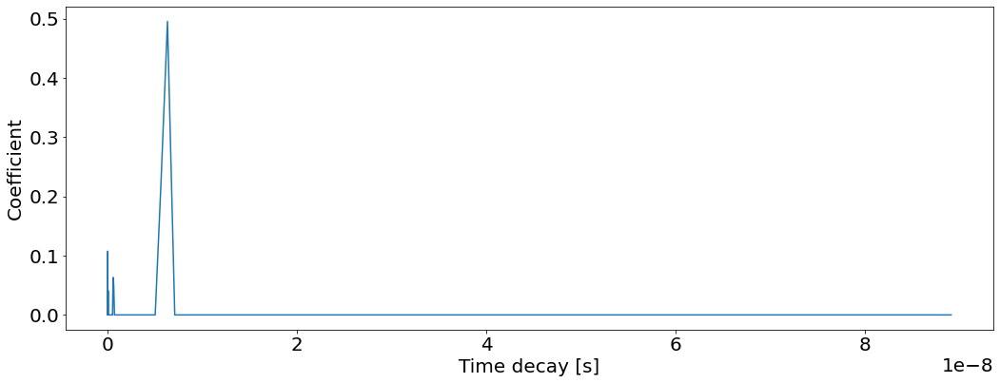

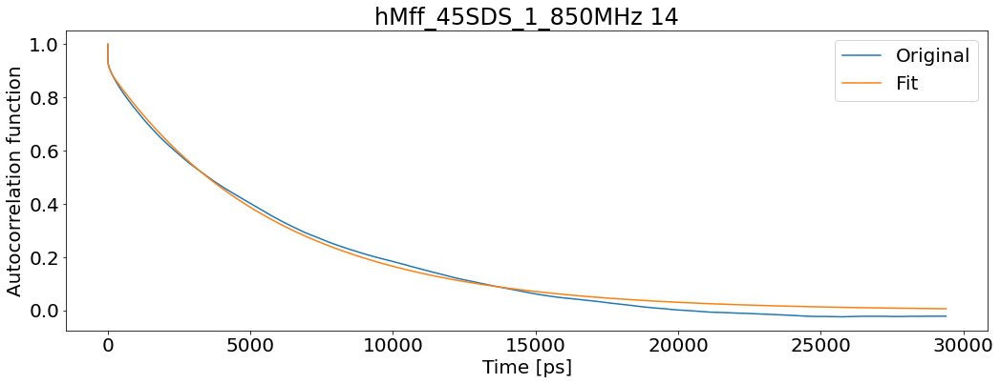

T1: 0.7632804884522532 T2: 0.09848024689036466 NOE: 0.8181883886553203


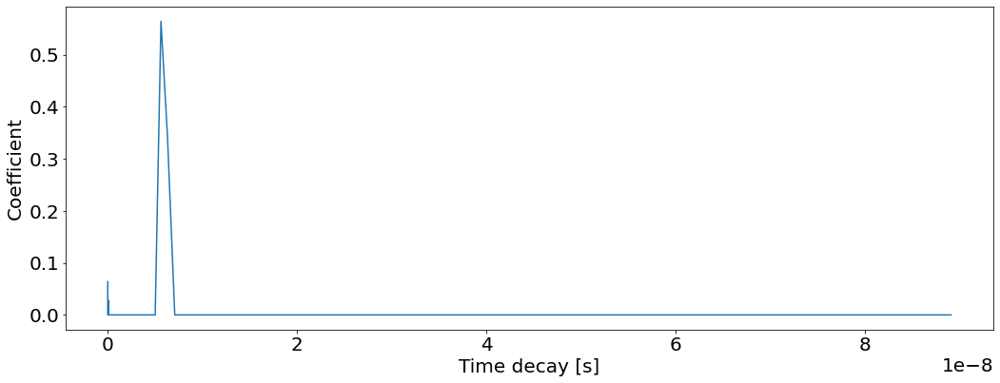

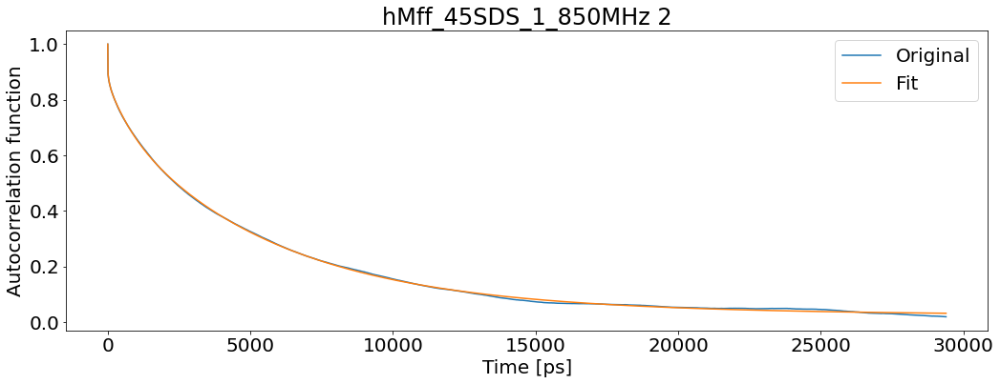

T1: 0.7651787077405825 T2: 0.07955756288018931 NOE: 0.6938052900087381


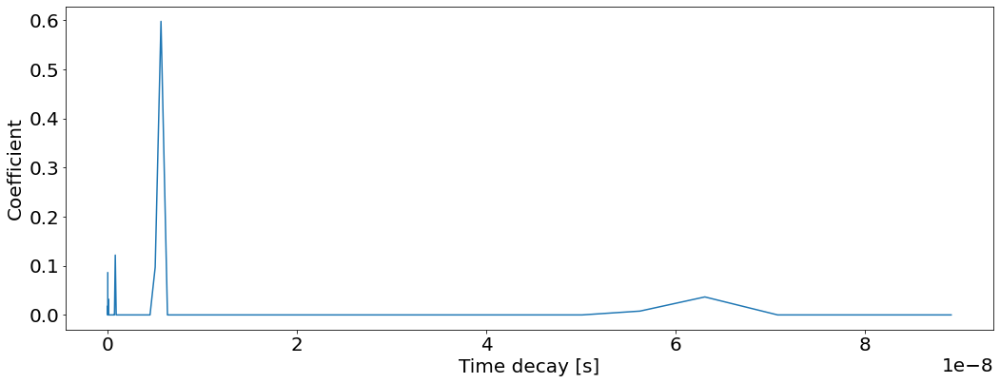

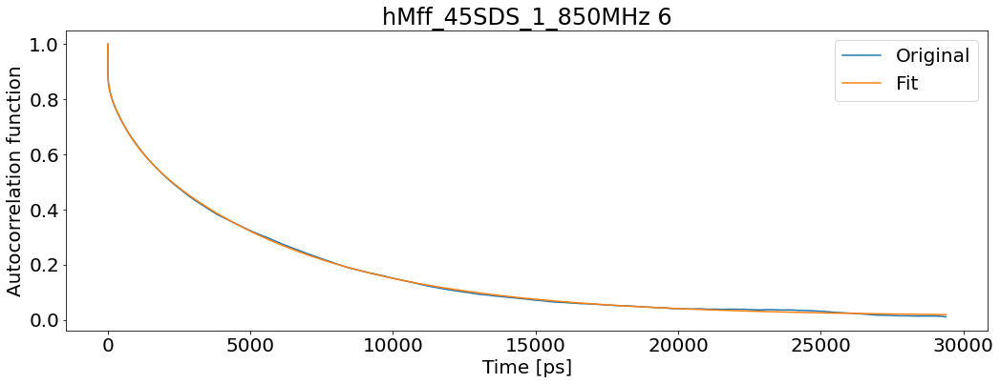

T1: 0.8210366444405526 T2: 0.09006005409071252 NOE: 0.651531068456577


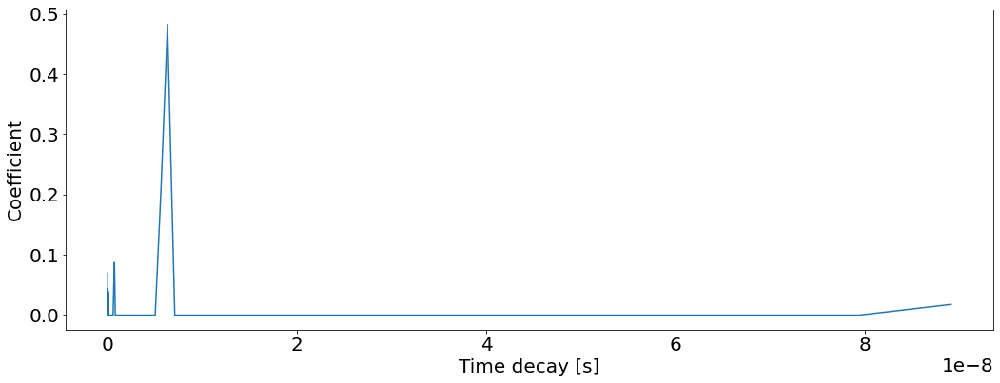

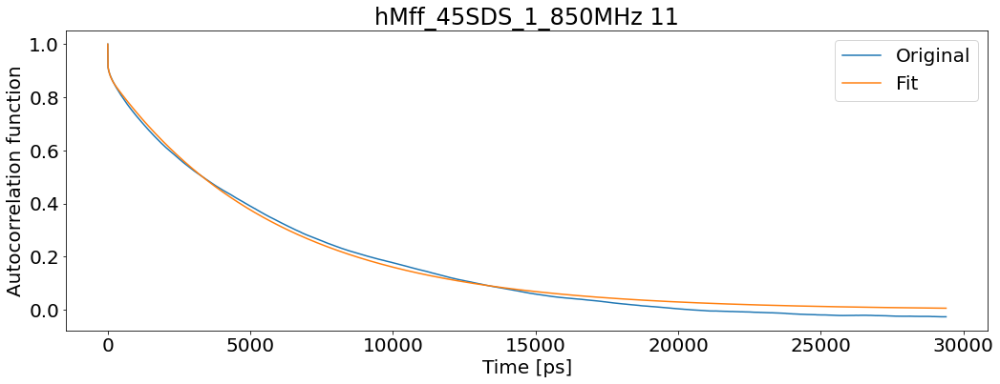

T1: 0.779230359113804 T2: 0.10137469631115716 NOE: 0.7997317714428442


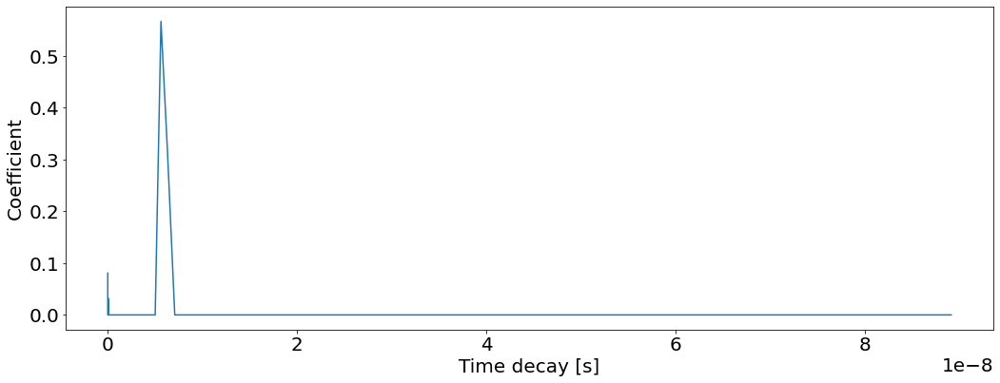

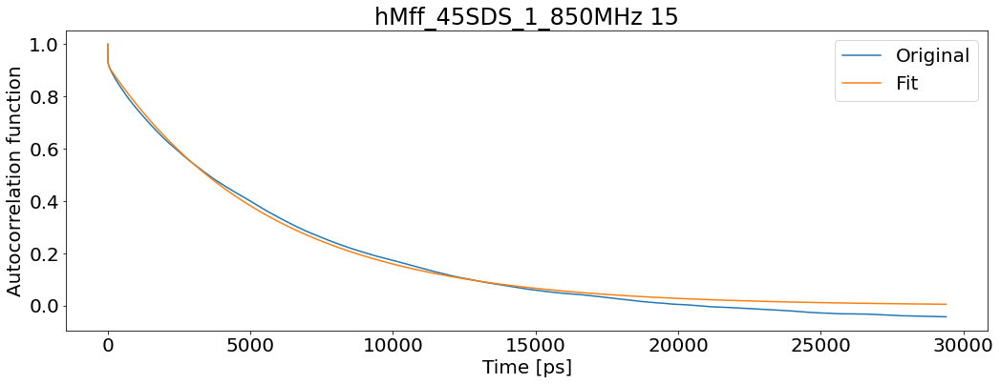

T1: 0.7396311063448463 T2: 0.10002810774018583 NOE: 0.8392601731021405


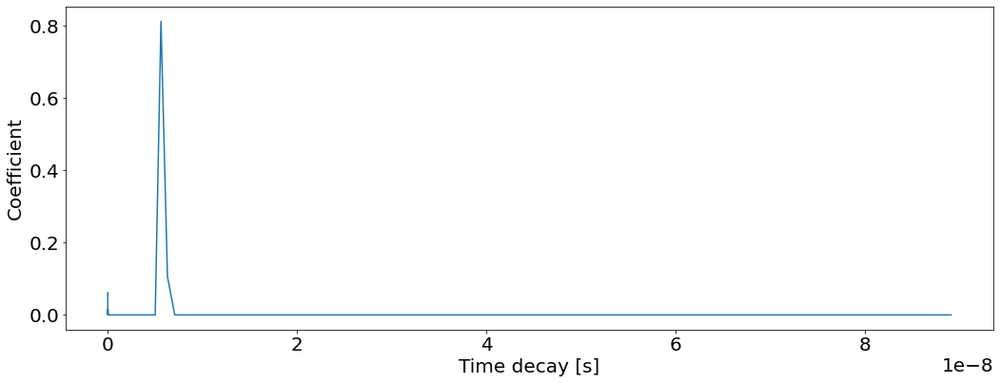

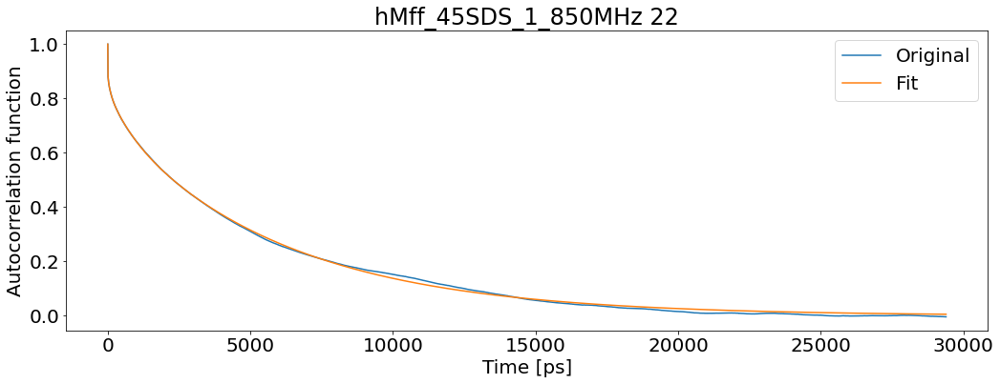

T1: 0.7989477123915418 T2: 0.11688880690531975 NOE: 0.6576848577515102


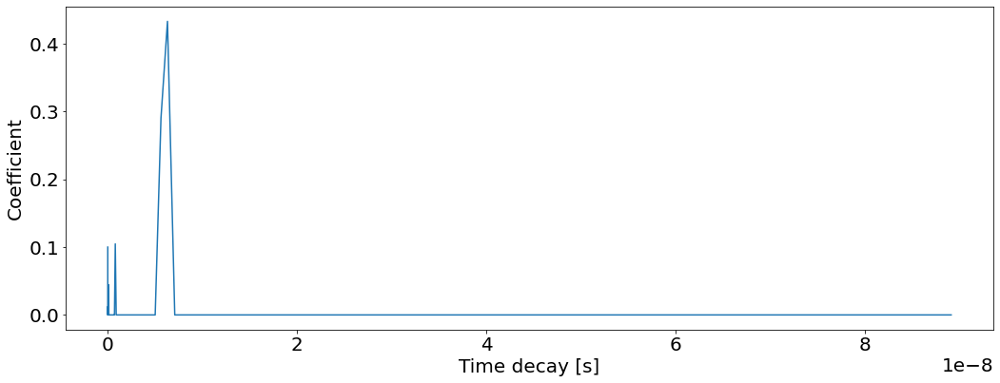

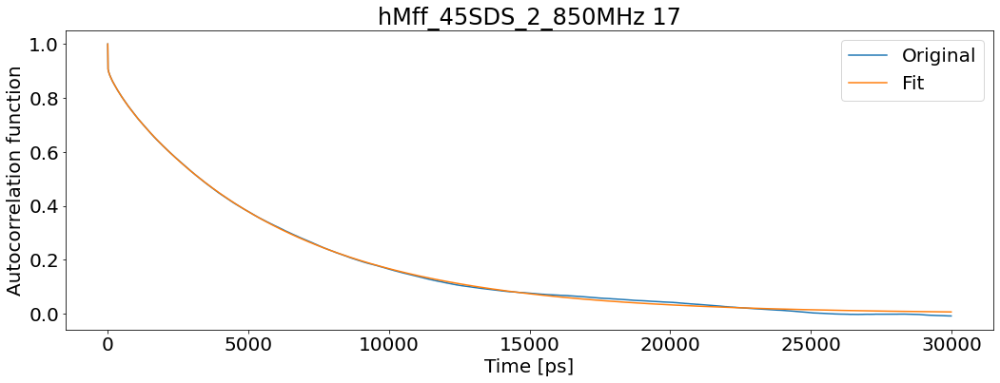

T1: 0.7987933441192717 T2: 0.10009293565170173 NOE: 0.772367895199729


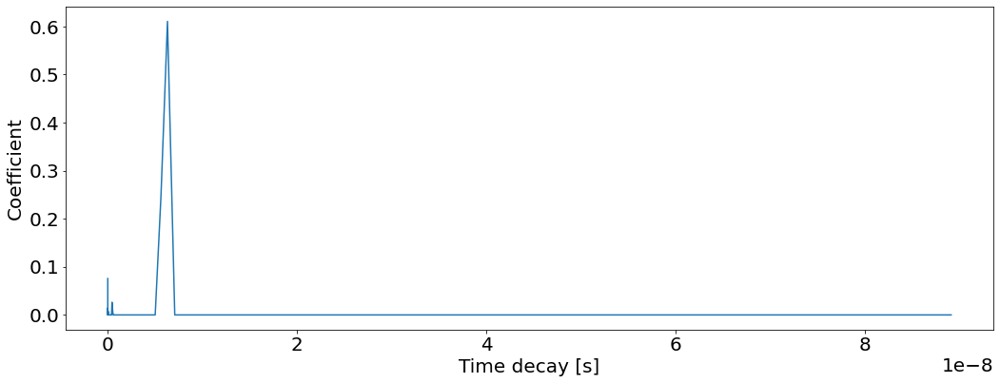

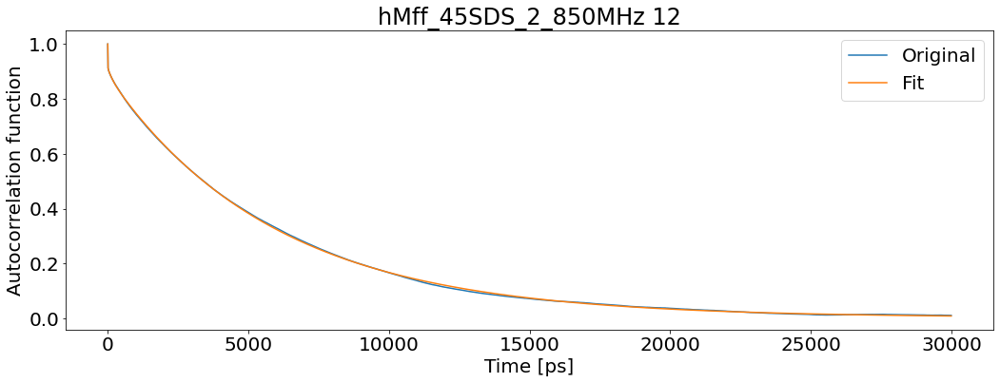

T1: 0.7839669407139245 T2: 0.09336741018452689 NOE: 0.7879200868072003


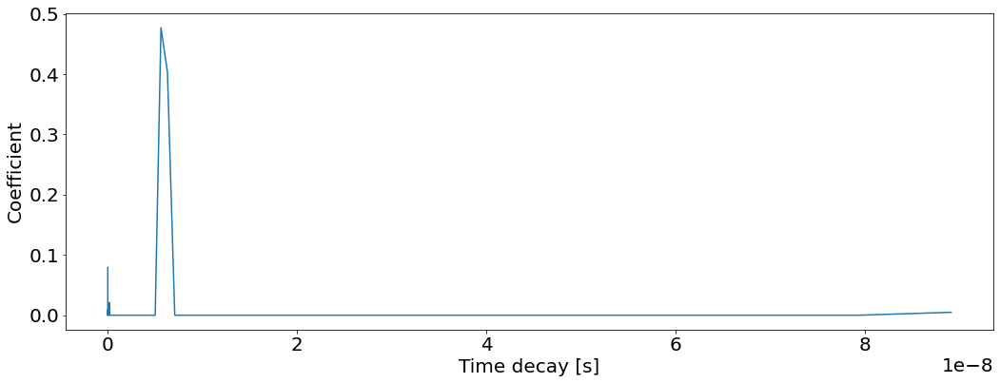

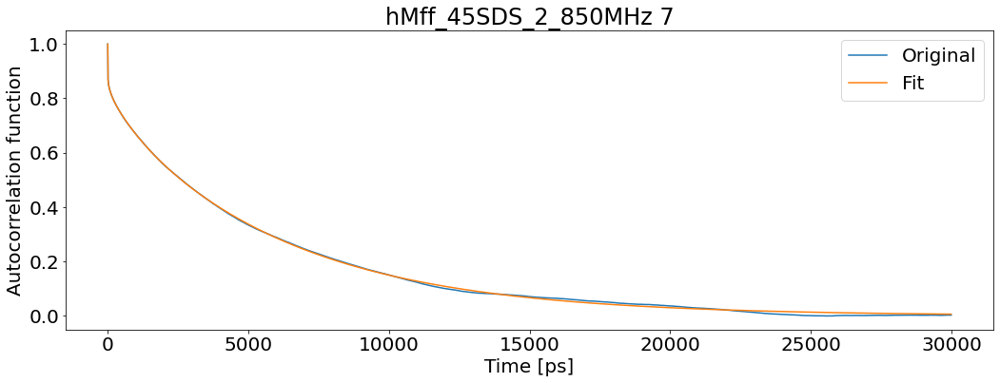

T1: 0.8236648228757902 T2: 0.11055918129907738 NOE: 0.7206406111128516


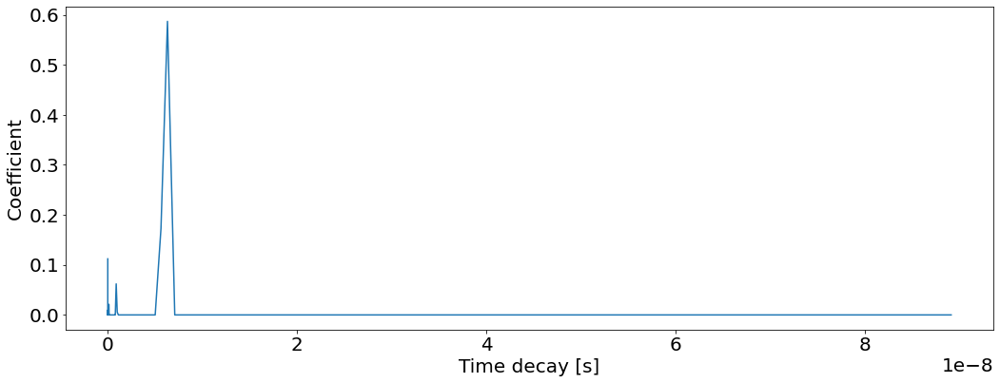

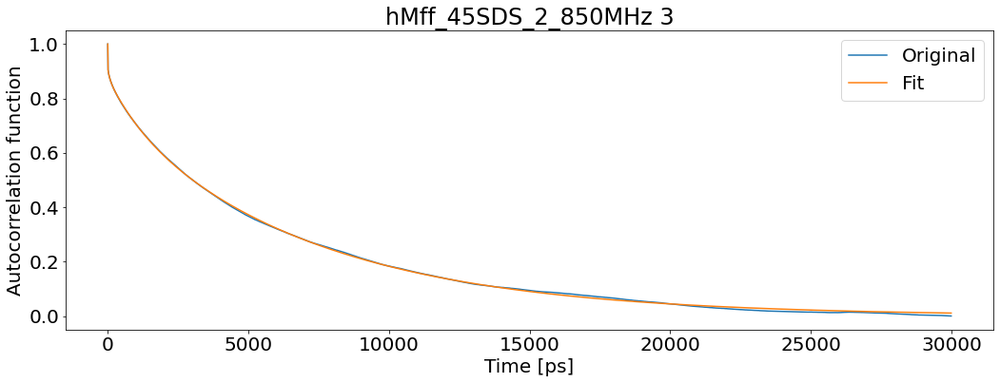

T1: 0.8139162304298139 T2: 0.09669433760516354 NOE: 0.7318912277877212


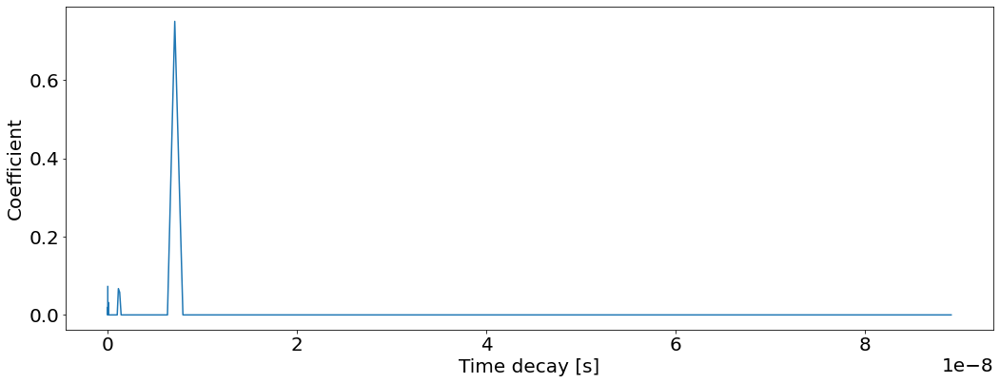

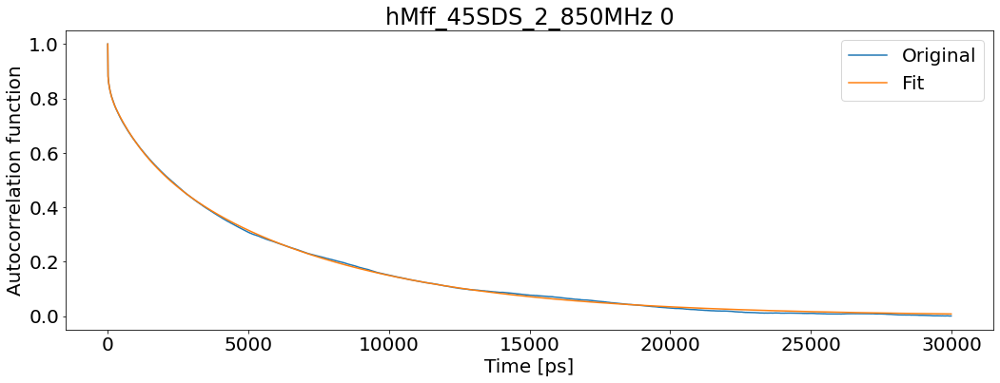

T1: 0.790253199527279 T2: 0.1123426333072867 NOE: 0.6684703247222448


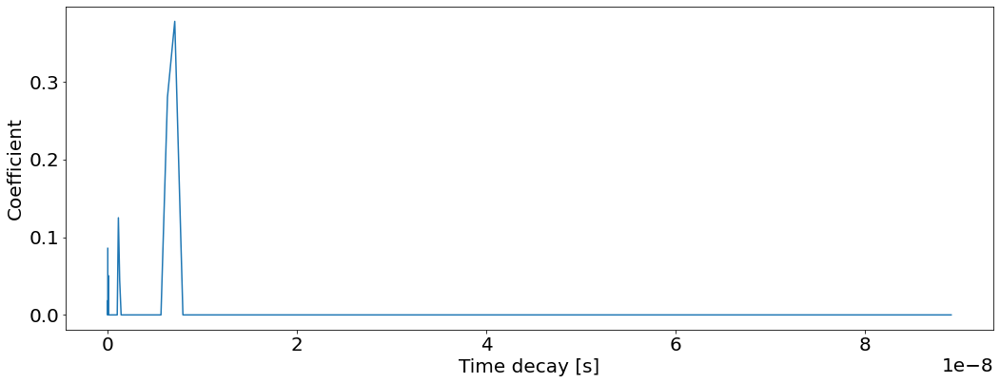

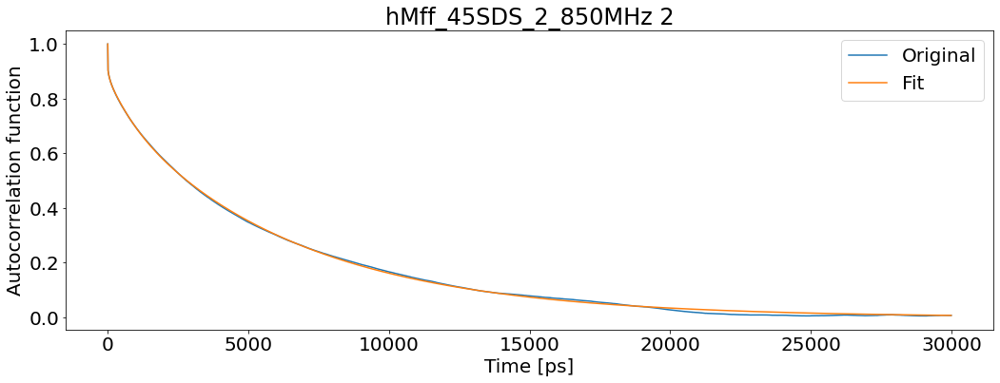

T1: 0.7871979341140843 T2: 0.10426897692921096 NOE: 0.7258131937587173


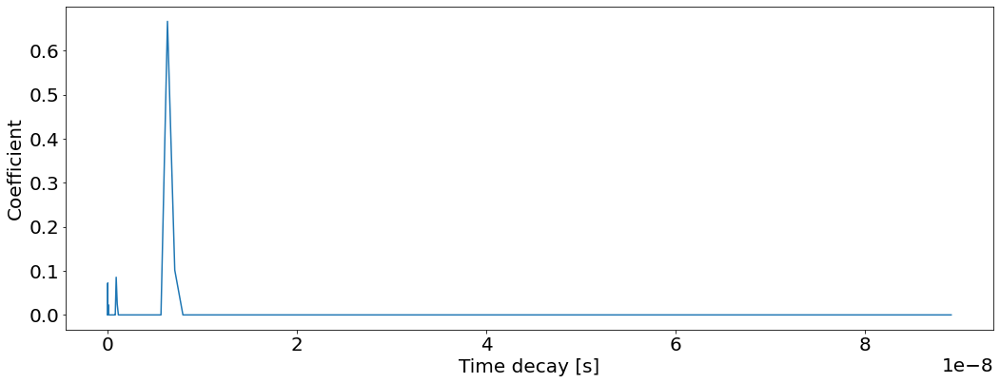

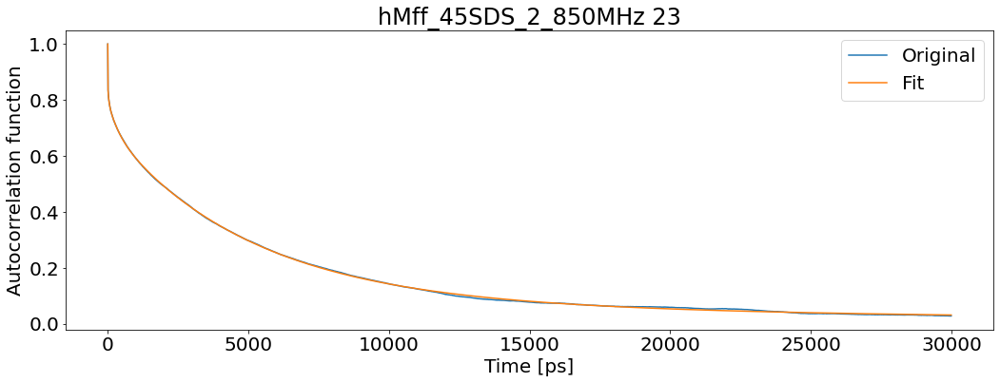

T1: 0.8565083564361703 T2: 0.09542680641314534 NOE: 0.5961818645250243


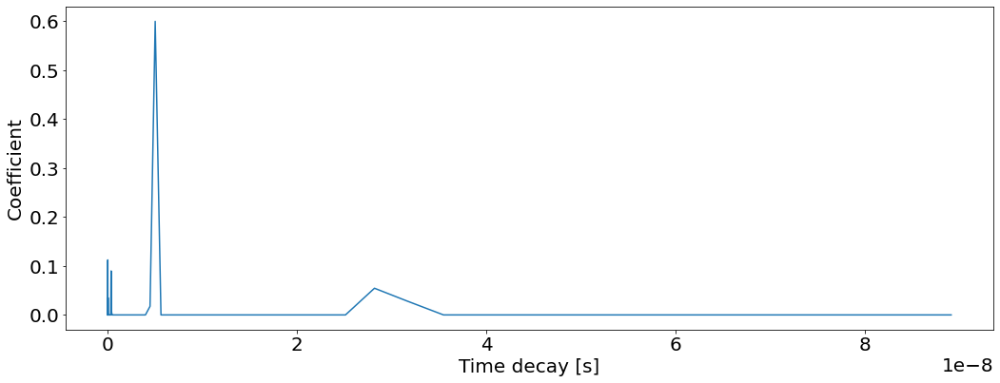

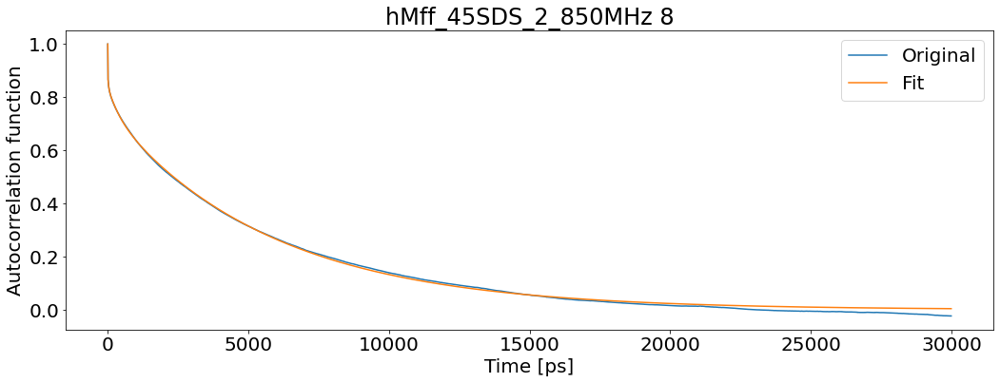

T1: 0.8210887830942463 T2: 0.11929558172482486 NOE: 0.657178318904043


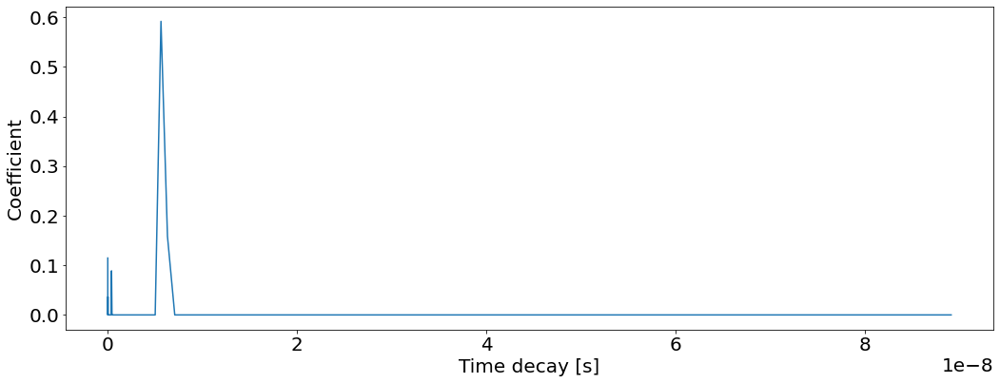

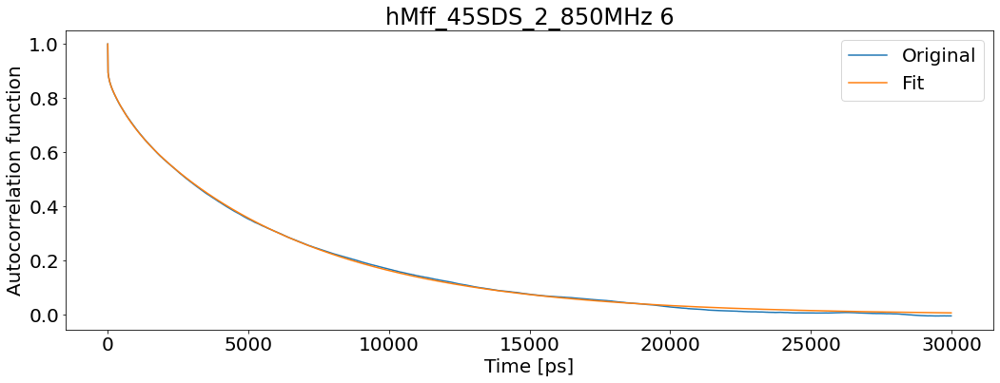

T1: 0.8266142746785293 T2: 0.10415580438512569 NOE: 0.7027185489560259


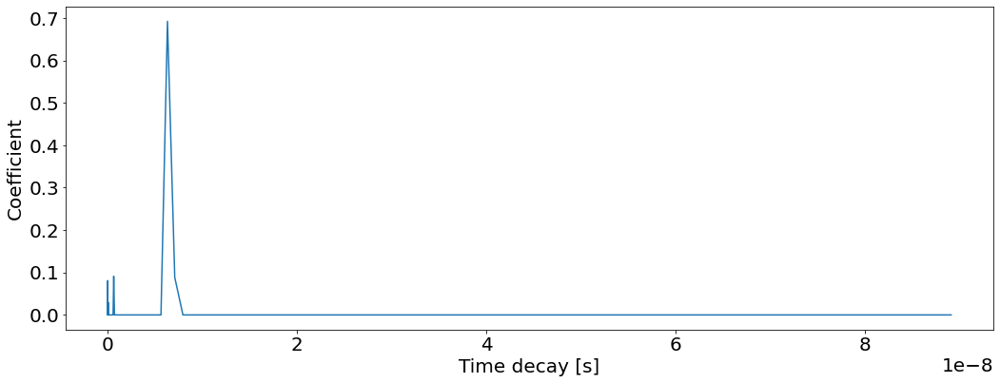

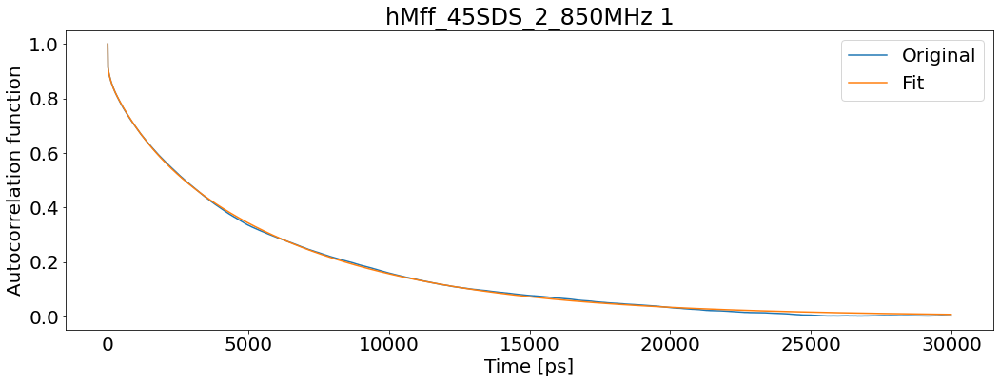

T1: 0.7502551082854969 T2: 0.10580850454294674 NOE: 0.7242475071665928


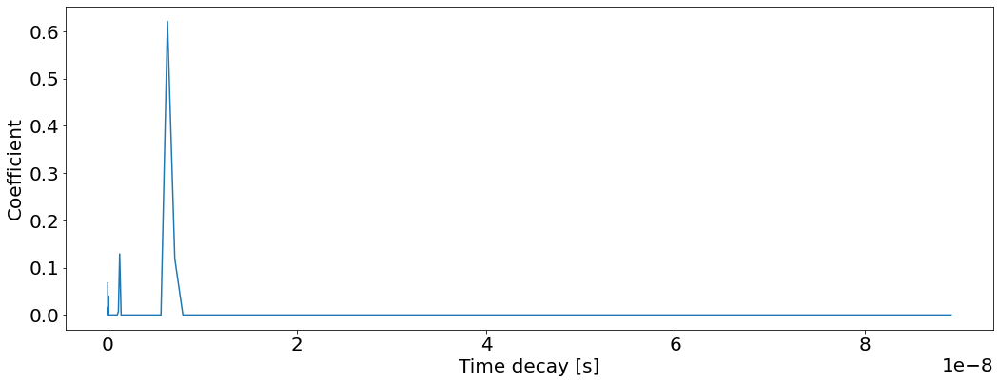

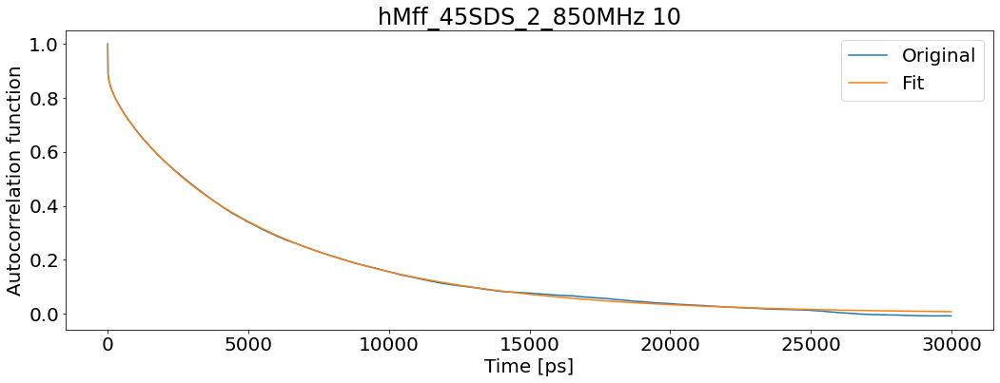

T1: 0.7849594418211905 T2: 0.10681415770468533 NOE: 0.7128822587898407


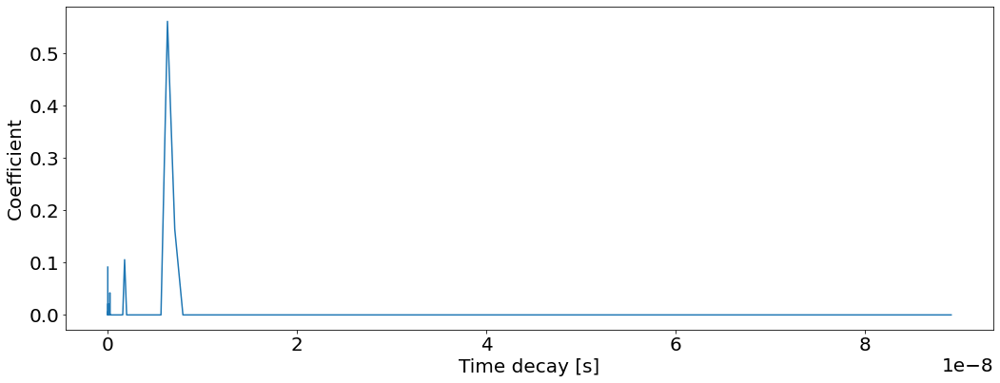

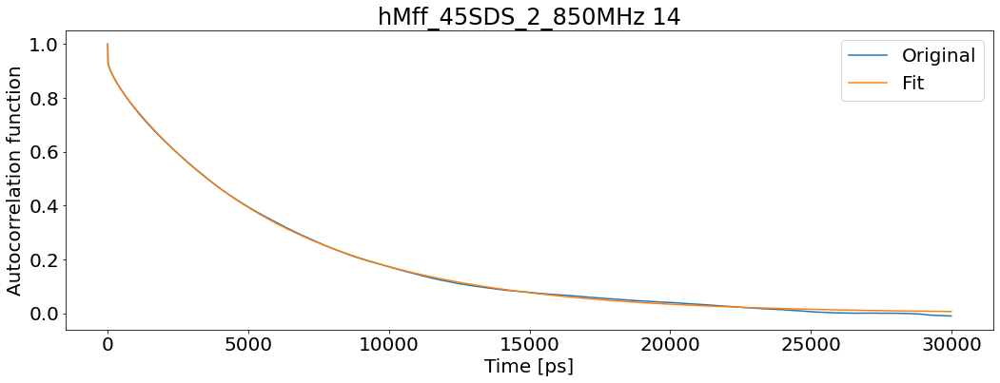

T1: 0.7843251032323703 T2: 0.09658600069578258 NOE: 0.7692614803655182


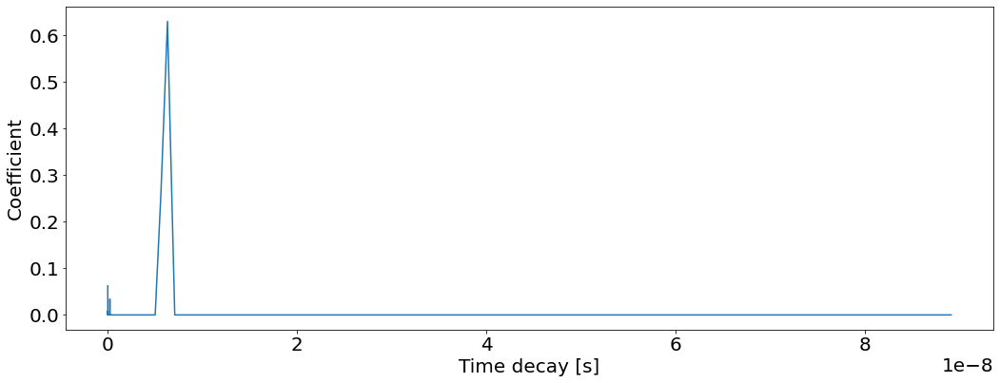

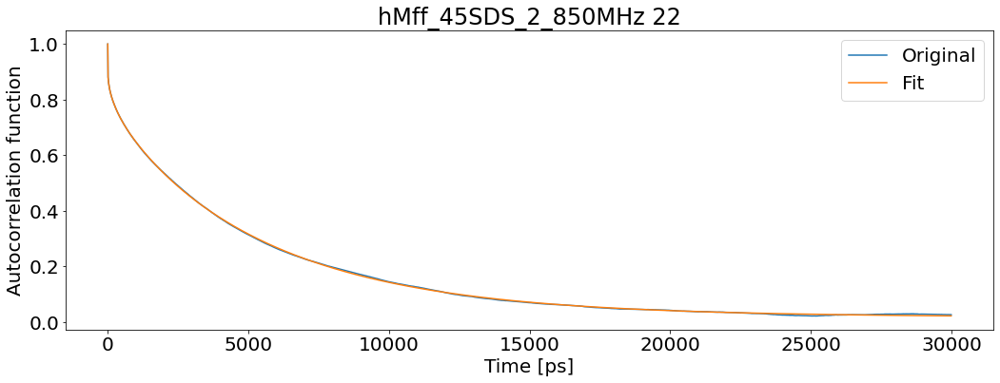

T1: 0.7810881062481451 T2: 0.08303970692967125 NOE: 0.6569513474772257


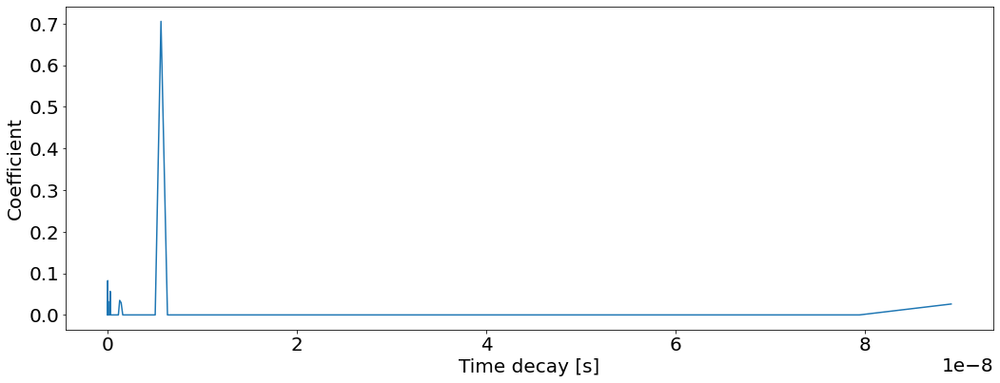

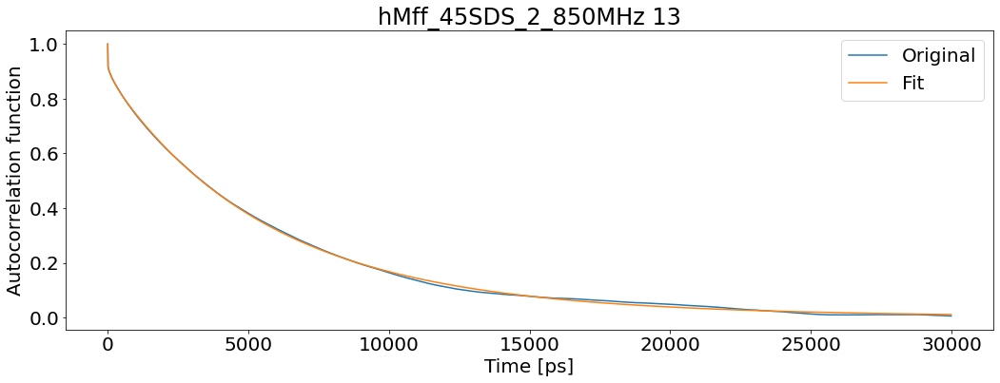

T1: 0.7678534663295022 T2: 0.09664238386671052 NOE: 0.7759895819237776


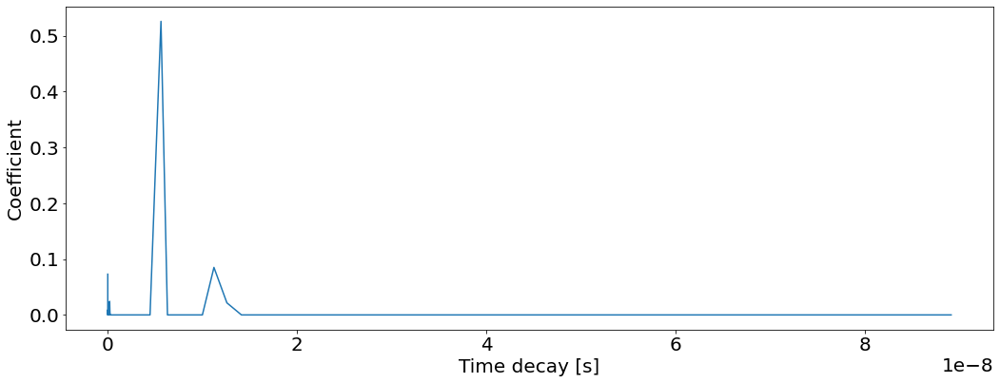

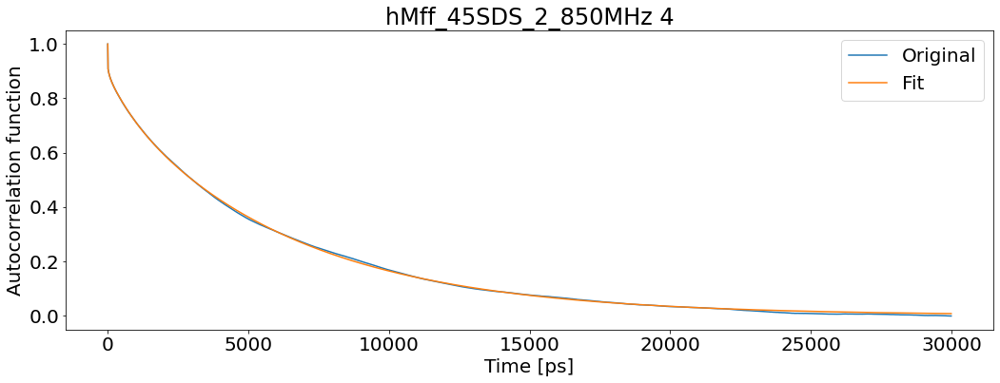

T1: 0.7843971921375187 T2: 0.10243091784831802 NOE: 0.7485484420044043


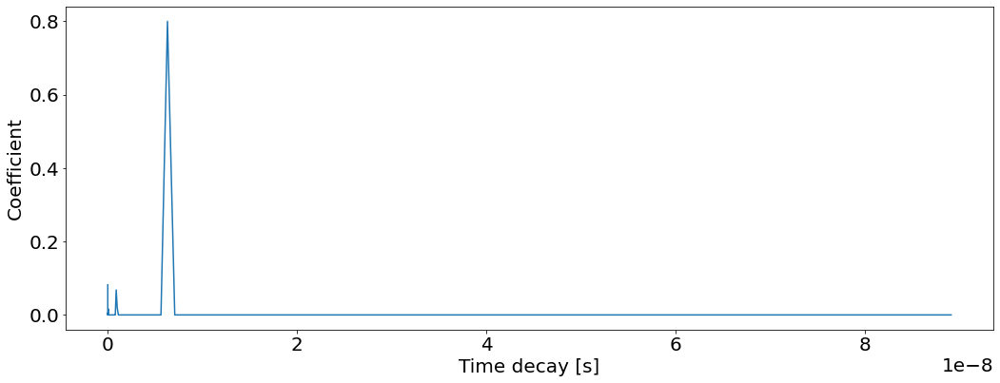

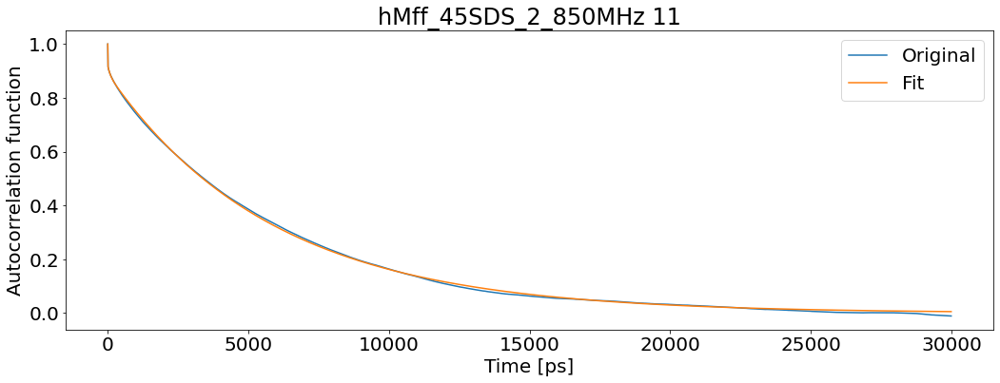

T1: 0.7756993750402307 T2: 0.10041123263776093 NOE: 0.7997676808983801


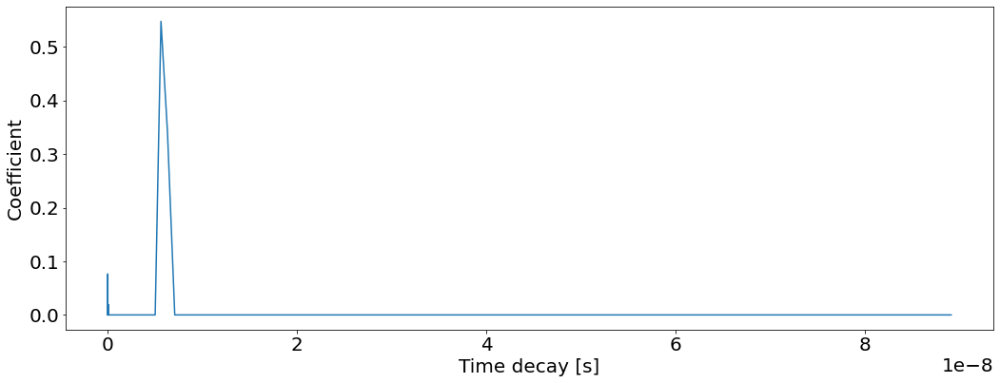

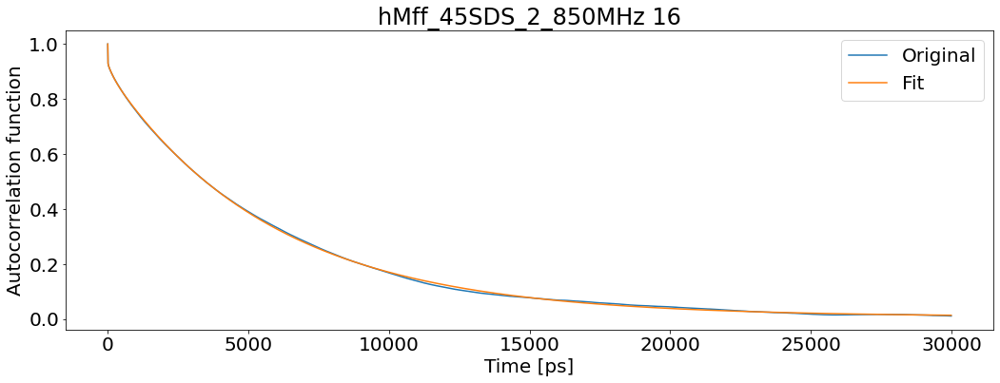

T1: 0.7637331541420952 T2: 0.08467911982901304 NOE: 0.7842666084418054


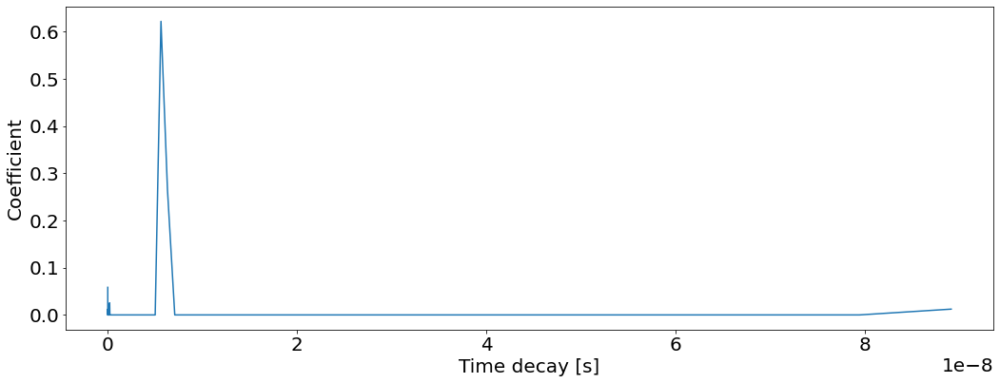

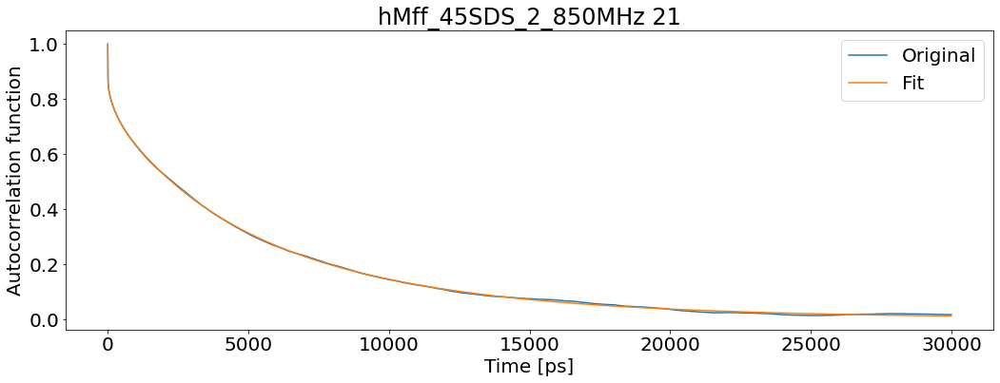

T1: 0.8066402607571816 T2: 0.10425329920602586 NOE: 0.644413878416372


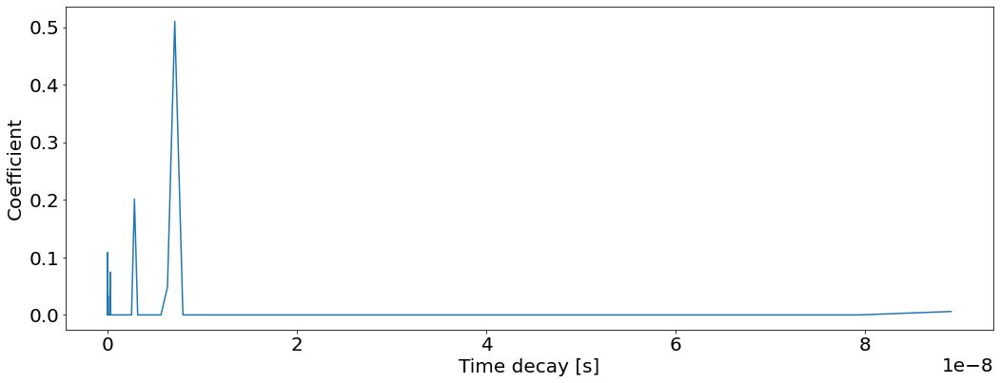

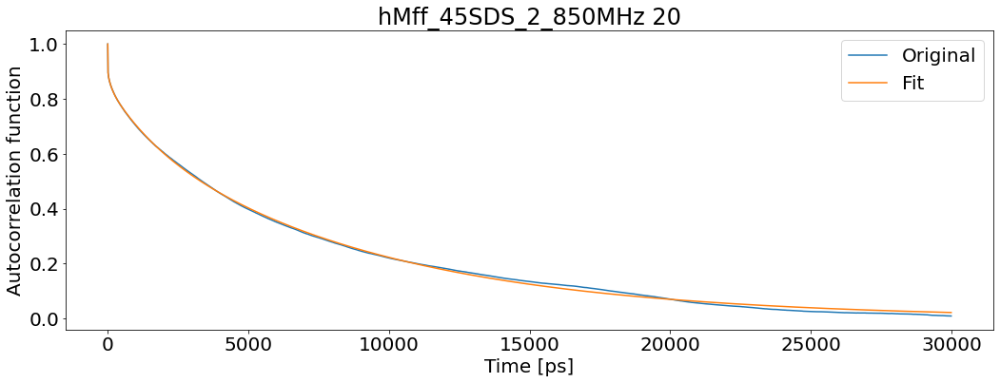

T1: 0.9017451165974582 T2: 0.08429112041839015 NOE: 0.6959515169712929


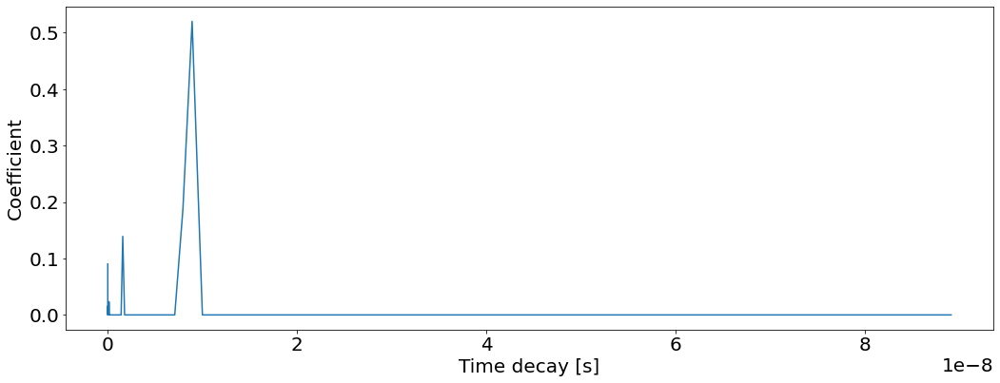

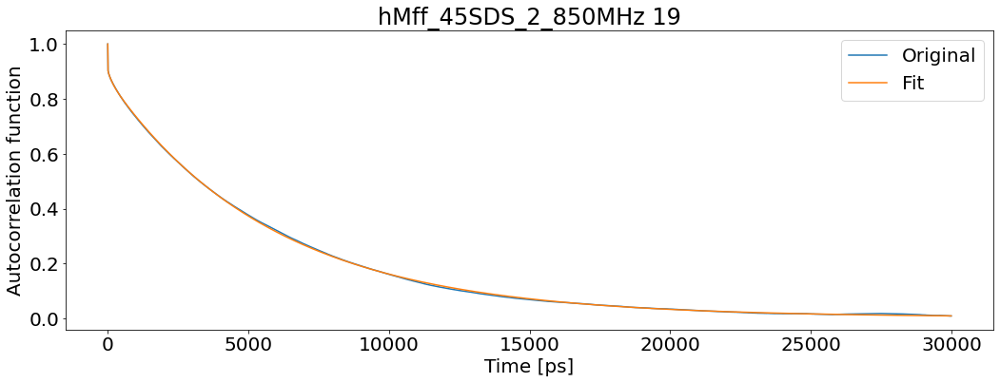

T1: 0.7846756791366187 T2: 0.09438894667212491 NOE: 0.7816160200756088


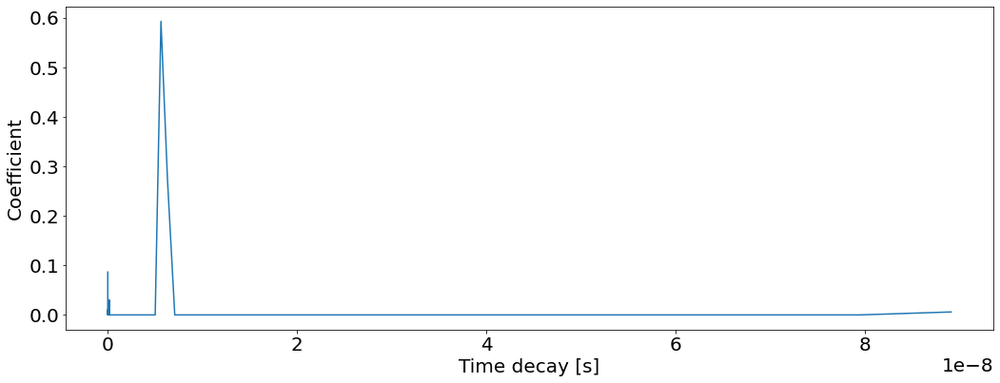

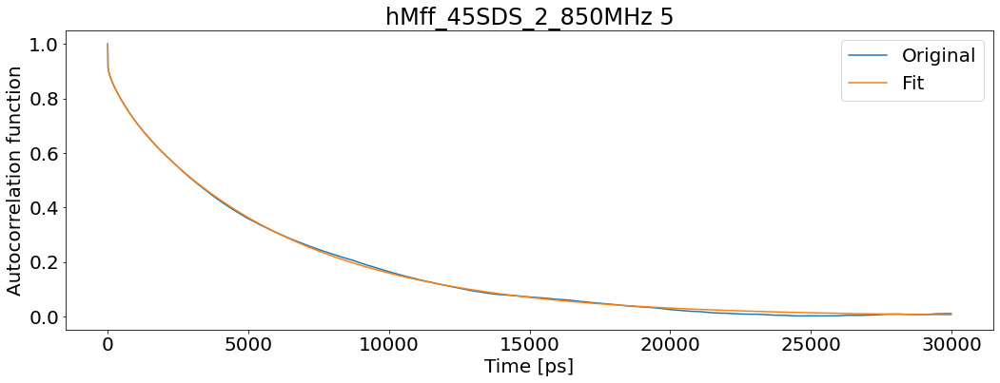

T1: 0.7829663089933556 T2: 0.1035446347253959 NOE: 0.7351273244181865


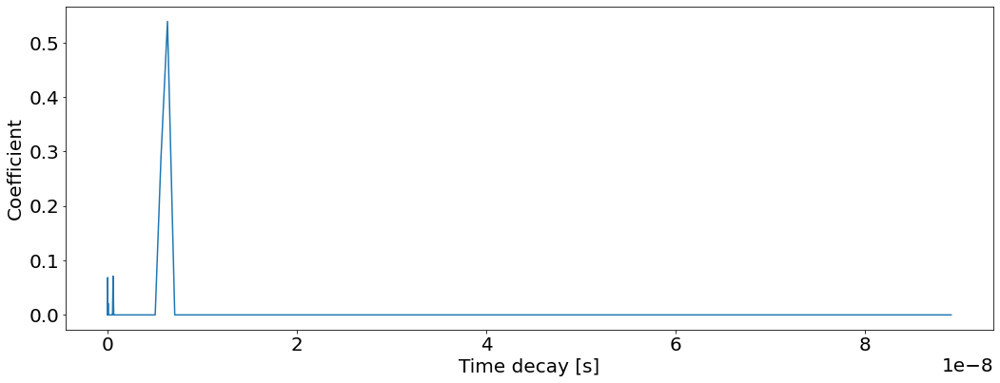

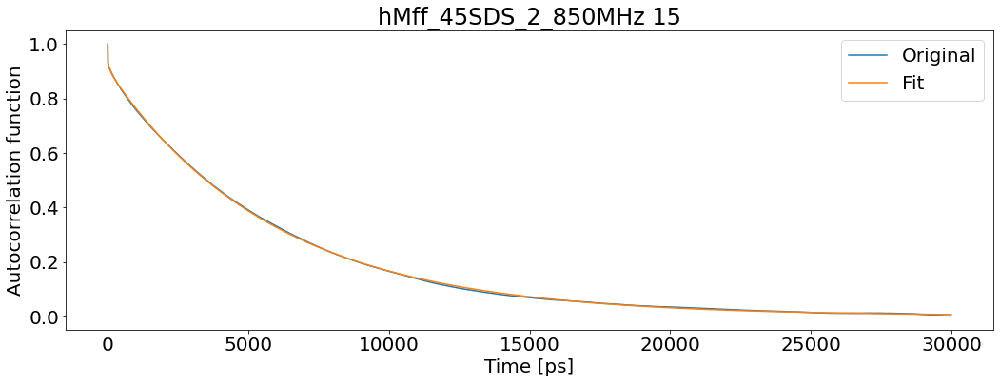

T1: 0.7617362385647118 T2: 0.09599637024242037 NOE: 0.8016343464794733


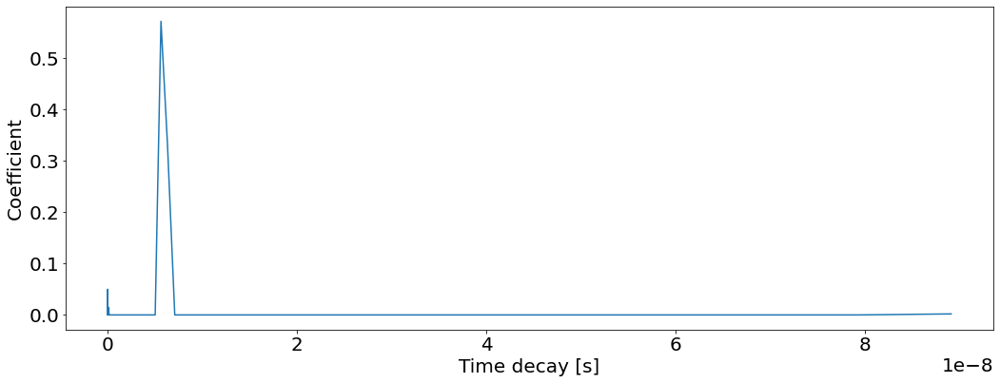

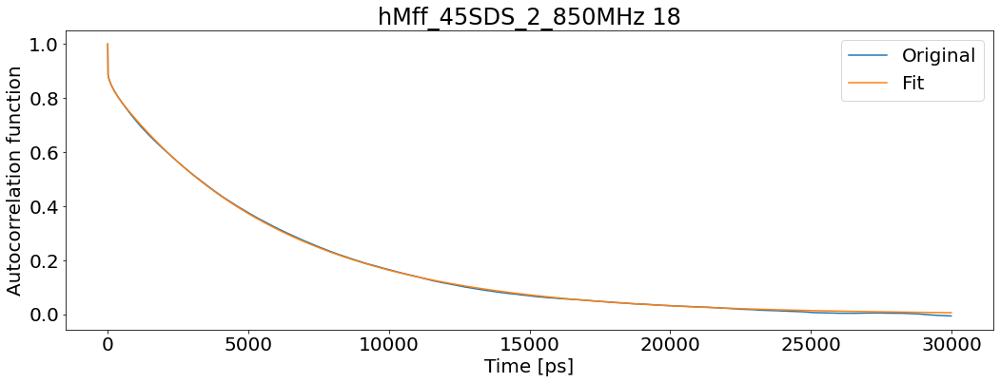

T1: 0.8224215906428408 T2: 0.1020098263740567 NOE: 0.7699741059884683


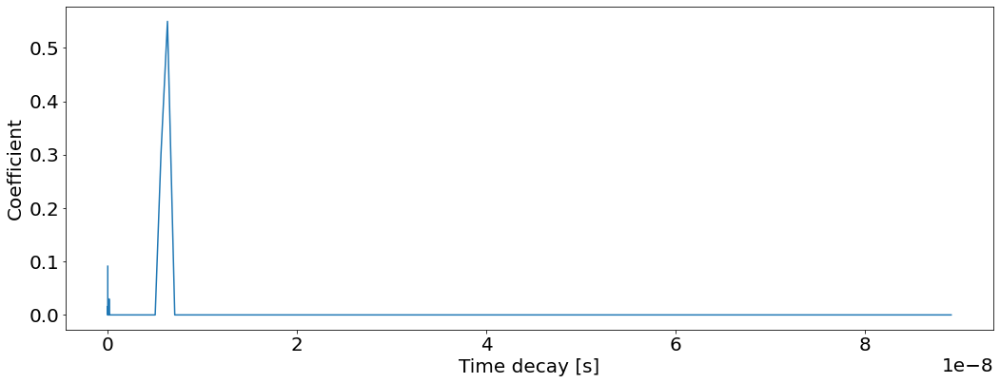

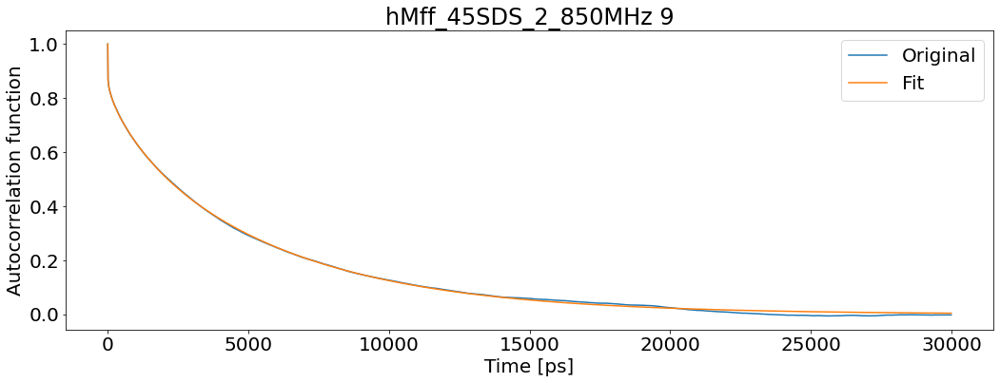

T1: 0.7541897201704004 T2: 0.12295887077888426 NOE: 0.6893635406598129


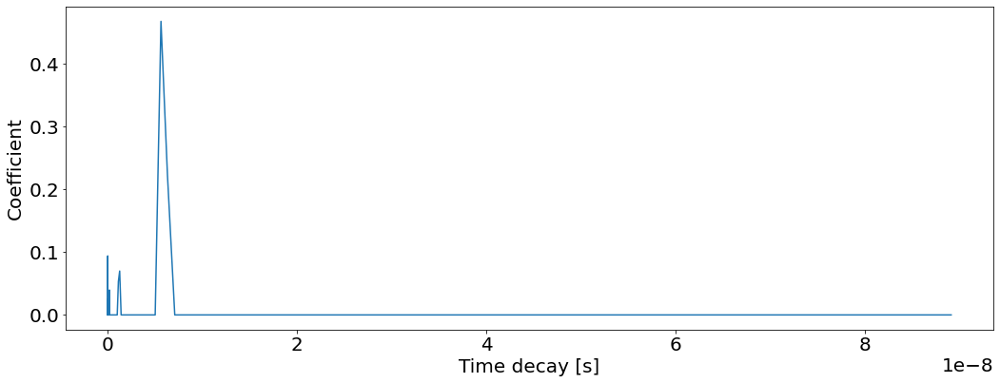

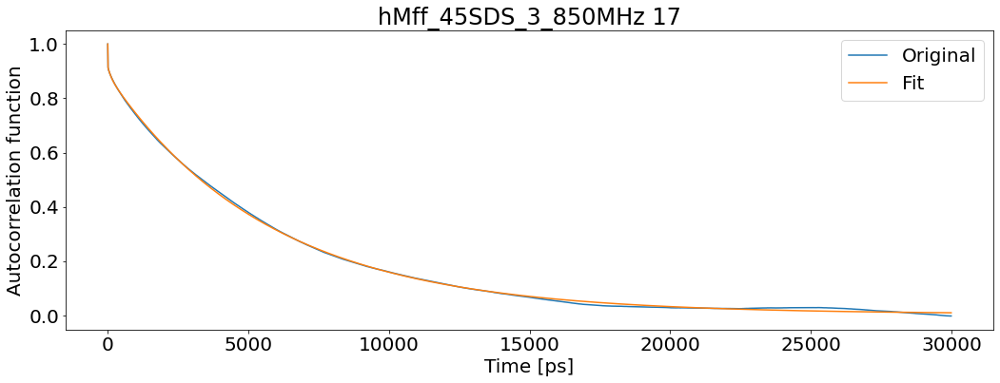

T1: 0.7645242727752994 T2: 0.09329496042877812 NOE: 0.7863803672286052


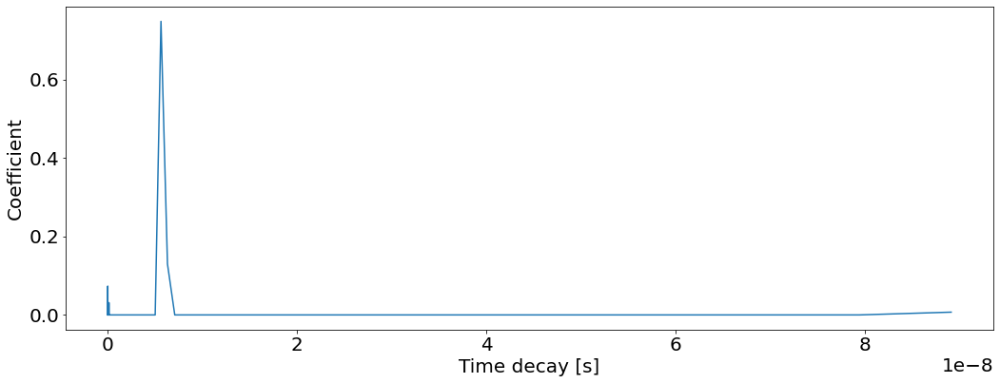

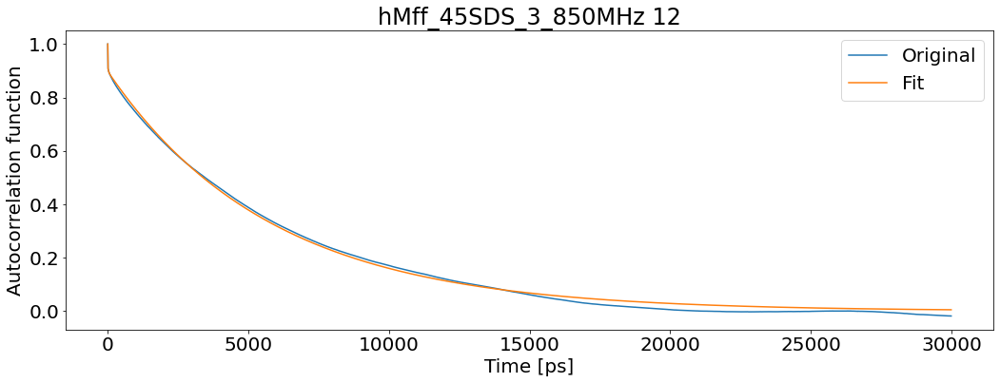

T1: 0.7675847388834586 T2: 0.10084692385536877 NOE: 0.839206640265802


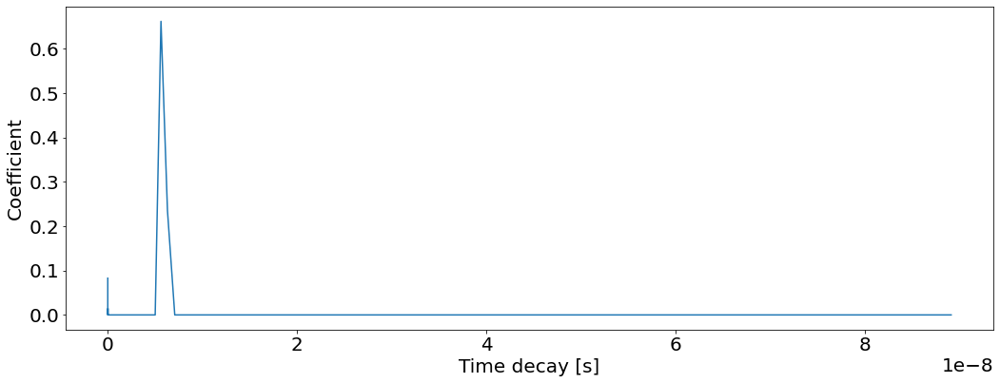

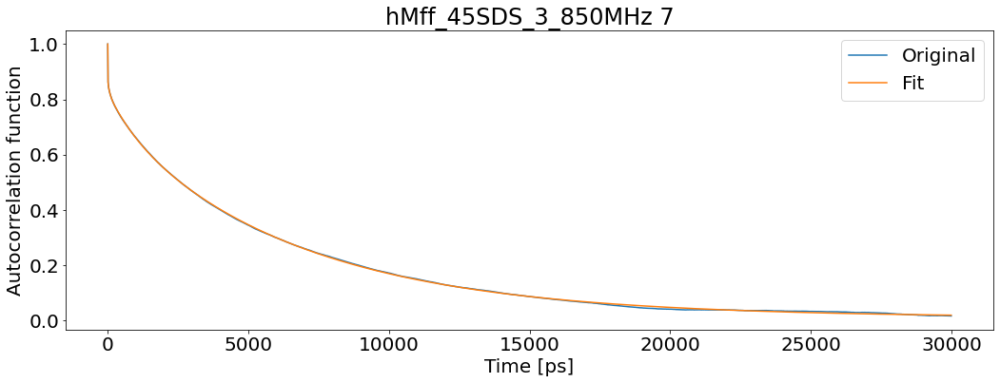

T1: 0.8585150888729413 T2: 0.0849882432677239 NOE: 0.7129992944397223


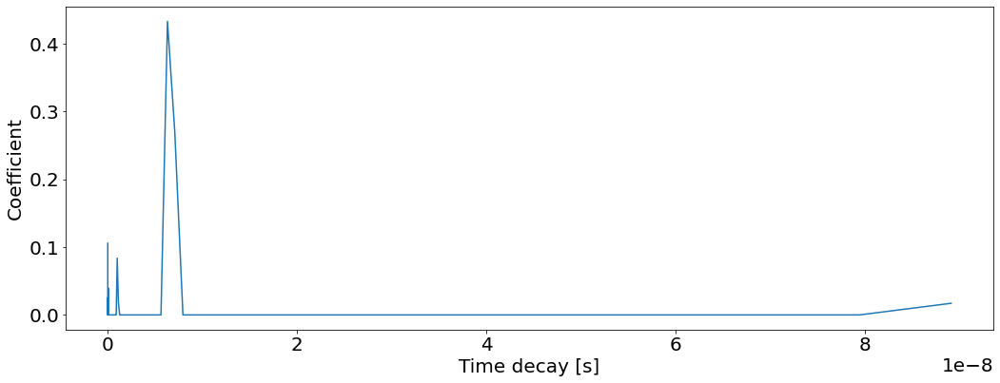

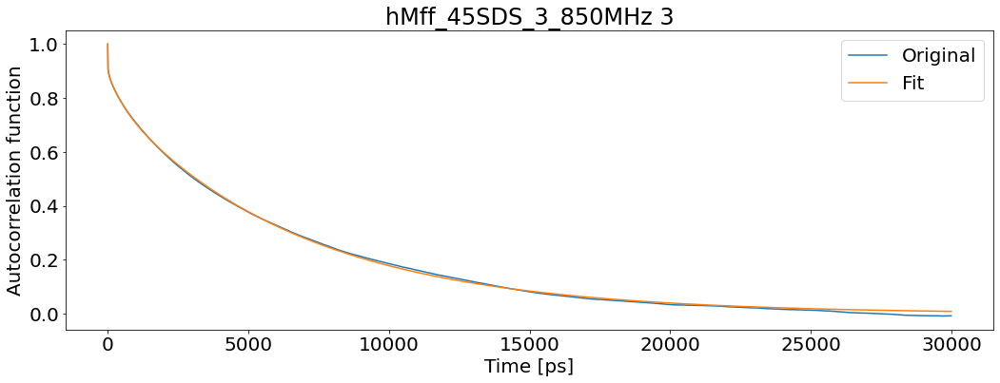

T1: 0.8428230624879247 T2: 0.0981279878381573 NOE: 0.7056957270754756


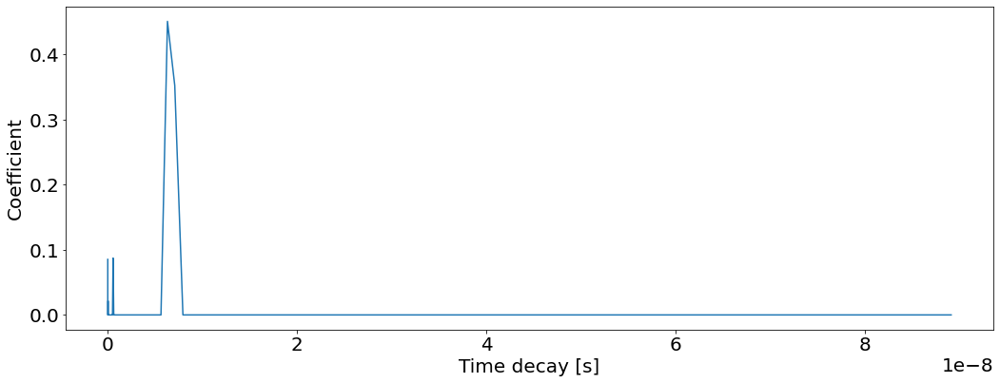

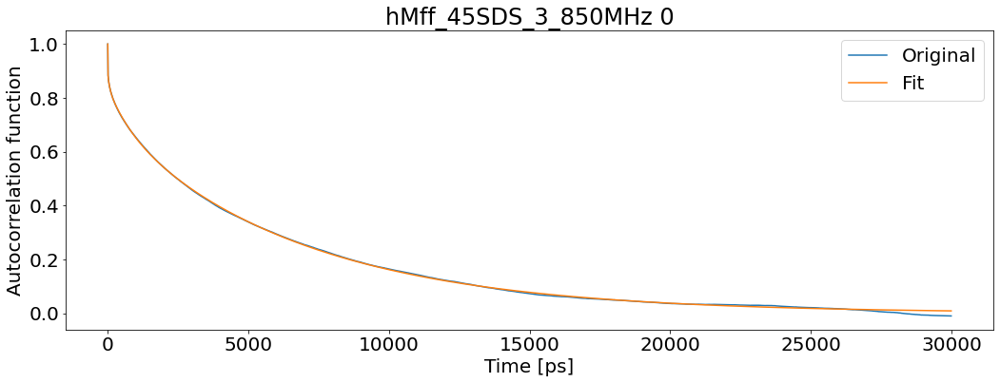

T1: 0.8442741248134519 T2: 0.10696678036594245 NOE: 0.6549990384194222


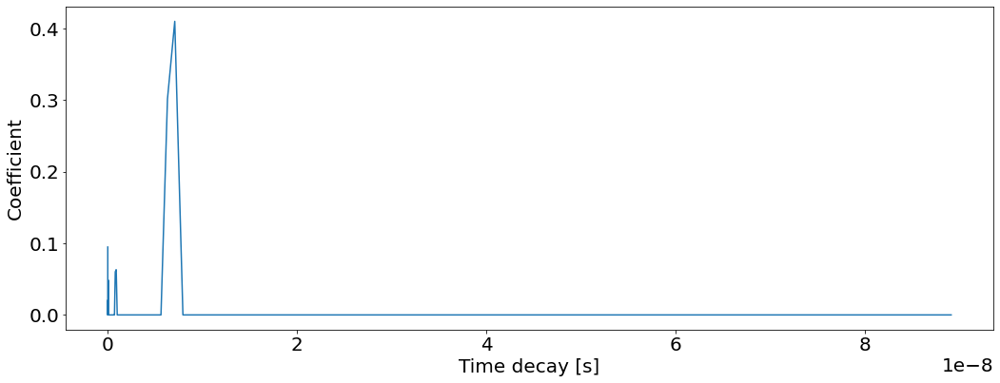

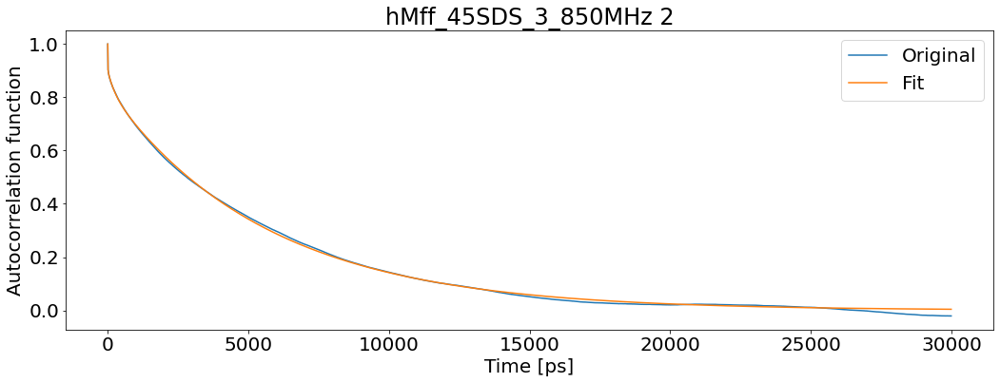

T1: 0.7703068179922343 T2: 0.11060698970761076 NOE: 0.6944207977727739


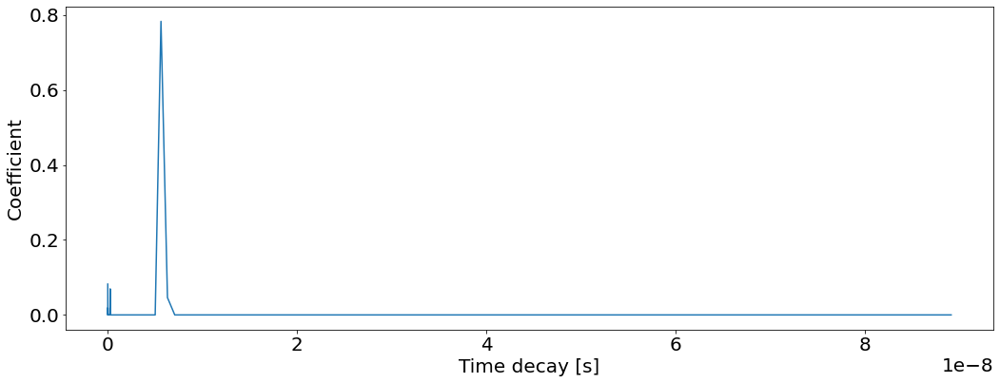

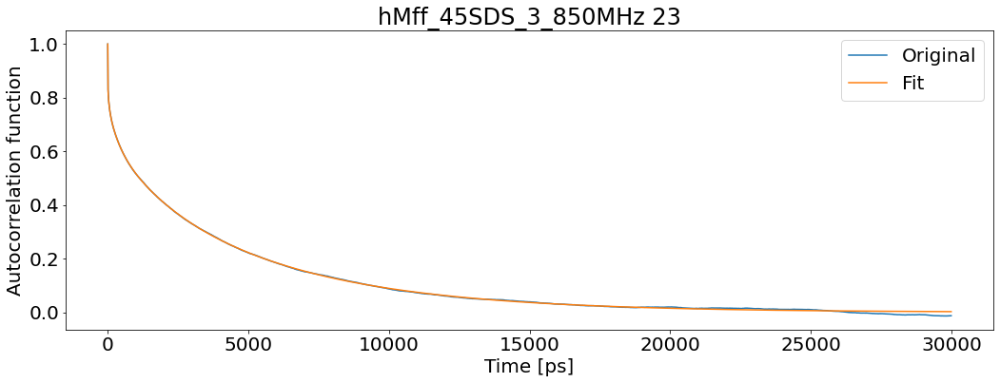

T1: 0.7851297587414209 T2: 0.1566906195564828 NOE: 0.5089460778798024


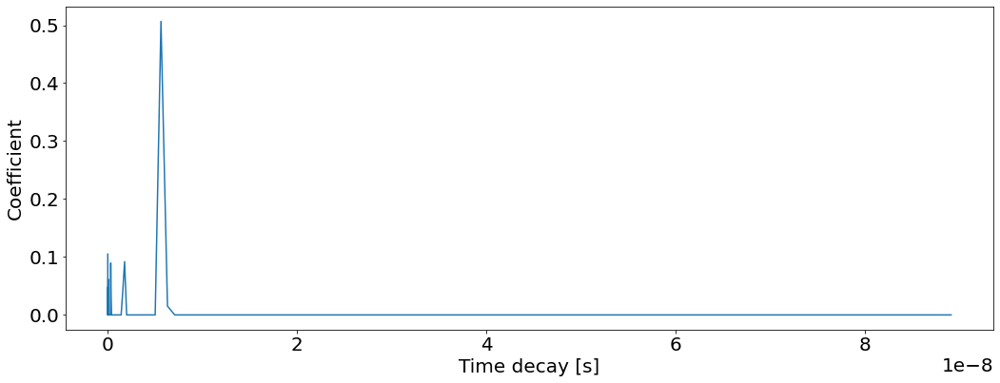

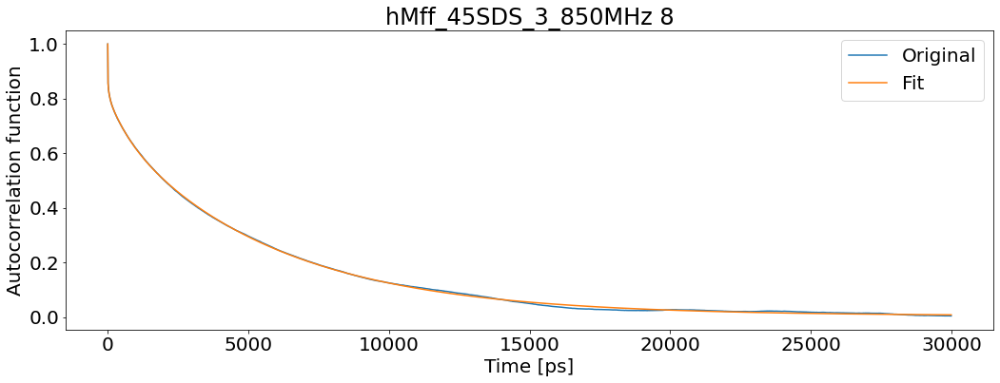

T1: 0.8021360057219622 T2: 0.11215380639931105 NOE: 0.672079007786571


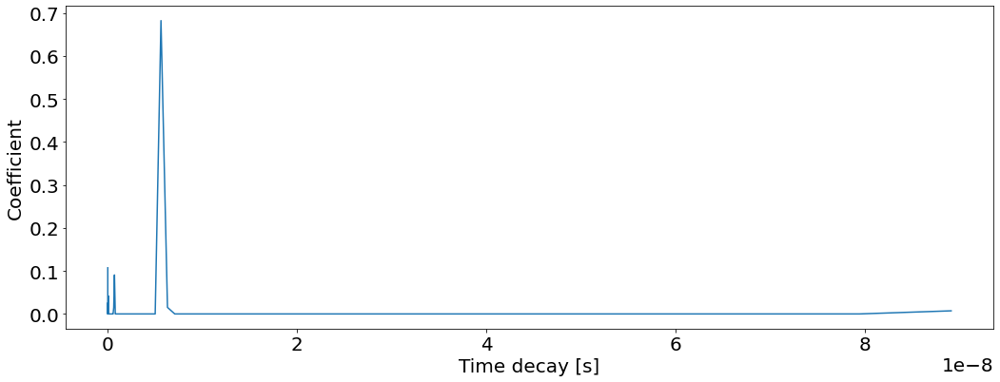

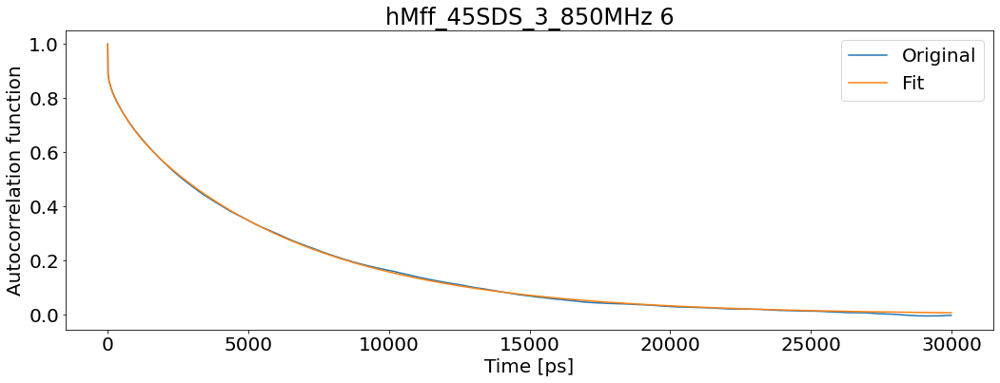

T1: 0.8236321684531182 T2: 0.1069641265055181 NOE: 0.6923770328162344


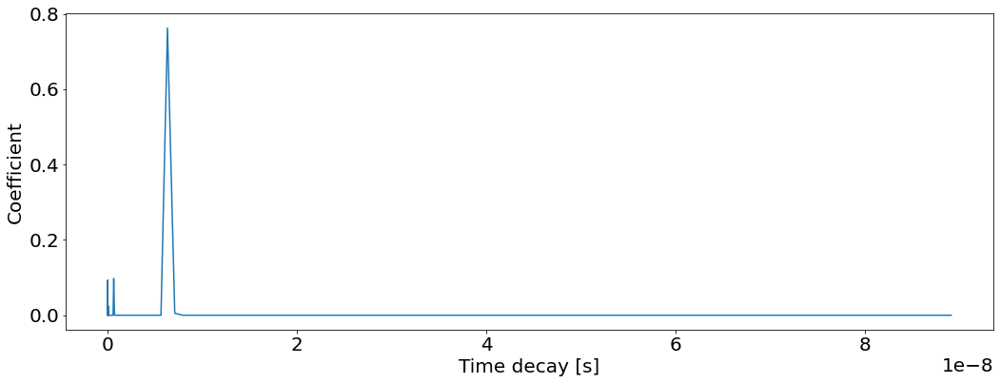

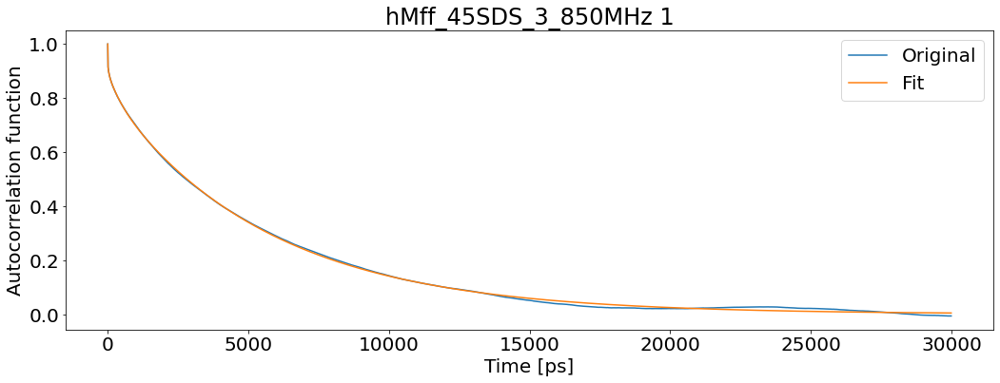

T1: 0.7572848631123493 T2: 0.10724418263908893 NOE: 0.7074806958868353


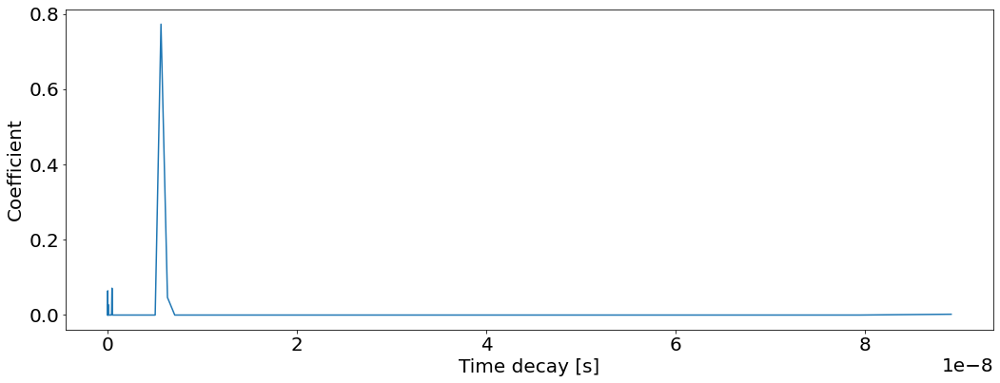

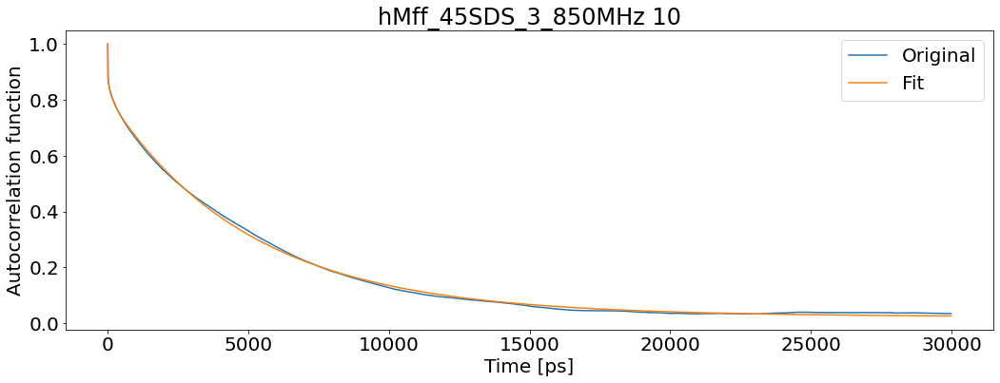

T1: 0.7591723686898227 T2: 0.07724595307460708 NOE: 0.7084743077358779


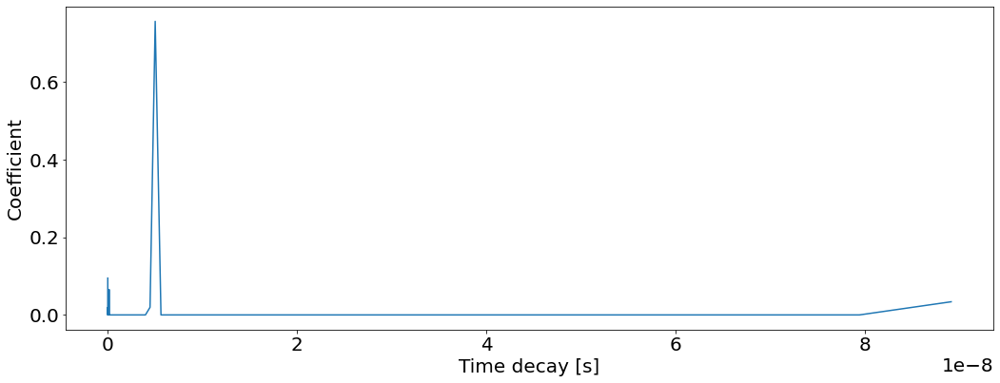

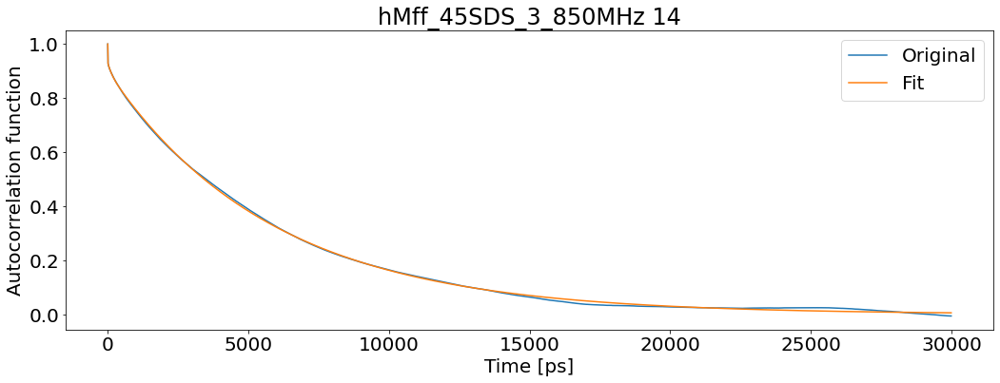

T1: 0.7603257076751028 T2: 0.09722354518946887 NOE: 0.7838770221886986


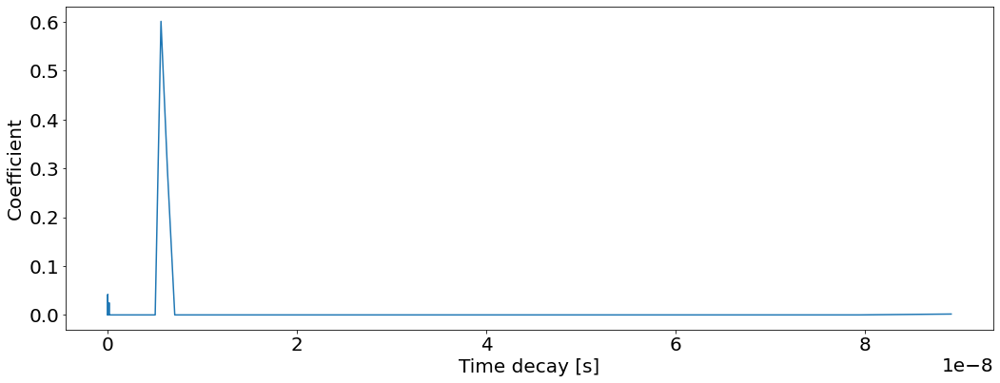

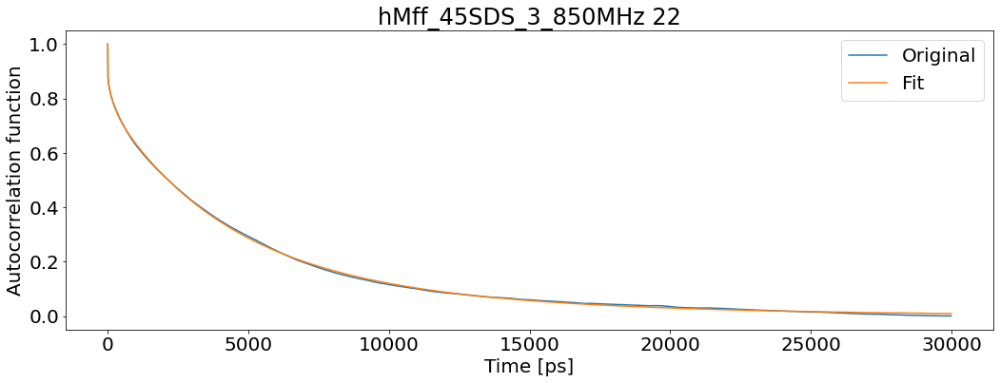

T1: 0.729595690159394 T2: 0.11923715534175008 NOE: 0.65240607901712


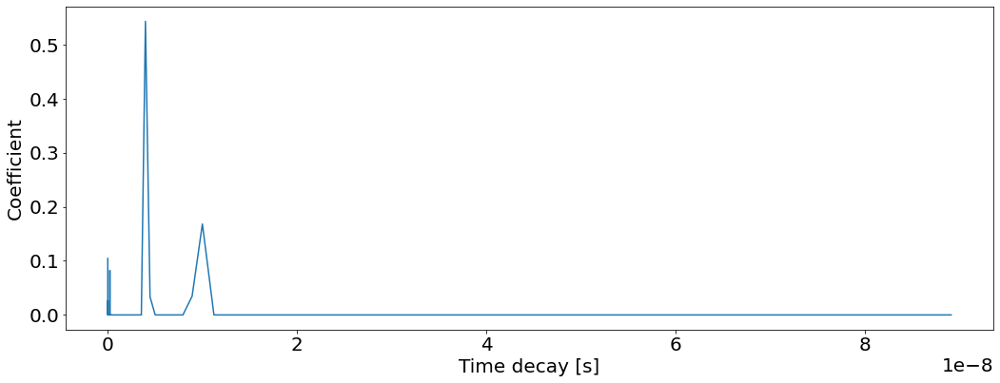

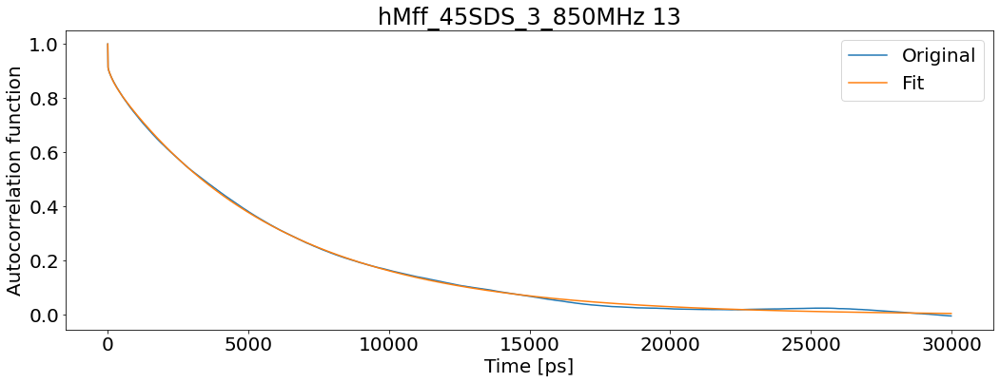

T1: 0.7809896264084956 T2: 0.10053018865035415 NOE: 0.7733306555052634


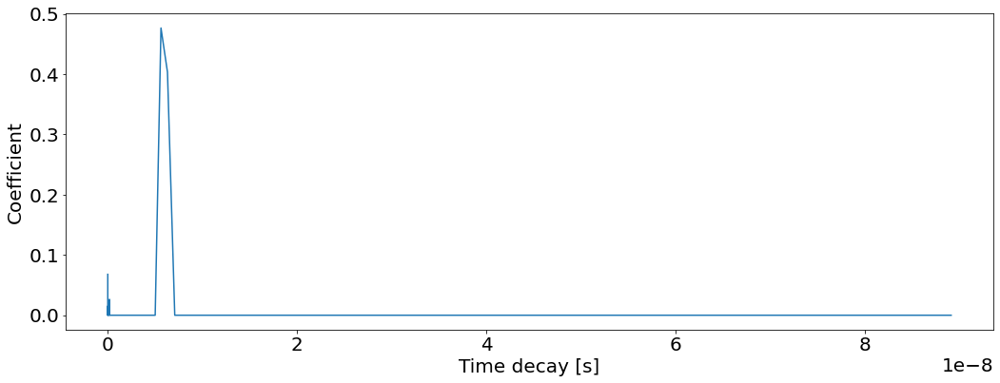

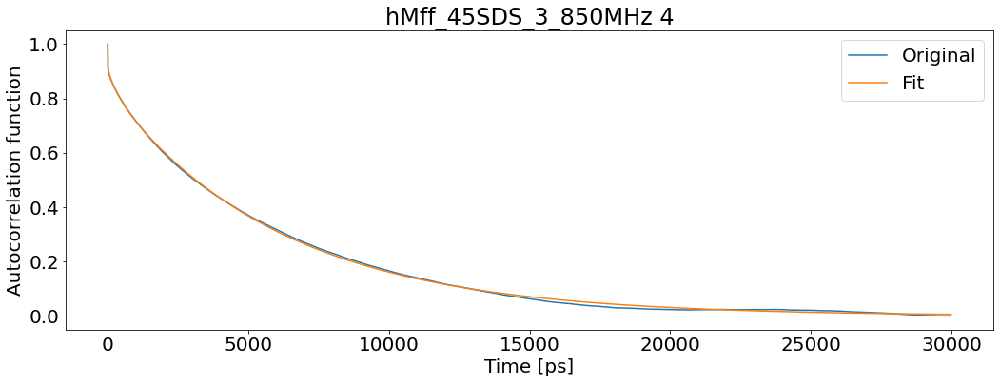

T1: 0.7962953771770853 T2: 0.10275149826062768 NOE: 0.7243771954632827


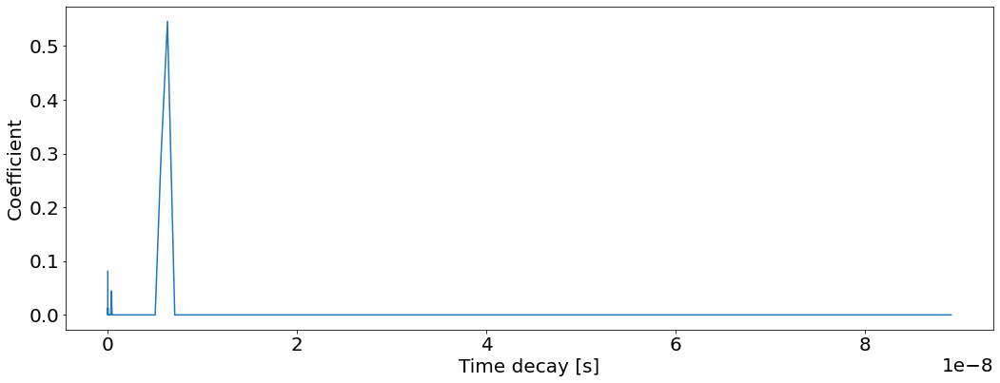

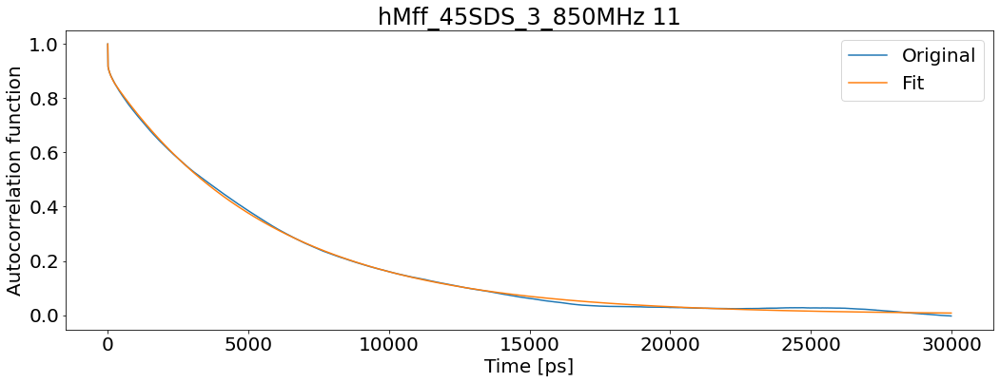

T1: 0.7658376255044791 T2: 0.09661169996959731 NOE: 0.8015927304571474


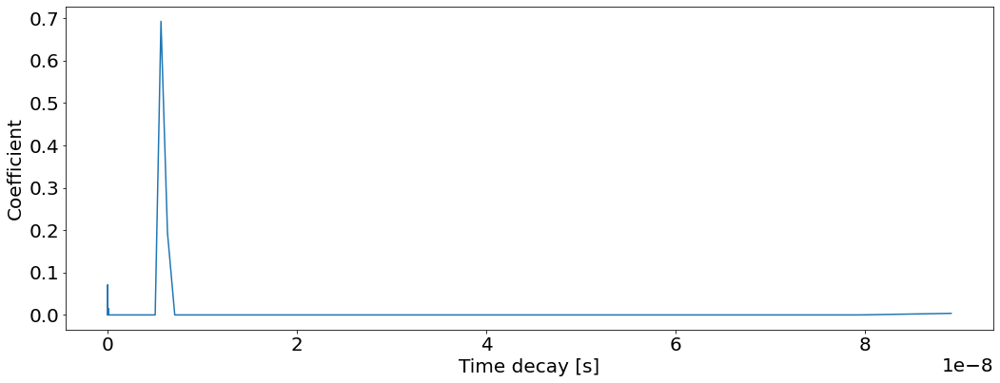

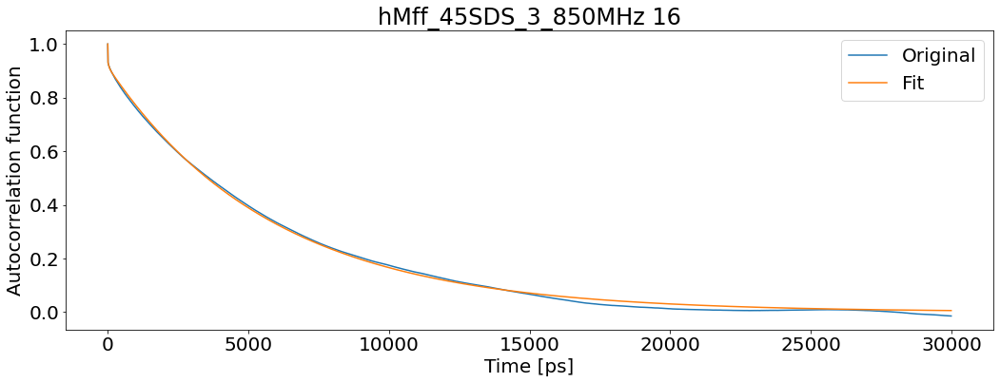

T1: 0.7558581398021703 T2: 0.09812306081769798 NOE: 0.8297705918441898


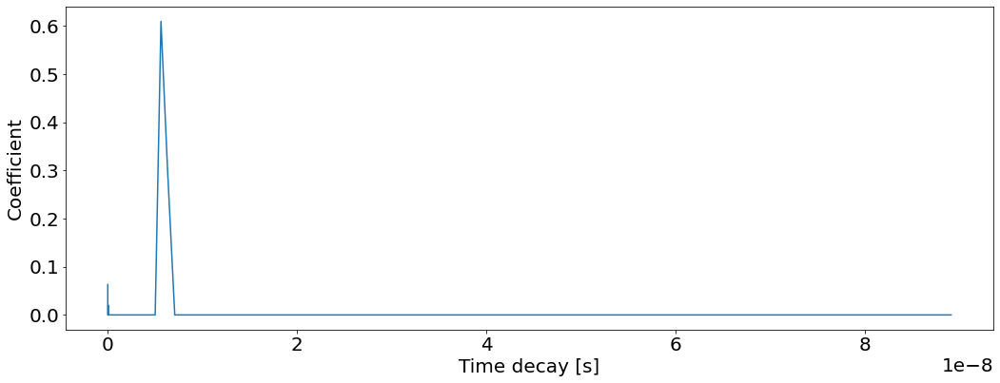

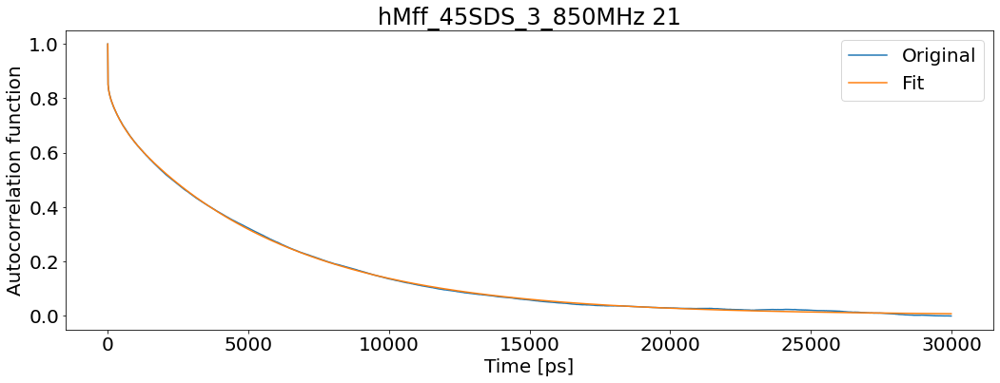

T1: 0.841486869488175 T2: 0.11159621633411566 NOE: 0.653115338579061


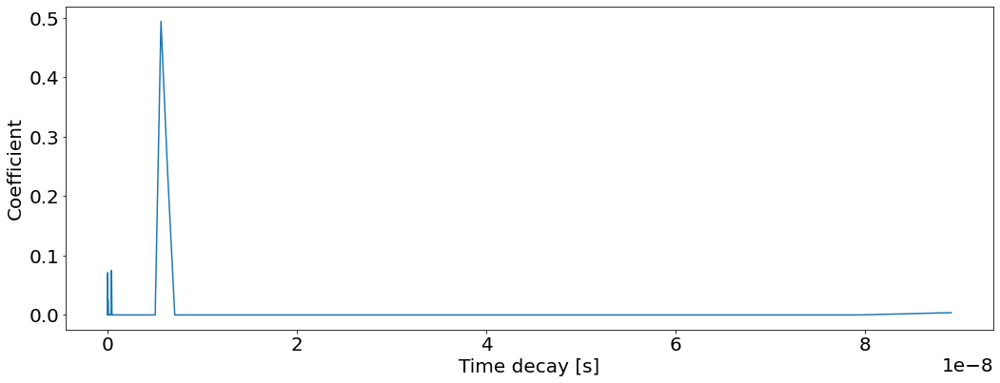

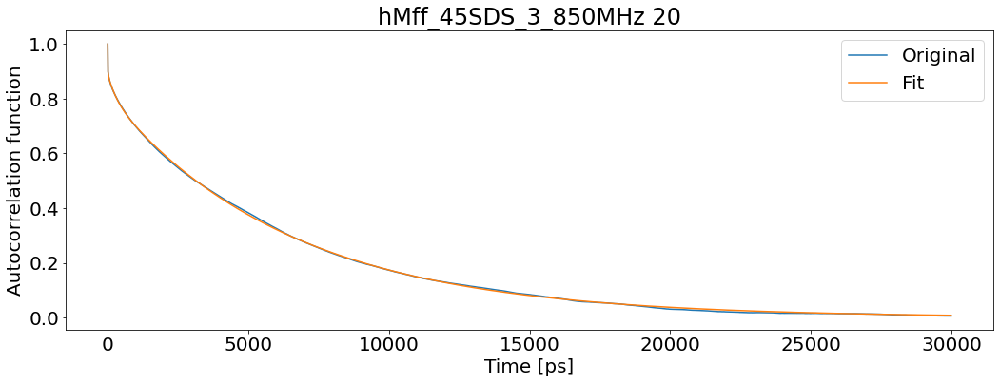

T1: 0.859474958097423 T2: 0.09995038575127604 NOE: 0.6706960964357342


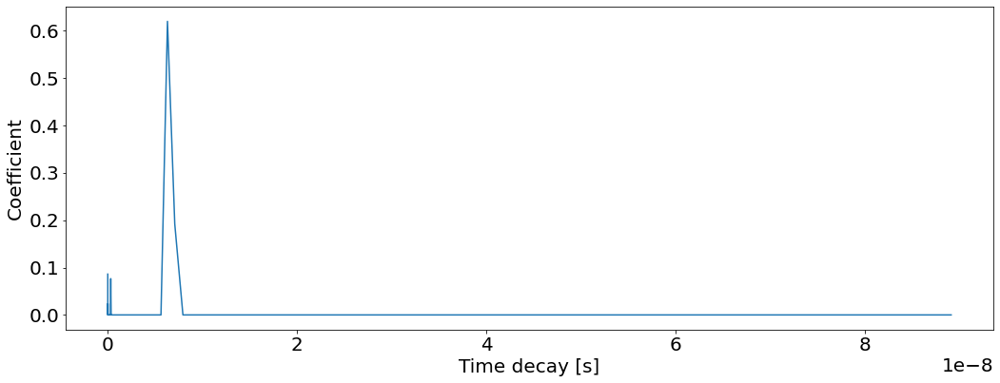

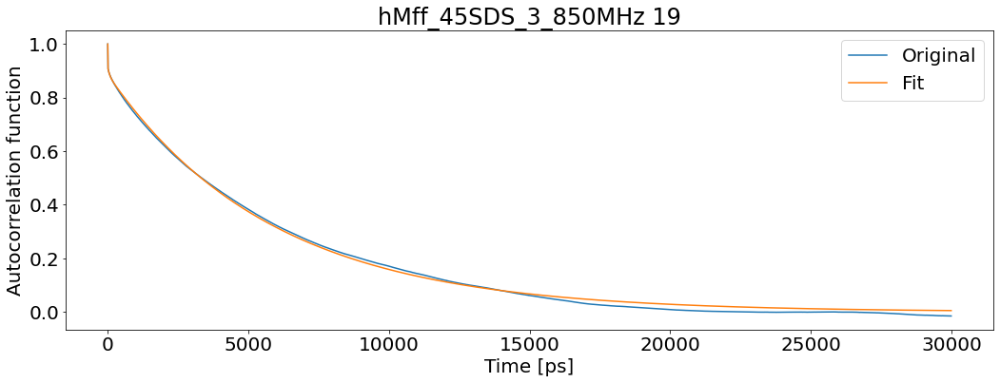

T1: 0.7738400053536338 T2: 0.10187945638403488 NOE: 0.8150104458029279


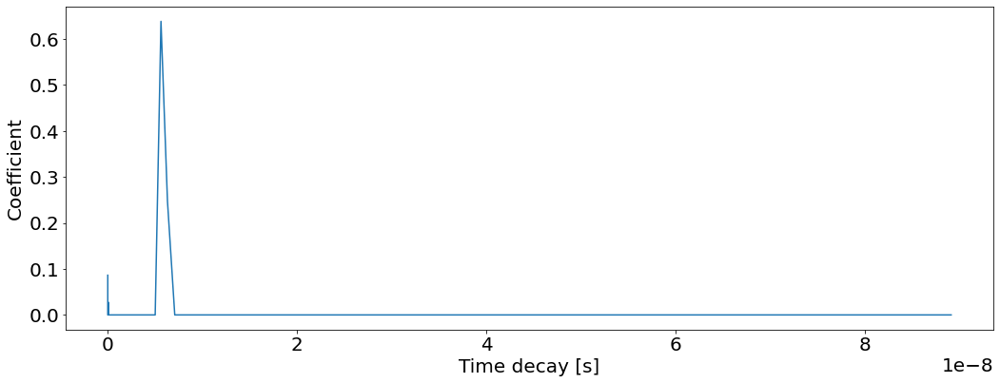

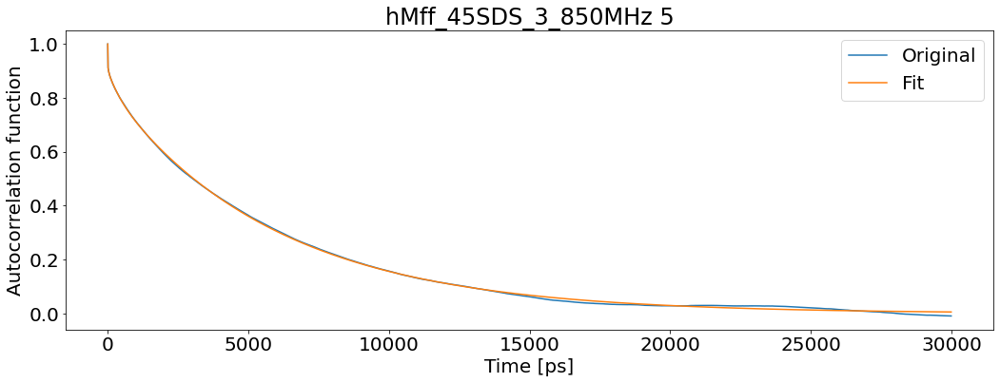

T1: 0.7837810566360012 T2: 0.10460091725163986 NOE: 0.7223102679019904


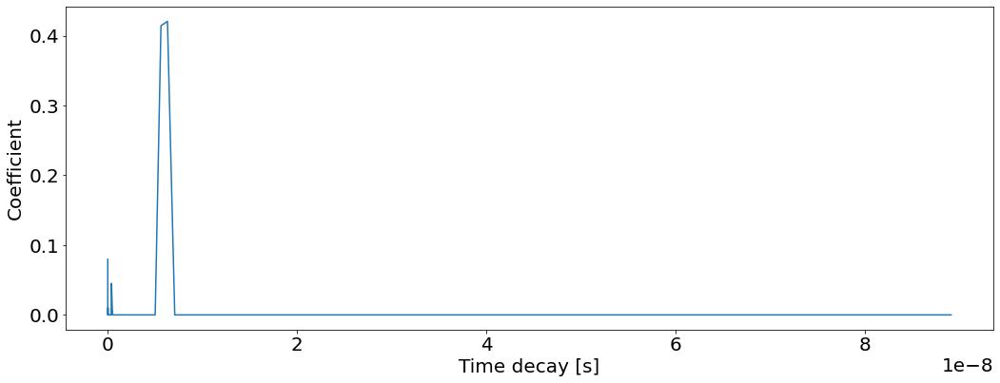

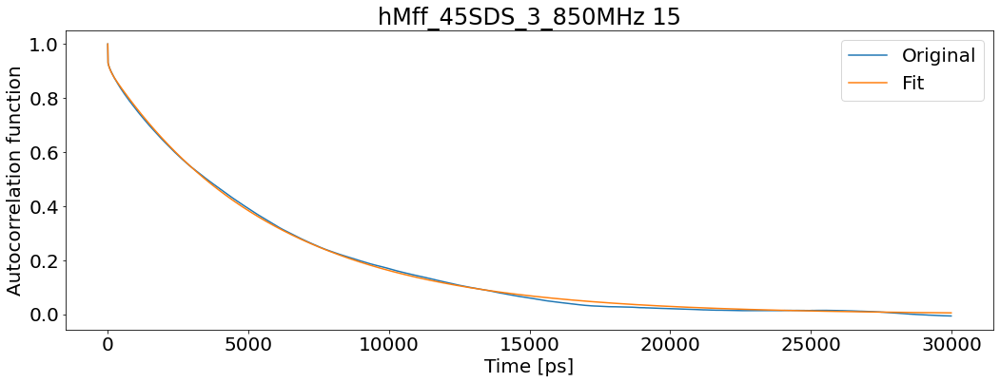

T1: 0.7510153562970694 T2: 0.09950717984769822 NOE: 0.8153577306710063


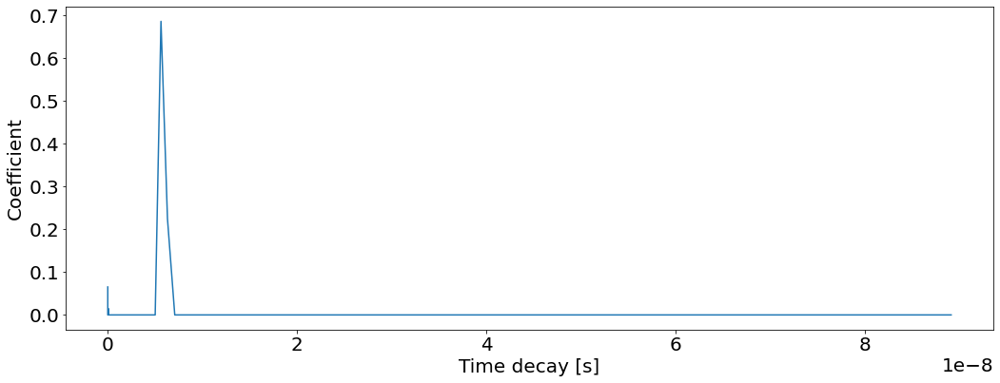

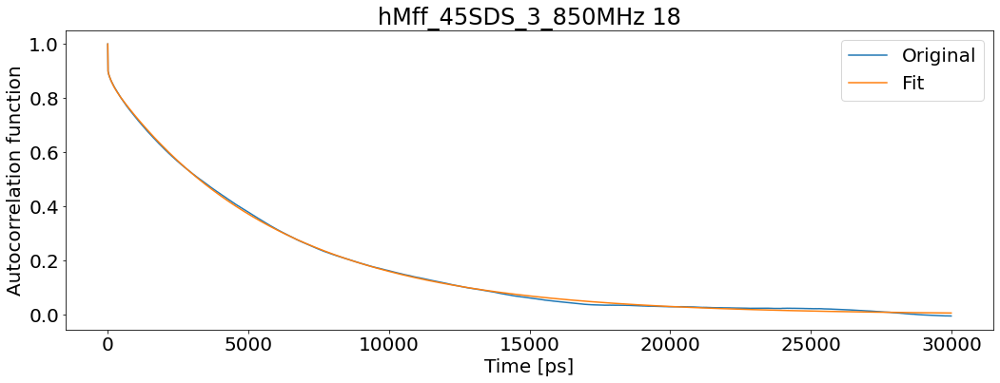

T1: 0.7915166704571394 T2: 0.1025201039762584 NOE: 0.7762138619632182


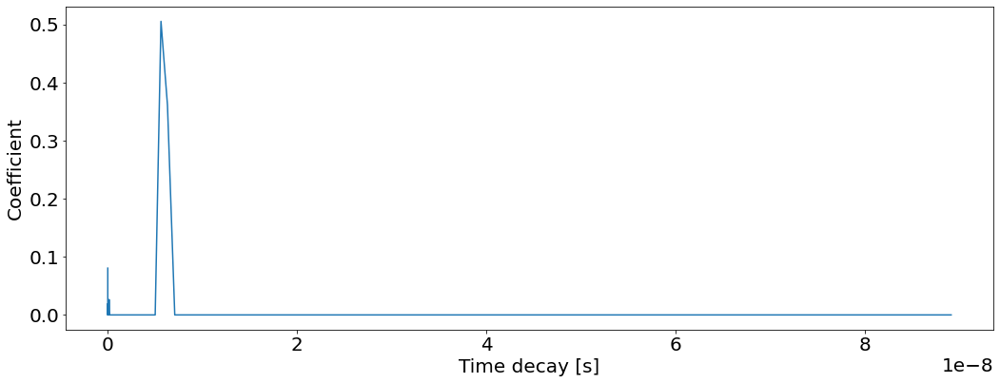

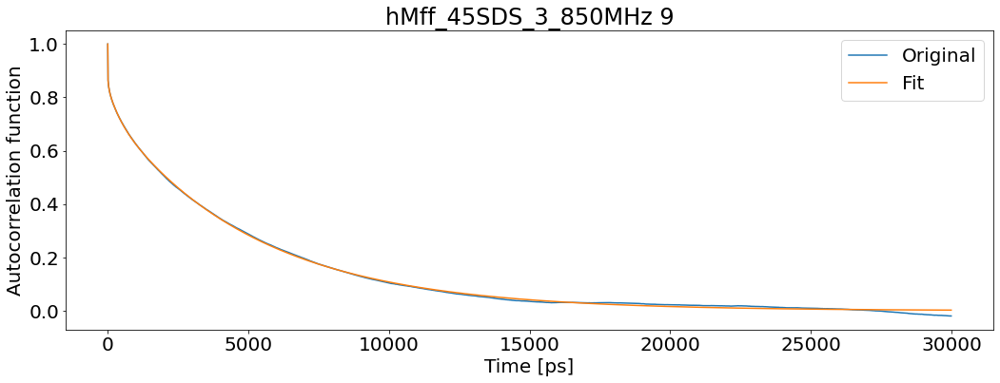

T1: 0.7569263885762436 T2: 0.1312263481119916 NOE: 0.6655578174634127


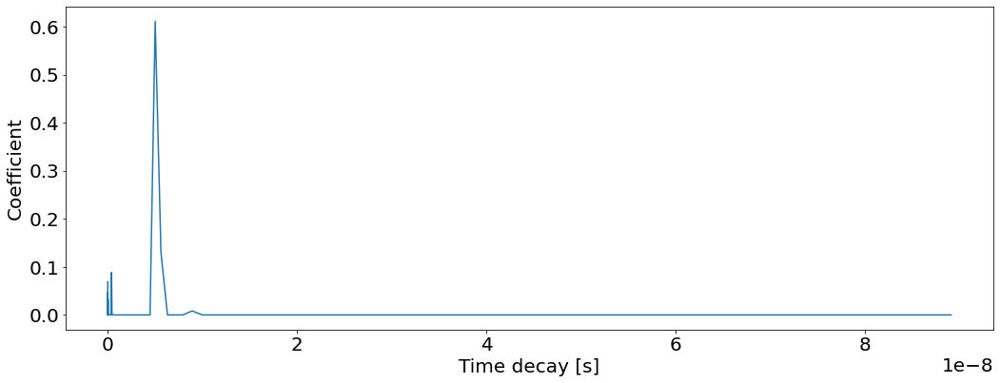

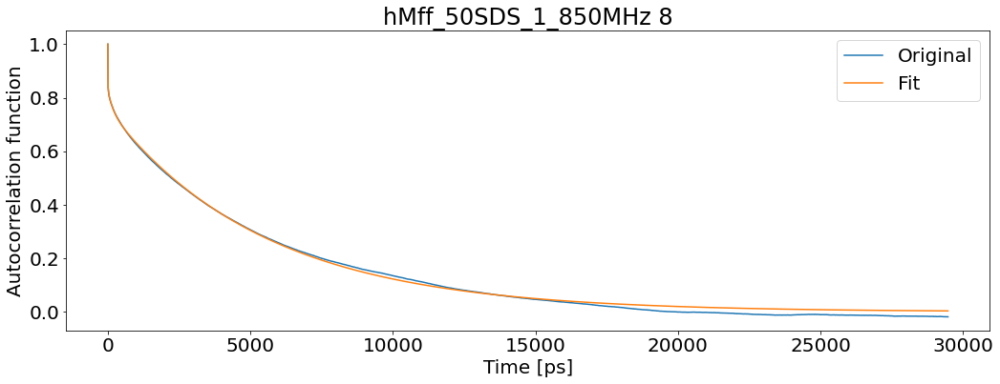

T1: 0.8270905666498488 T2: 0.12437768523764353 NOE: 0.669811550306777


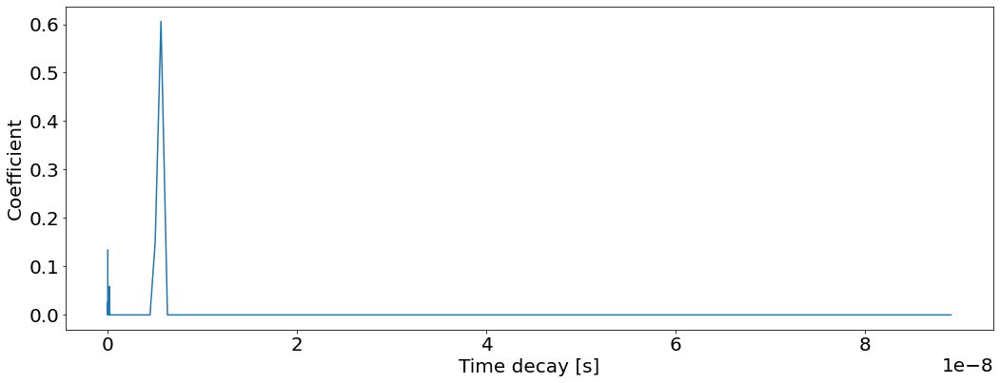

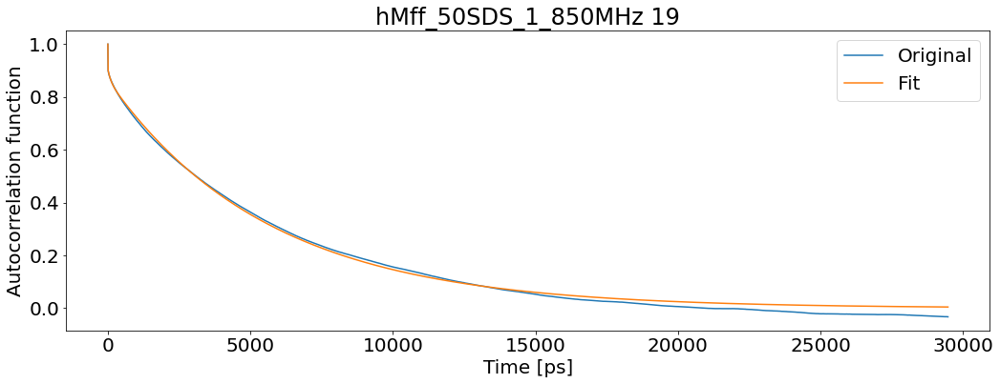

T1: 0.765231441078675 T2: 0.10742255606013412 NOE: 0.7769302416165353


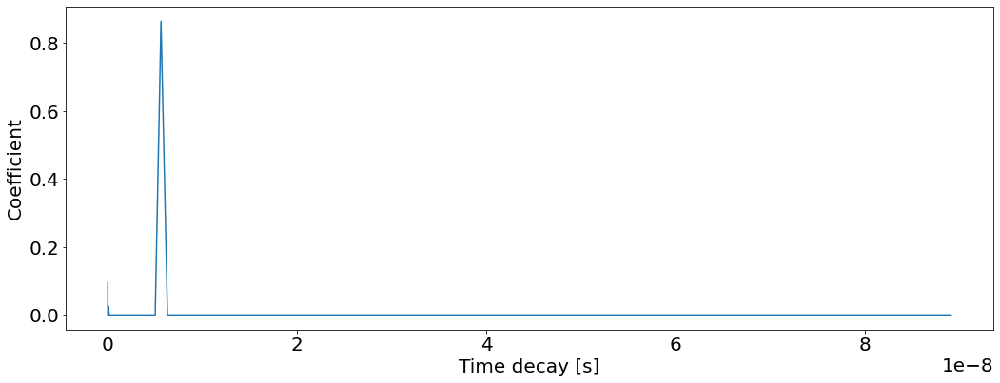

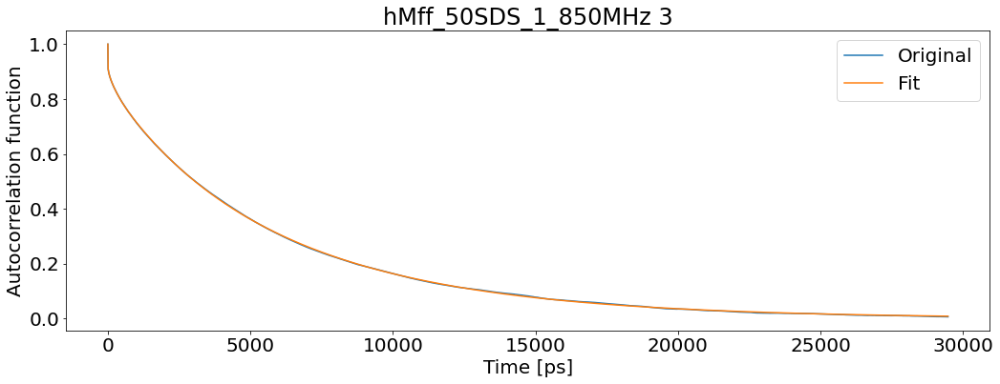

T1: 0.7723943756137699 T2: 0.10135454985611579 NOE: 0.7322651753690177


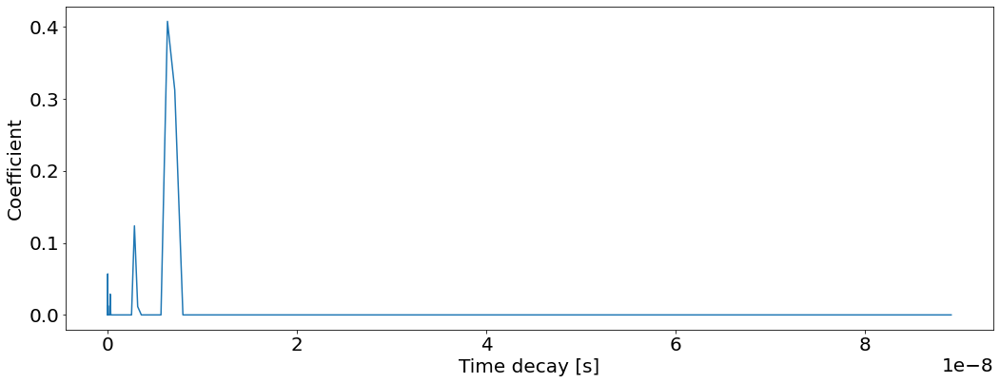

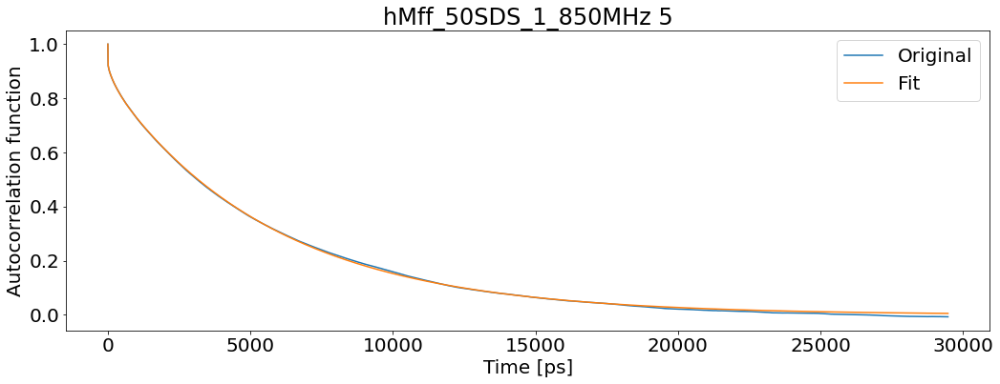

T1: 0.7588374355391484 T2: 0.10453062968495866 NOE: 0.740381948017413


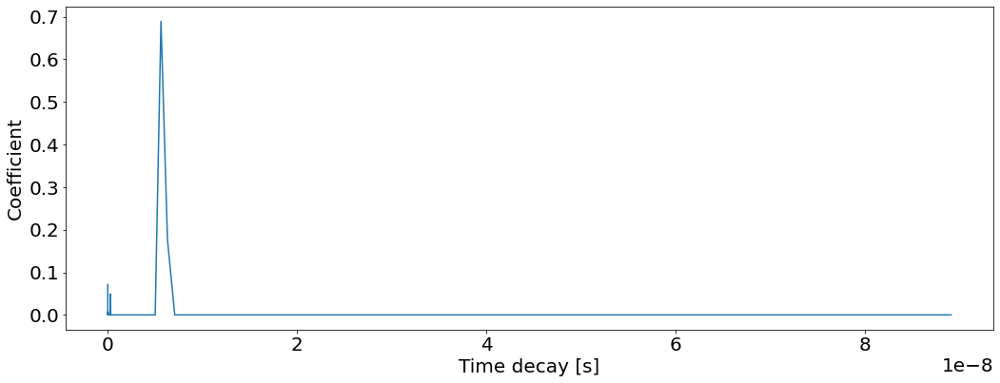

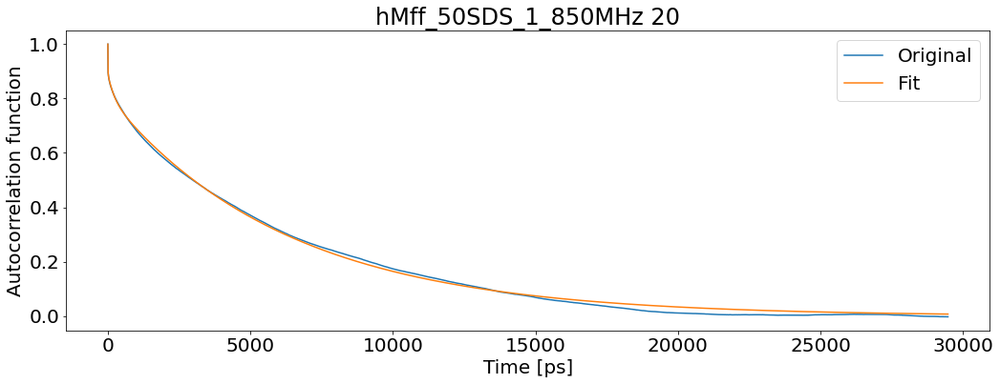

T1: 0.8509995657350359 T2: 0.10357337591631521 NOE: 0.6472583248227578


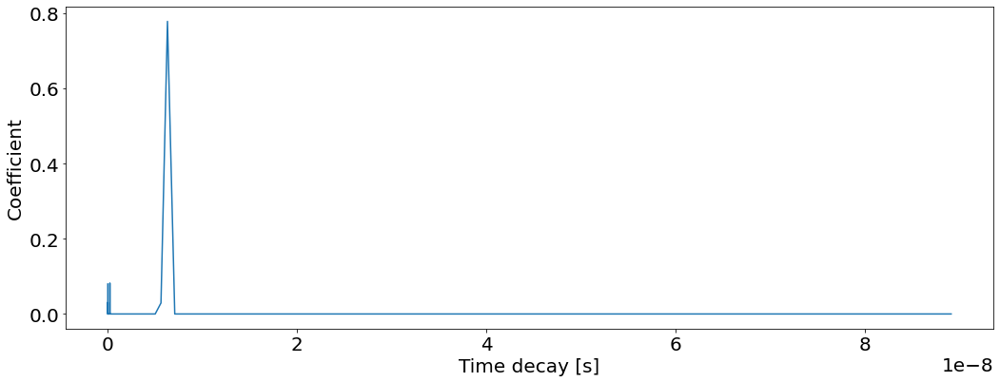

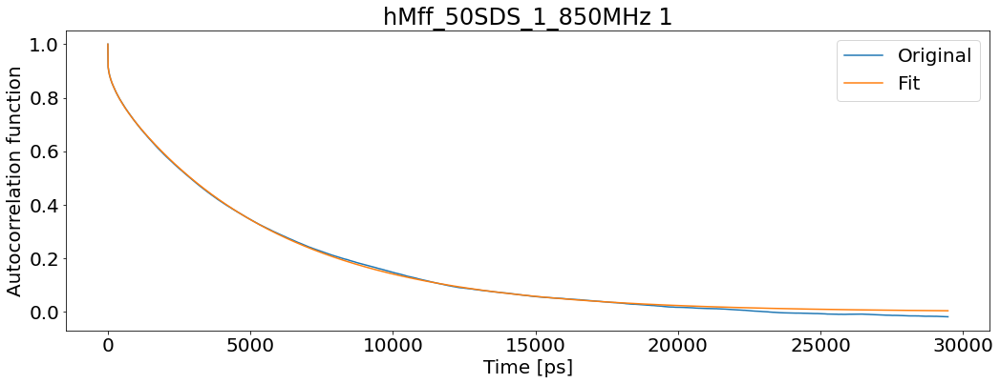

T1: 0.7569194357345171 T2: 0.10998589484496561 NOE: 0.7115841459281148


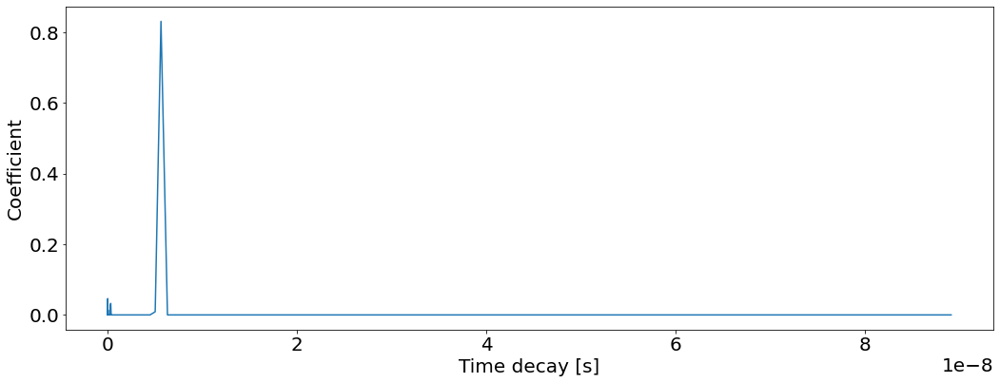

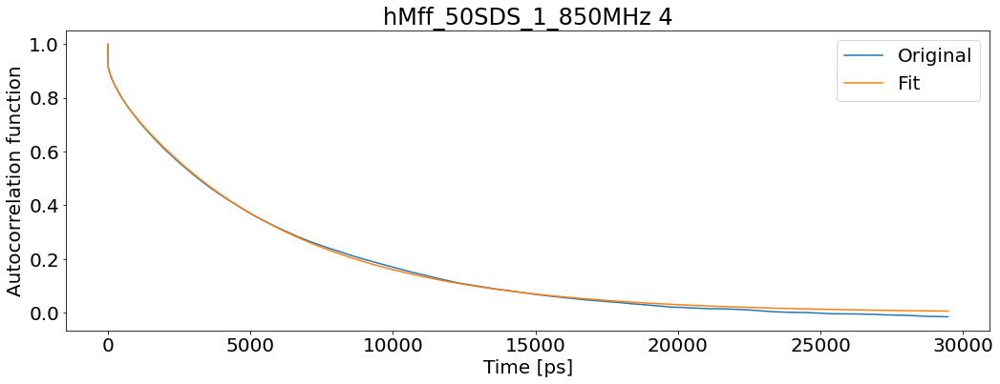

T1: 0.7827216907232861 T2: 0.1022927177389537 NOE: 0.7247565357245247


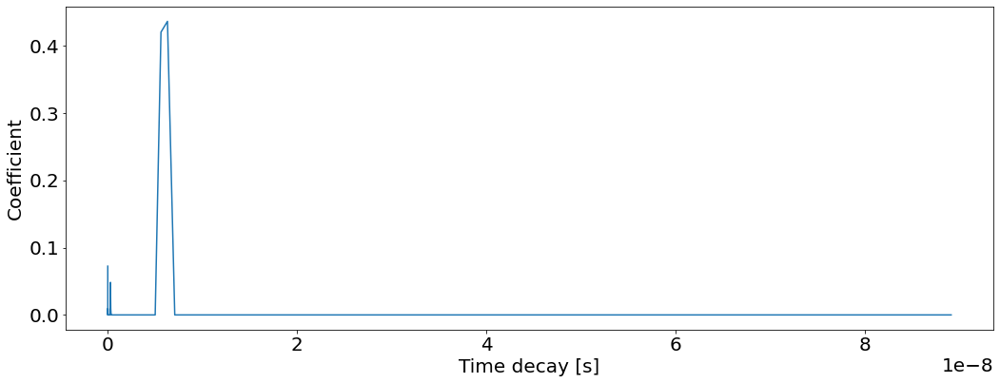

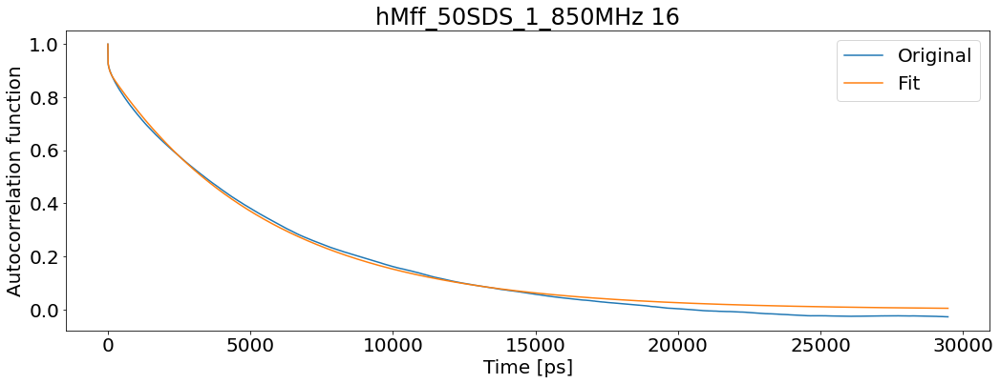

T1: 0.741758100900134 T2: 0.1031193594833206 NOE: 0.817109026418164


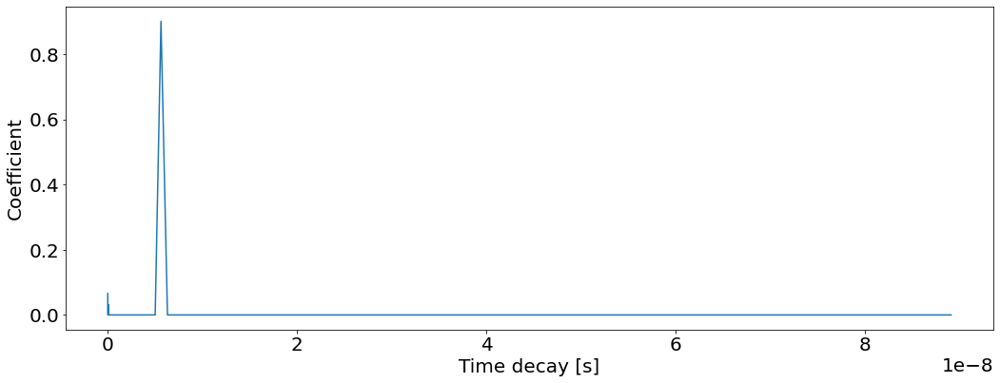

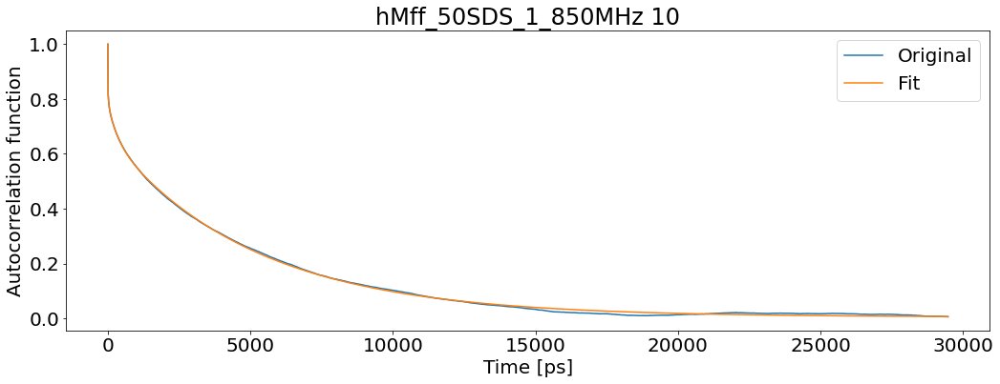

T1: 0.8219926725029718 T2: 0.12838870746061987 NOE: 0.5594423506494106


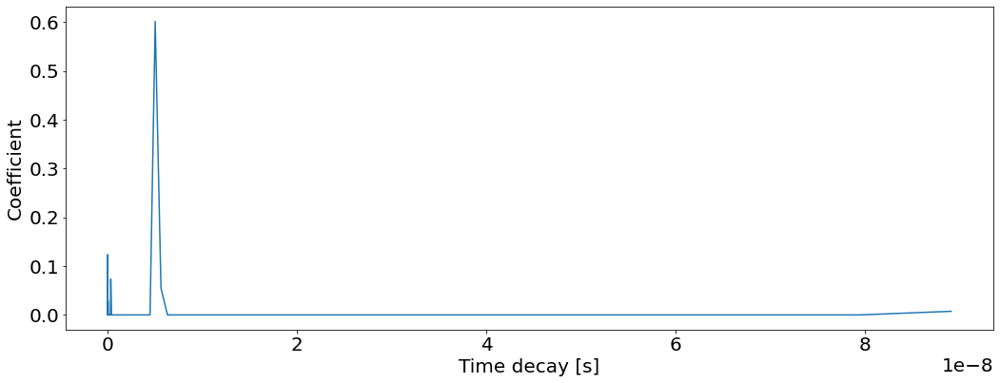

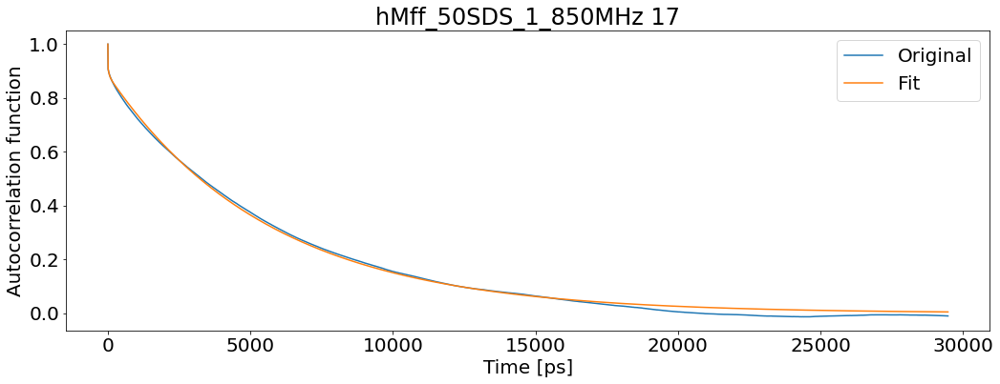

T1: 0.7585409249005848 T2: 0.10468101433394067 NOE: 0.8206571803744382


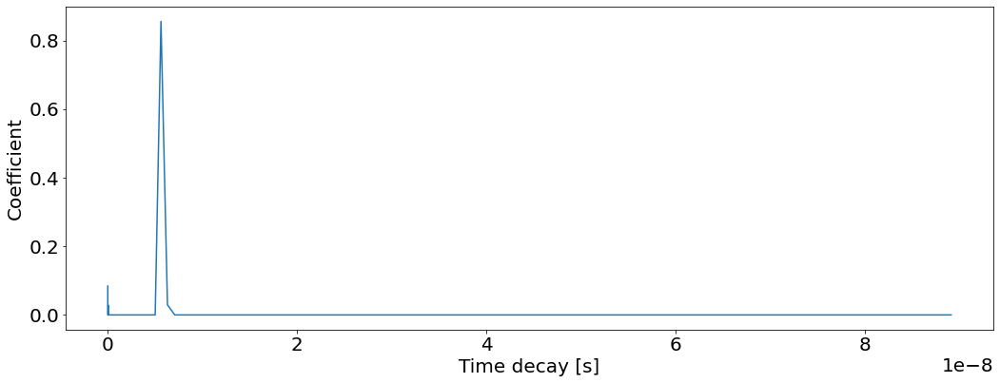

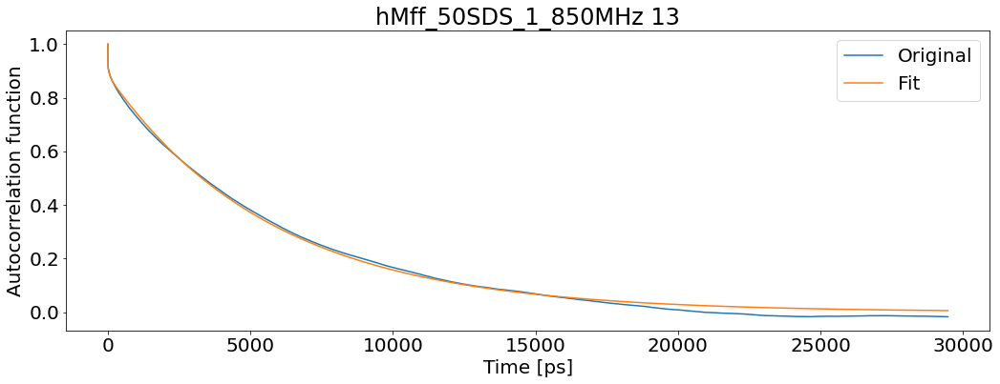

T1: 0.7720781171255634 T2: 0.10250586784658607 NOE: 0.8077933415038357


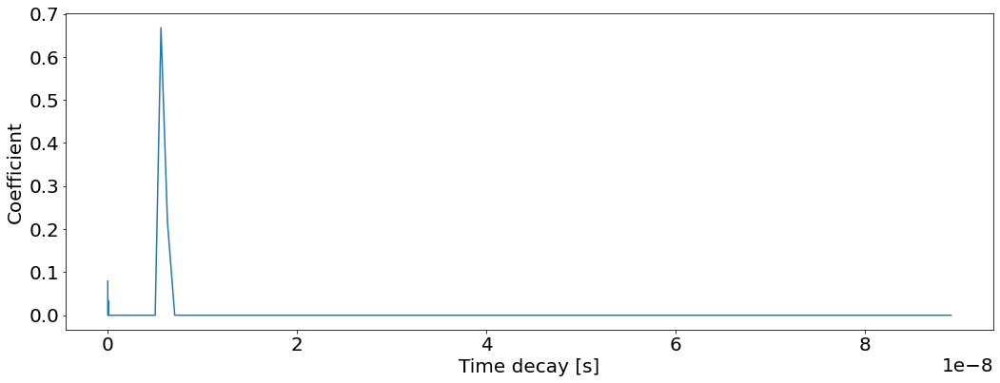

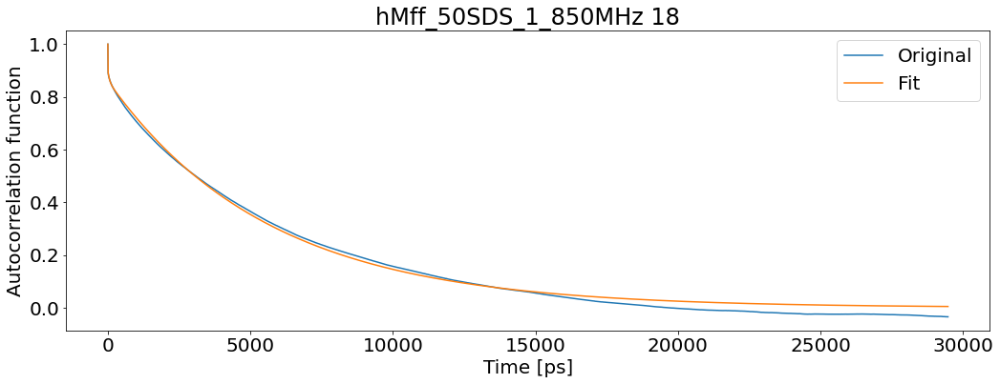

T1: 0.7746979826566599 T2: 0.10799201448538315 NOE: 0.804925734334689


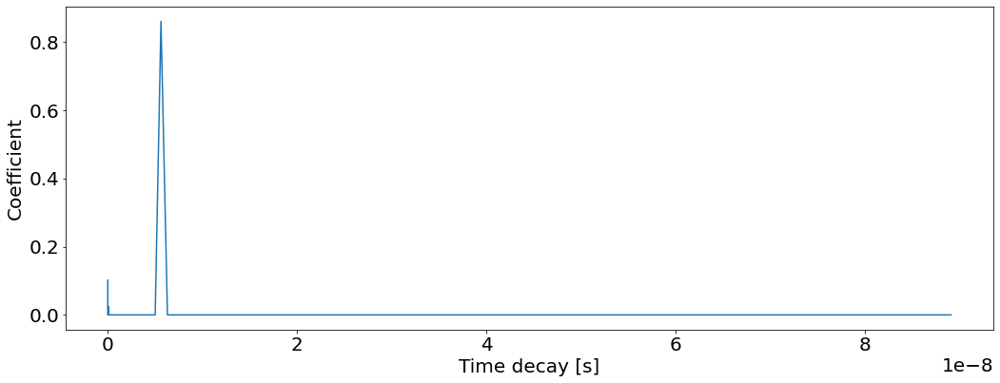

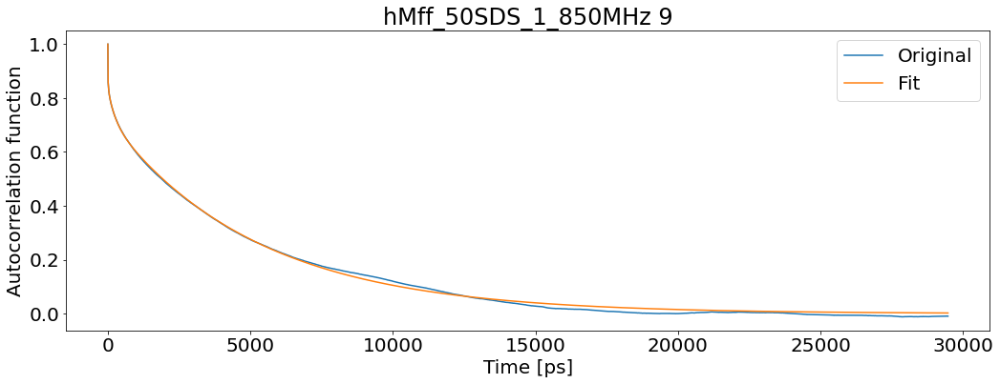

T1: 0.7868797824920135 T2: 0.13535093357530875 NOE: 0.5839975089648255


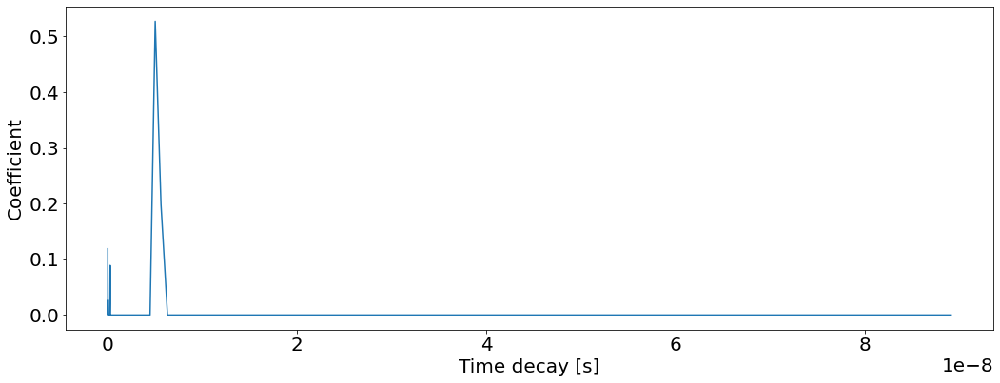

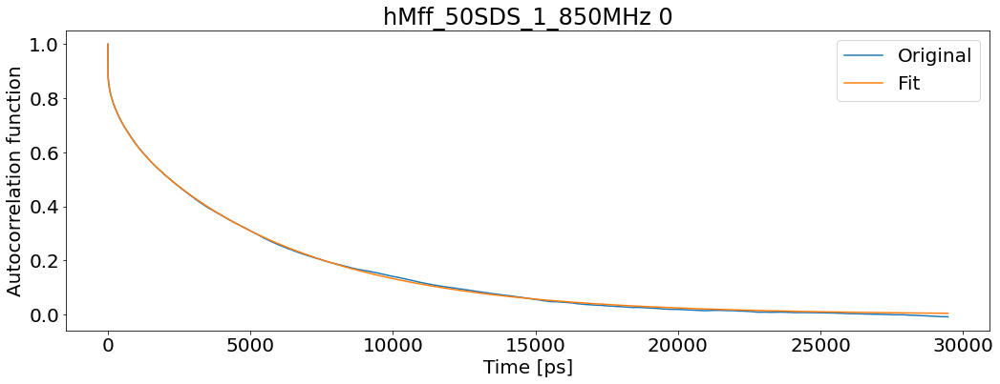

T1: 0.812070000984349 T2: 0.11973237010860072 NOE: 0.6265176746723884


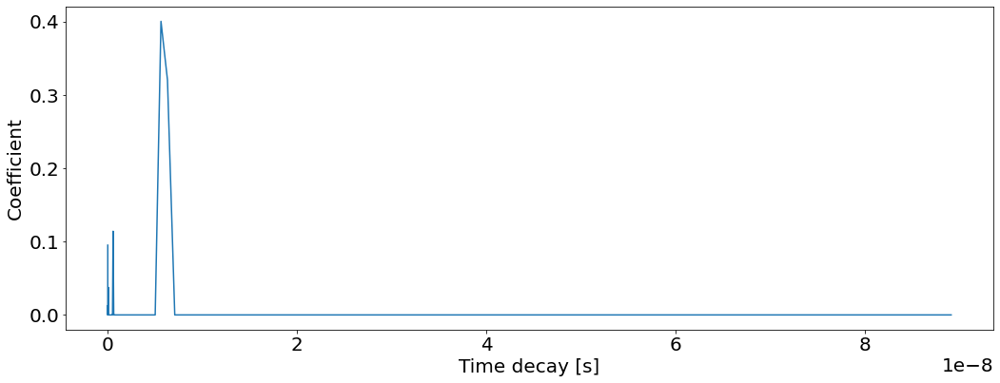

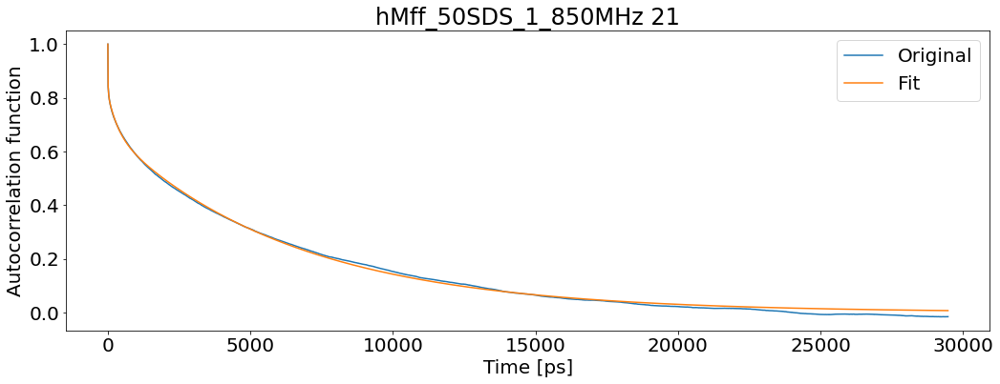

T1: 0.9288261622758024 T2: 0.11943522101720529 NOE: 0.5134876158102227


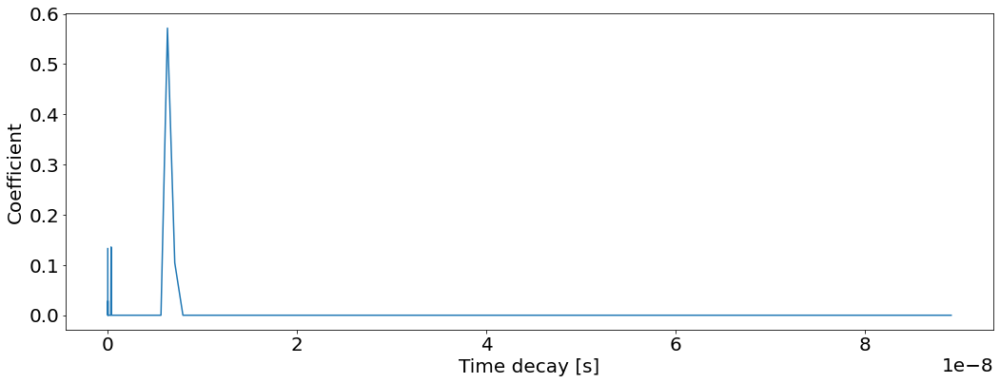

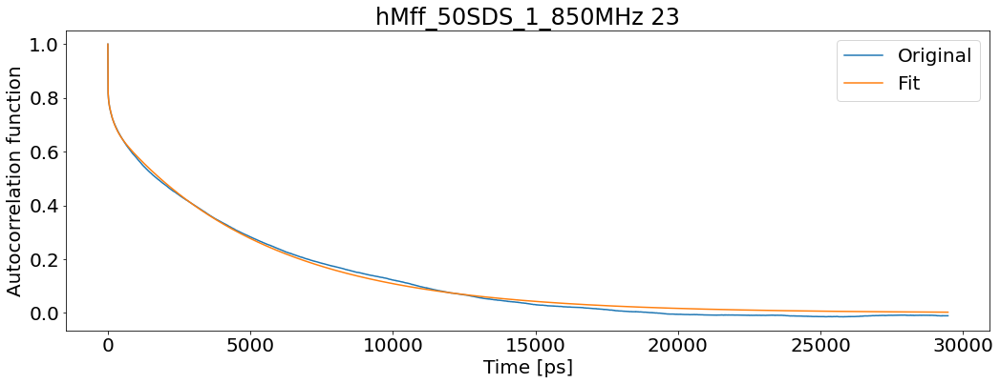

T1: 0.8488326257157025 T2: 0.13588534259620533 NOE: 0.6018610917232274


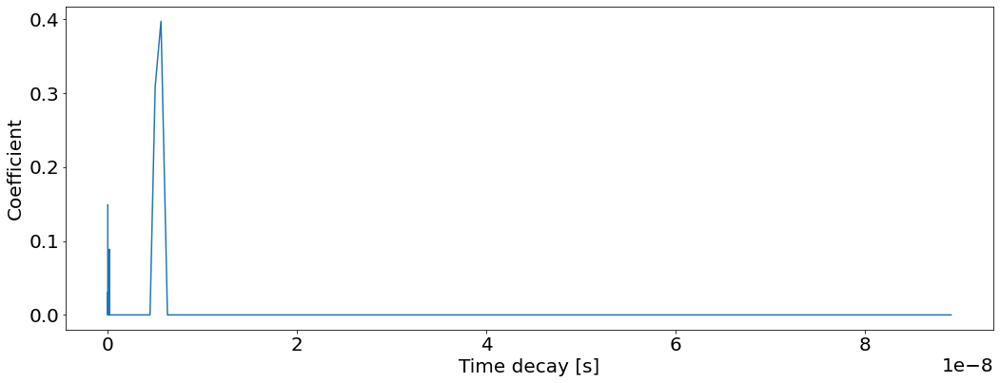

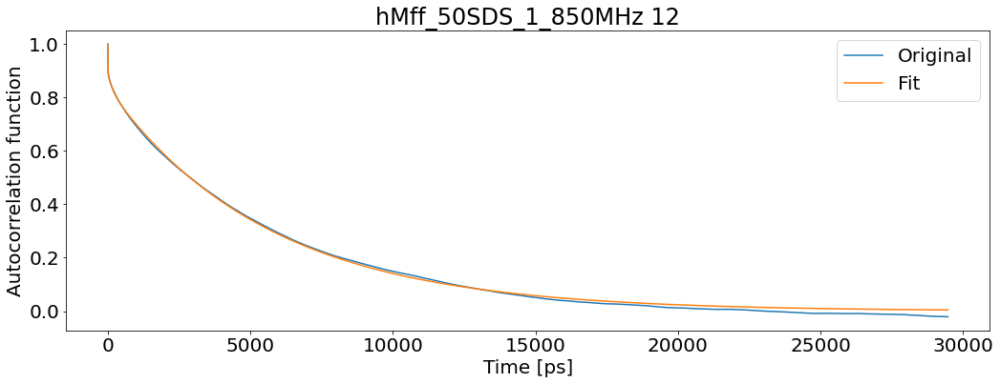

T1: 0.7758895554214686 T2: 0.11088180455592055 NOE: 0.7192284098036508


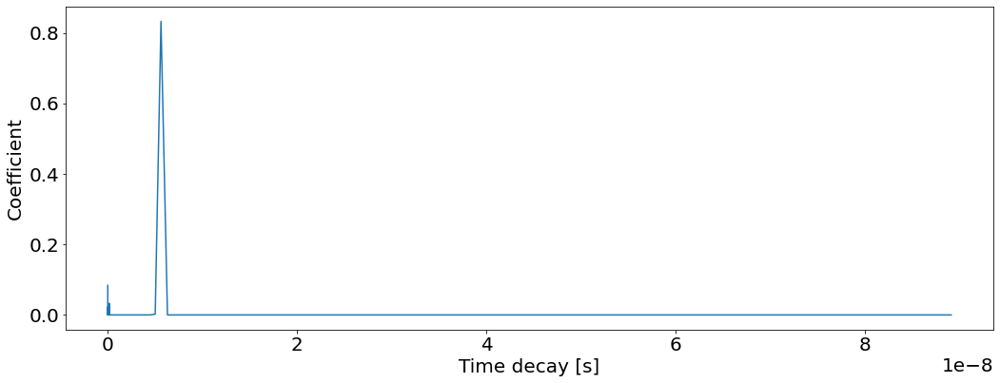

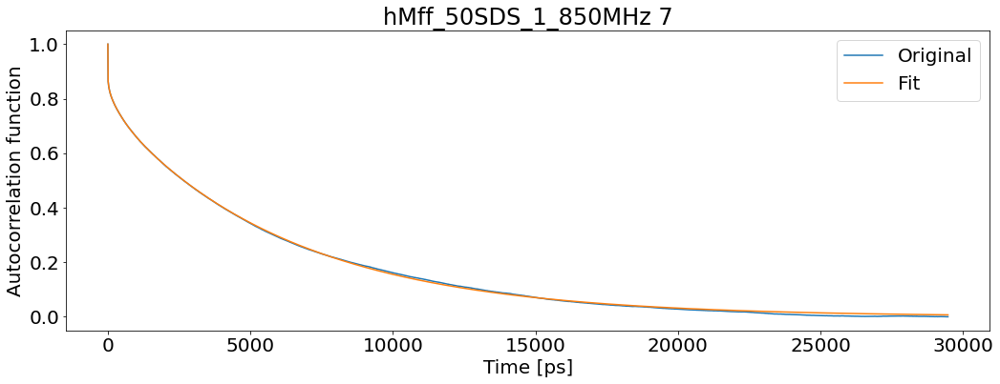

T1: 0.8703990292487885 T2: 0.10890468442956816 NOE: 0.6836080609581312


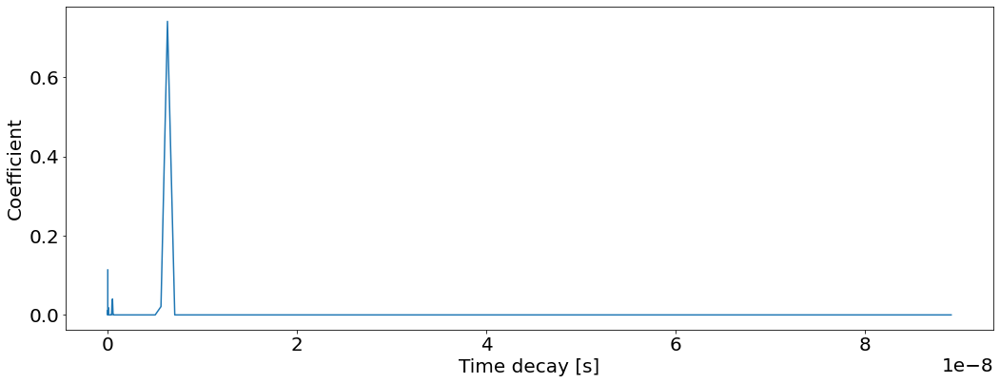

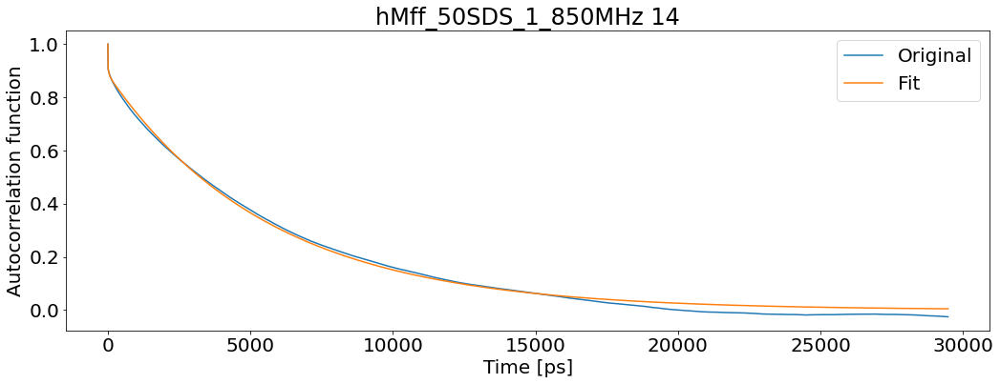

T1: 0.759209737778344 T2: 0.10449750683817192 NOE: 0.8221874609126498


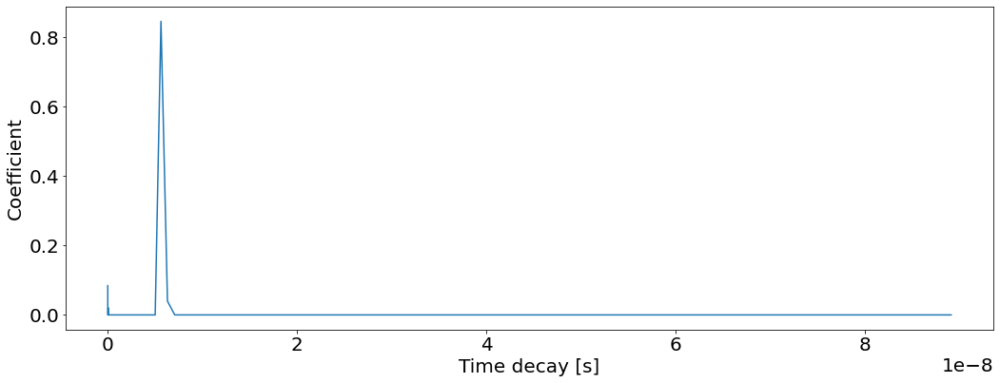

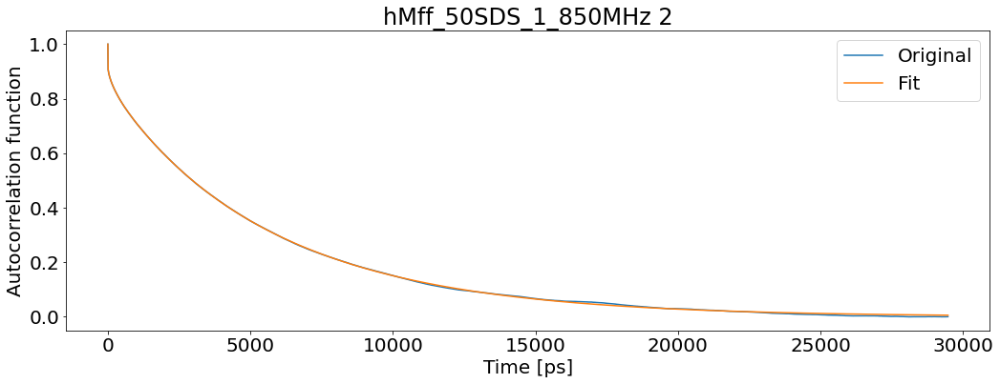

T1: 0.7639487002772042 T2: 0.1064783806345218 NOE: 0.7342836684670897


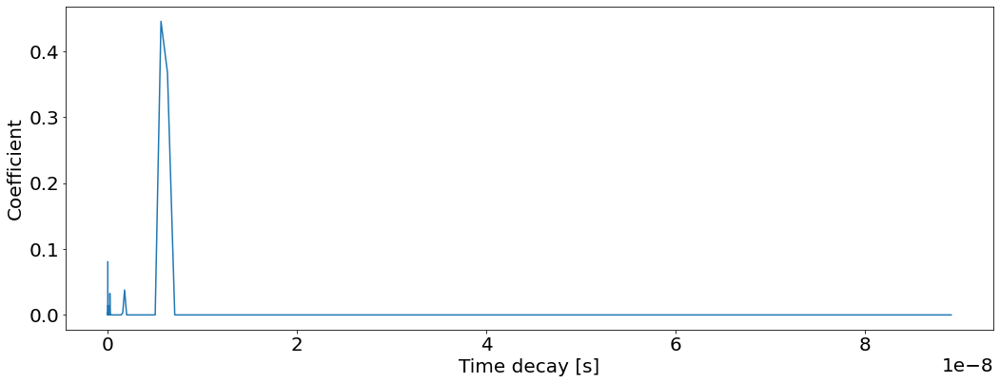

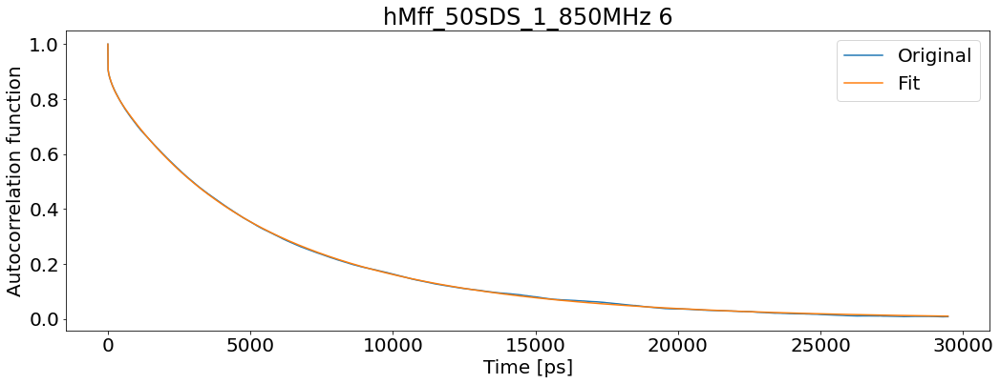

T1: 0.7564615264863613 T2: 0.1020910551734288 NOE: 0.7376696756979748


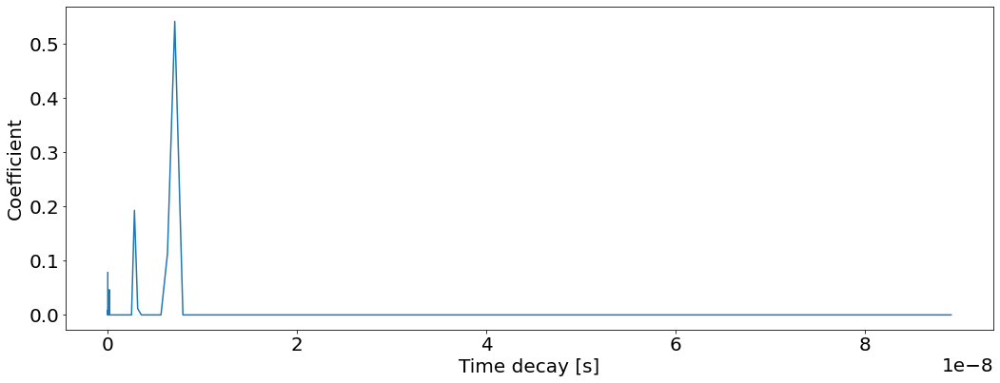

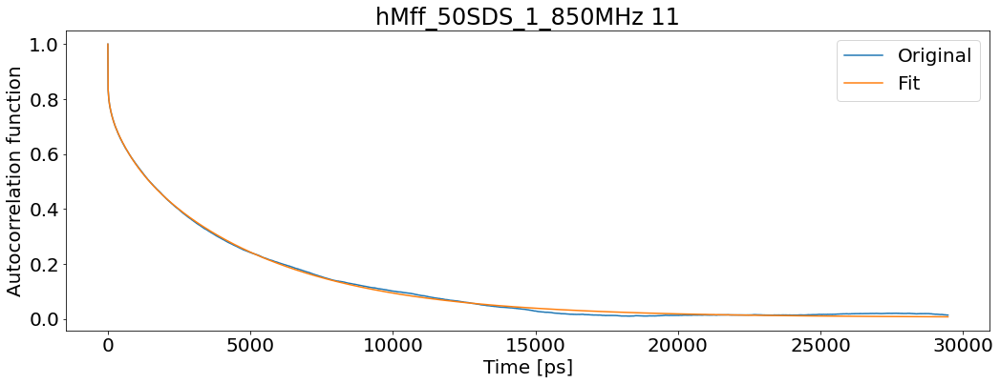

T1: 0.7716628440737562 T2: 0.12727021252076312 NOE: 0.6178760187584538


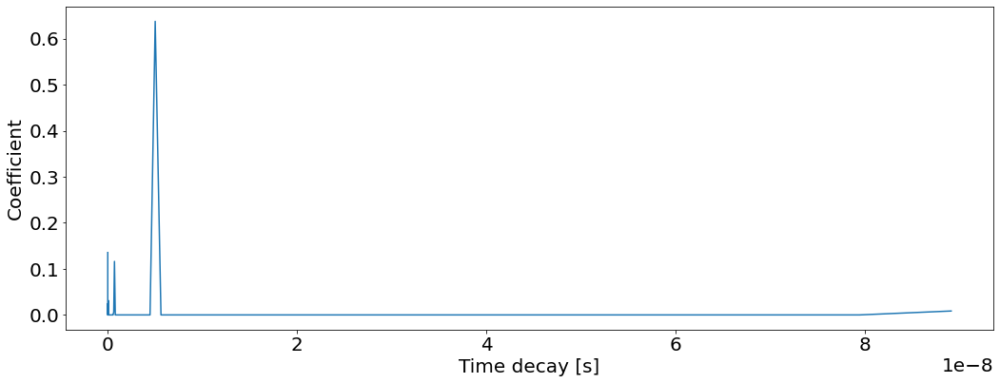

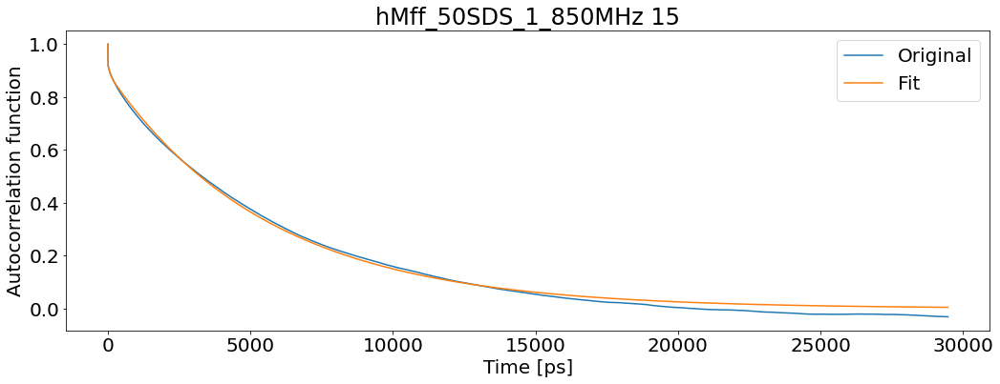

T1: 0.7472249012975354 T2: 0.10450795387837597 NOE: 0.8015864403601496


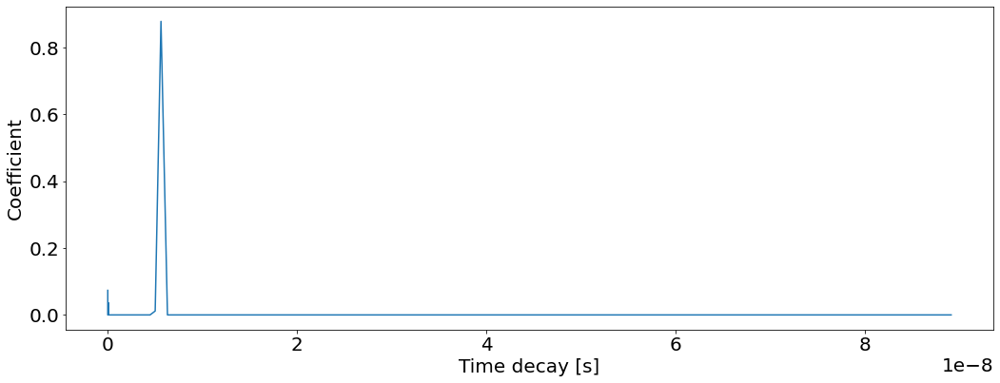

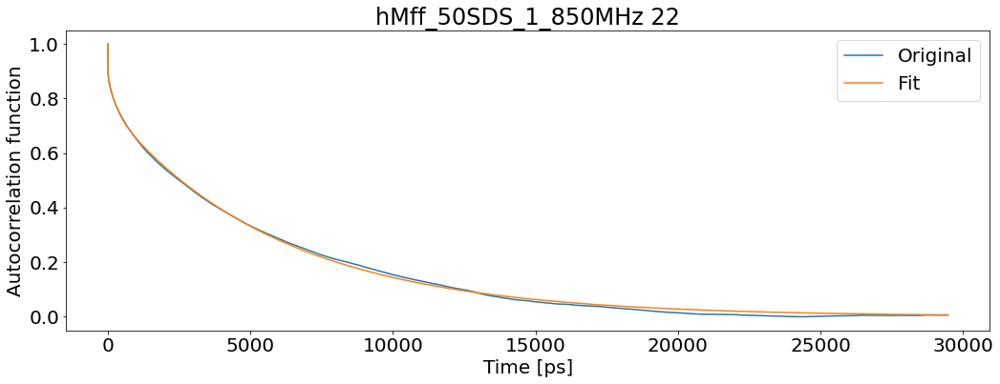

T1: 0.8195600977587106 T2: 0.11334455416403116 NOE: 0.5948582403877947


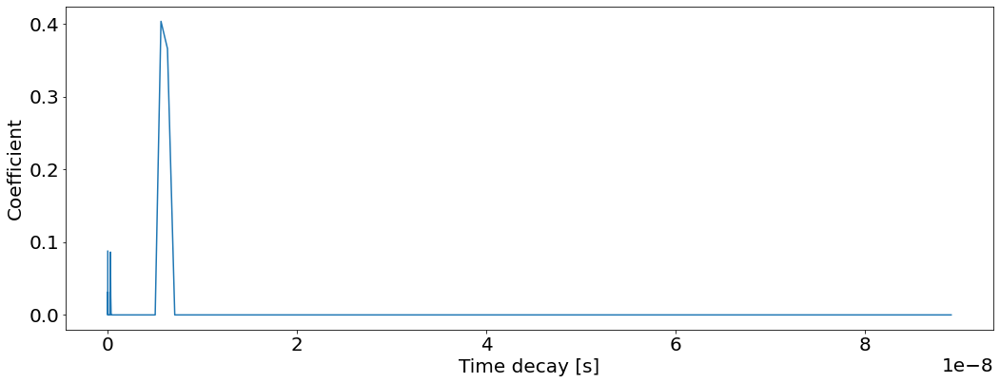

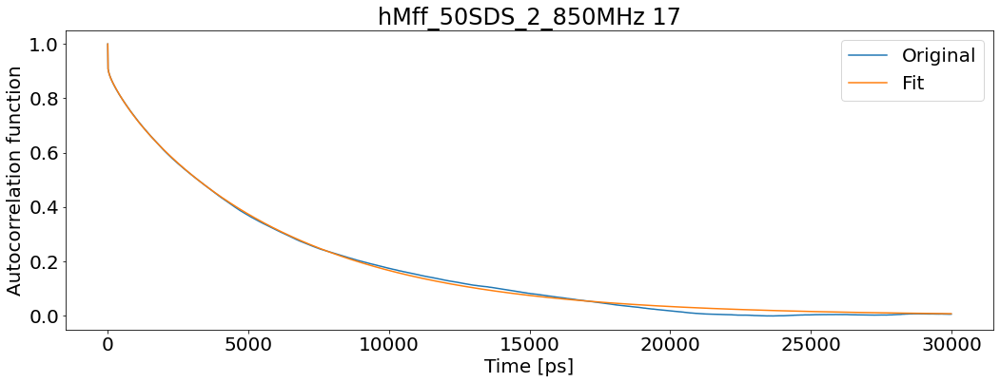

T1: 0.7948475728227868 T2: 0.10090963388796012 NOE: 0.763638180644966


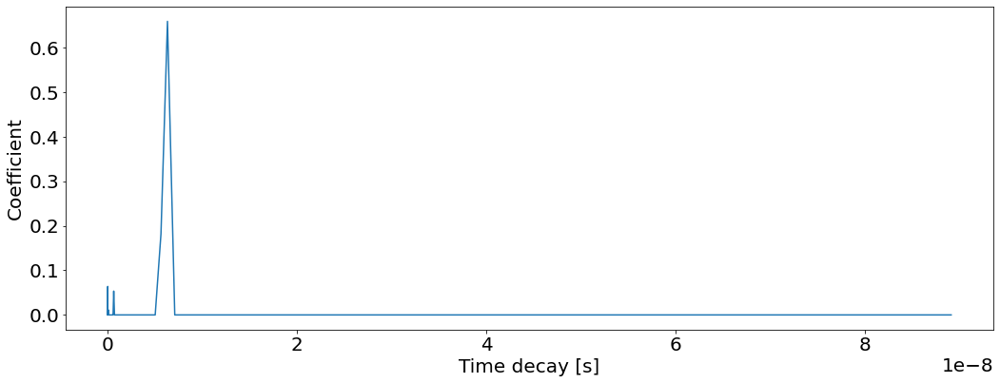

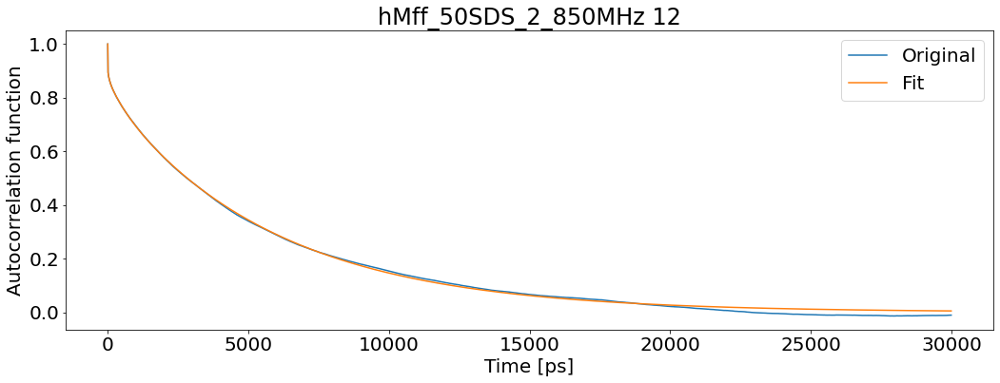

T1: 0.7834525968441423 T2: 0.10956277181367548 NOE: 0.73515258202073


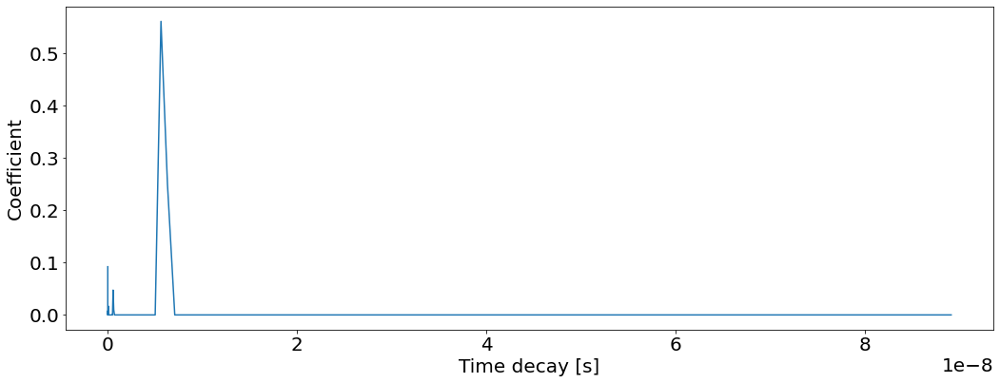

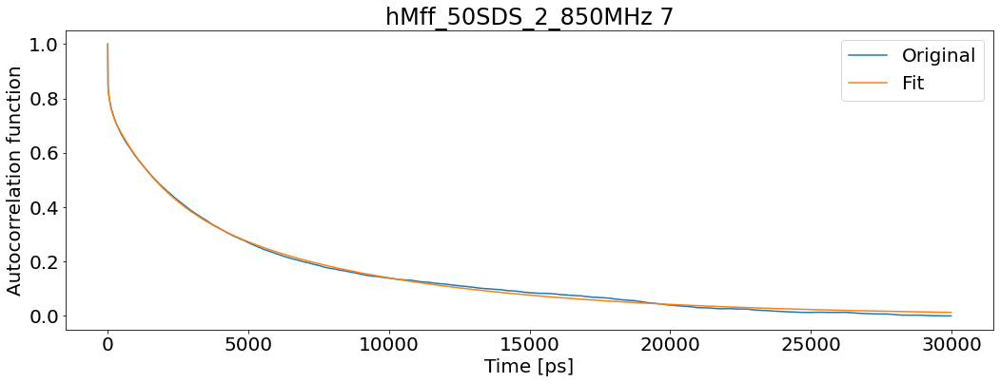

T1: 0.7583531673801241 T2: 0.11717111675014033 NOE: 0.653679590689235


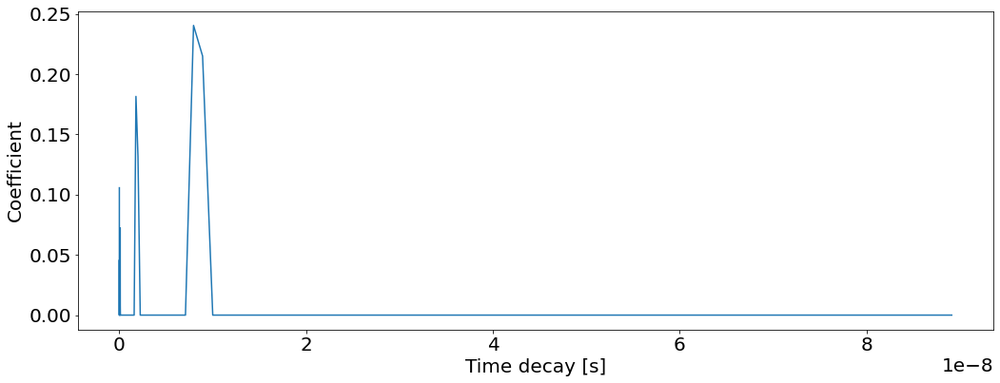

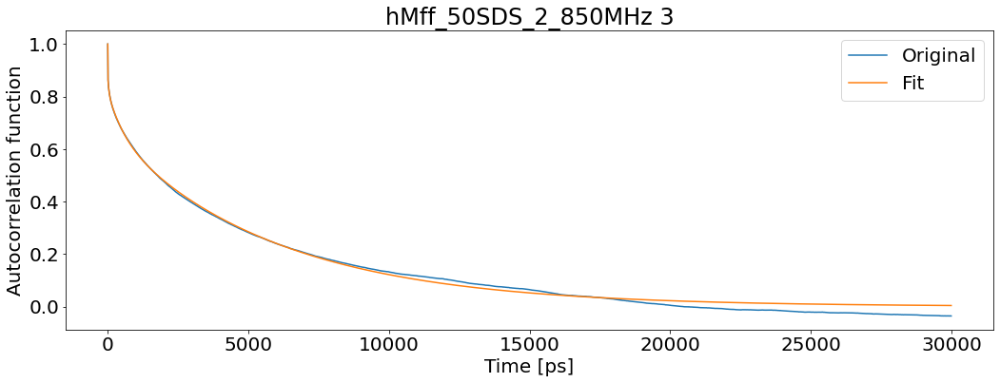

T1: 0.8222540462427146 T2: 0.12885925781871221 NOE: 0.579696637777056


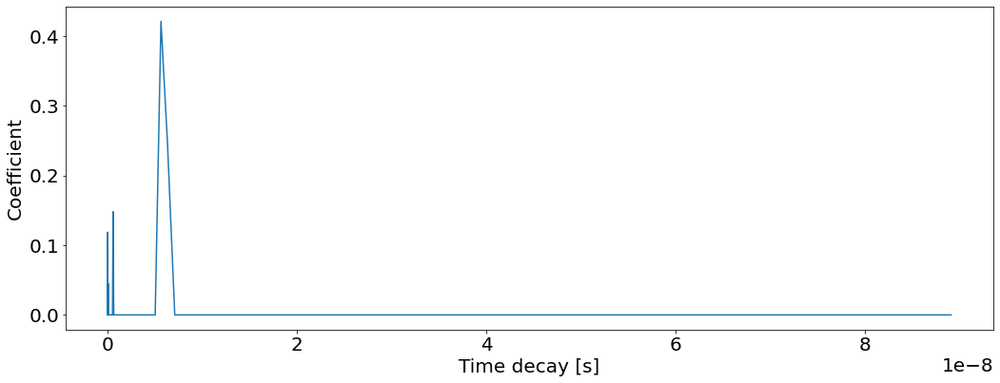

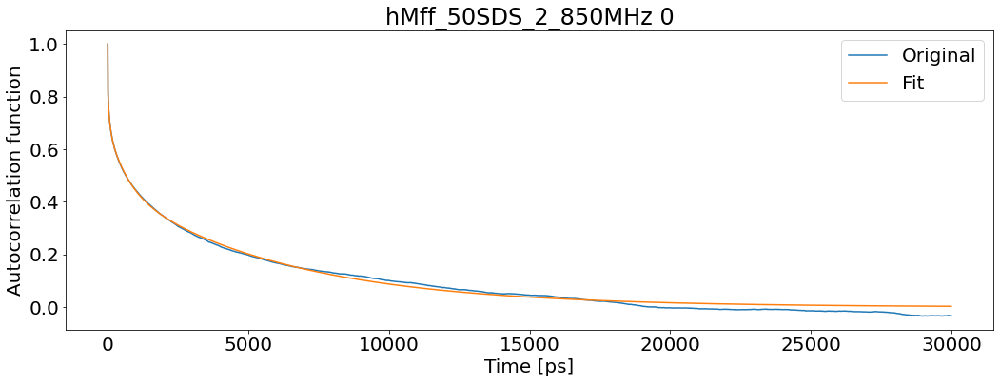

T1: 0.9047490955436848 T2: 0.17180480955664154 NOE: 0.35315896573731465


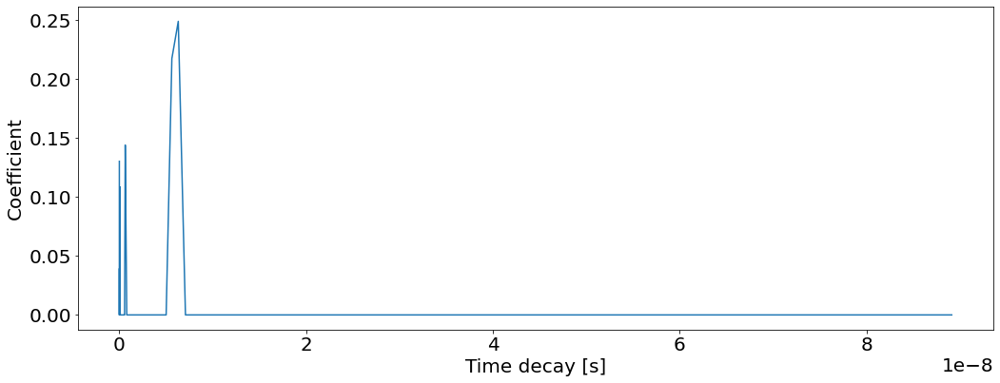

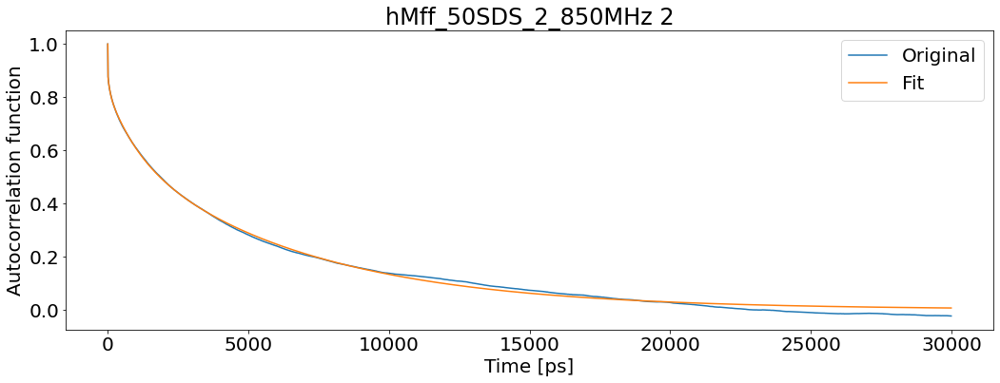

T1: 0.7692701878761476 T2: 0.12182341506805741 NOE: 0.6309036673227084


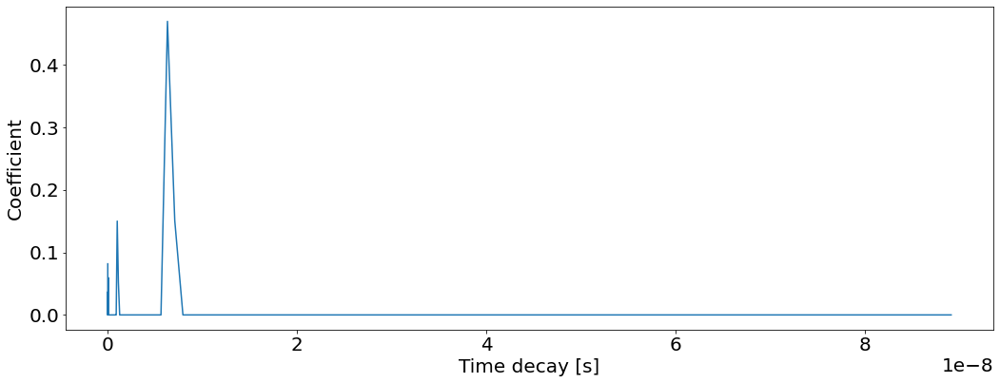

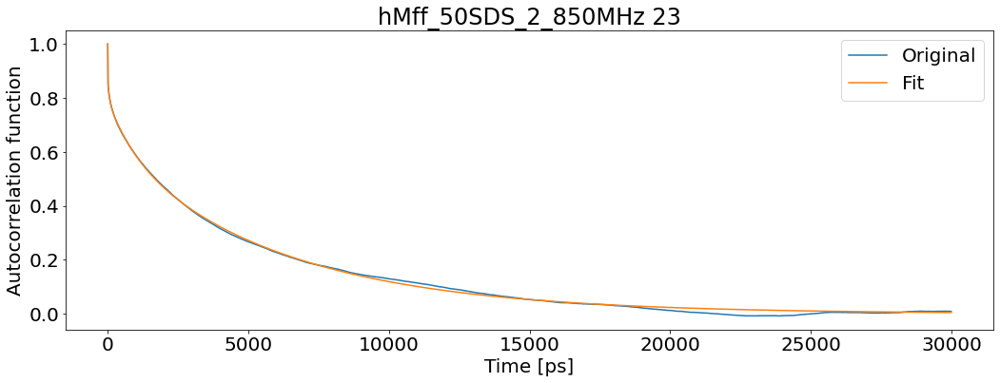

T1: 0.7851363420919666 T2: 0.1309296019821958 NOE: 0.6326889768689087


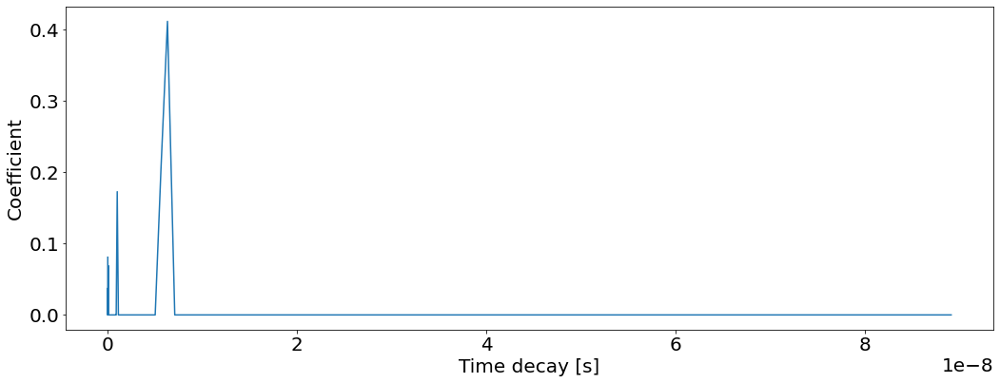

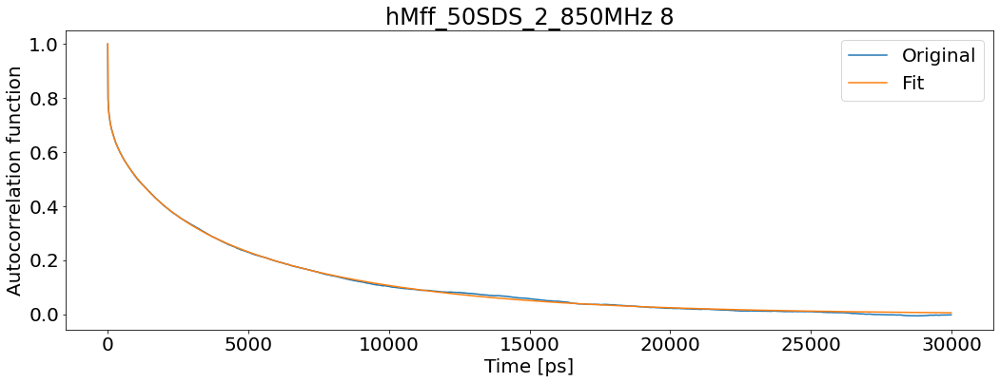

T1: 0.8388052477287563 T2: 0.14683213388752117 NOE: 0.537536163780945


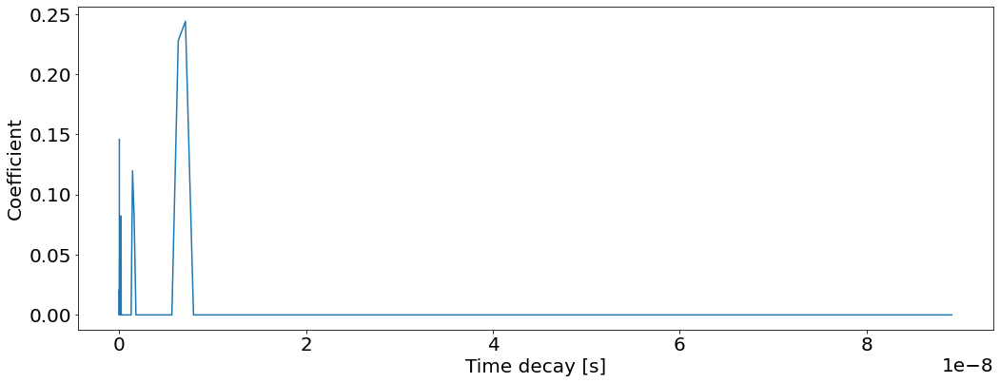

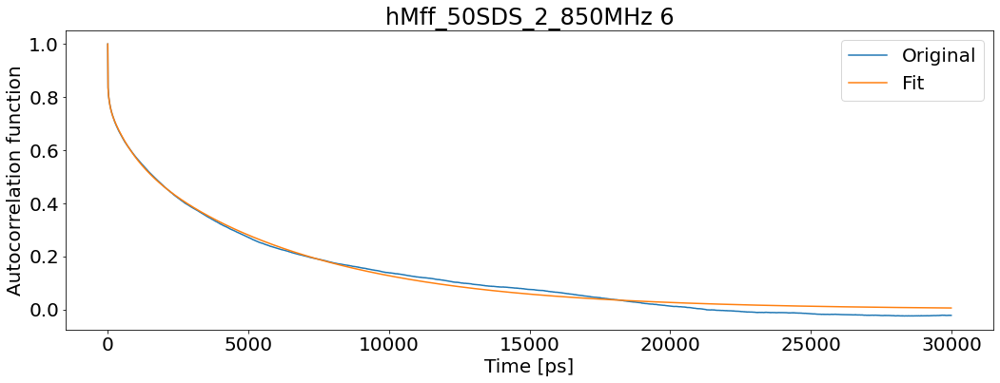

T1: 0.85714235969095 T2: 0.12864864624987293 NOE: 0.5998740556612414


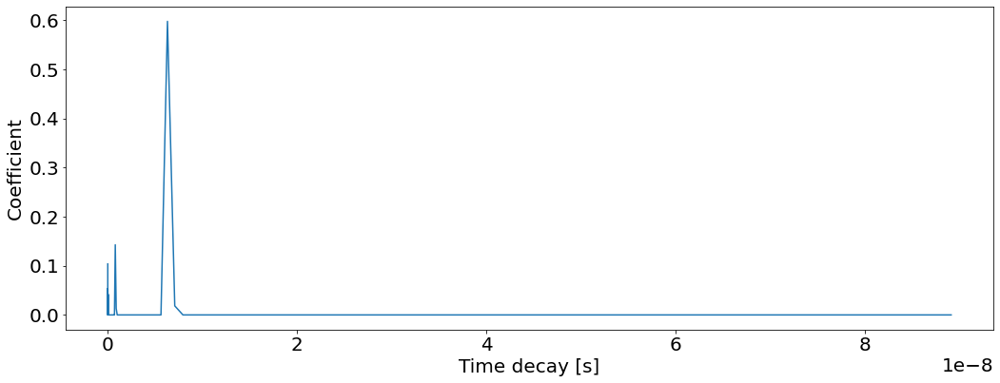

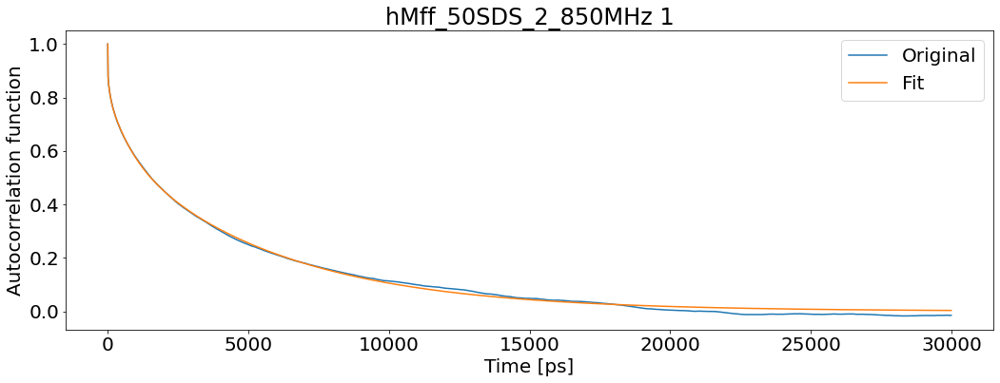

T1: 0.7491915854667219 T2: 0.13920940972349818 NOE: 0.5738614524680112


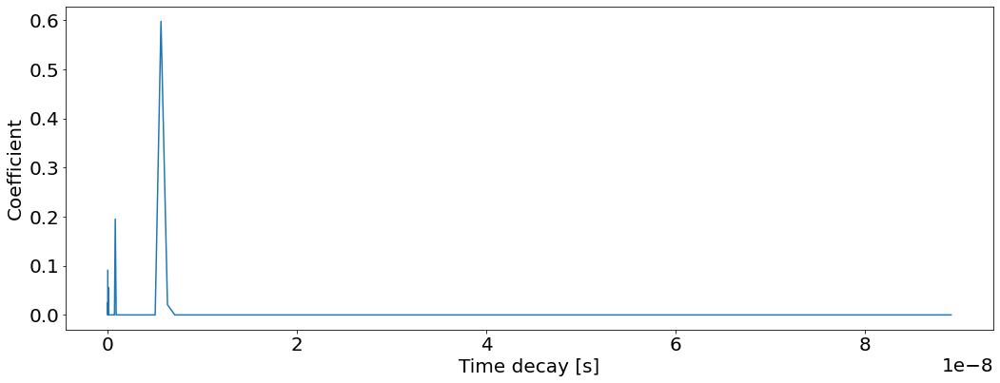

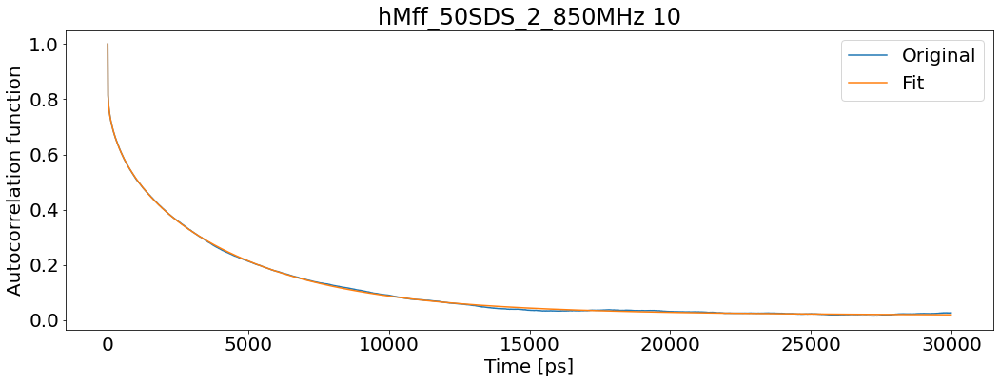

T1: 0.7717572932913069 T2: 0.10453546059475513 NOE: 0.5484041228652471


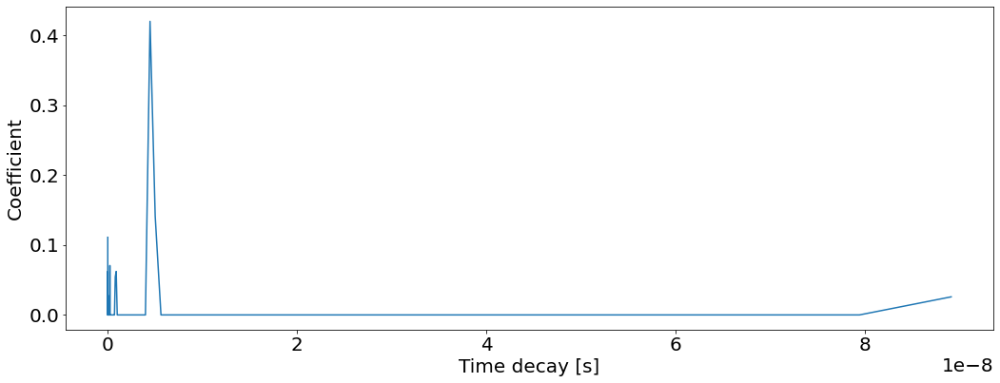

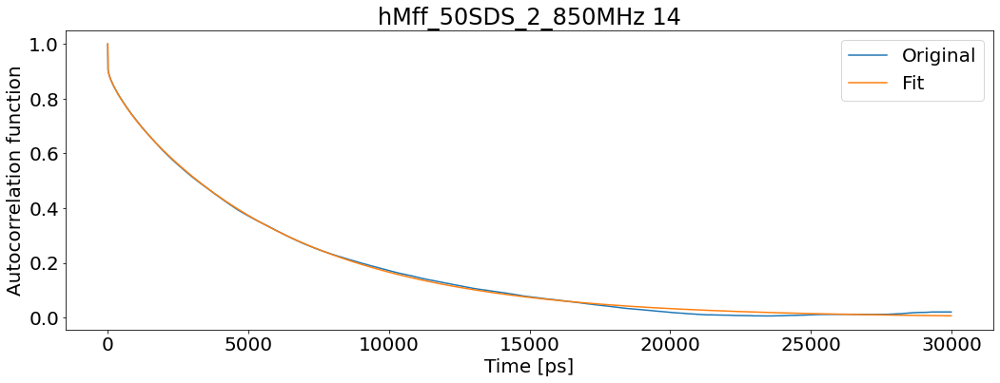

T1: 0.8043378021775364 T2: 0.10104819014418855 NOE: 0.7537327151799396


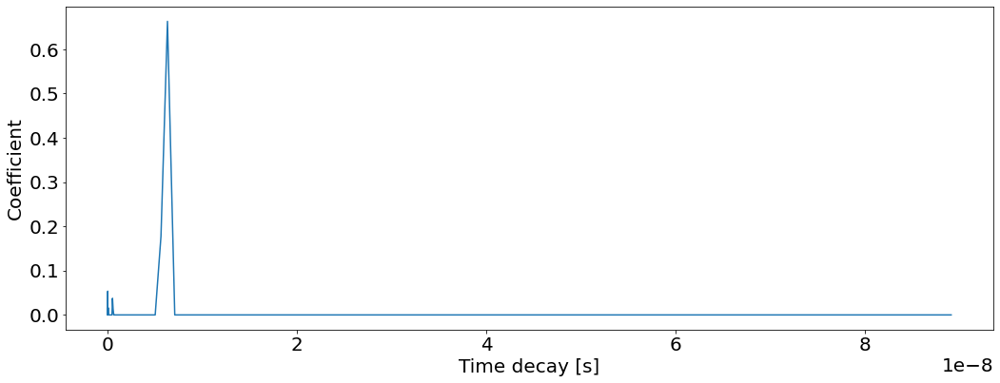

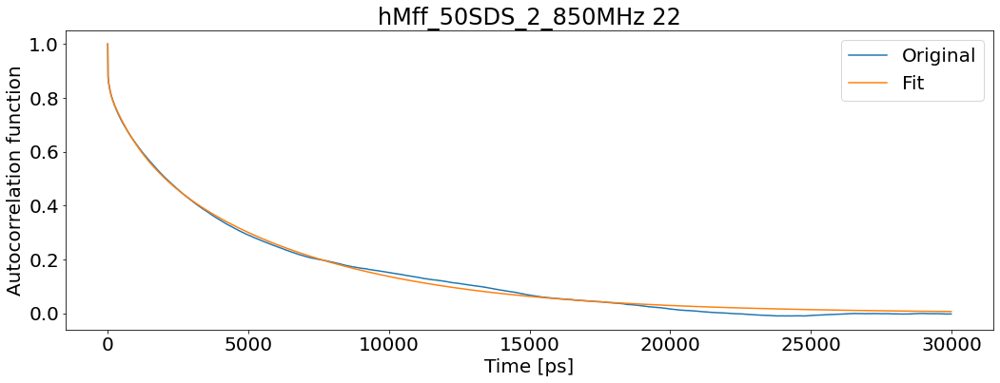

T1: 0.7670939047006612 T2: 0.11873931909937069 NOE: 0.6729324736952915


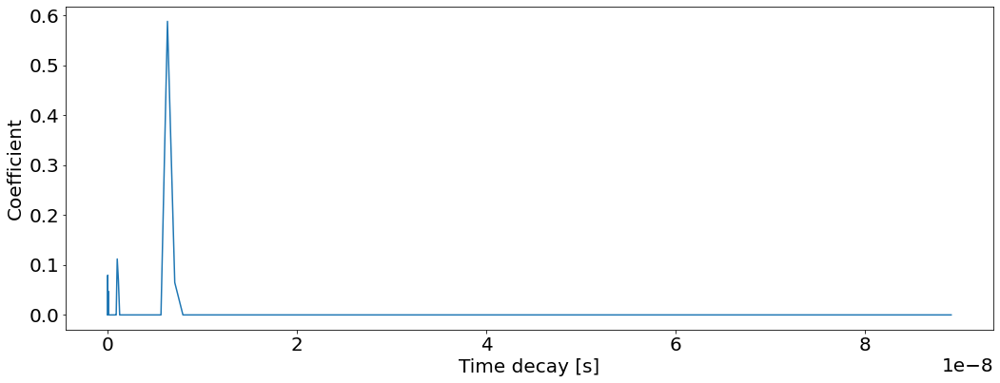

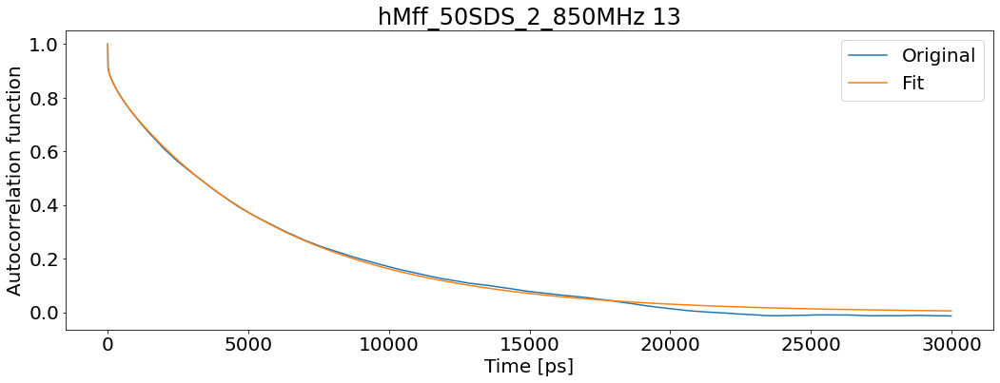

T1: 0.7917901672163273 T2: 0.10163617782186435 NOE: 0.7410537021129754


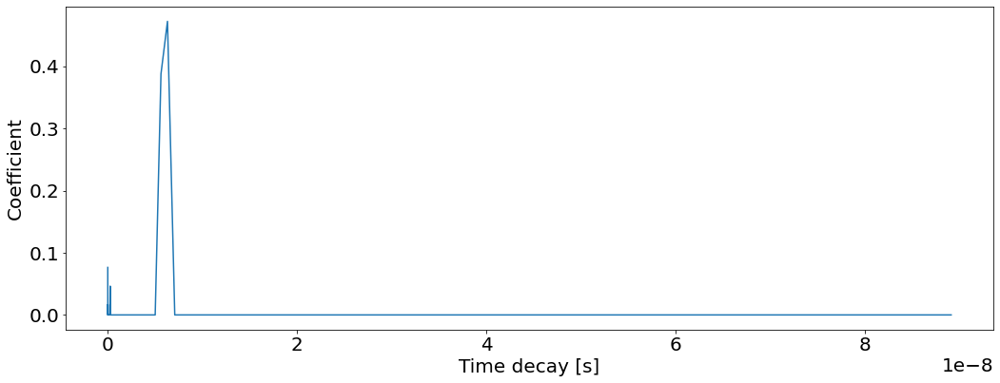

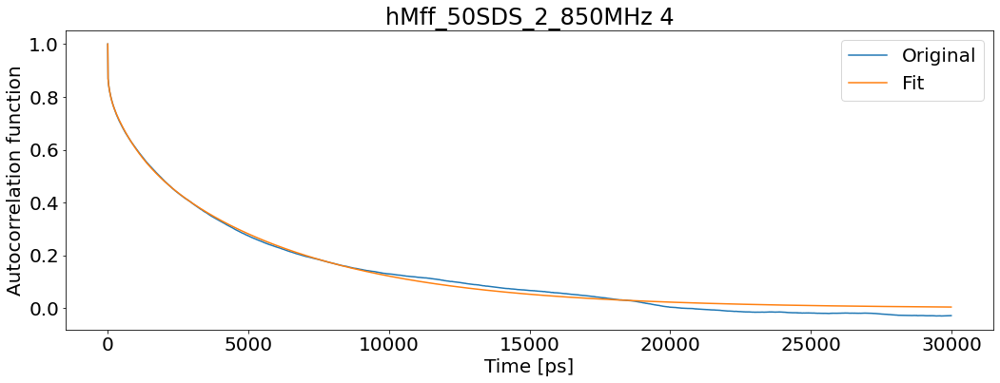

T1: 0.7718588418768232 T2: 0.12767269996482286 NOE: 0.6303476754960579


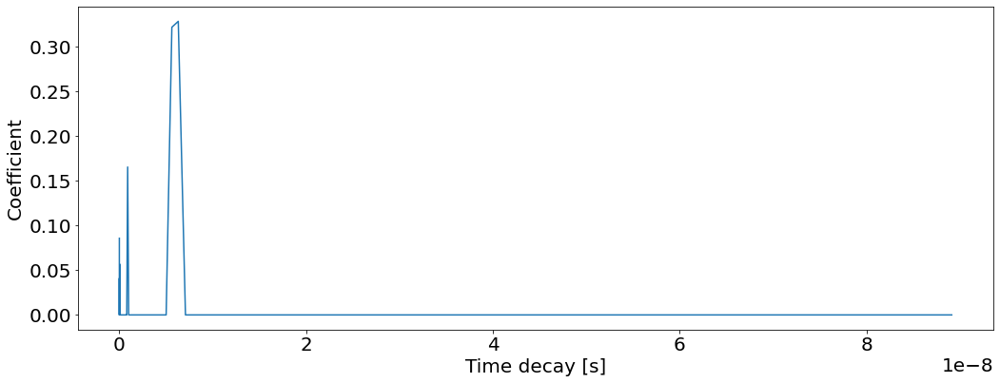

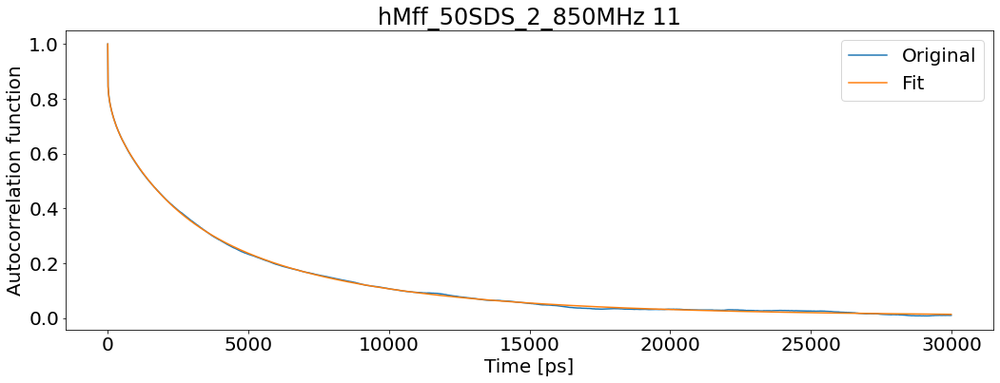

T1: 0.7089853705223975 T2: 0.12563989170828277 NOE: 0.6247920570715138


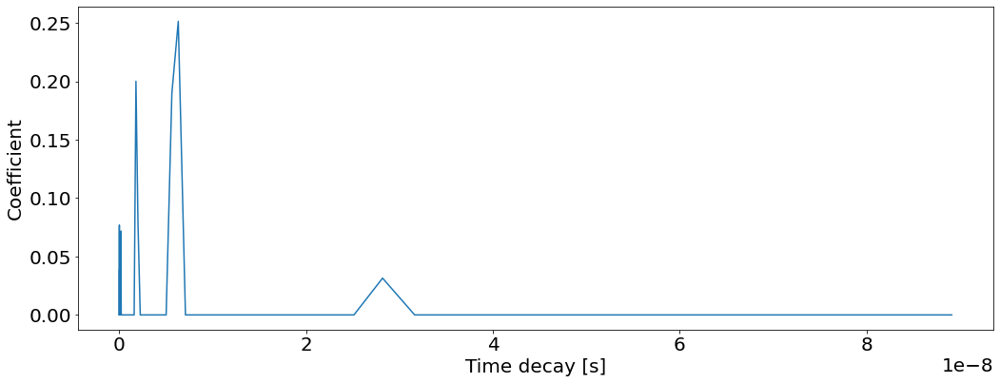

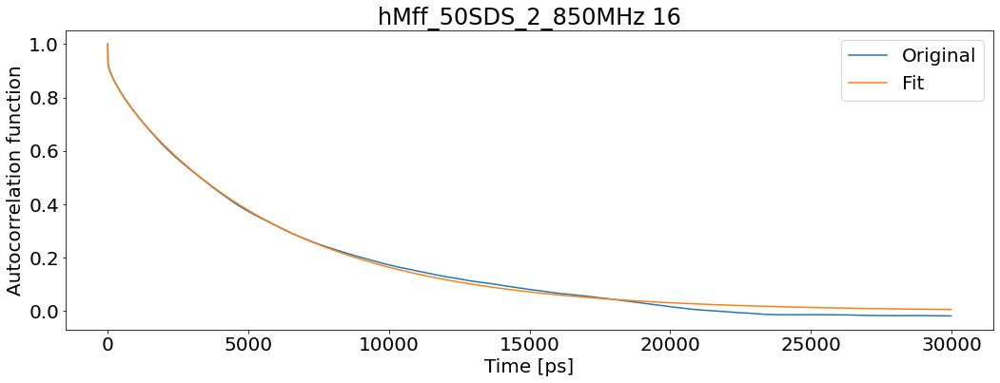

T1: 0.7763830196051941 T2: 0.10026767079177268 NOE: 0.7531610263828463


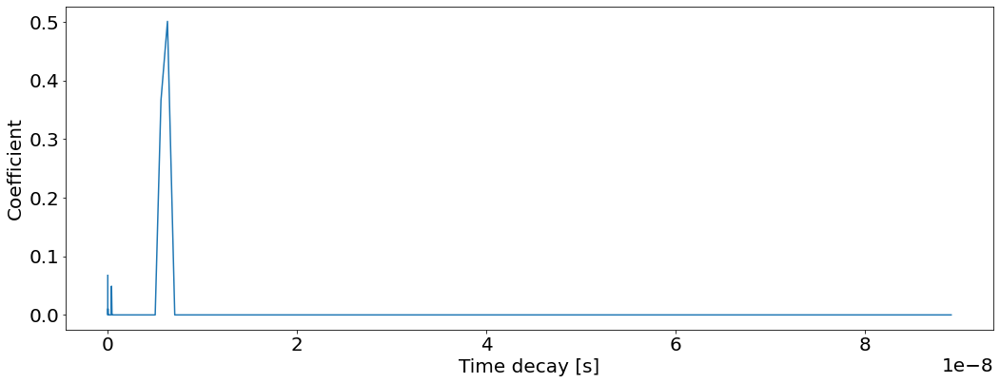

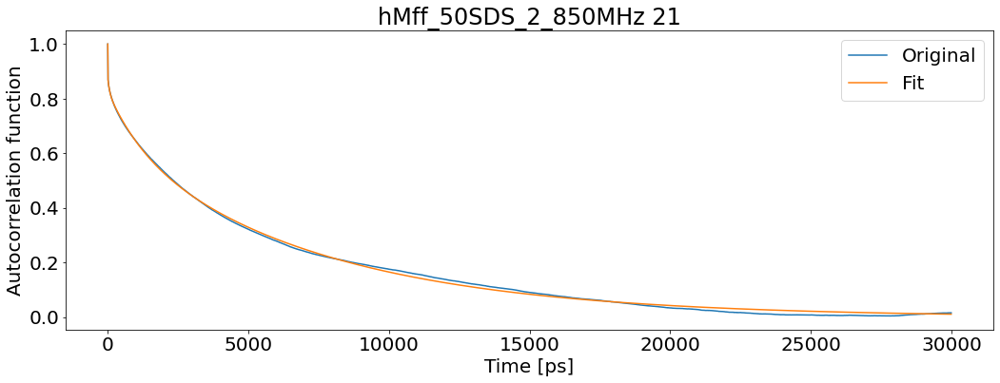

T1: 0.8175963942050637 T2: 0.105704222844858 NOE: 0.6909960166087681


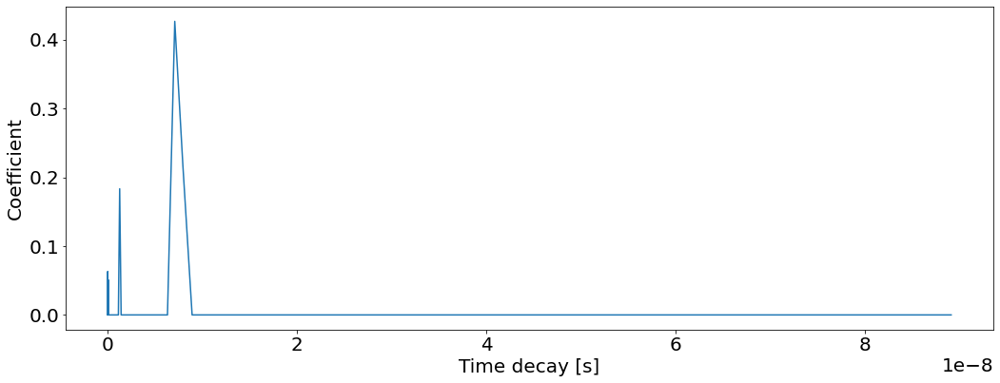

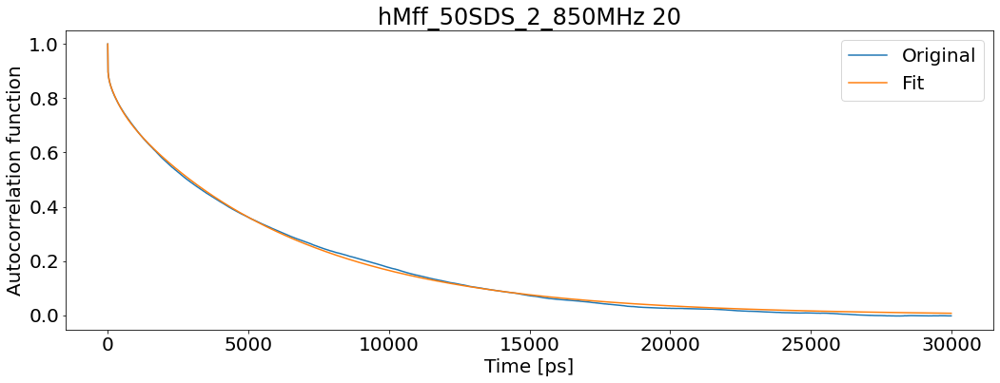

T1: 0.8466024703456863 T2: 0.10369852329781001 NOE: 0.6697023903140576


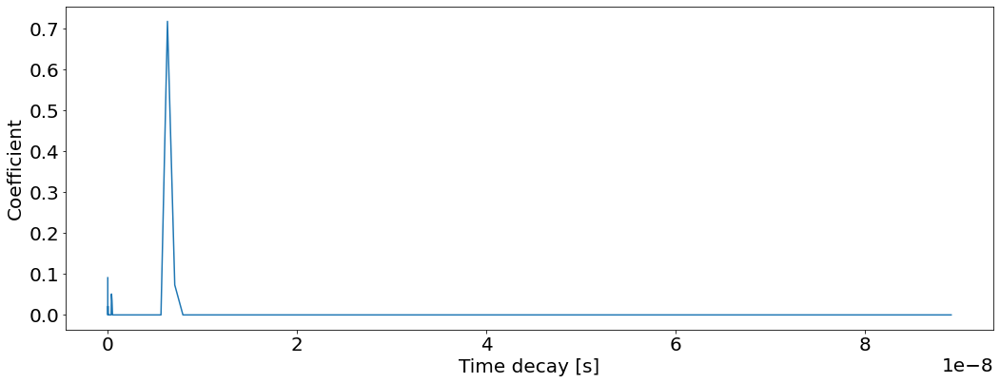

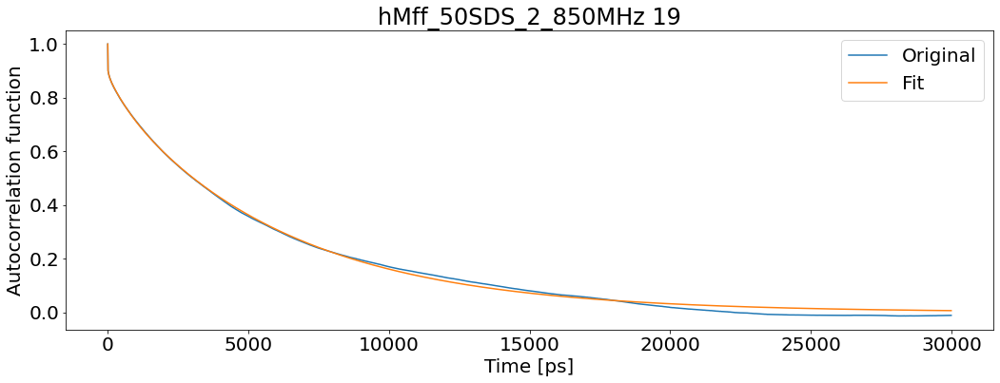

T1: 0.7941972694913647 T2: 0.10333332553218762 NOE: 0.7556611295455995


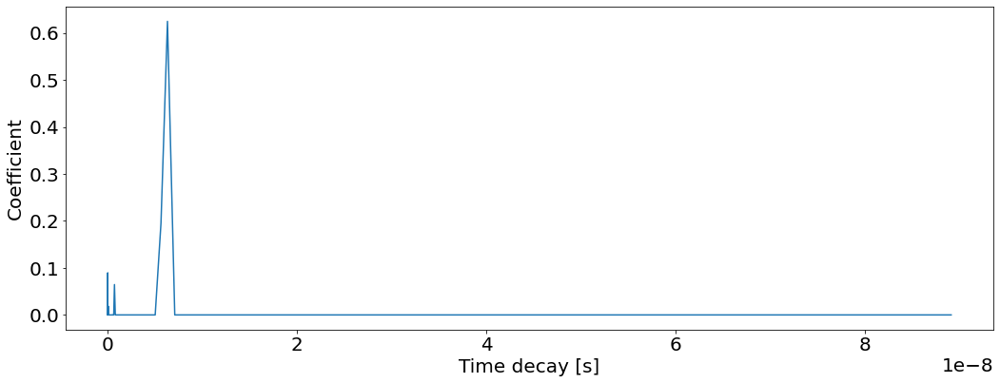

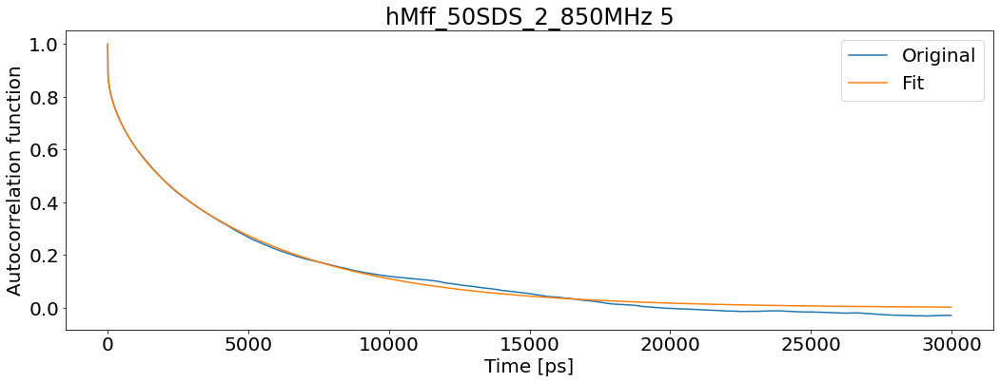

T1: 0.7457916761627369 T2: 0.13237266085193727 NOE: 0.6216187049894022


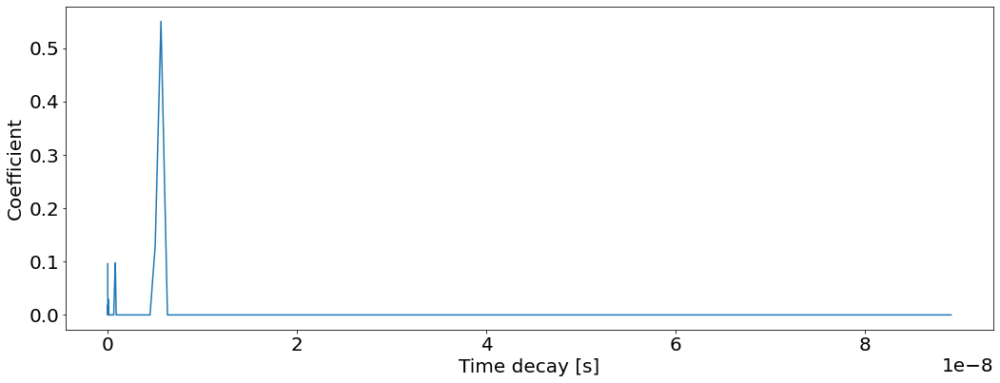

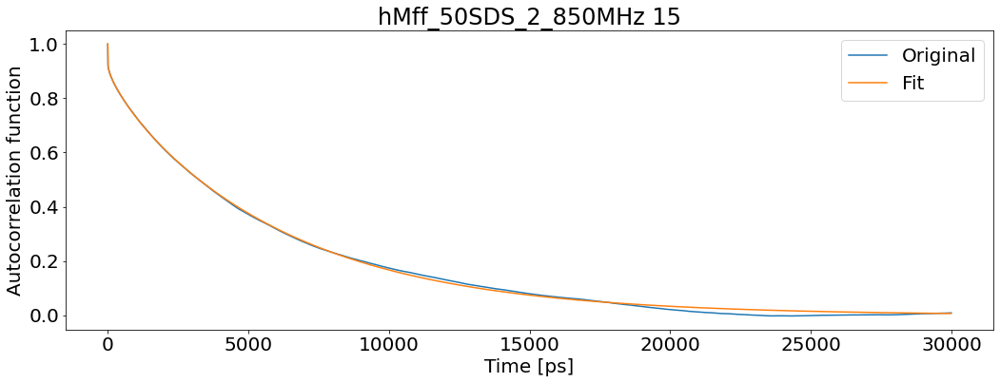

T1: 0.787402041559923 T2: 0.10015157781585249 NOE: 0.7563812502563227


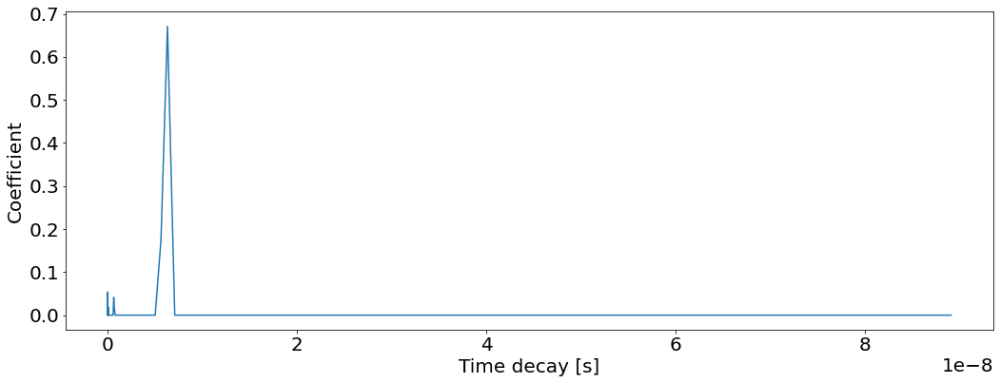

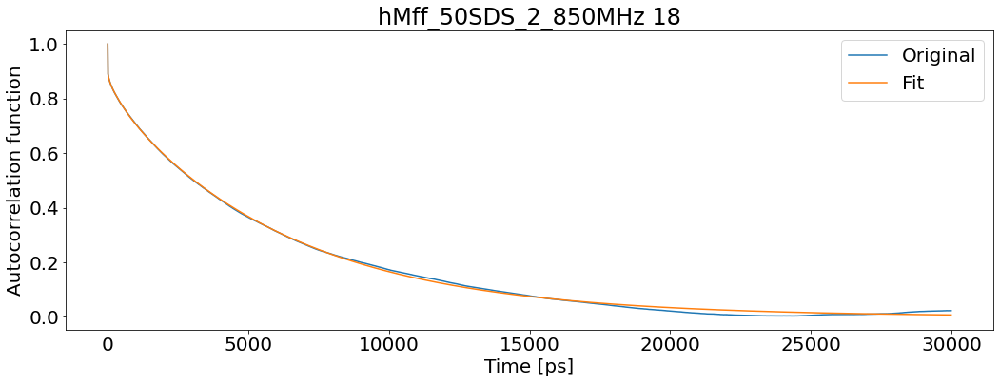

T1: 0.8280462301237543 T2: 0.1024306050291777 NOE: 0.7423747147357758


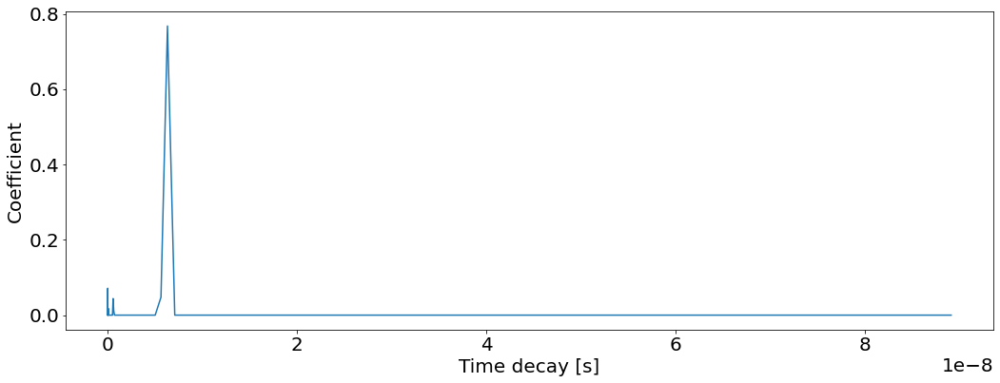

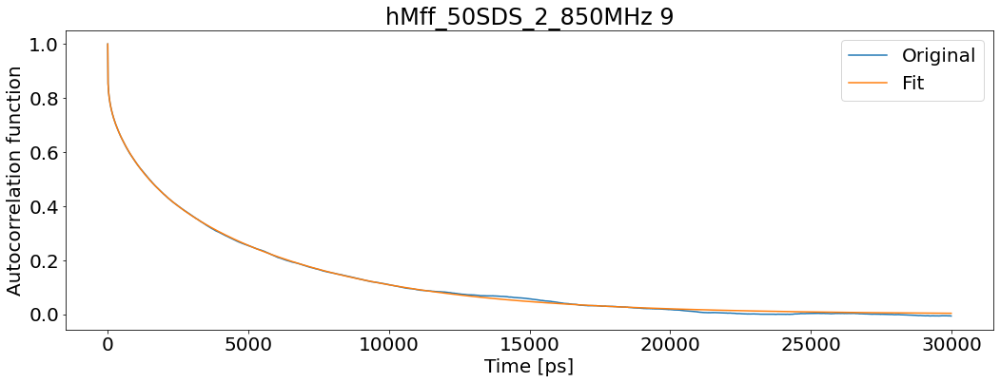

T1: 0.781813232370042 T2: 0.1387378576621659 NOE: 0.5735722808952343


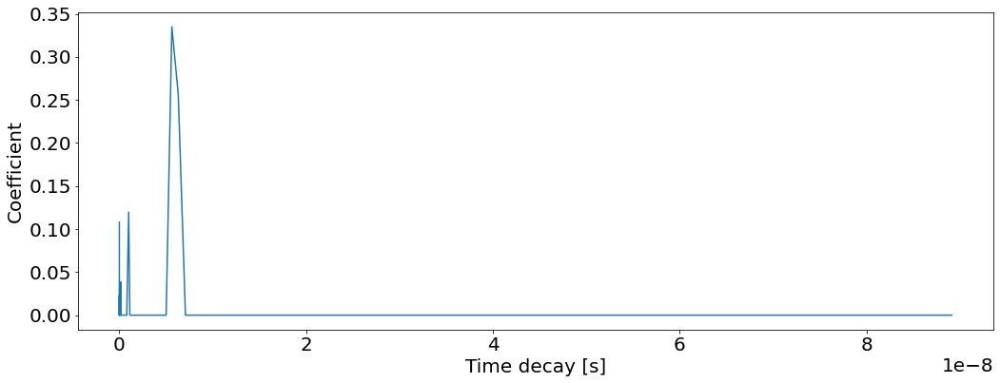

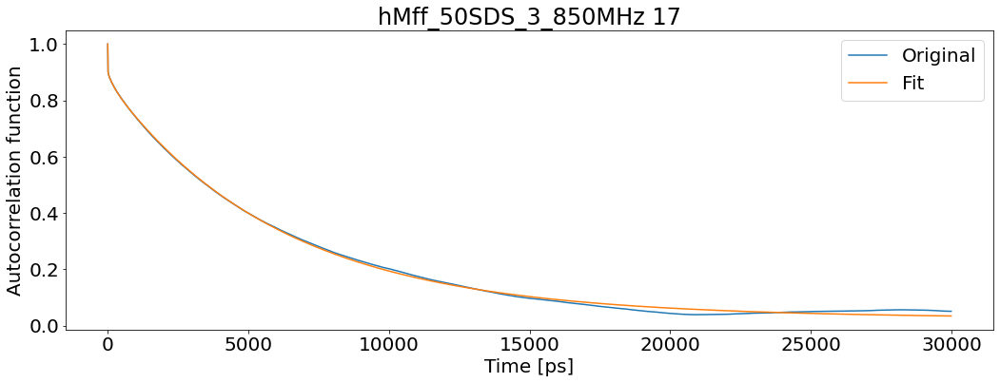

T1: 0.8389160908428267 T2: 0.06300808397613732 NOE: 0.7727777530195201


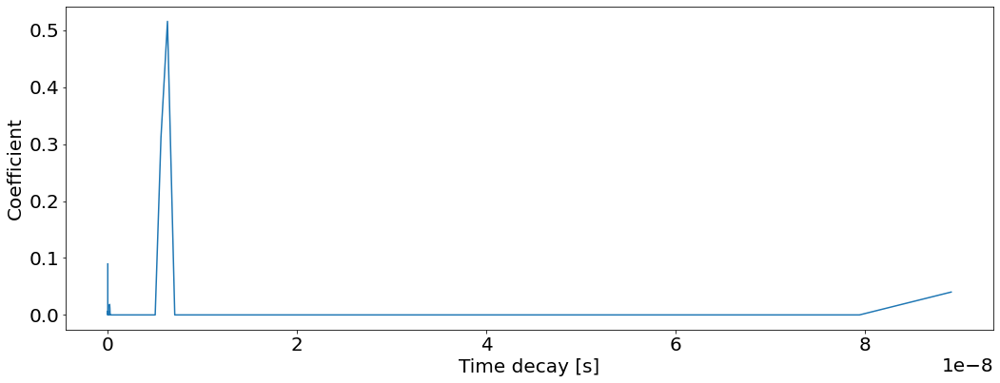

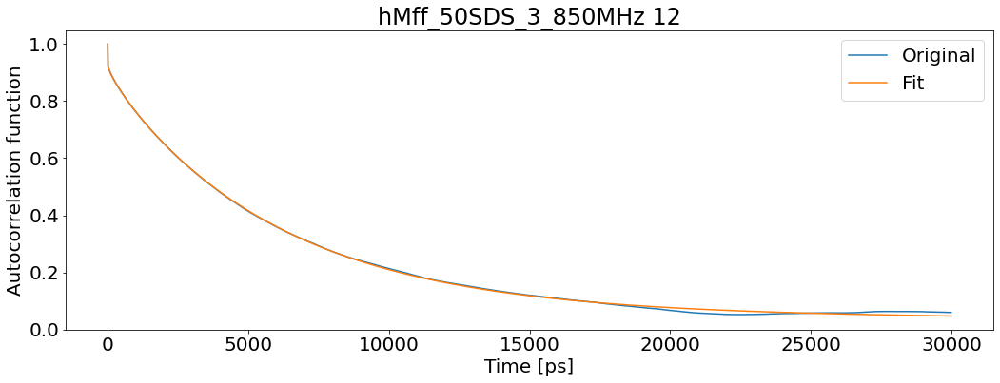

T1: 0.8236203310125247 T2: 0.05342814379687819 NOE: 0.7892699831999835


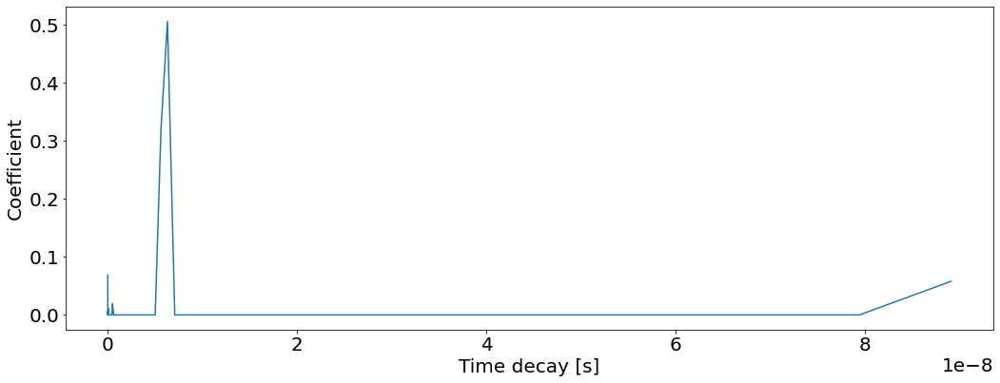

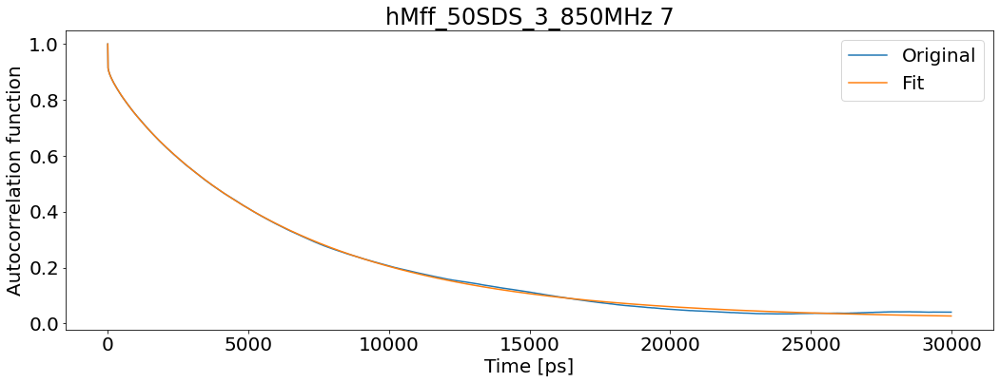

T1: 0.8556046490212518 T2: 0.06970141033312041 NOE: 0.7679651738988572


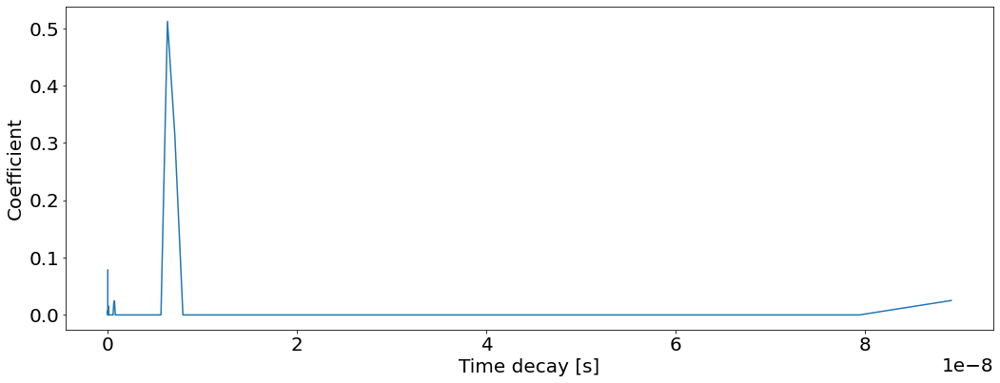

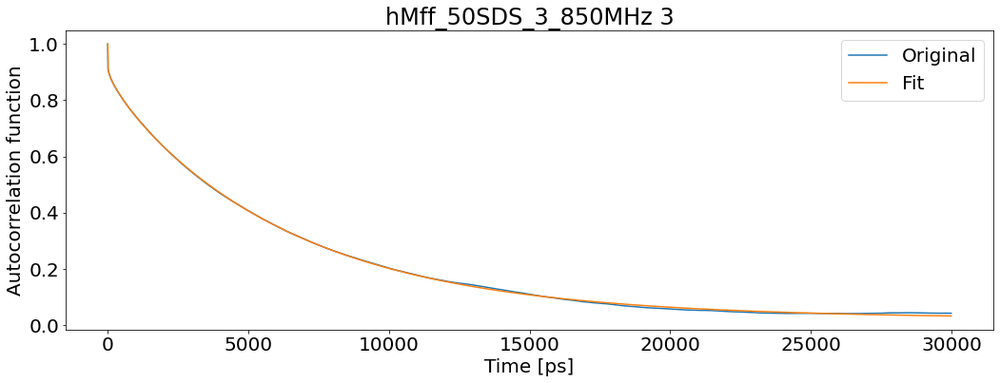

T1: 0.849641255108318 T2: 0.06518744687590884 NOE: 0.7637452406877947


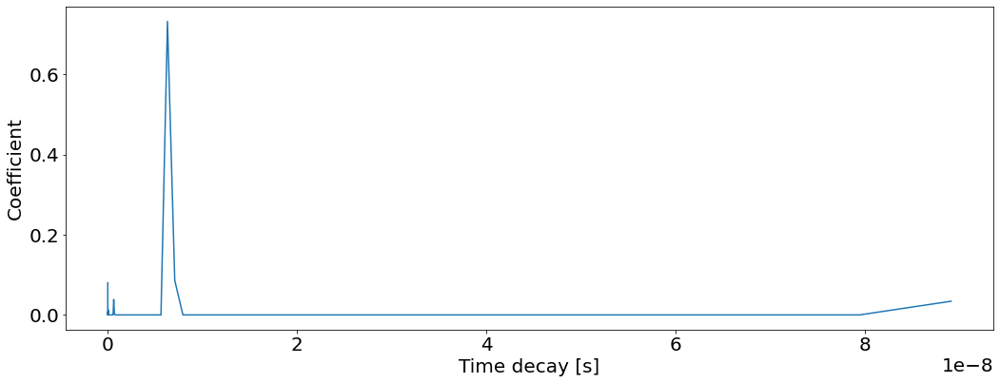

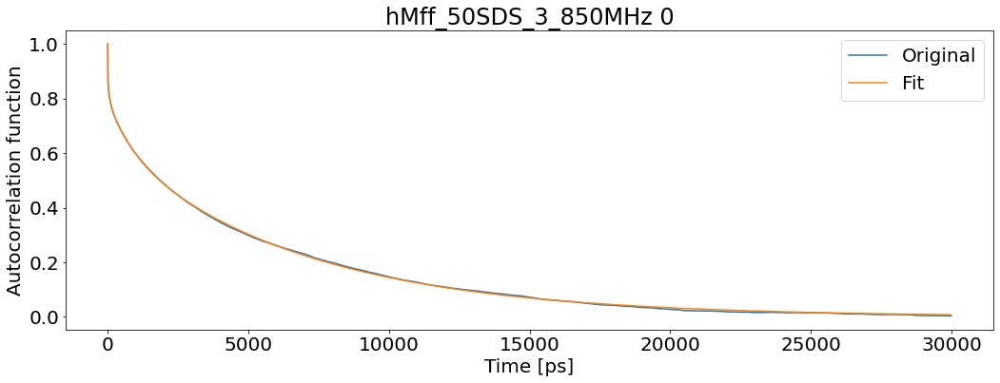

T1: 0.8547434483804246 T2: 0.11803273867063066 NOE: 0.5998953568682845


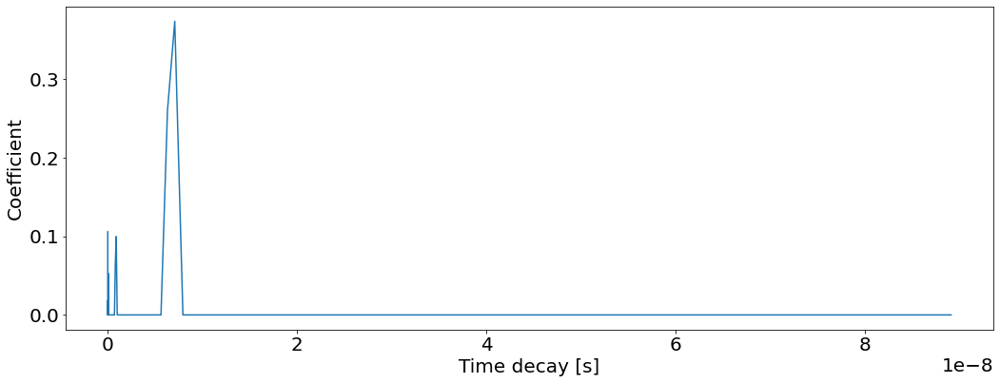

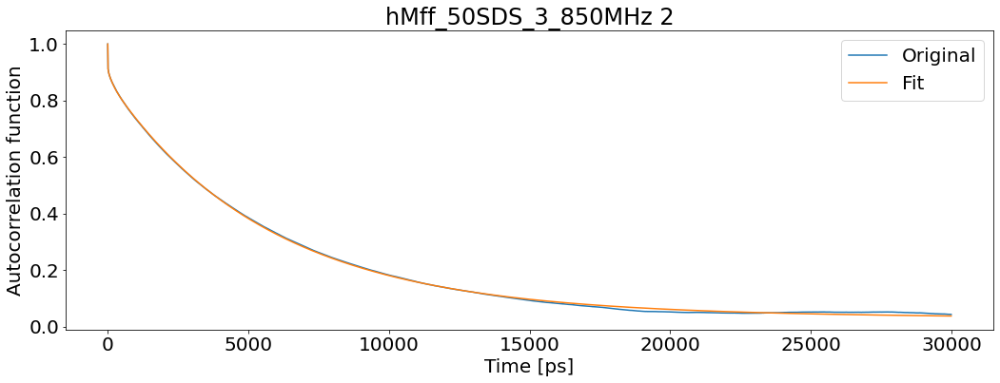

T1: 0.7911578352776498 T2: 0.06150369070101325 NOE: 0.7626963355324133


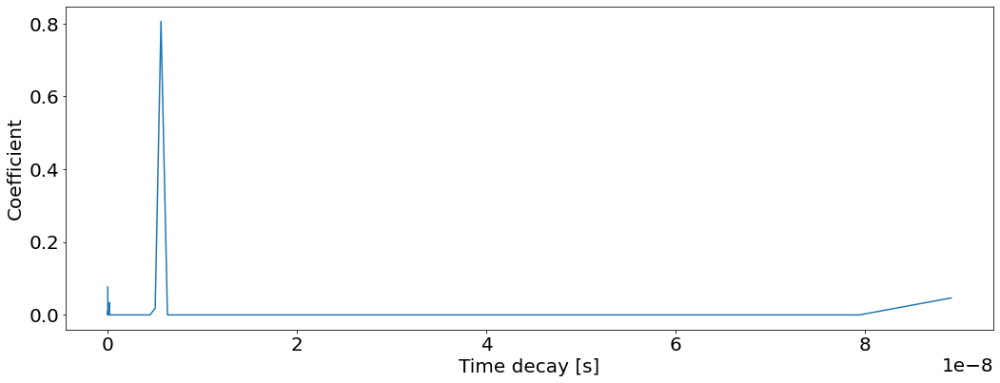

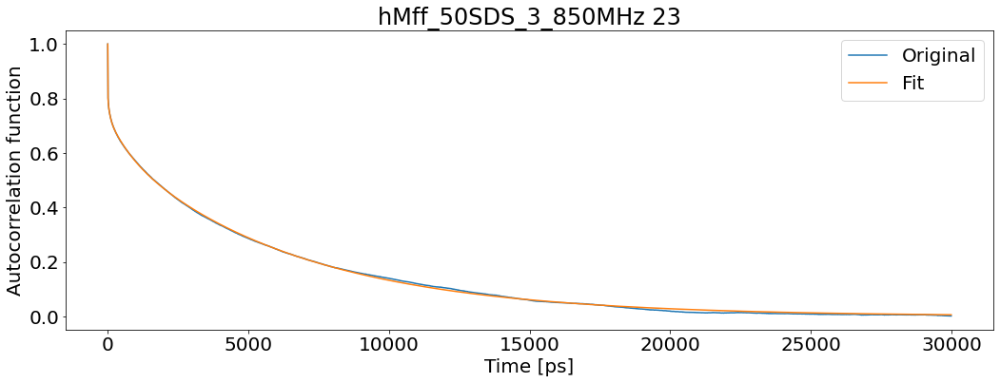

T1: 0.9303401895689694 T2: 0.12675512828860316 NOE: 0.6132197264969406


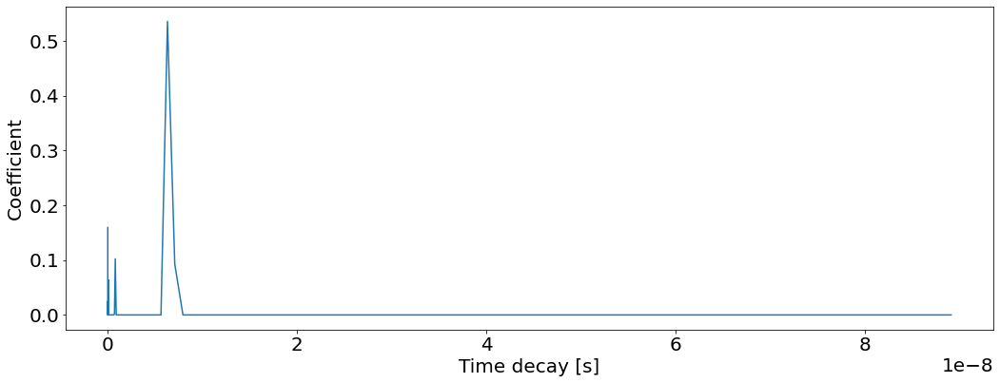

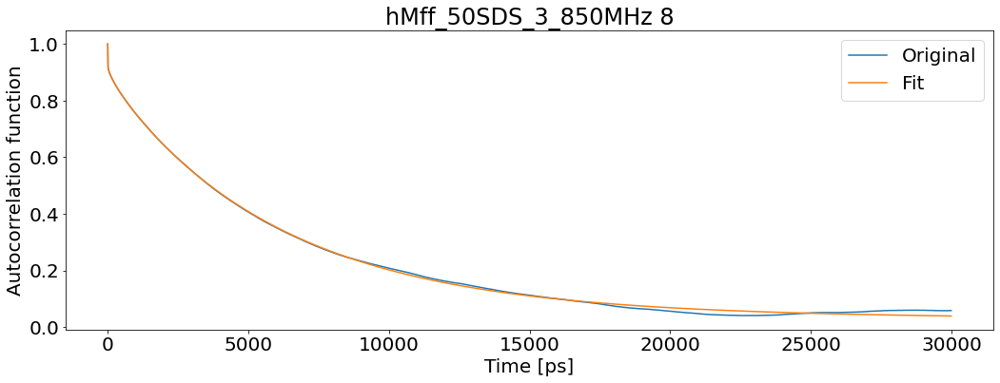

T1: 0.8248801191489075 T2: 0.05924127649348742 NOE: 0.7801358673585285


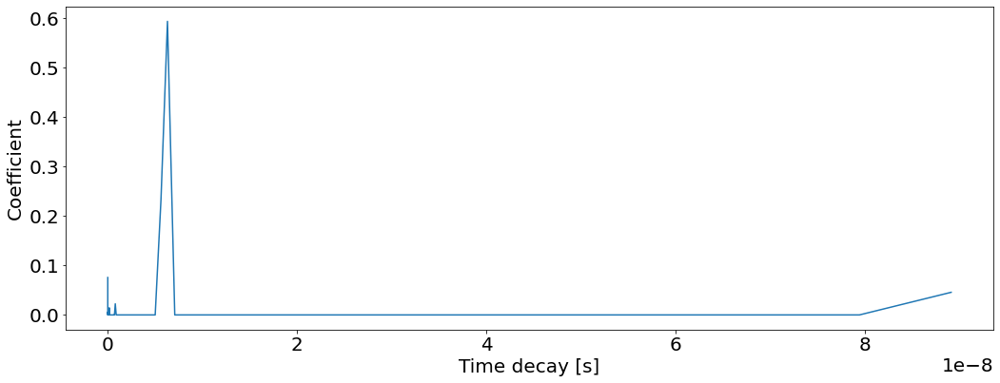

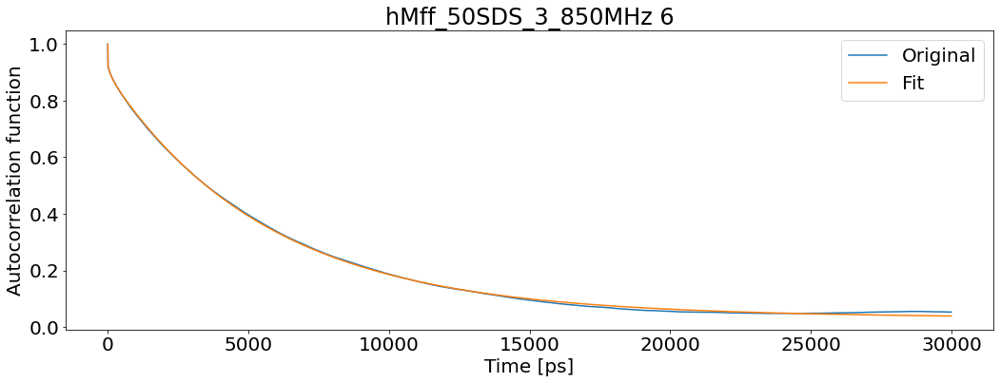

T1: 0.7784078430884865 T2: 0.059188982064053784 NOE: 0.7870180165275291


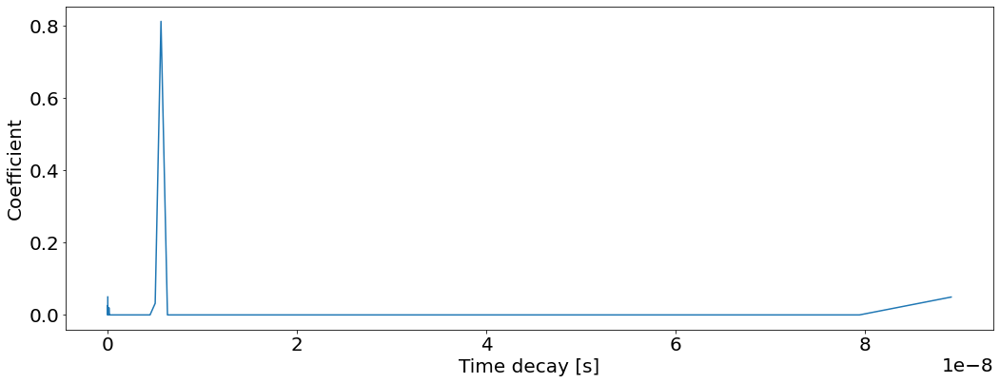

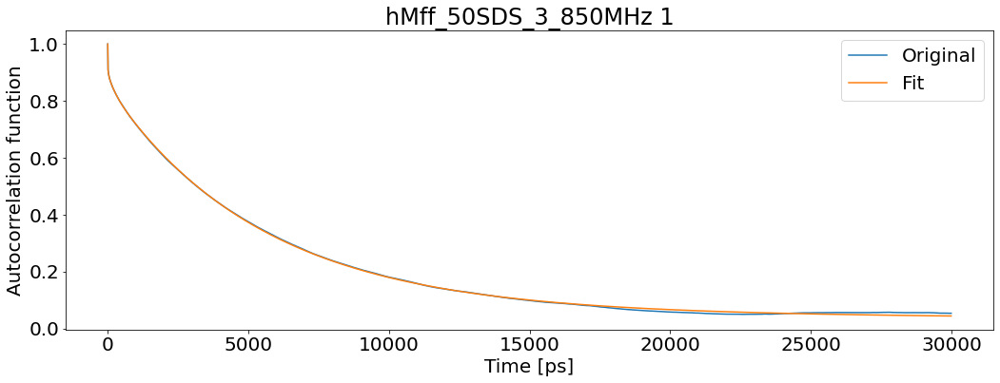

T1: 0.794722433578294 T2: 0.05758098112764621 NOE: 0.7307853654386312


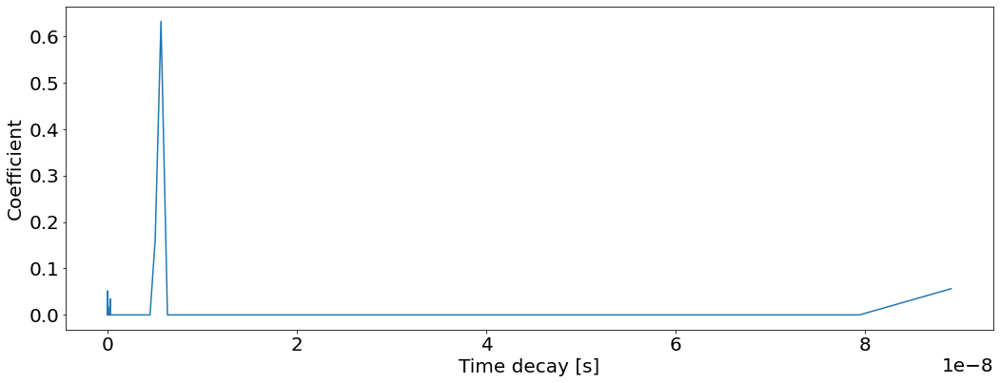

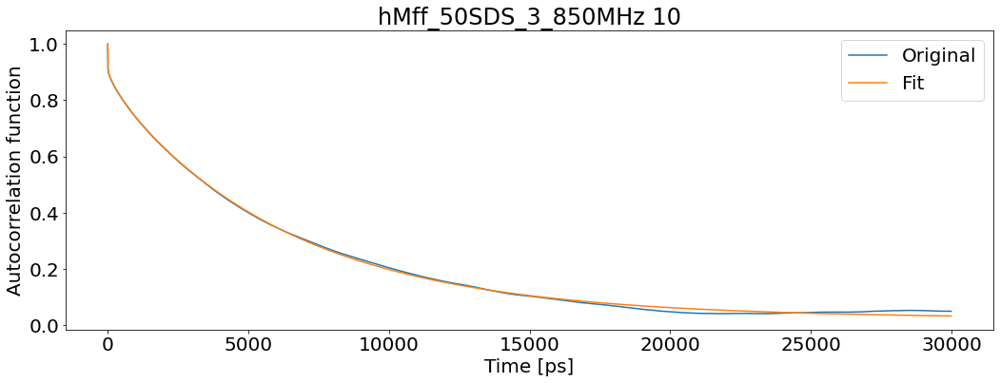

T1: 0.8470570999644002 T2: 0.06436558850192205 NOE: 0.7588528046078904


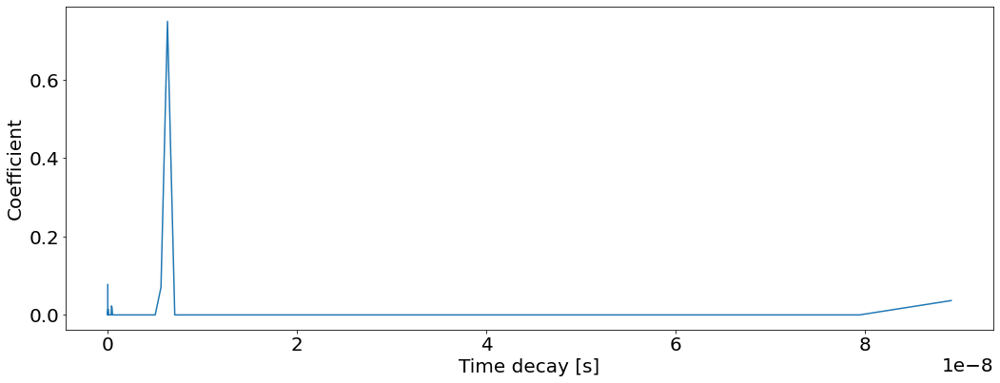

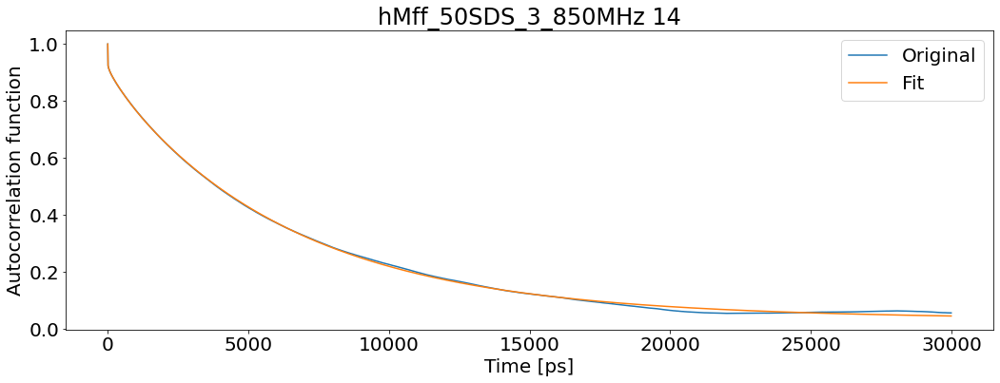

T1: 0.8514923178724084 T2: 0.05445642285666905 NOE: 0.7893534426718587


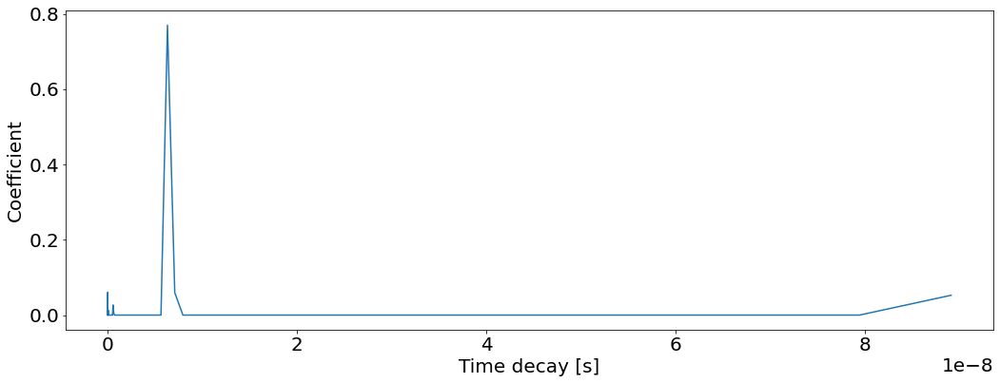

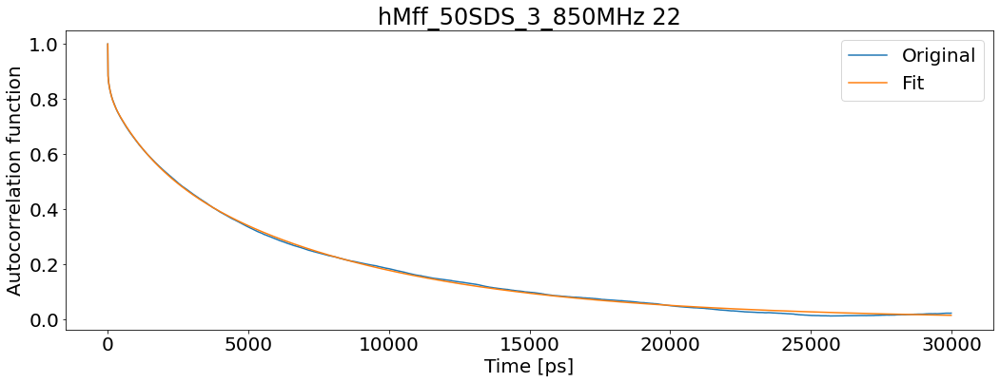

T1: 0.8217279427943102 T2: 0.10026218501490657 NOE: 0.6599508300508271


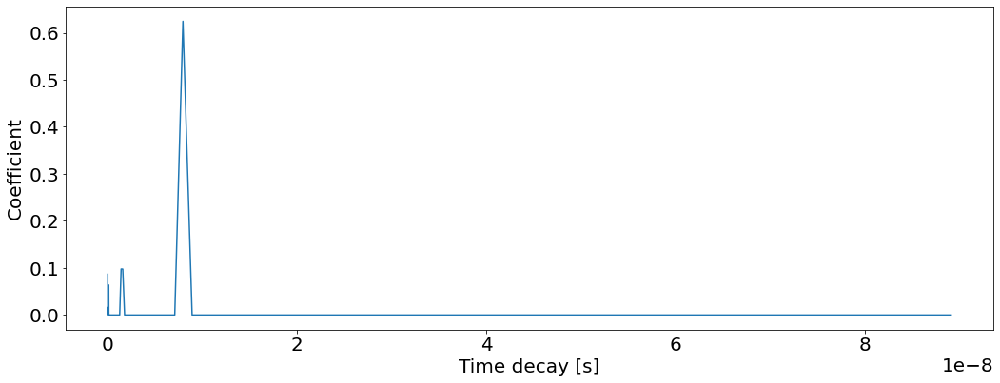

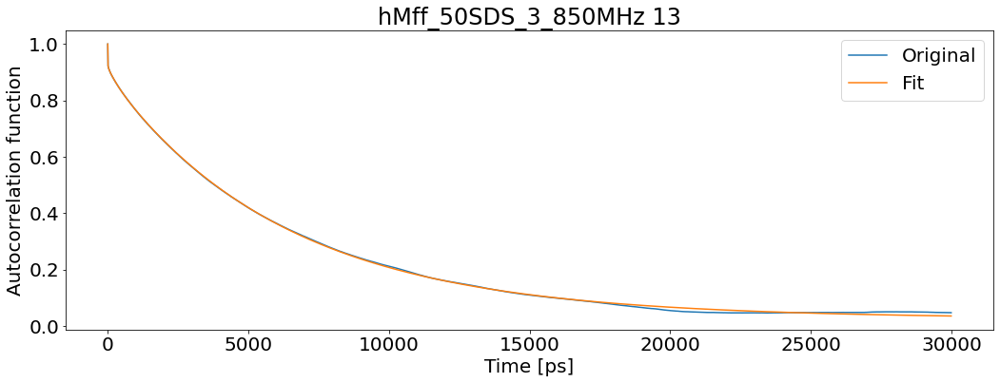

T1: 0.8370141589381929 T2: 0.06132699801447833 NOE: 0.7850342896795737


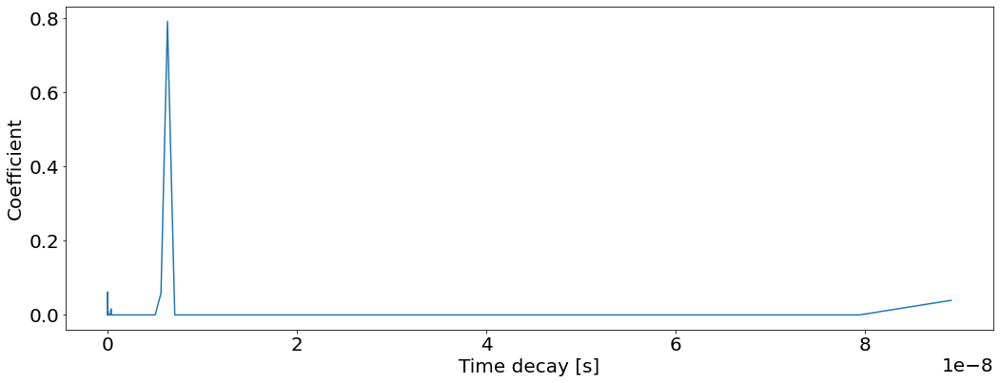

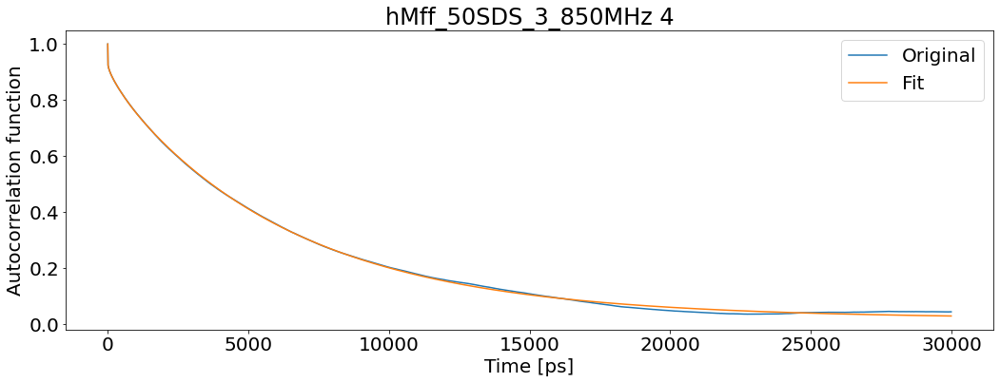

T1: 0.8315652726670865 T2: 0.06737874522521886 NOE: 0.7691956704651179


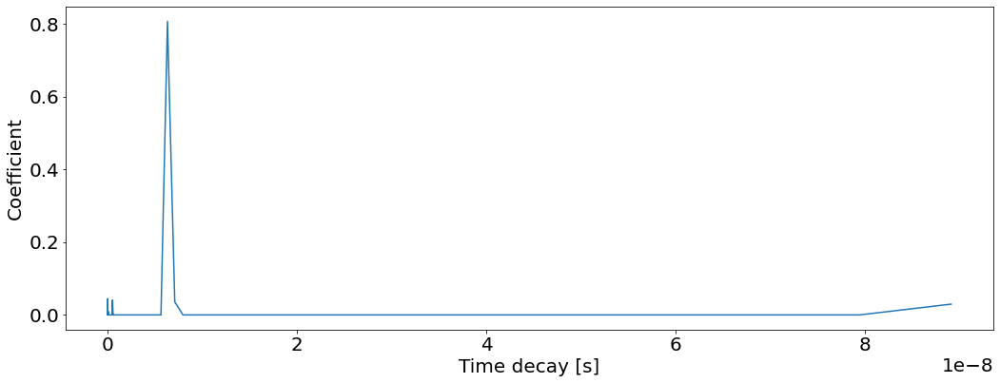

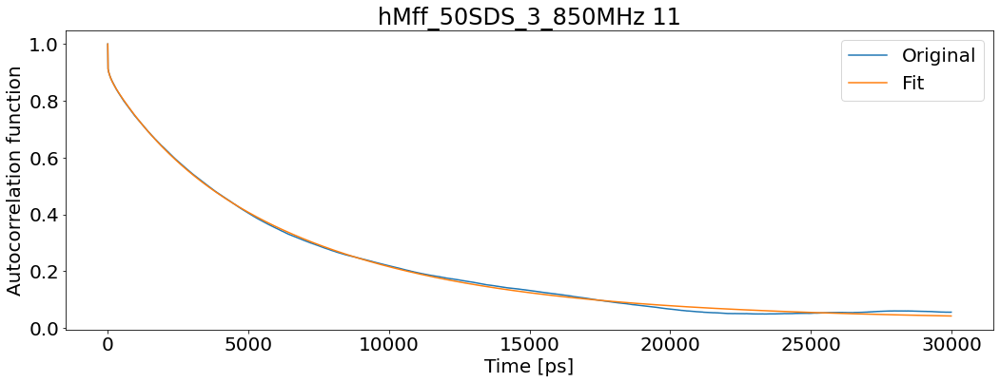

T1: 0.8244051645646319 T2: 0.05785348425632961 NOE: 0.7808032122782933


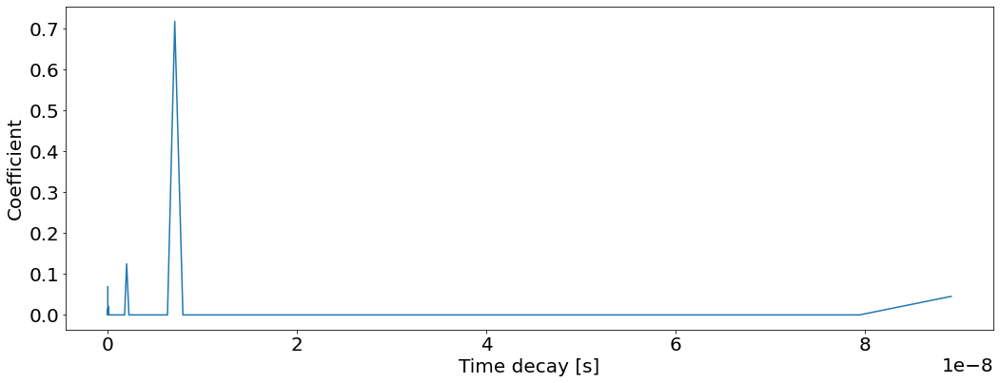

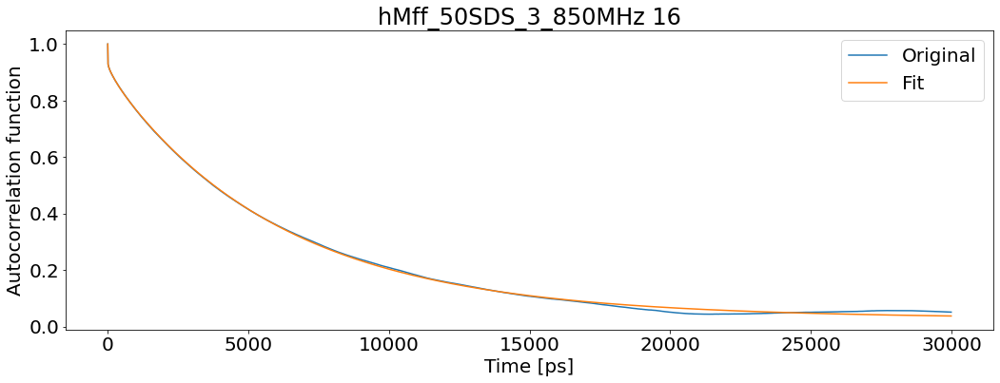

T1: 0.8152799636897554 T2: 0.05929650748761126 NOE: 0.7866433422021009


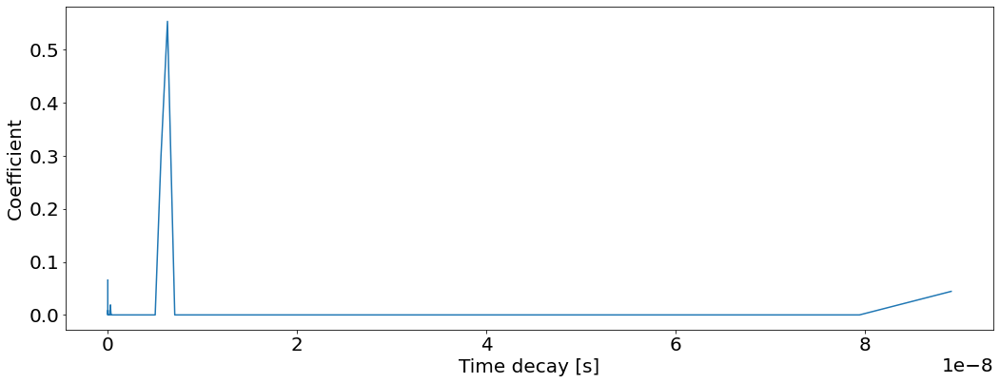

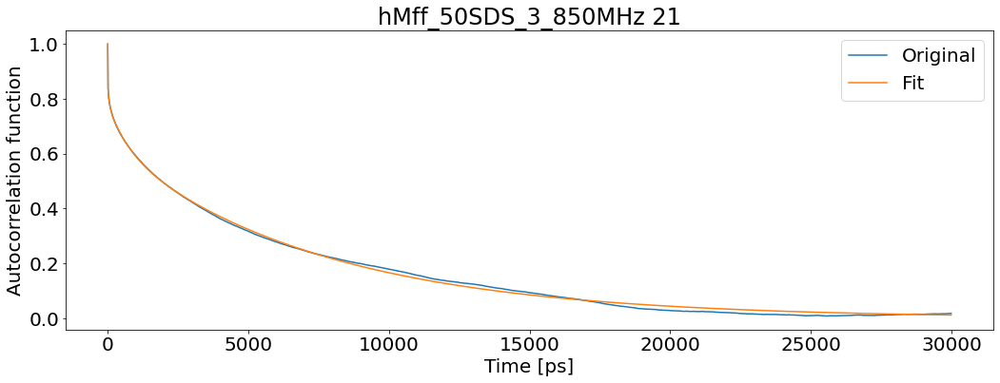

T1: 0.9628419036647926 T2: 0.1093421012651339 NOE: 0.5676888519355868


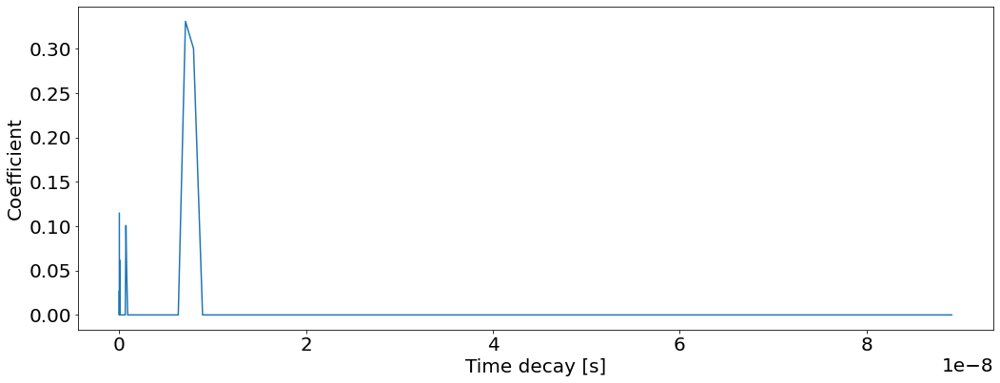

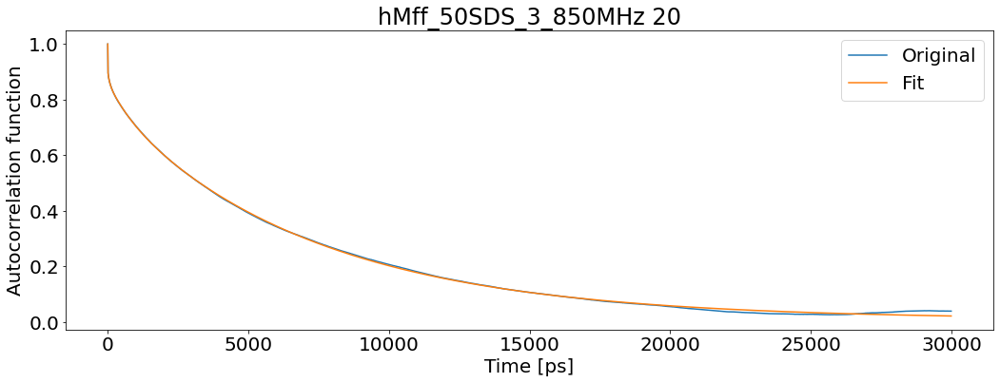

T1: 0.9031596043184409 T2: 0.07914449584085272 NOE: 0.7085729046455213


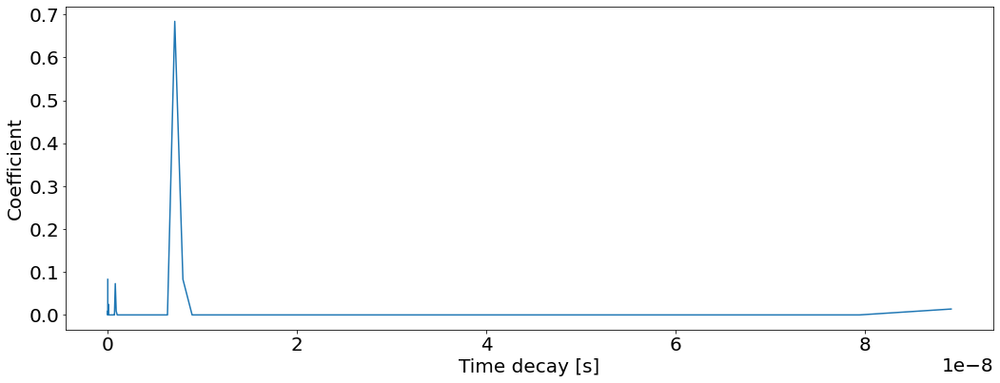

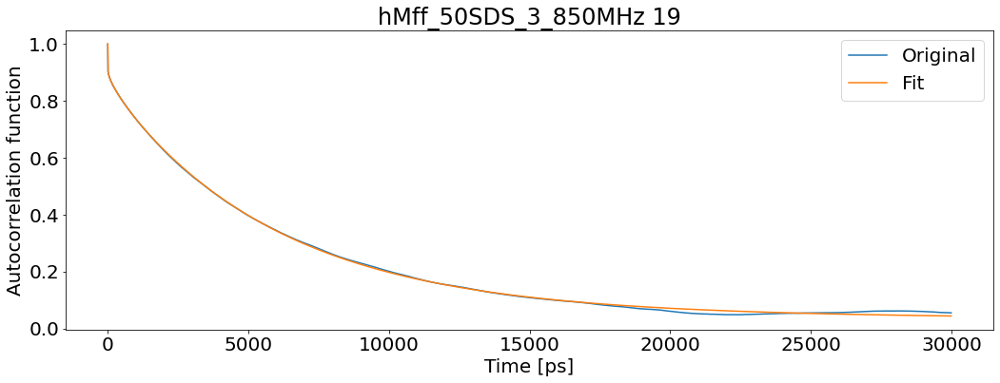

T1: 0.8331780578672071 T2: 0.05679497540048931 NOE: 0.7719249572365132


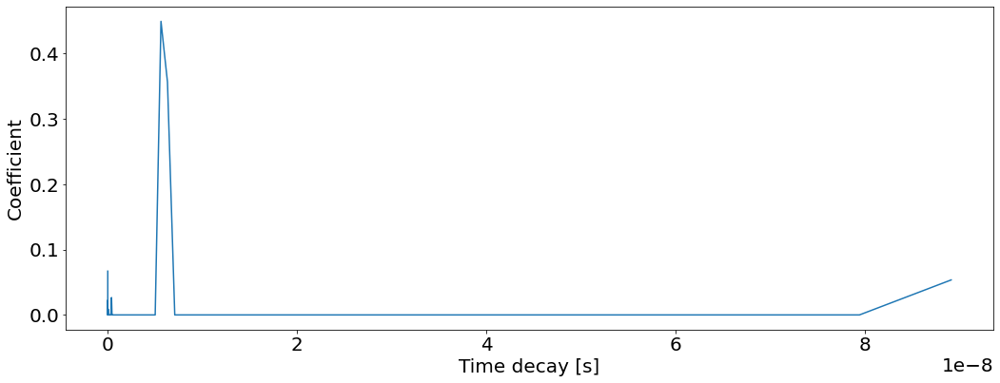

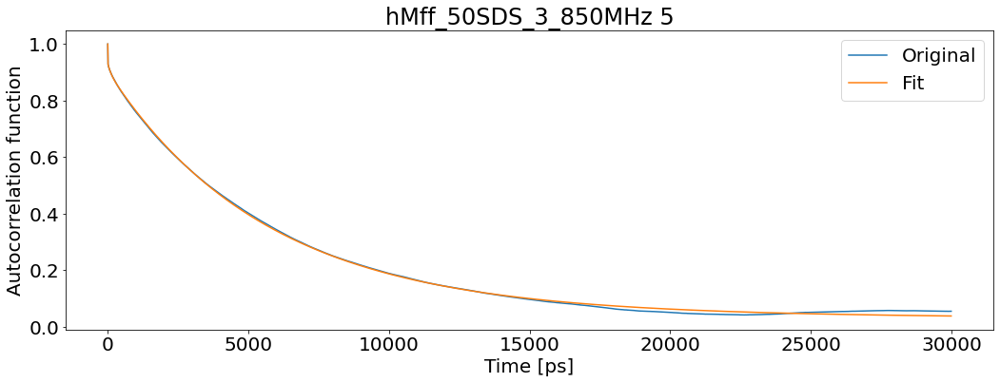

T1: 0.7738637925880991 T2: 0.05940404650837992 NOE: 0.7952627466882785


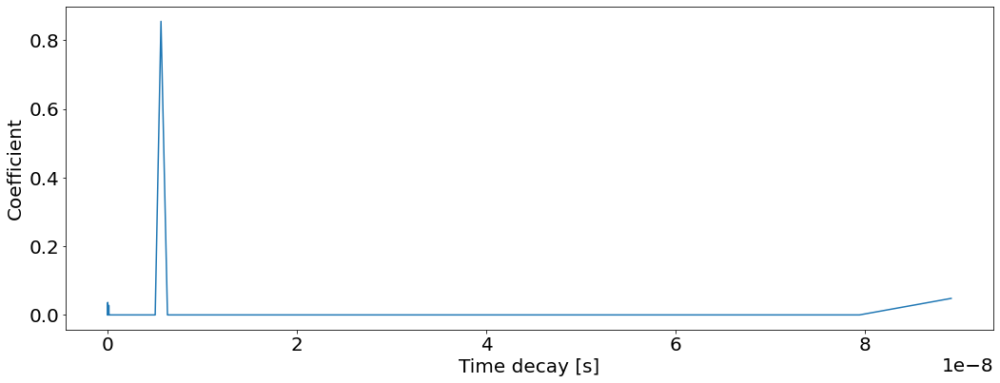

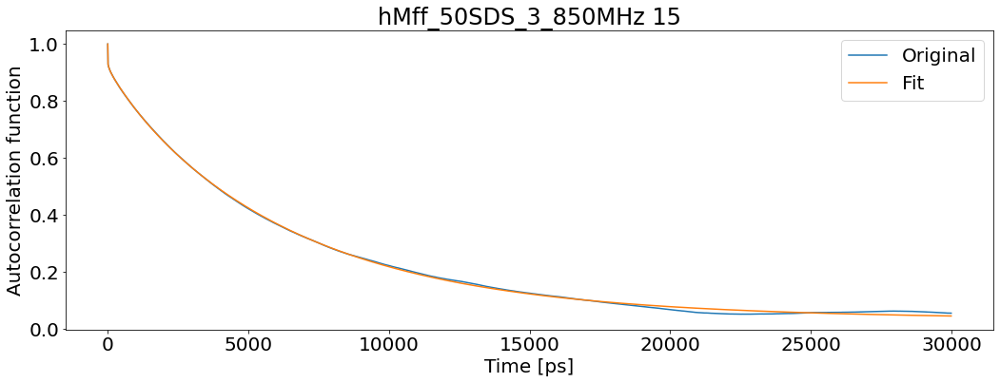

T1: 0.8294157129848875 T2: 0.054701004135019146 NOE: 0.7984542408584812


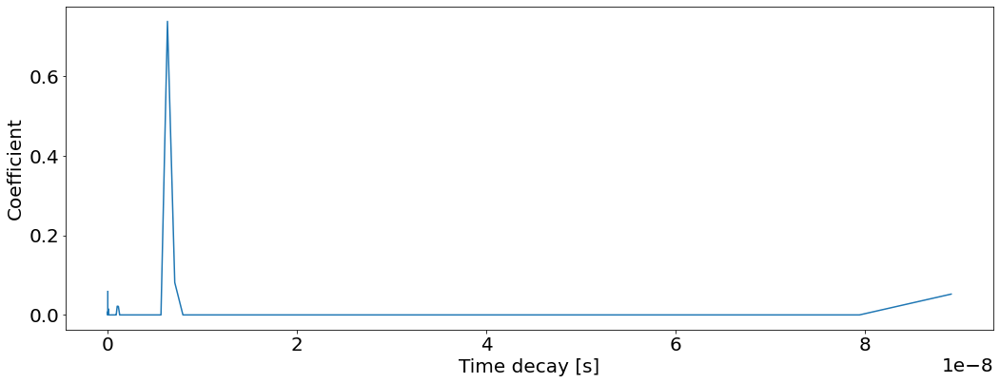

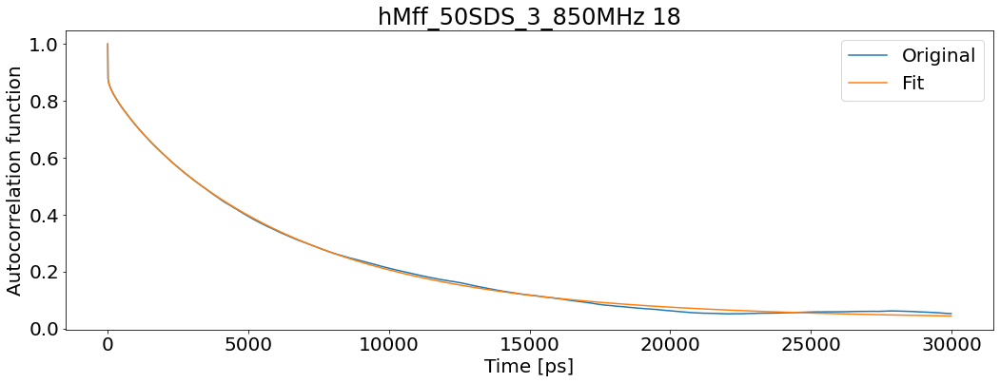

T1: 0.8960327023028921 T2: 0.057262832084275905 NOE: 0.7641731110090183


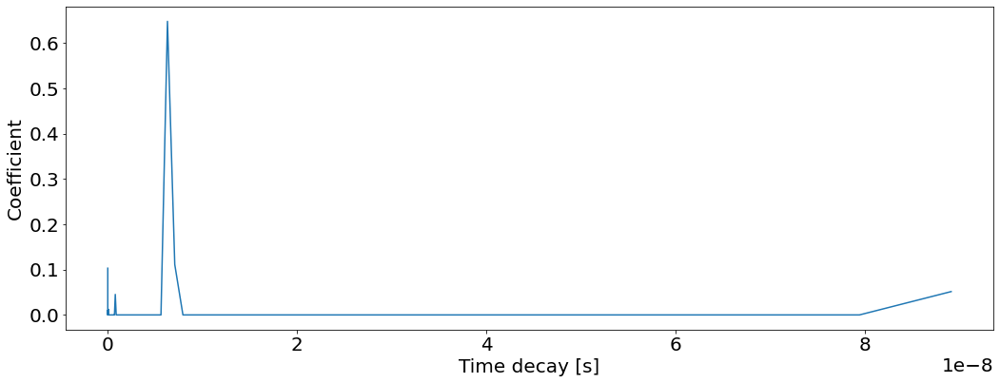

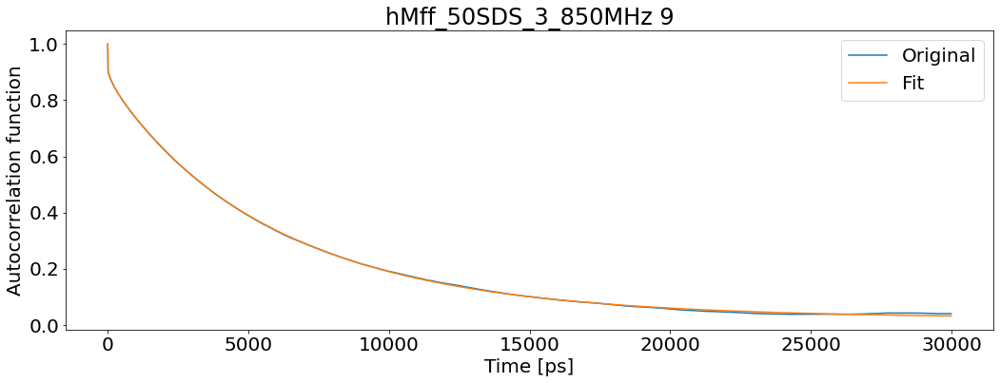

T1: 0.8114344683786333 T2: 0.06591208952913347 NOE: 0.7749880122453106


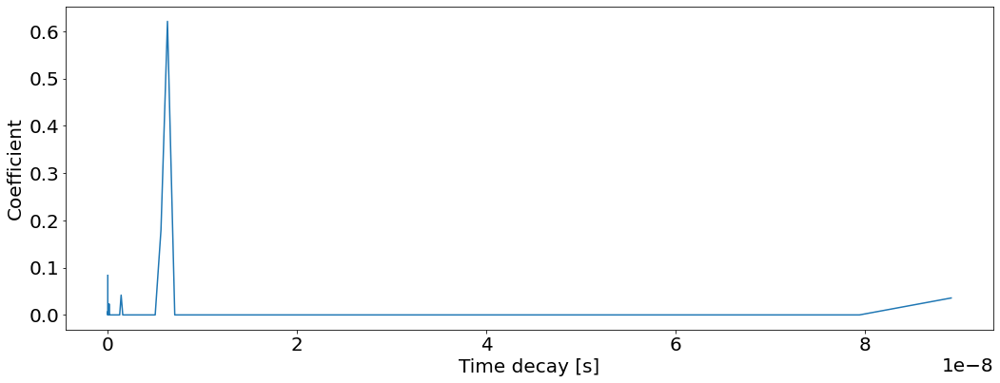

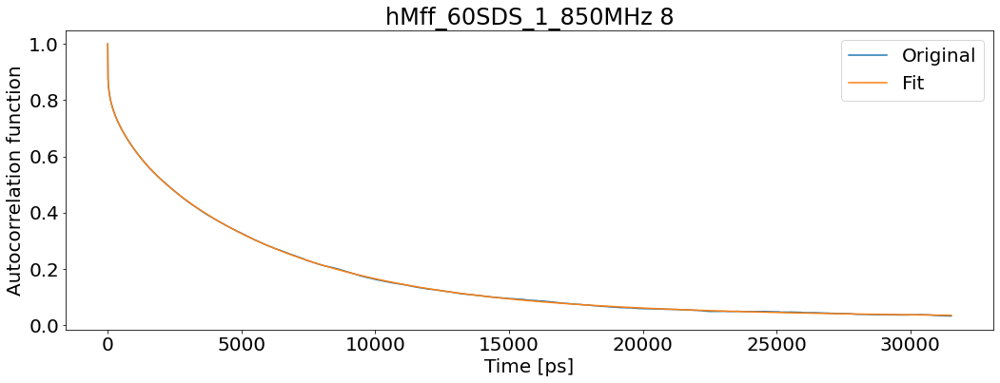

T1: 0.8551409877696577 T2: 0.07504087318098633 NOE: 0.6068426982927723


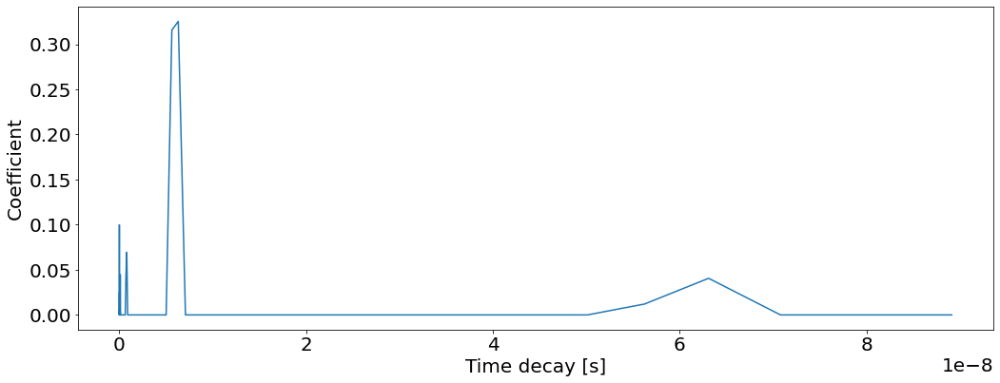

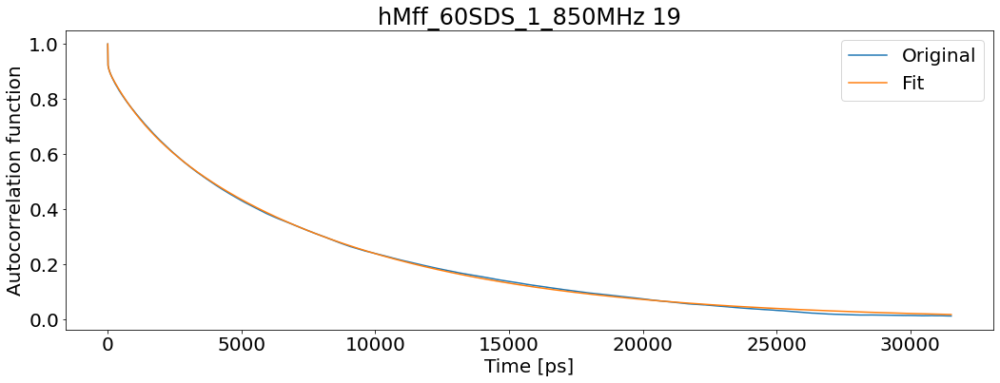

T1: 0.8891599609206867 T2: 0.07920744483249201 NOE: 0.7658327352547842


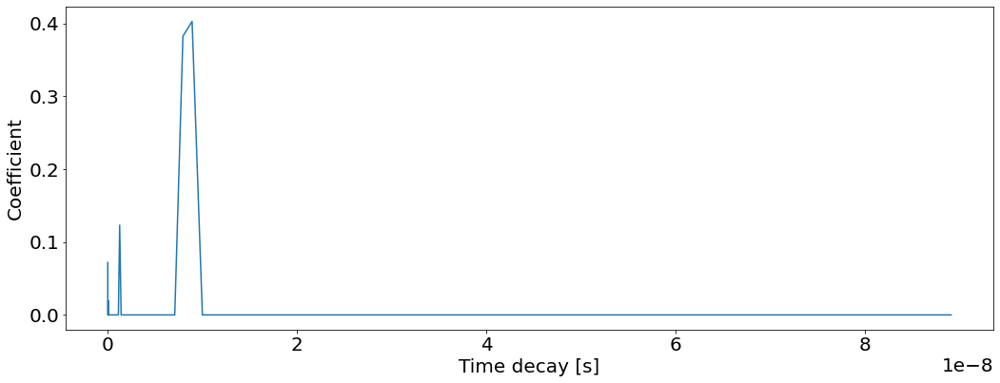

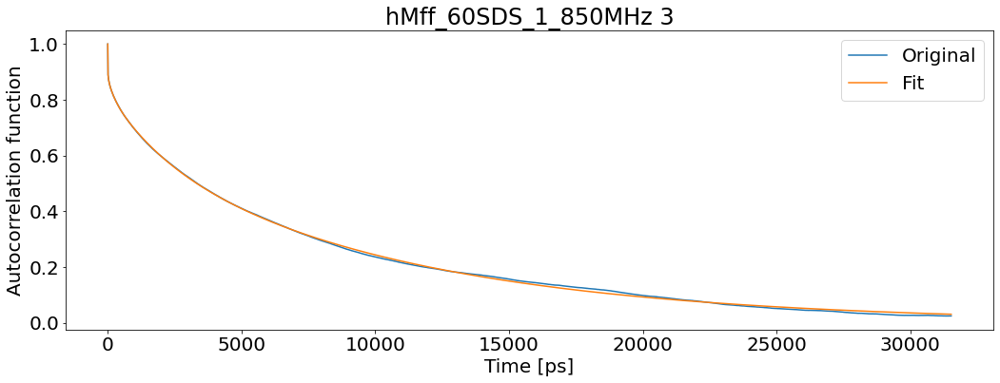

T1: 0.9253213278001468 T2: 0.07685791963972374 NOE: 0.6626551804617211


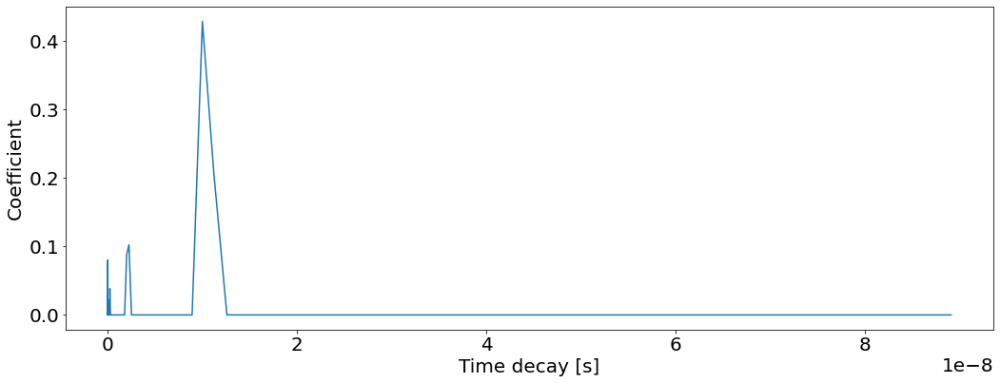

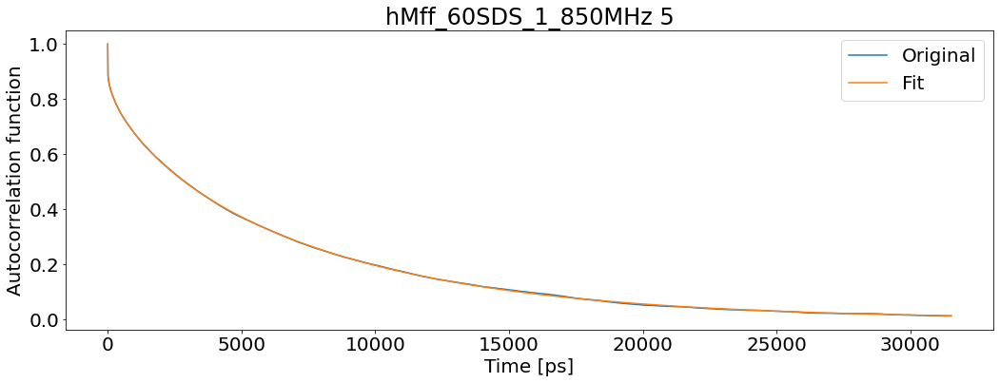

T1: 0.8722428933243958 T2: 0.09336770617732314 NOE: 0.6558885208291261


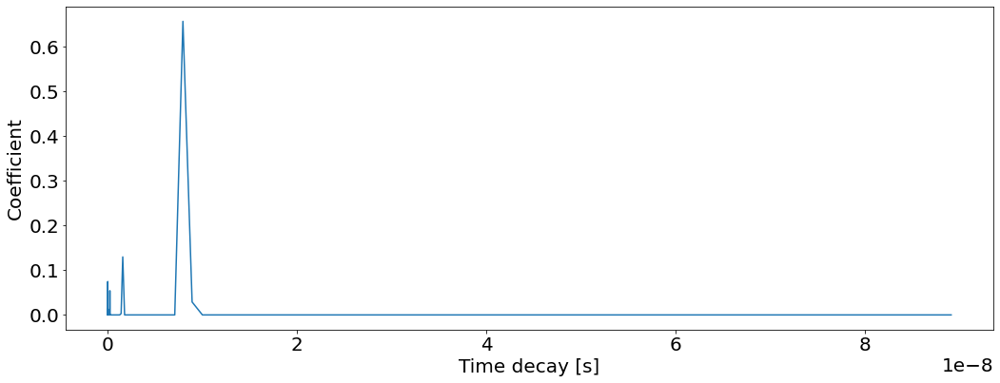

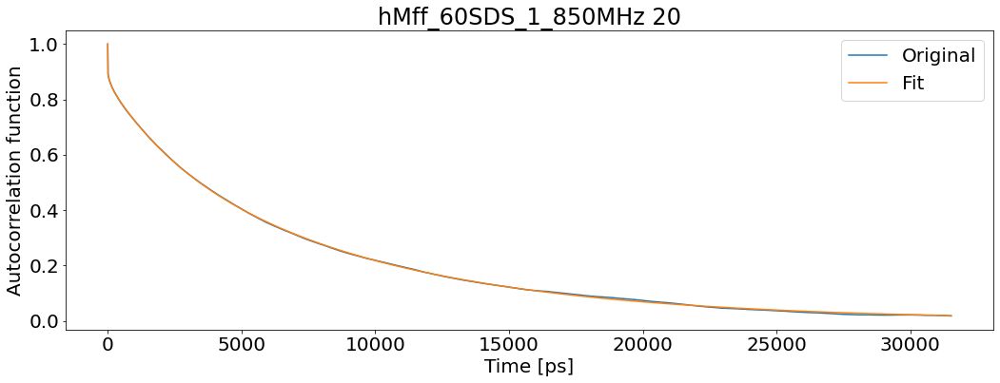

T1: 0.8649604787793431 T2: 0.08428670387187209 NOE: 0.7592114016870288


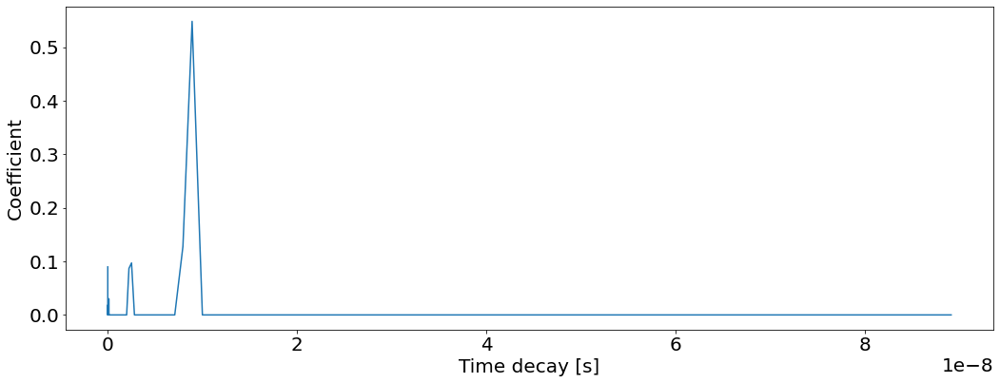

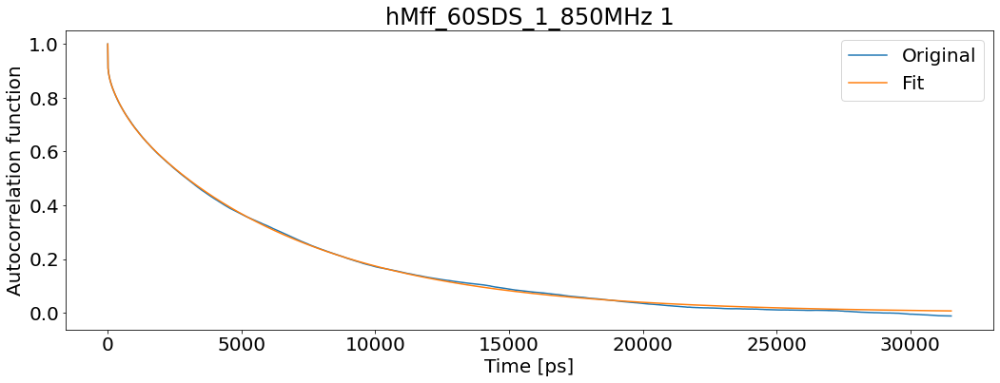

T1: 0.8432298675459492 T2: 0.10037216901260748 NOE: 0.6651252264016985


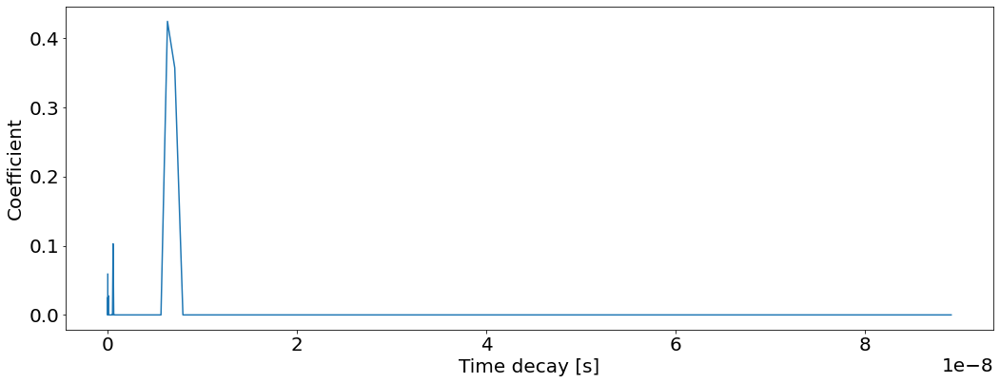

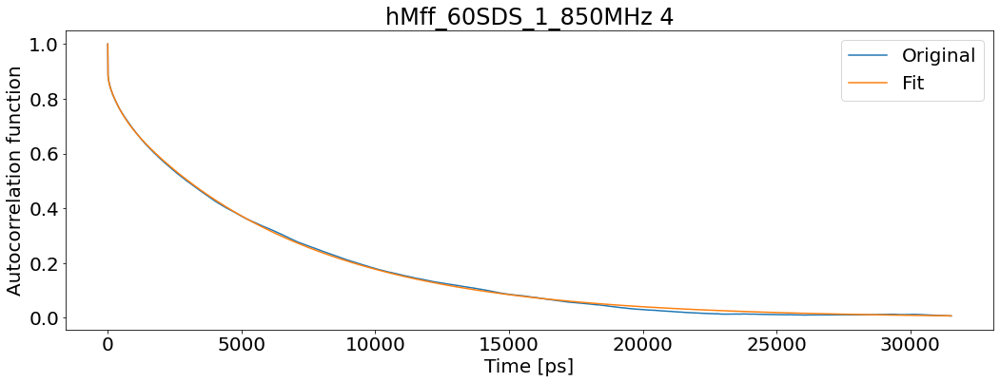

T1: 0.8905578415472415 T2: 0.09974268464277332 NOE: 0.6657286008763106


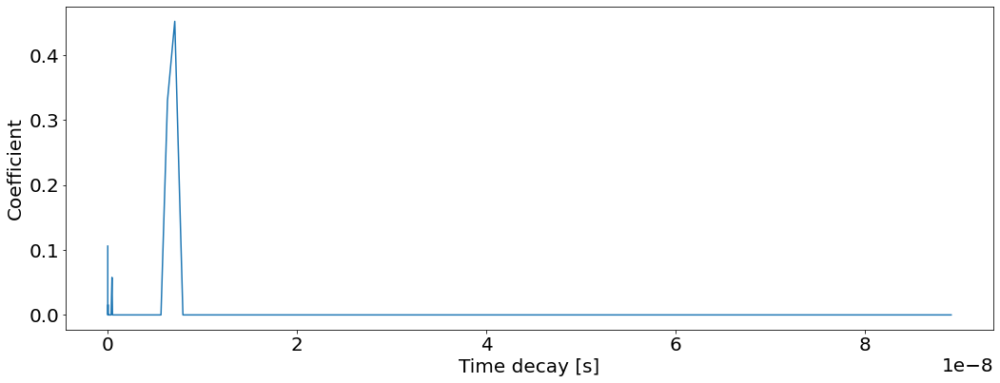

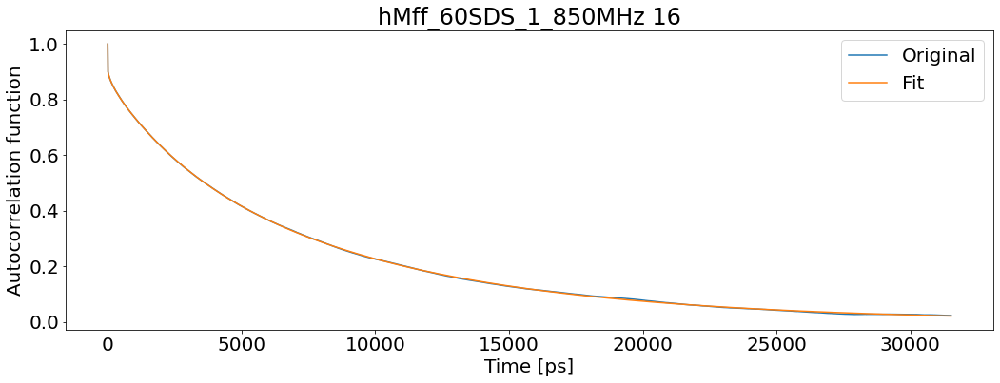

T1: 0.8719100284293283 T2: 0.08091885561289845 NOE: 0.758257760308174


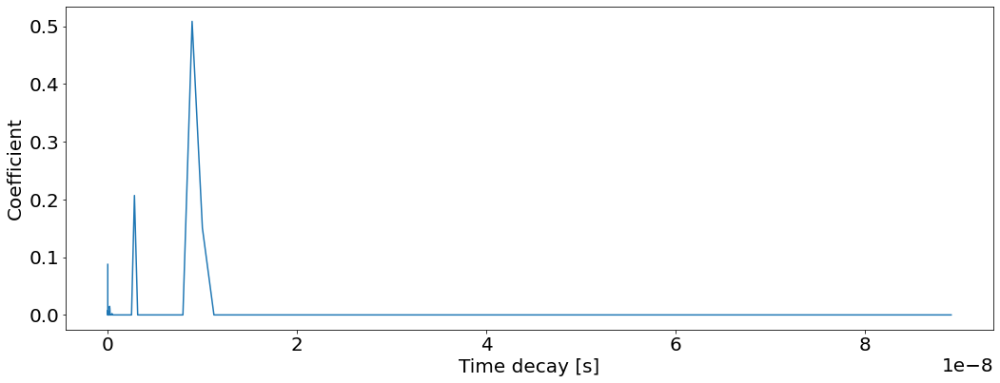

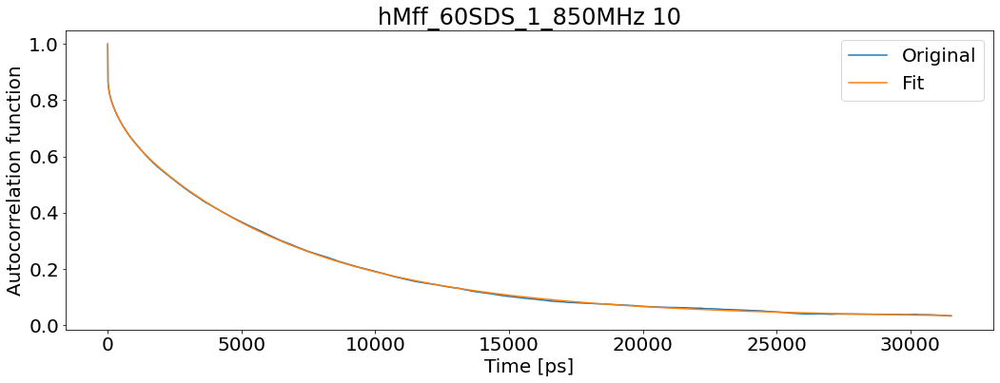

T1: 0.9403067445847262 T2: 0.06608221953560352 NOE: 0.6192608332444656


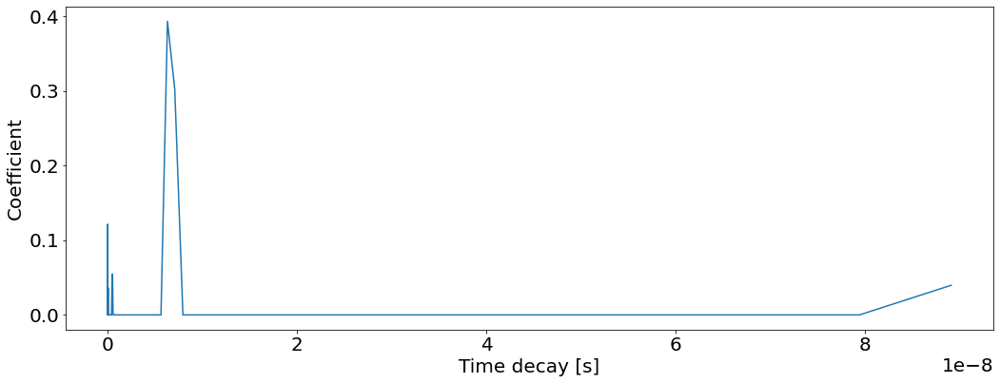

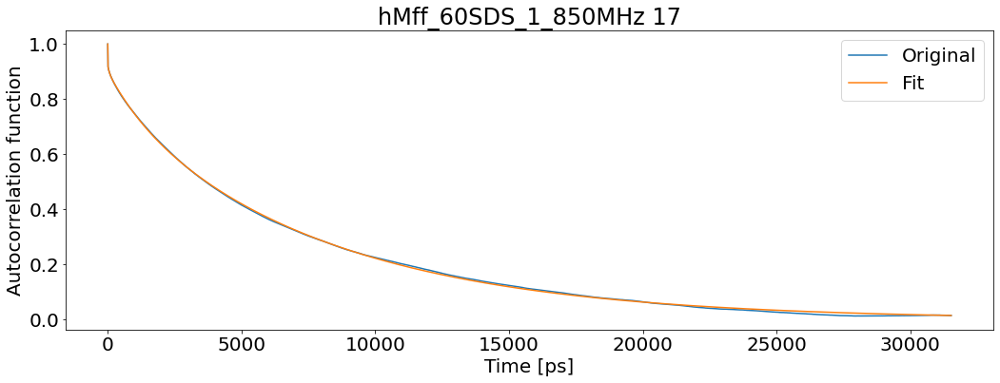

T1: 0.8604585956064024 T2: 0.08363723468870347 NOE: 0.7687961108119885


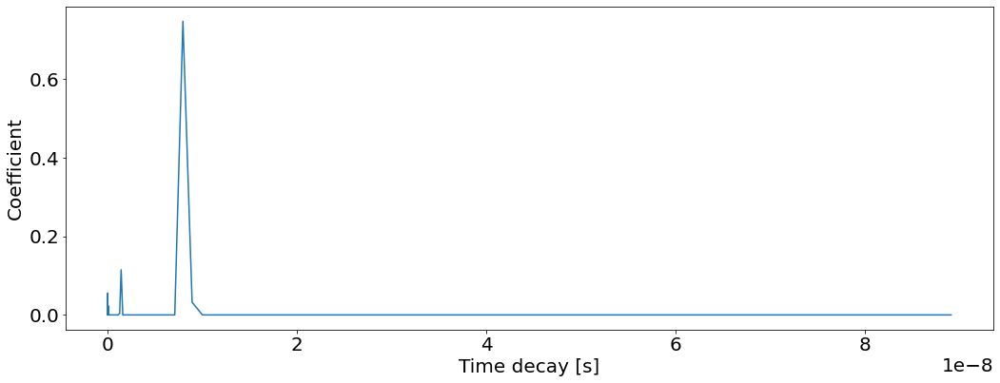

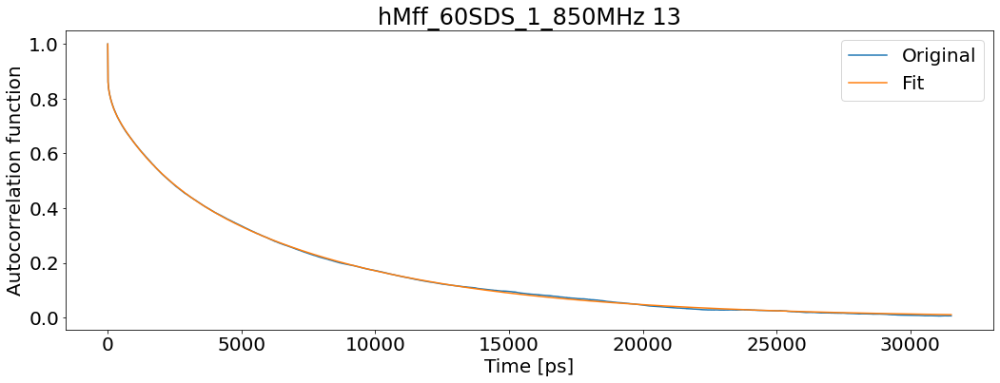

T1: 0.8461768918072207 T2: 0.10338921517184785 NOE: 0.6523223935672369


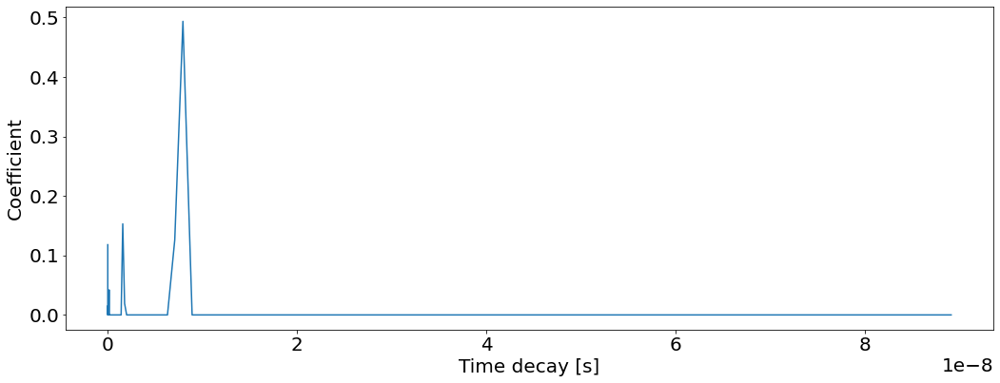

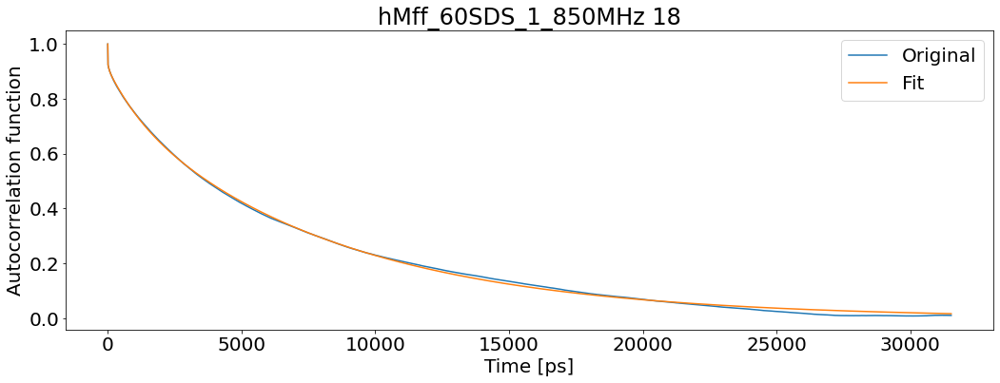

T1: 0.8624266608024567 T2: 0.08197072025001619 NOE: 0.763062225190424


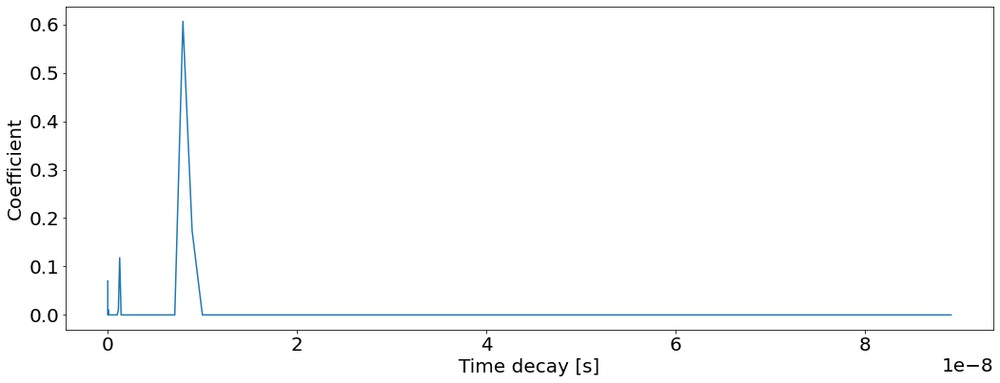

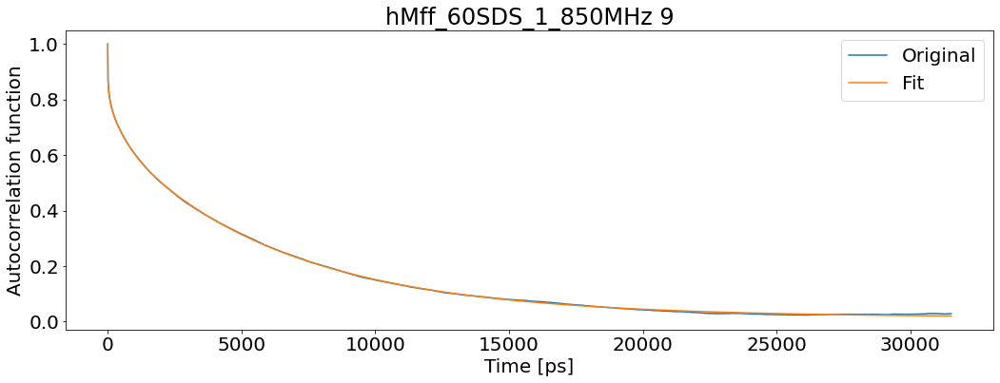

T1: 0.8753207565281668 T2: 0.0862876333546958 NOE: 0.5783153938105857


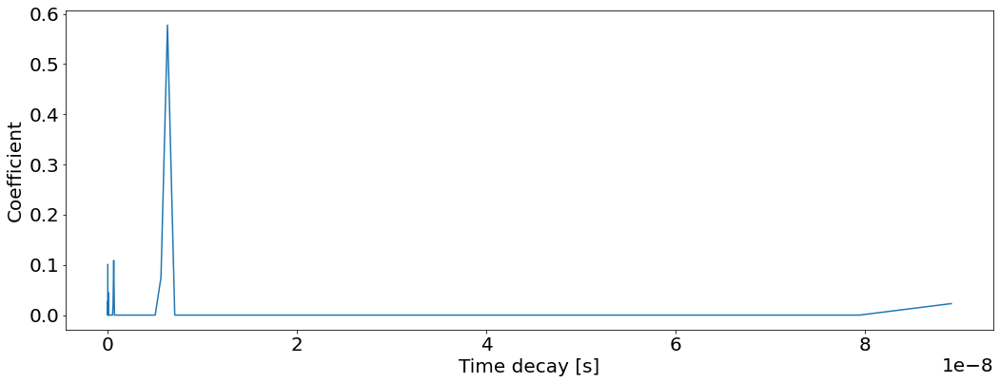

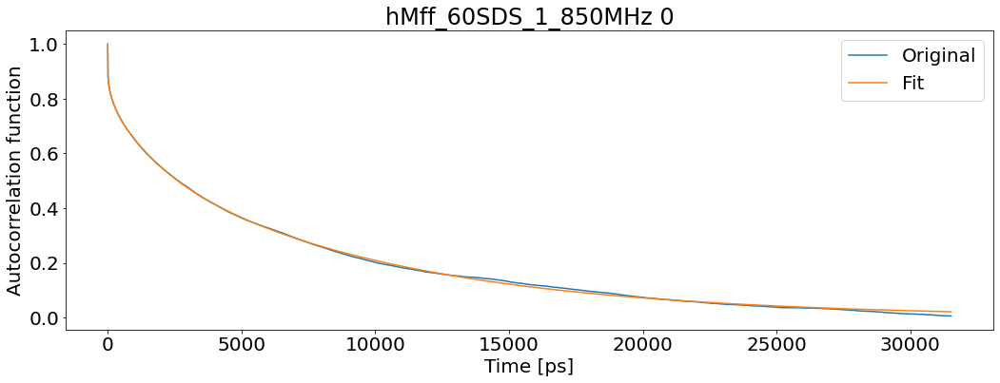

T1: 0.8884282803447822 T2: 0.08862021206249798 NOE: 0.6109216333269785


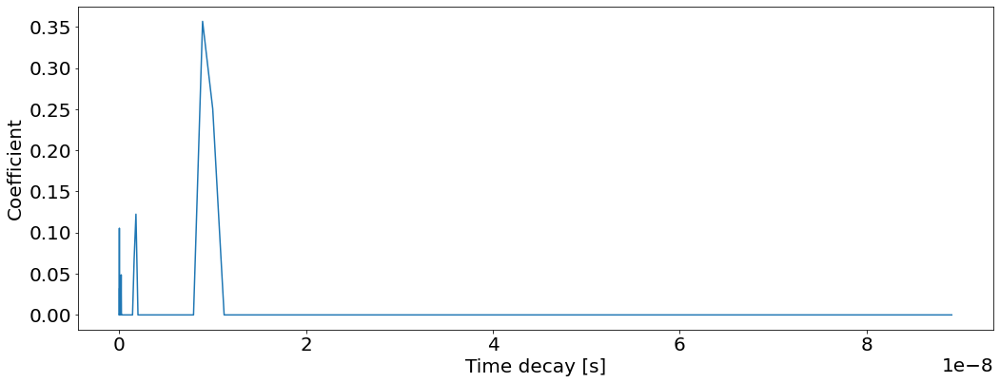

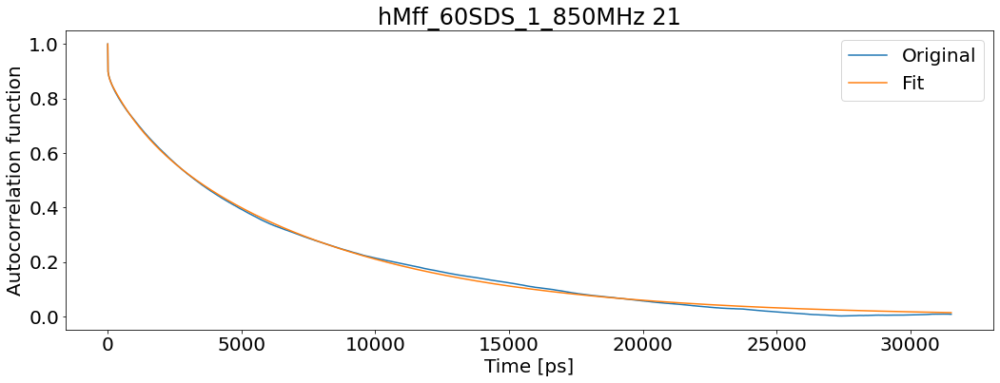

T1: 0.8650356513332847 T2: 0.08809339310023623 NOE: 0.7530519469338111


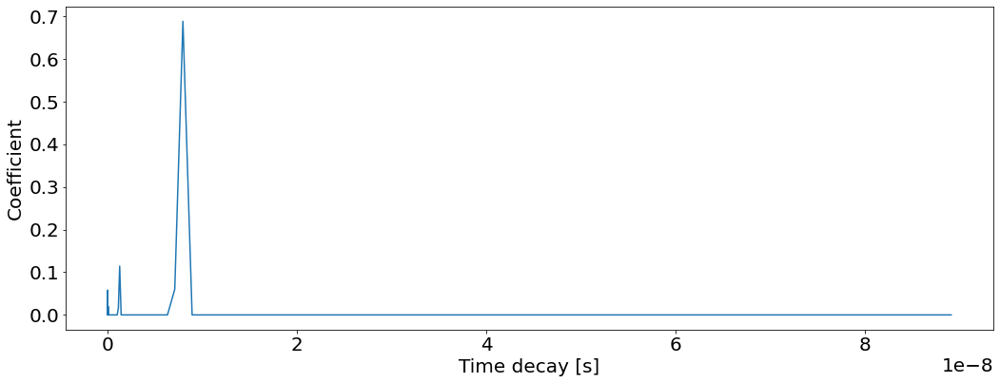

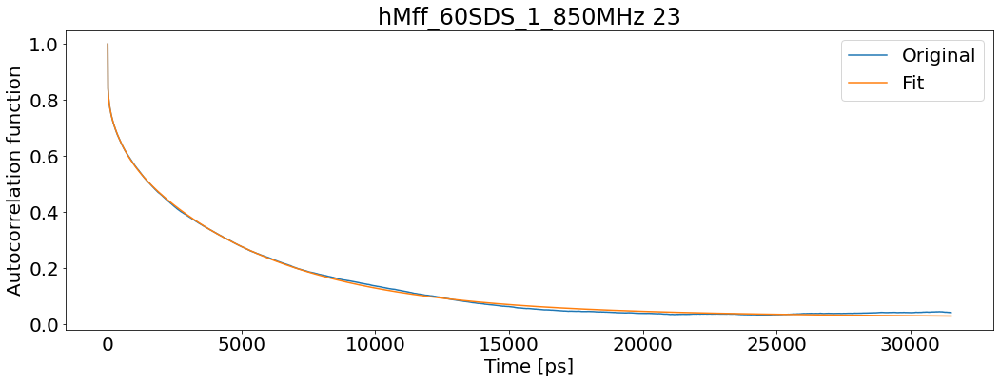

T1: 0.8471866602384945 T2: 0.07700307858668272 NOE: 0.5560900730750313


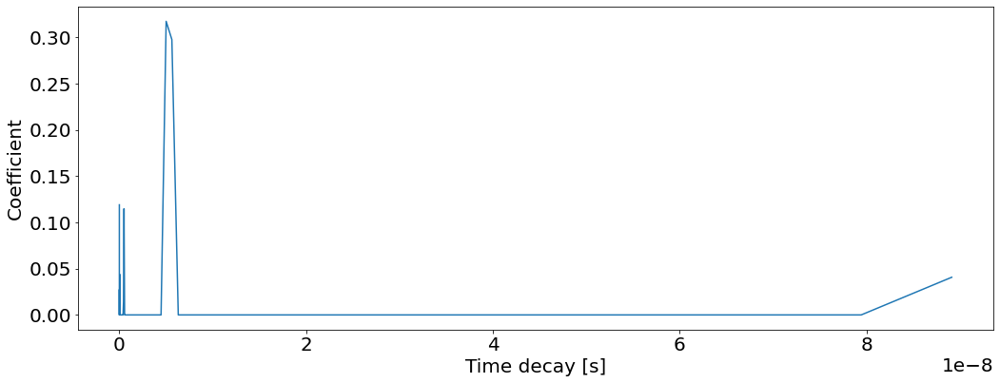

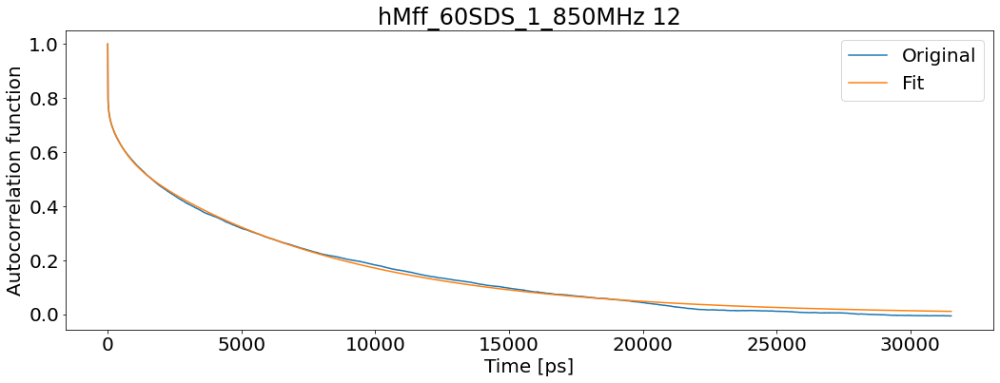

T1: 1.1014799308506547 T2: 0.1095419637722217 NOE: 0.5213469500992286


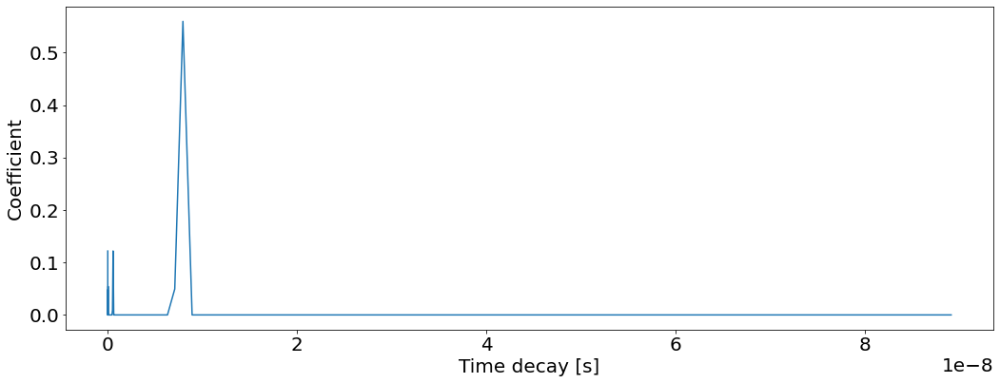

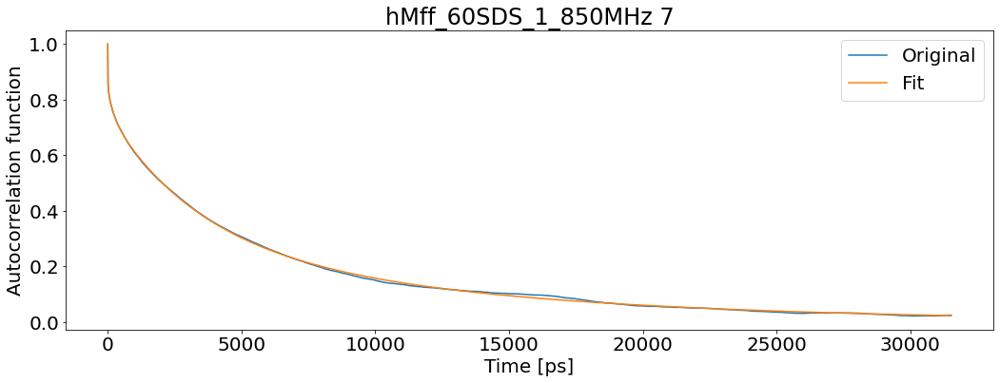

T1: 0.7909270308312035 T2: 0.10034270778389186 NOE: 0.6232452808425935


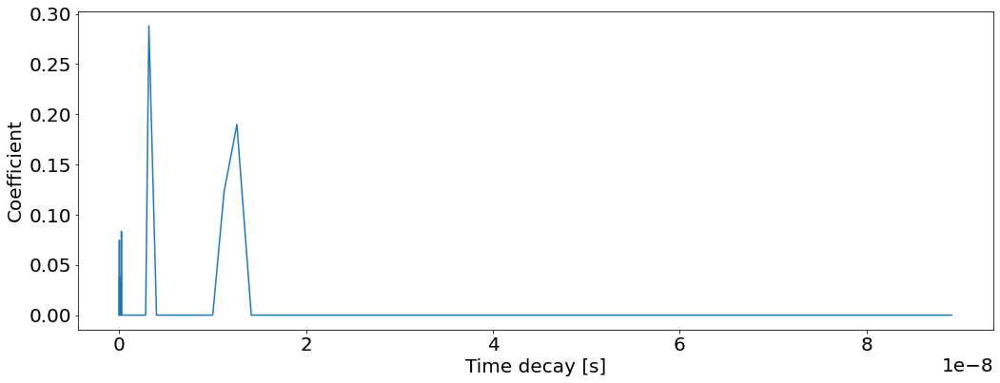

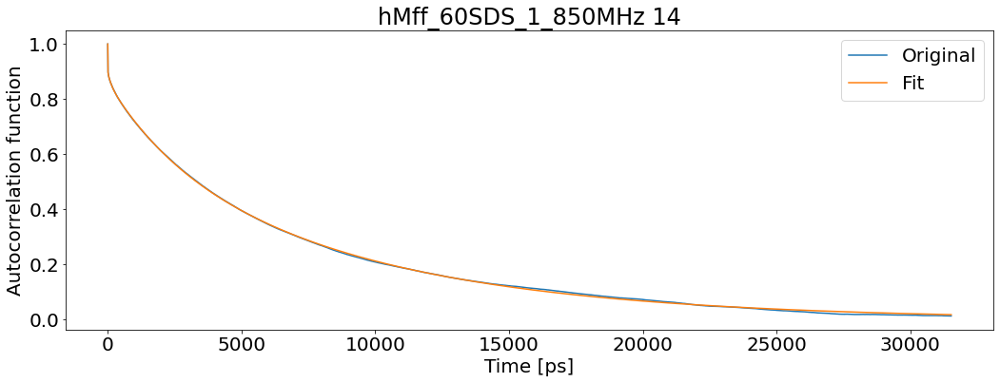

T1: 0.8403618602257488 T2: 0.08508797349470076 NOE: 0.7462322509186079


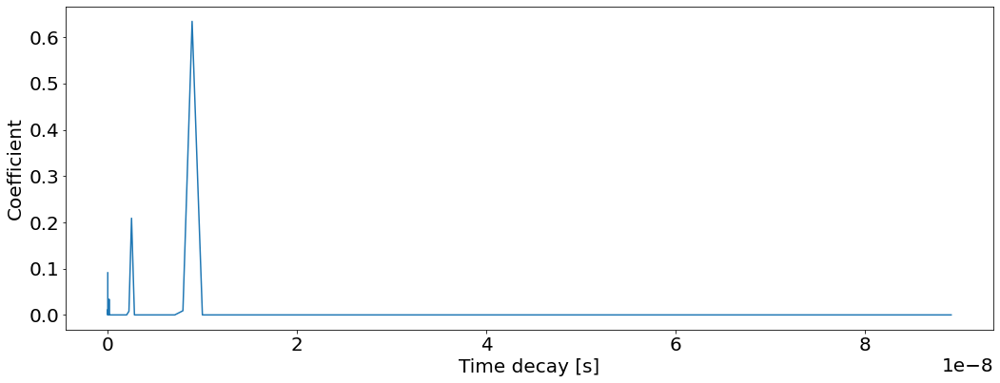

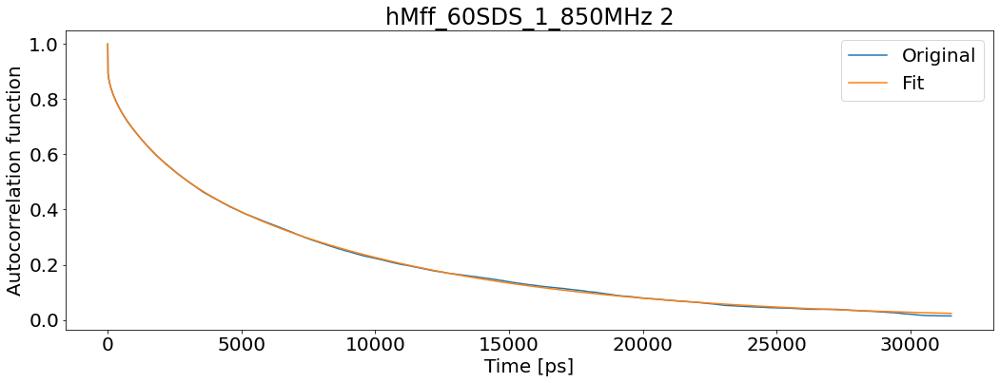

T1: 0.8837062154854523 T2: 0.0828142617492803 NOE: 0.6576714256971106


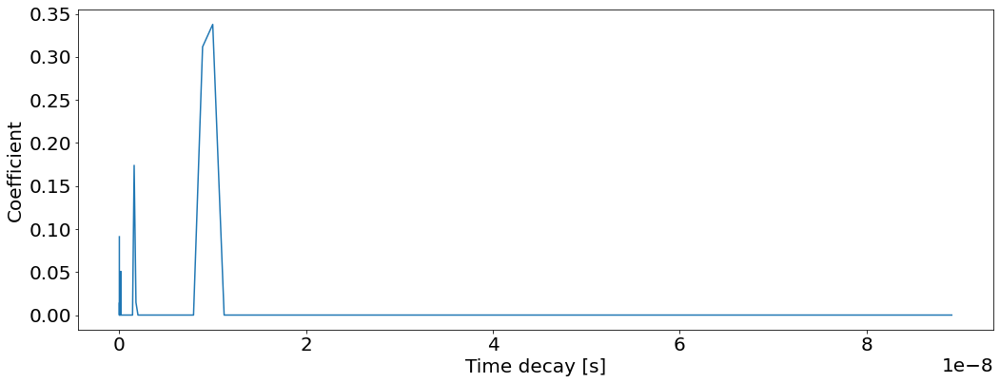

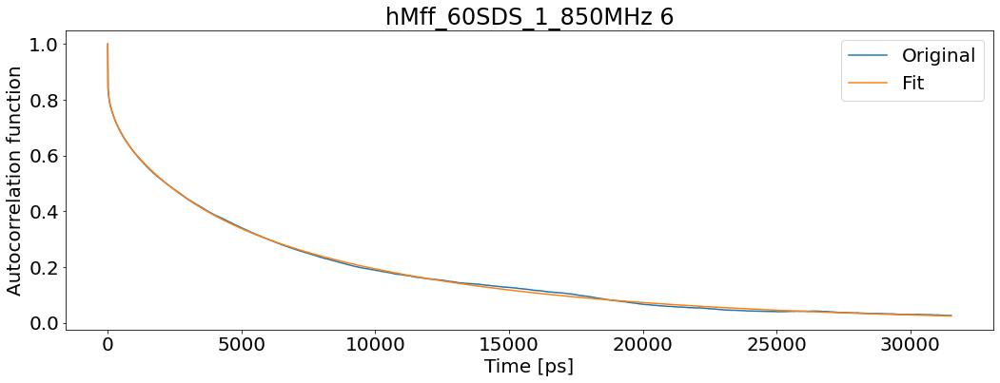

T1: 0.9078937895537141 T2: 0.09253993657709782 NOE: 0.5831585573127134


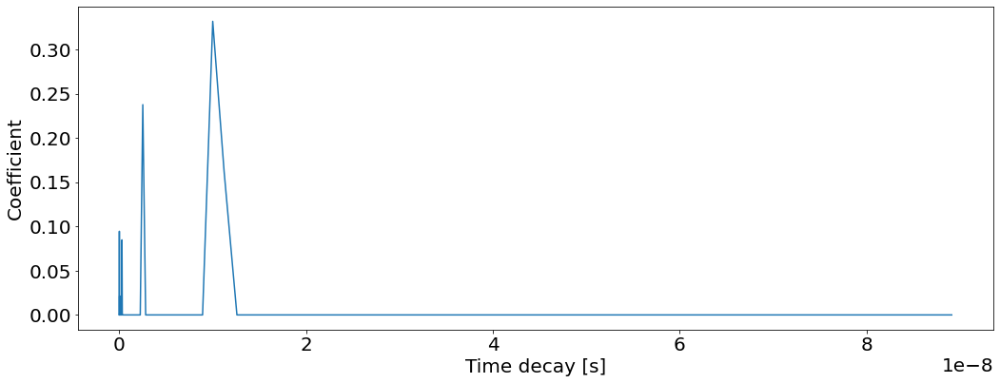

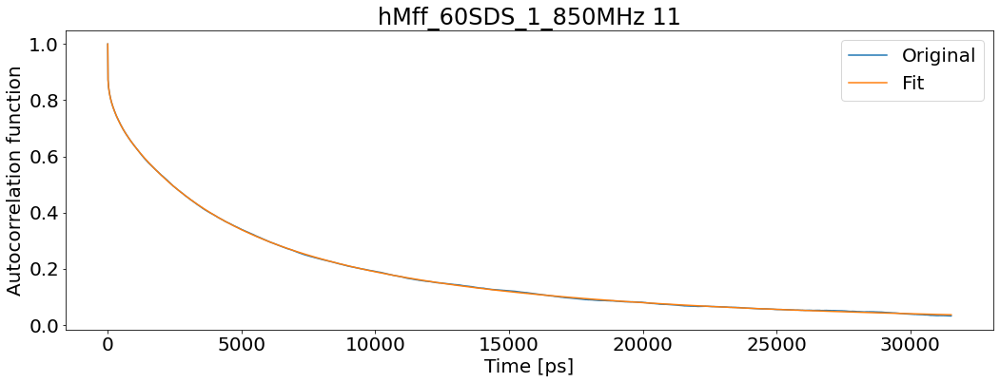

T1: 0.8376587943495645 T2: 0.08367589430142235 NOE: 0.62489710638405


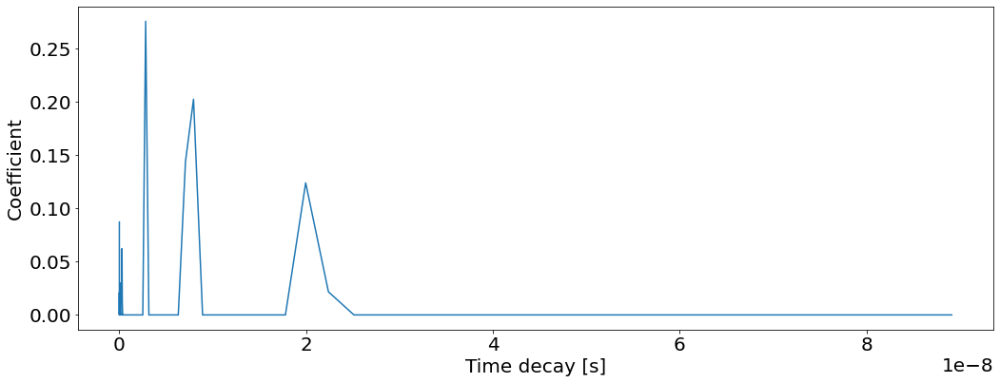

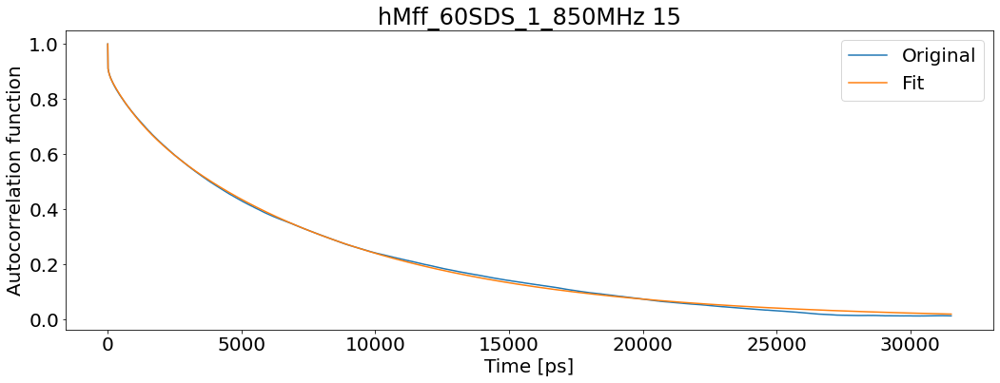

T1: 0.9306983581202788 T2: 0.07975887396345381 NOE: 0.7479418665277787


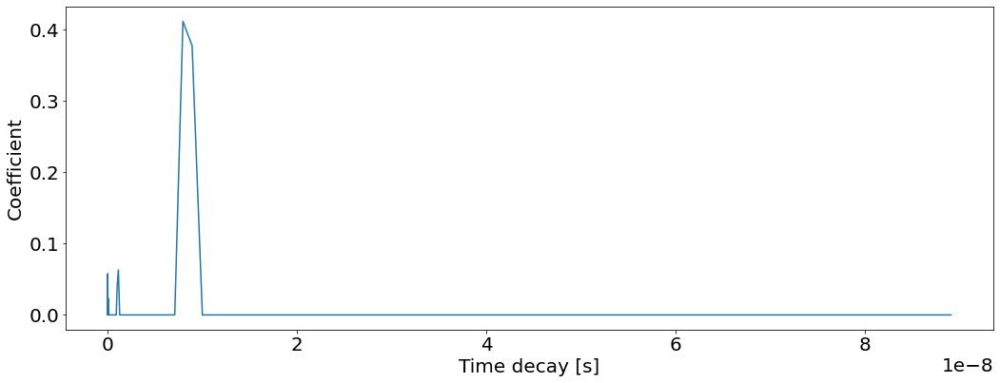

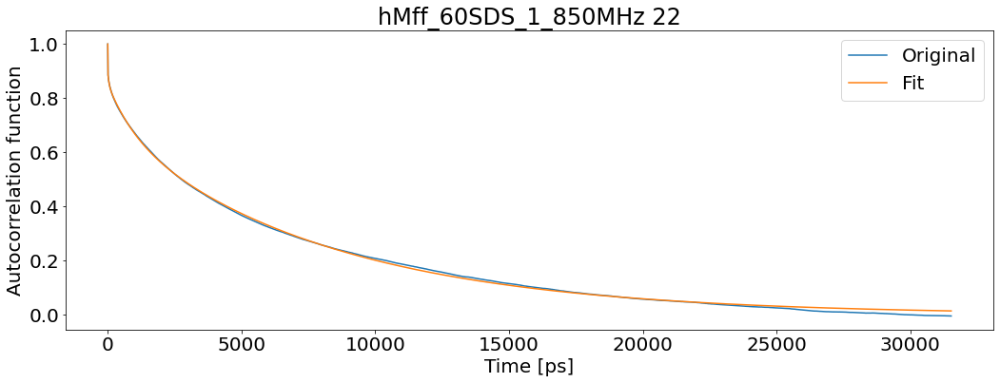

T1: 0.8940732619233462 T2: 0.09224145673633569 NOE: 0.6747023044494782


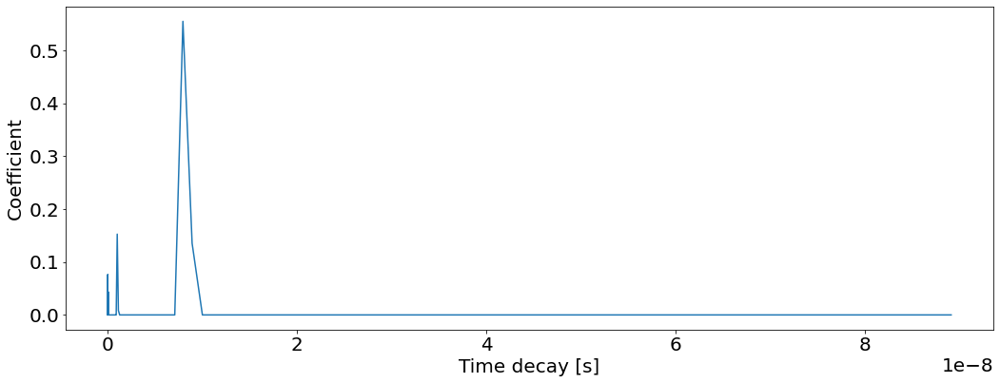

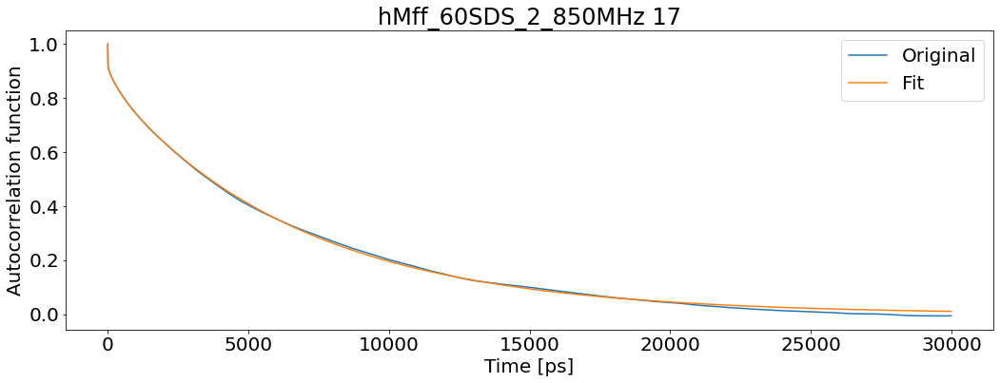

T1: 0.8574511697074824 T2: 0.09130898278455098 NOE: 0.7395453238977898


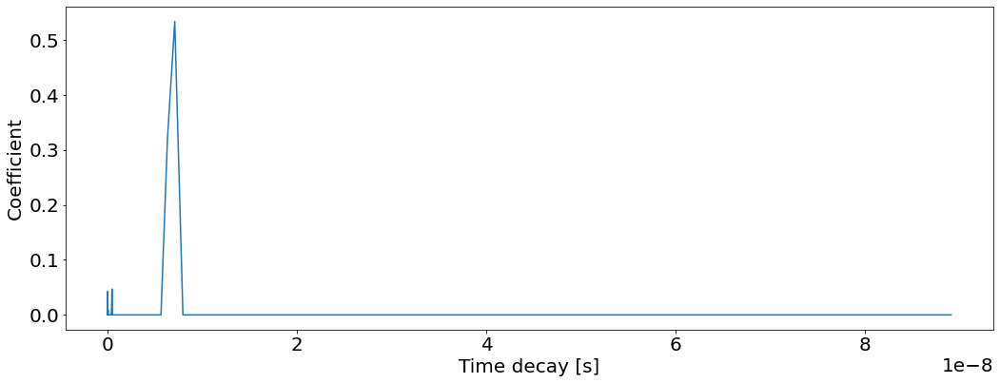

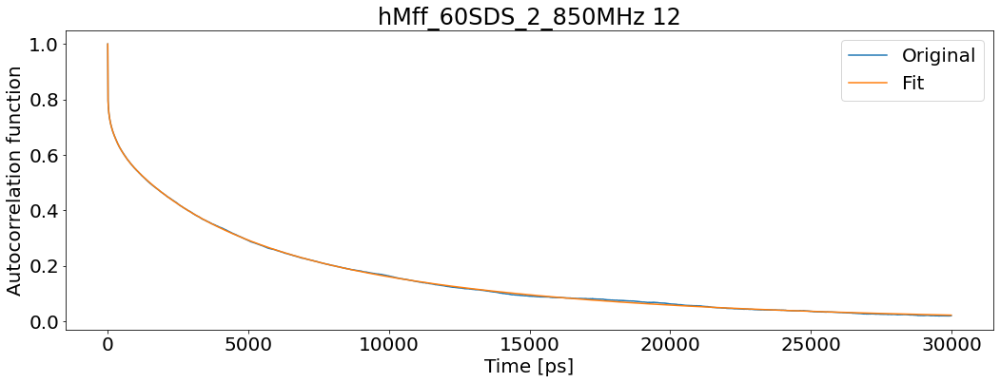

T1: 0.9516579704180396 T2: 0.10741281266235851 NOE: 0.5295228290077278


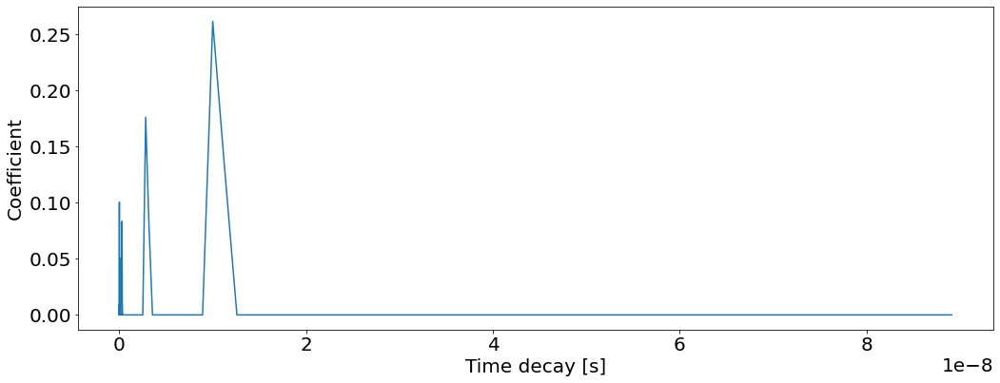

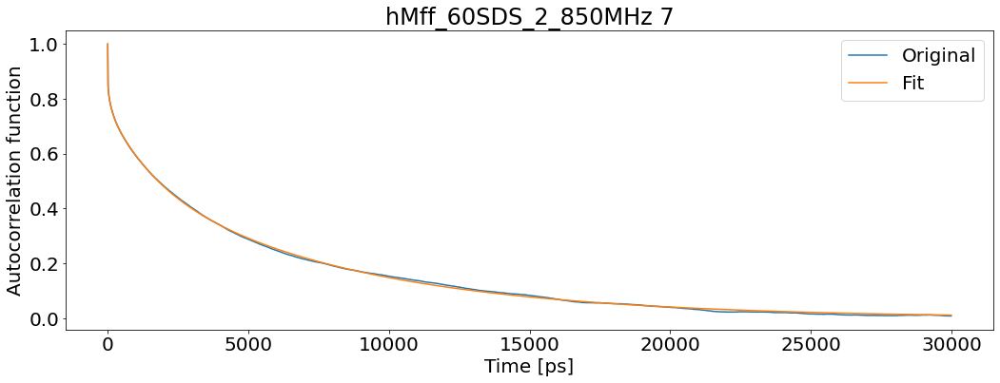

T1: 0.8089341006424932 T2: 0.11482527092963621 NOE: 0.6187303026240402


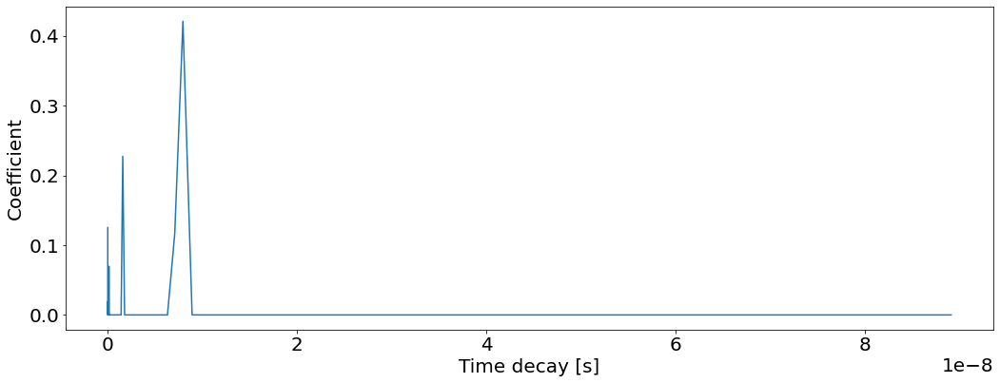

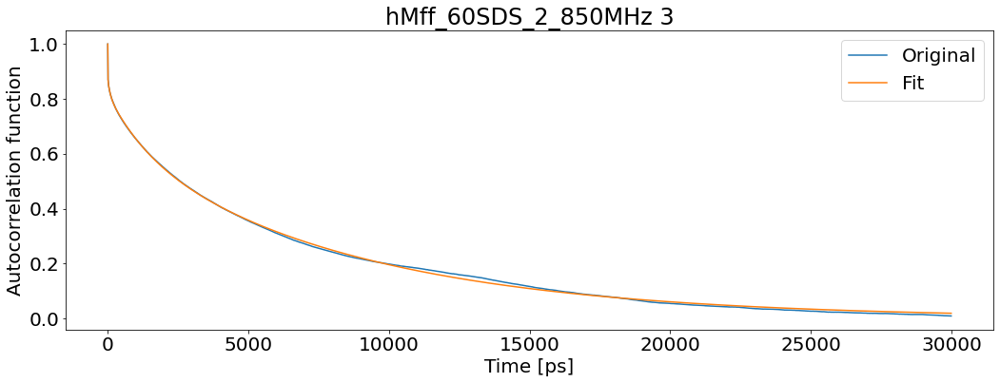

T1: 0.8768590594890925 T2: 0.0939333902202787 NOE: 0.674225778398567


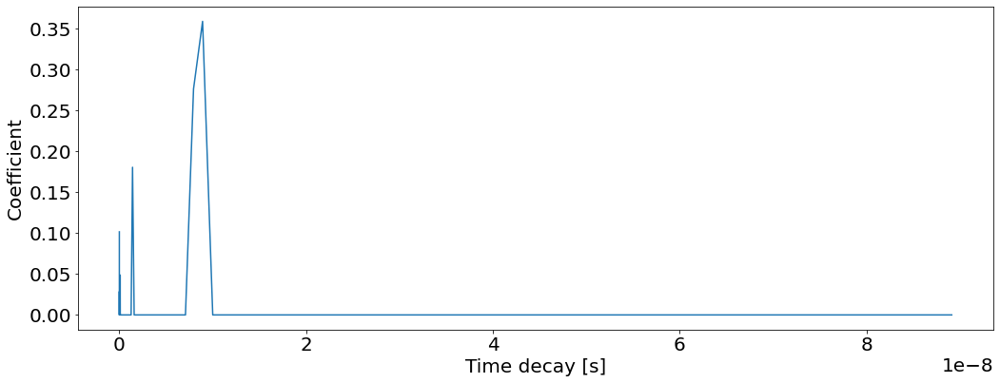

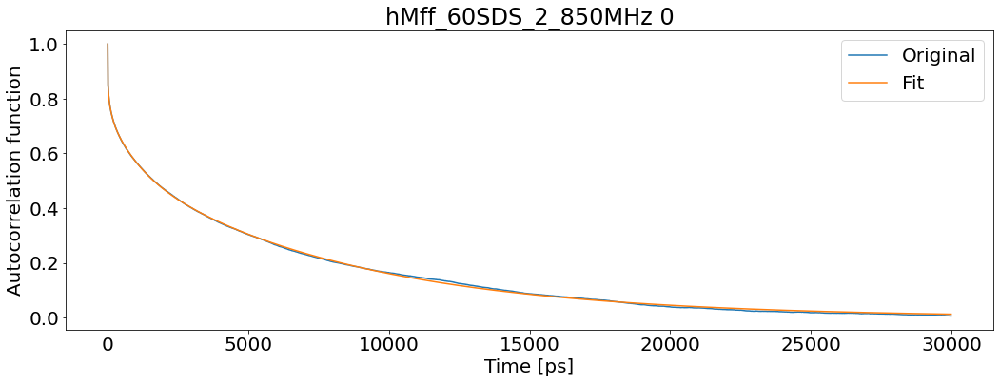

T1: 0.9181206829950462 T2: 0.11194284644500536 NOE: 0.5053903562996065


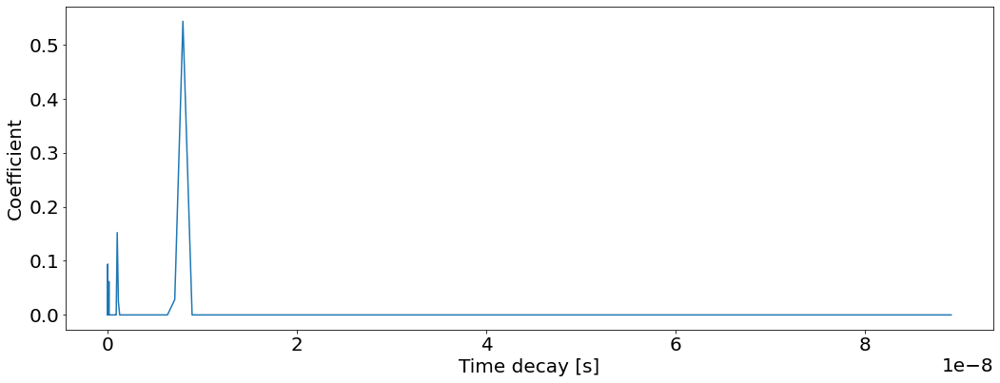

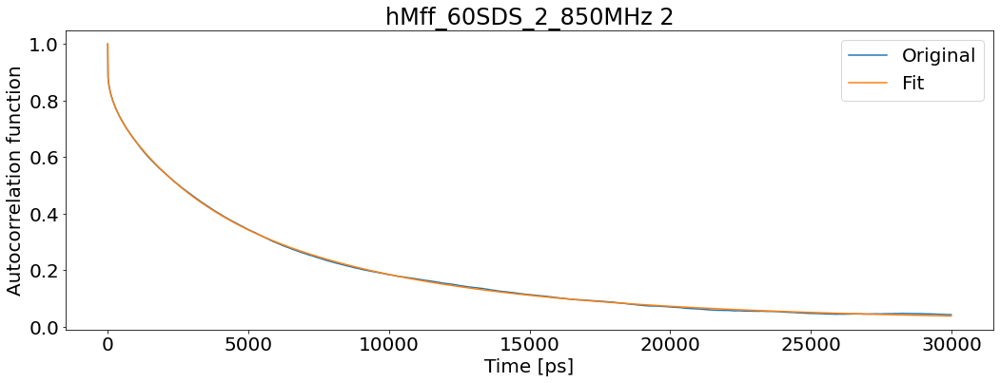

T1: 0.808507260773745 T2: 0.06761612373603348 NOE: 0.6485419860332647


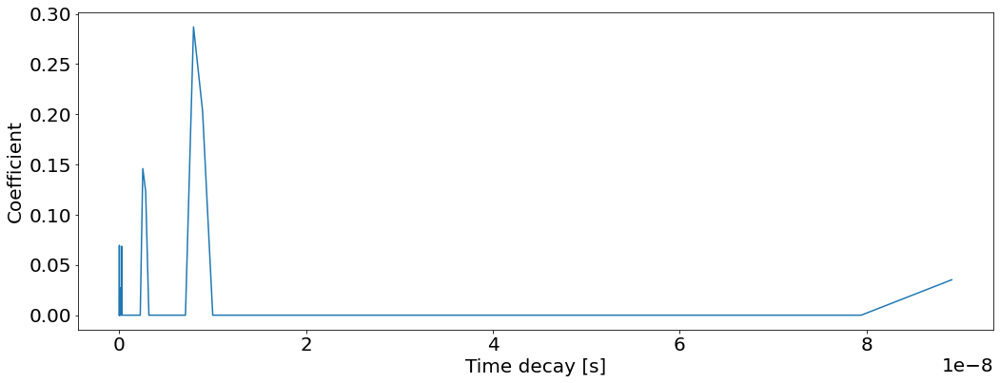

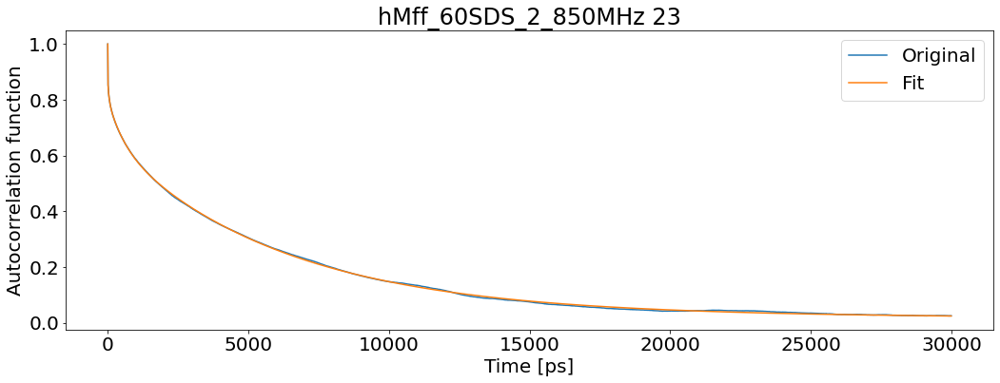

T1: 0.8865044420870043 T2: 0.08423650664350421 NOE: 0.5532158566044232


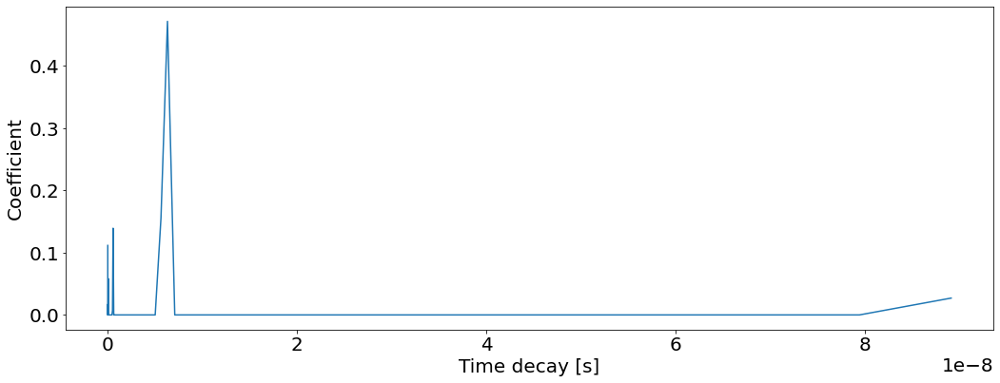

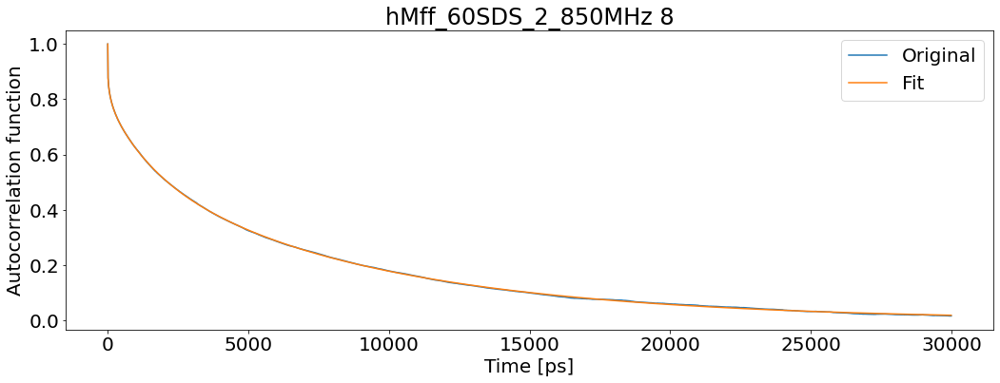

T1: 0.8347198241746863 T2: 0.09953525901623798 NOE: 0.6065512883125999


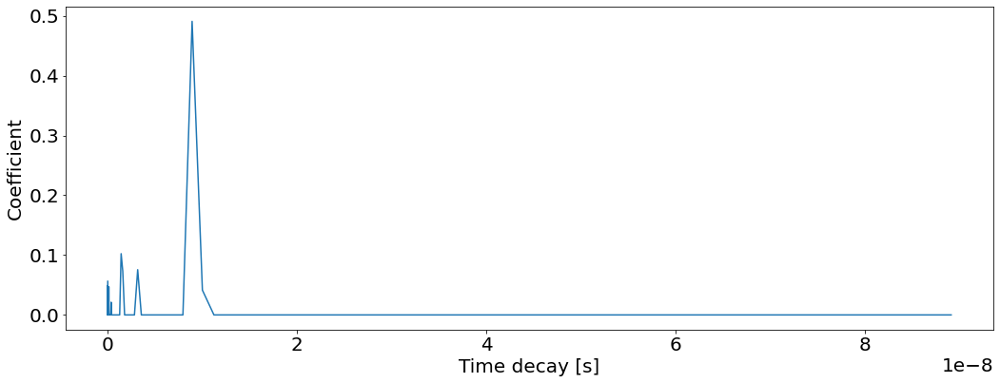

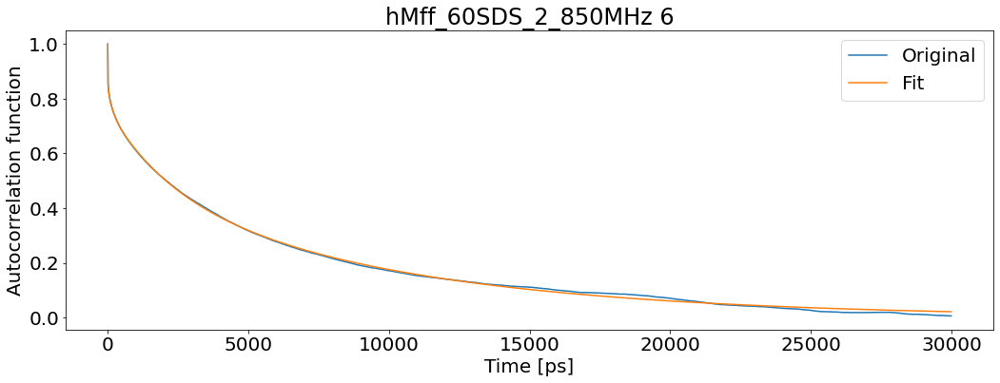

T1: 0.8344790844619167 T2: 0.09947991947587087 NOE: 0.6092256771810285


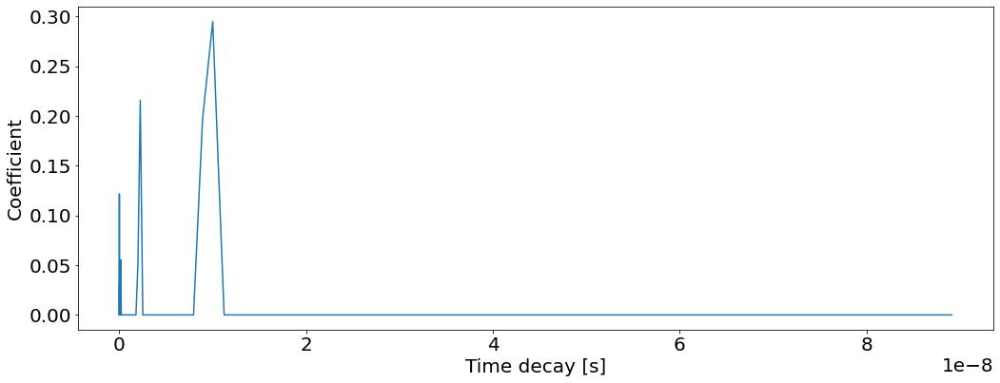

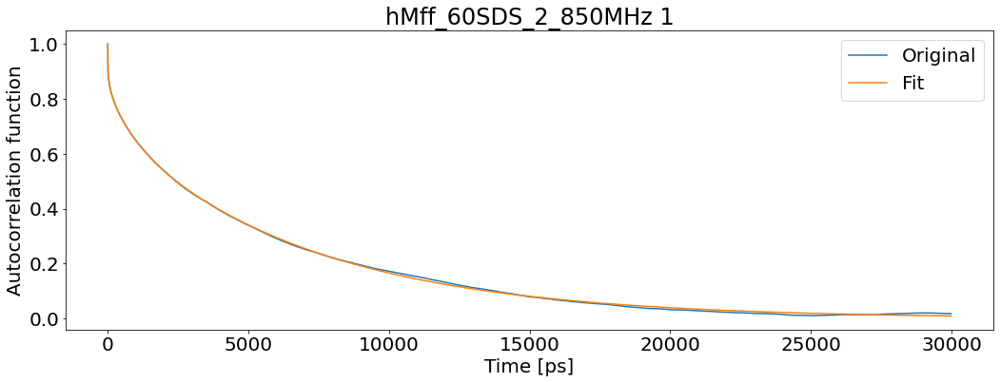

T1: 0.844193338323476 T2: 0.10549895446569464 NOE: 0.6205279444818167


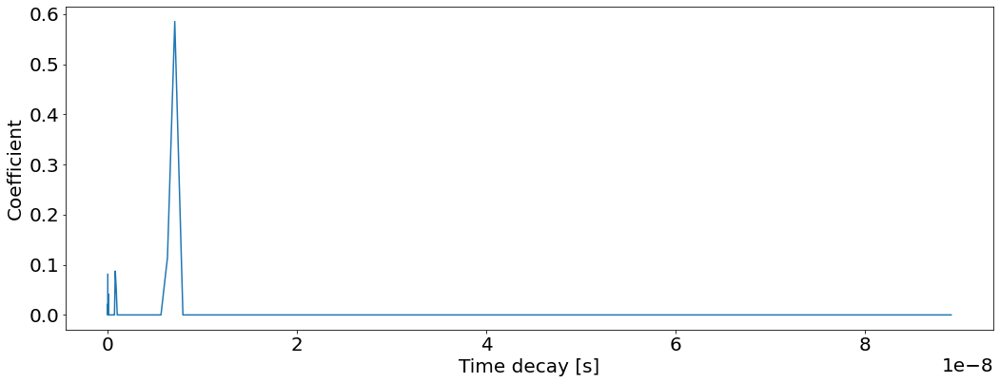

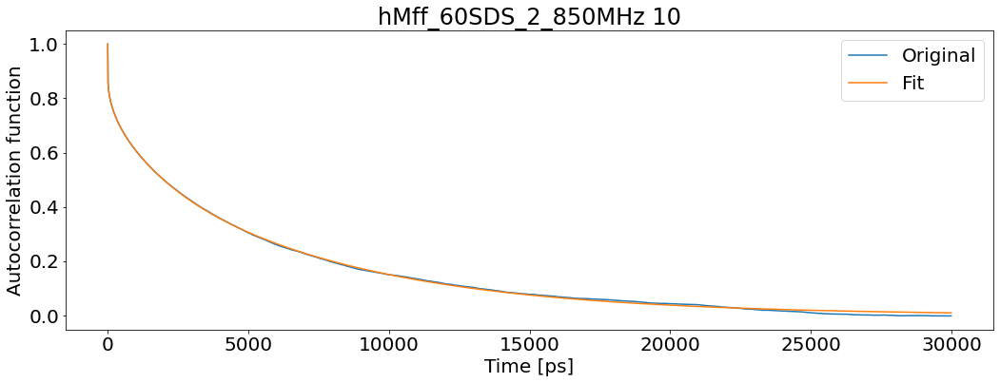

T1: 0.829162582967572 T2: 0.11357335052856878 NOE: 0.6049326946430429


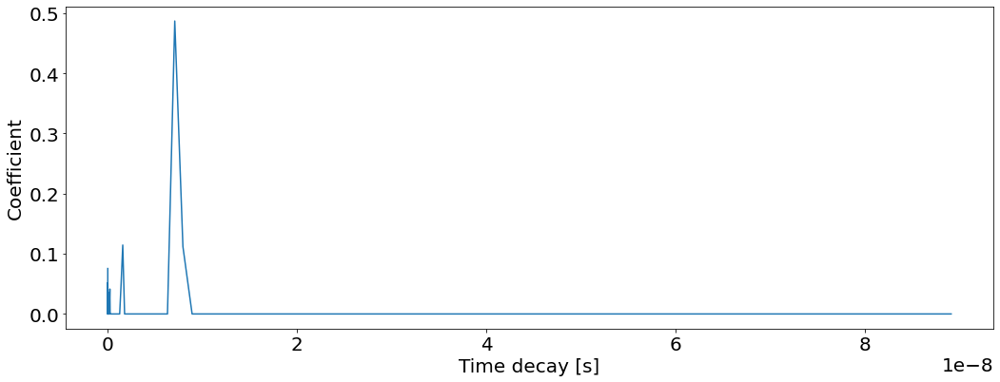

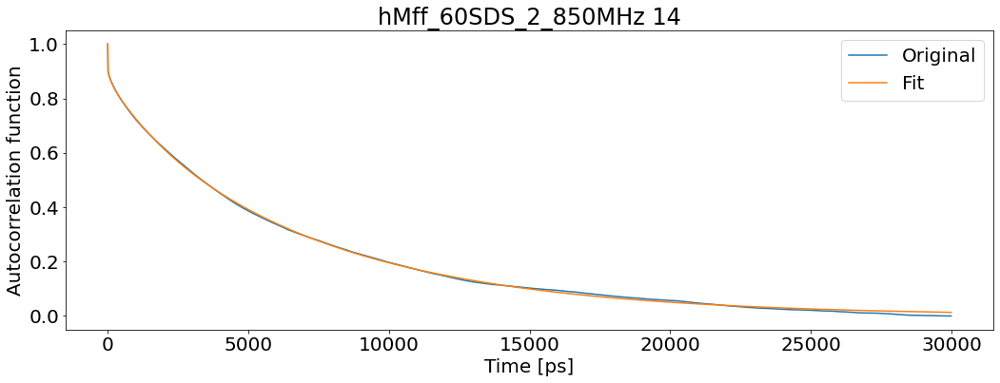

T1: 0.8340483964534248 T2: 0.0917181537580285 NOE: 0.7481033429361272


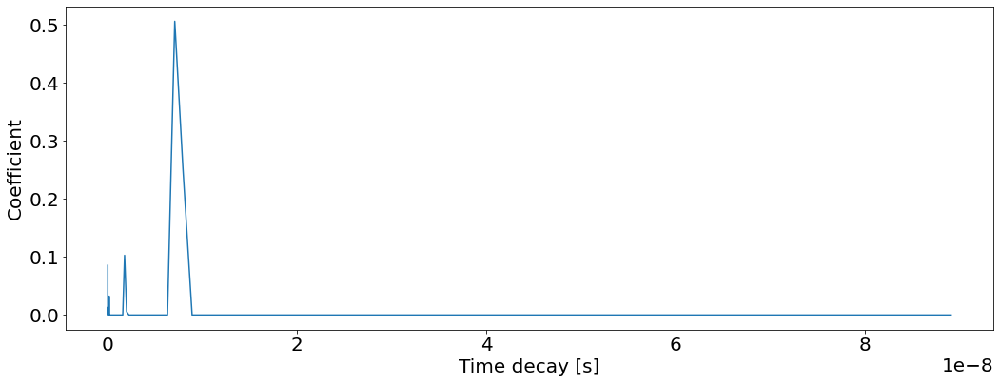

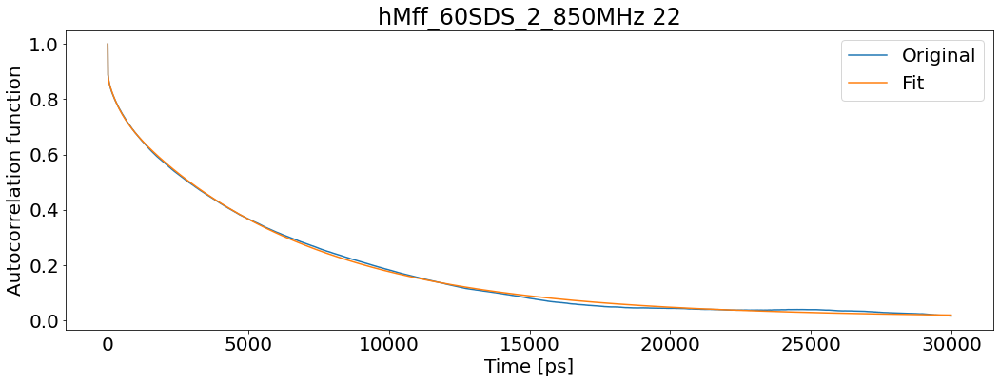

T1: 0.8758031747776404 T2: 0.08315672890256956 NOE: 0.6433131062037081


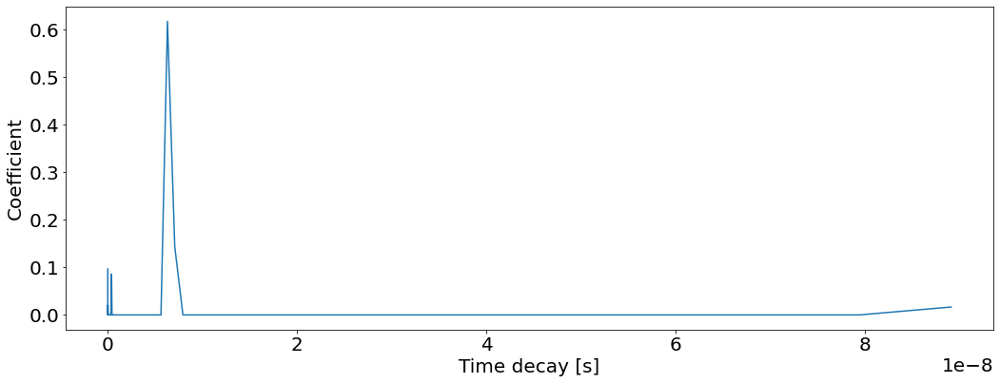

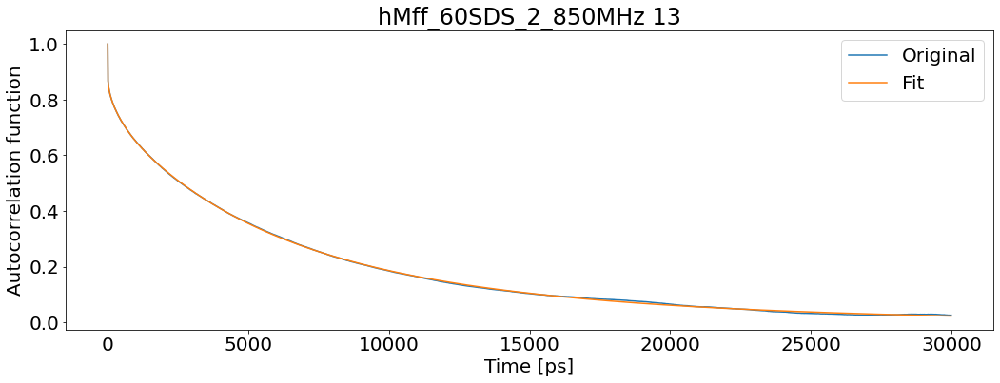

T1: 0.8915400384398335 T2: 0.09336629082090762 NOE: 0.6427836158638982


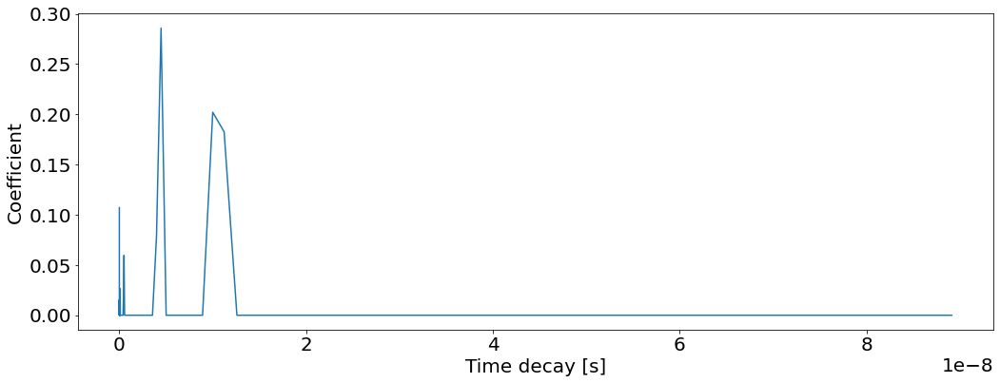

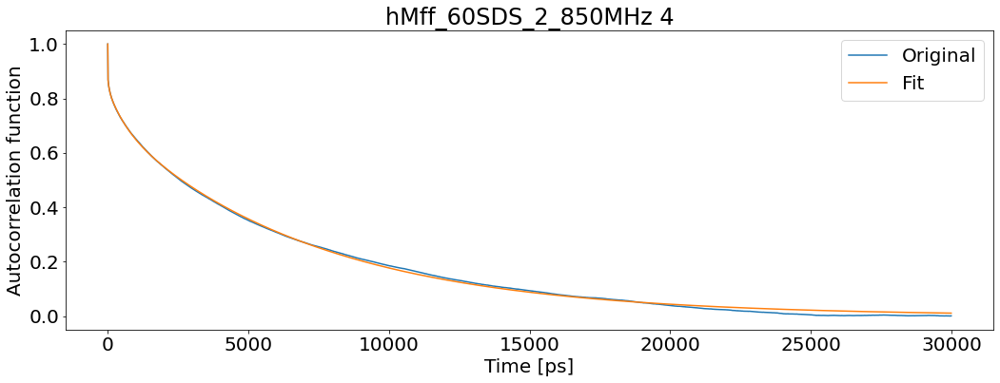

T1: 0.9199638962540173 T2: 0.10202333919928651 NOE: 0.6330591328296064


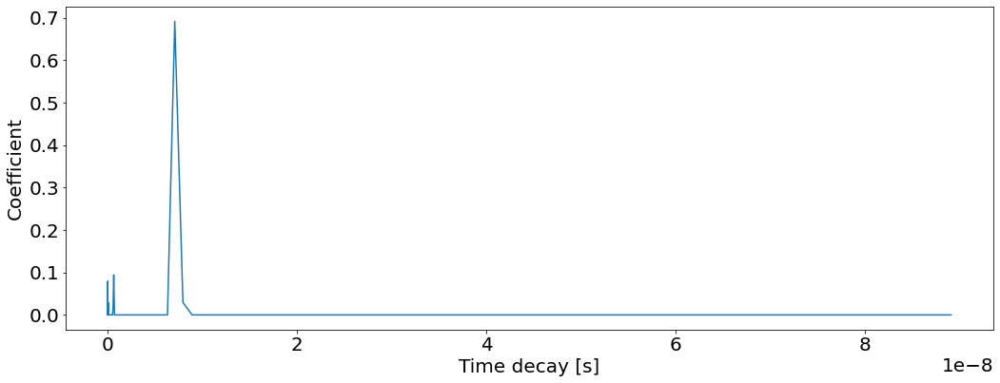

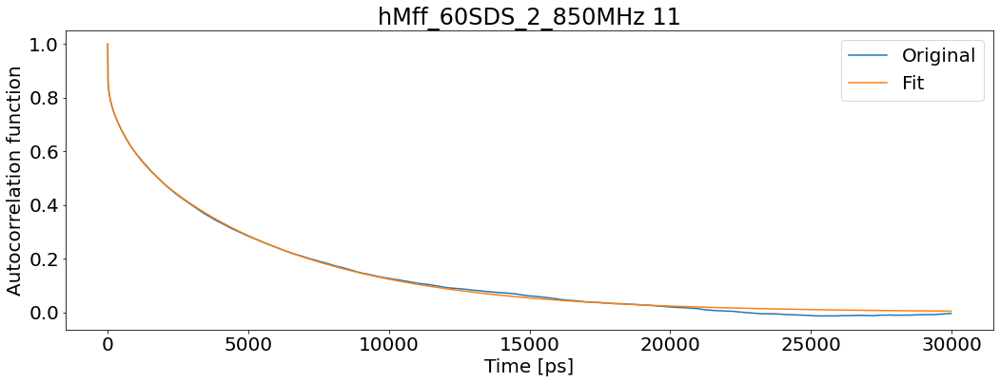

T1: 0.8179503472597777 T2: 0.1278272901392565 NOE: 0.6001873998215986


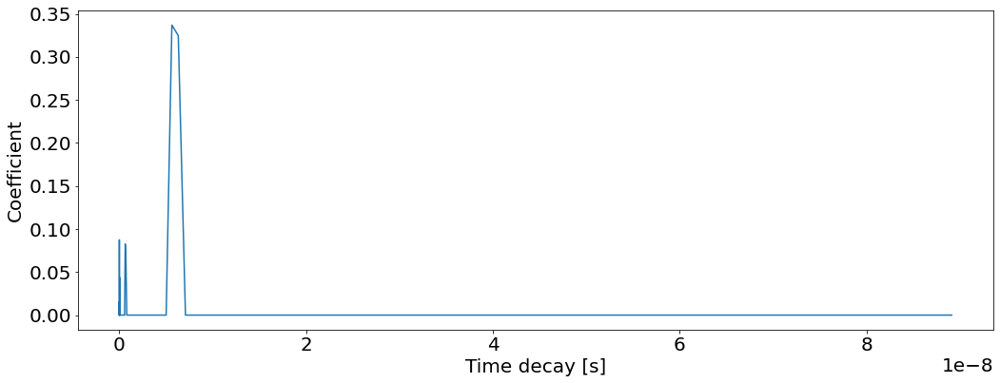

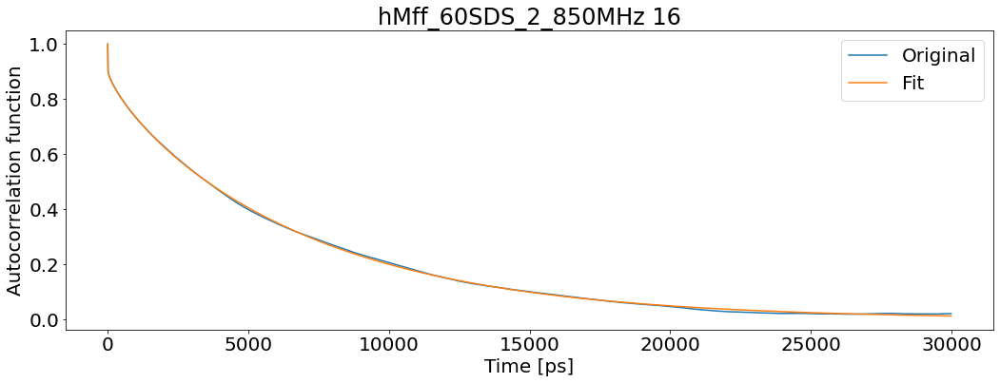

T1: 0.8711566643872817 T2: 0.09082691199586841 NOE: 0.7551882649826144


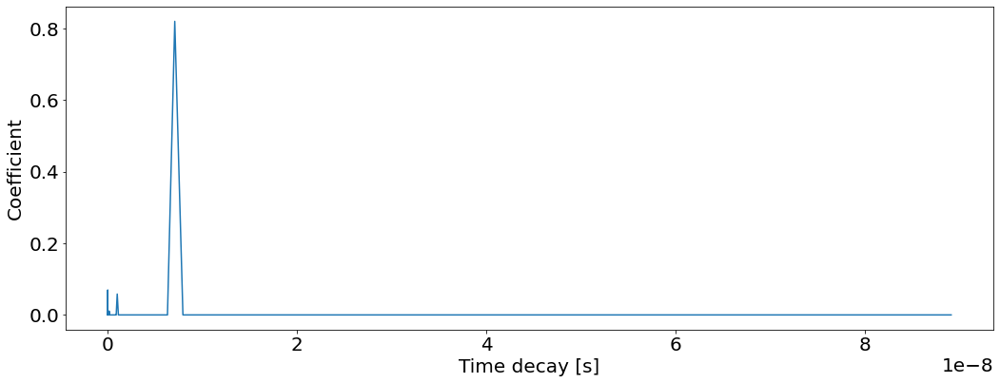

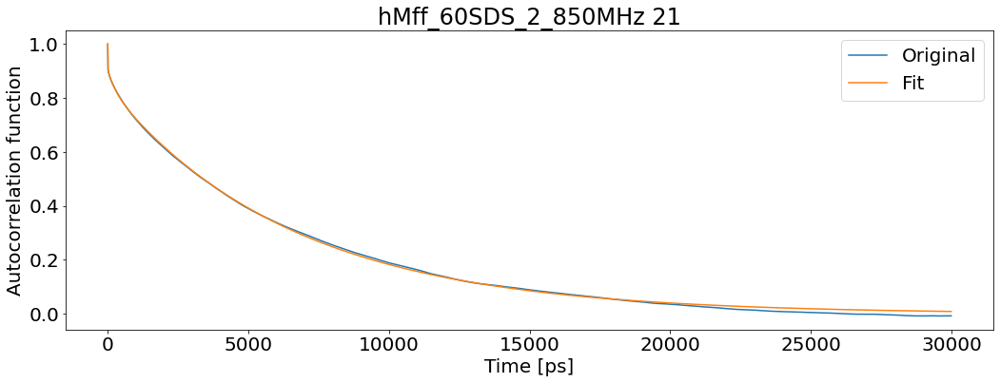

T1: 0.8559751576470894 T2: 0.09580985358349746 NOE: 0.702418908429811


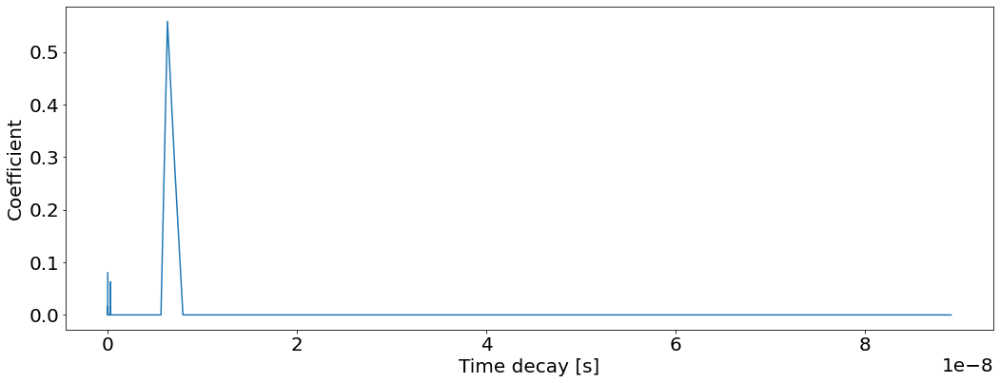

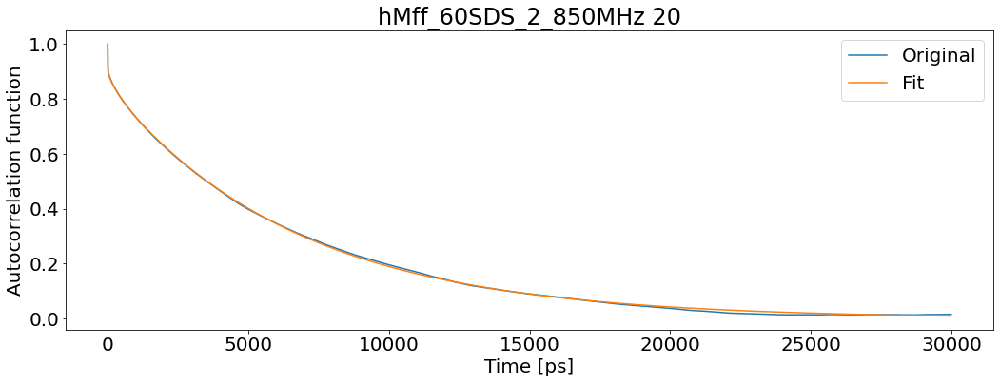

T1: 0.8681155284702516 T2: 0.09346568185028684 NOE: 0.7432127065817179


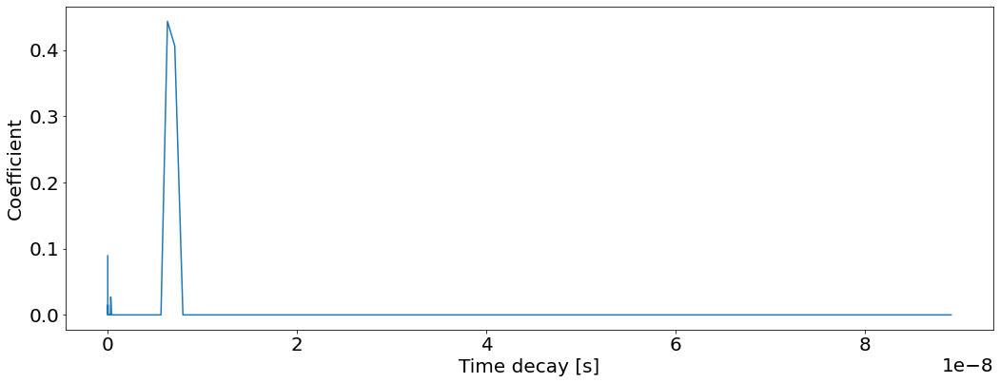

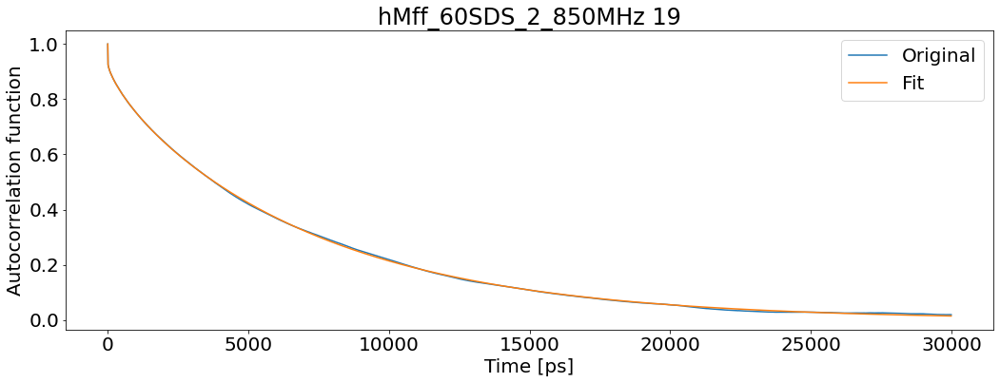

T1: 0.8736102949929344 T2: 0.0858156183214782 NOE: 0.745574875392994


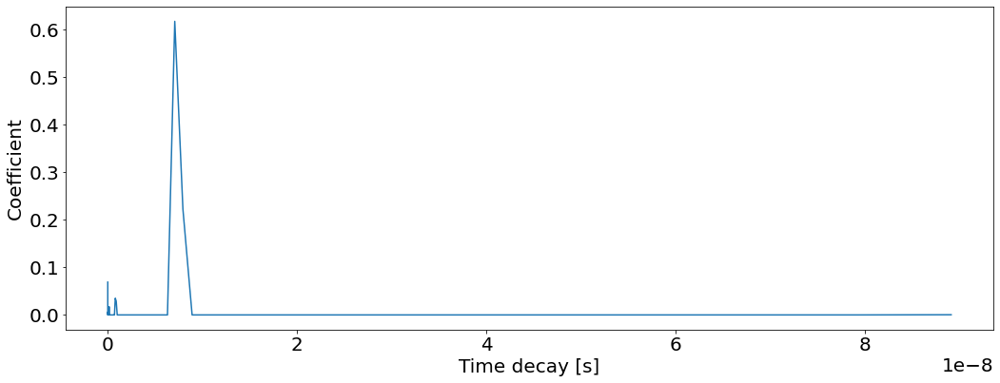

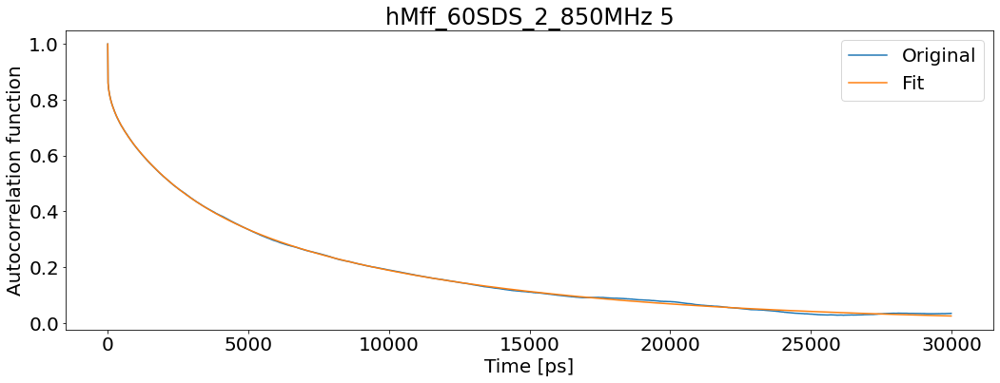

T1: 0.8378557153656778 T2: 0.09336129199463541 NOE: 0.6377310216534406


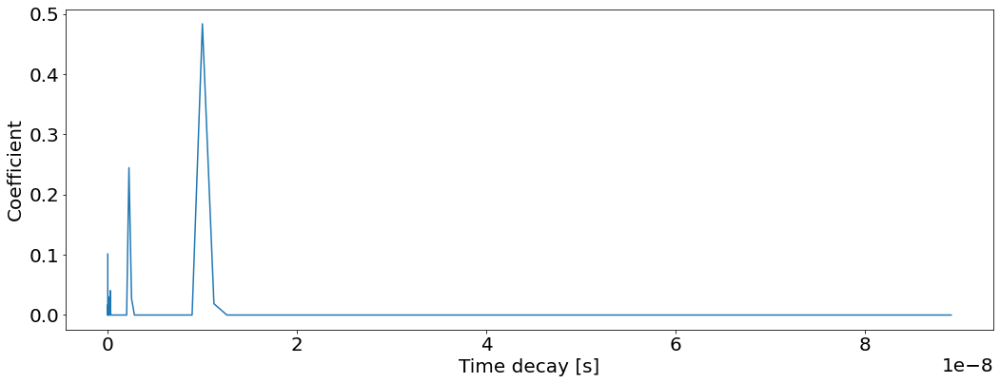

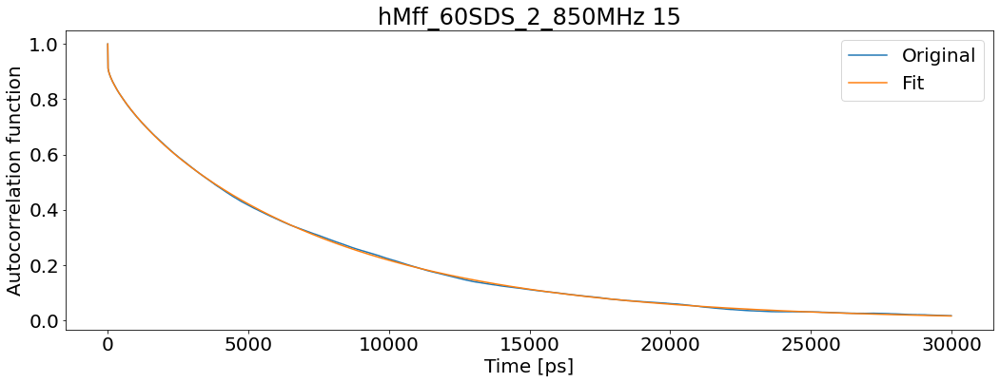

T1: 0.8942530681244143 T2: 0.0856407553557016 NOE: 0.7427076577389443


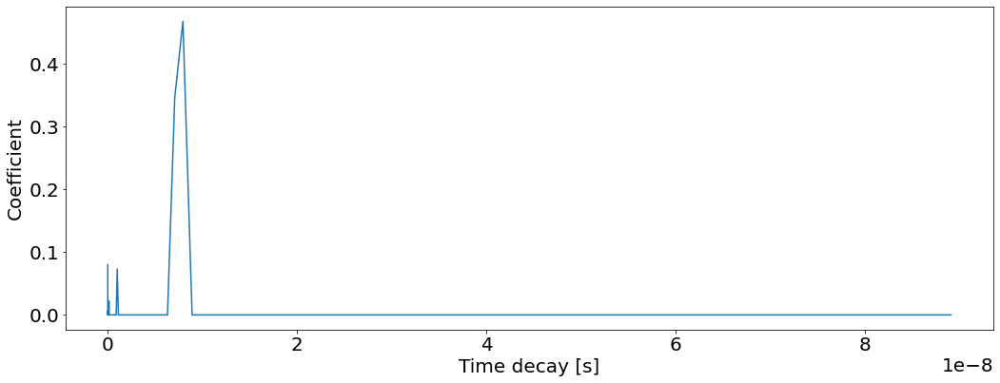

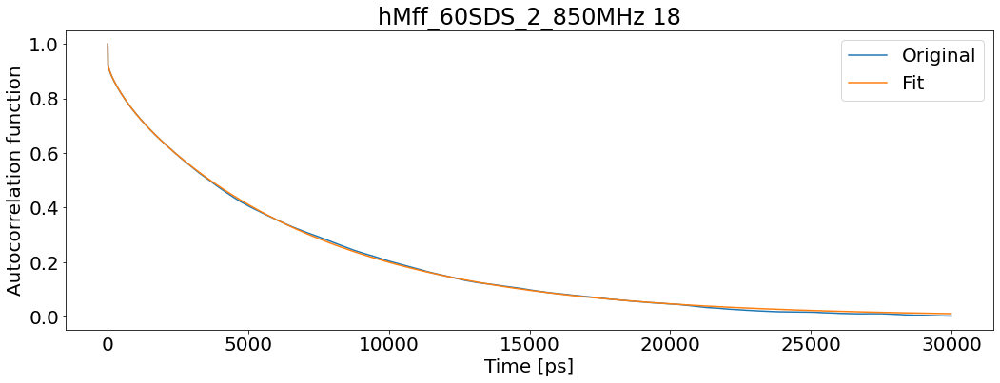

T1: 0.85567557569132 T2: 0.09023963181253743 NOE: 0.7368298019351669


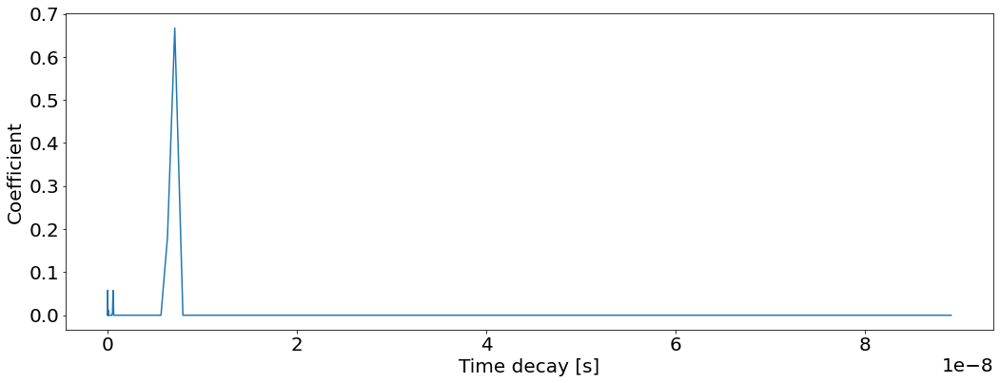

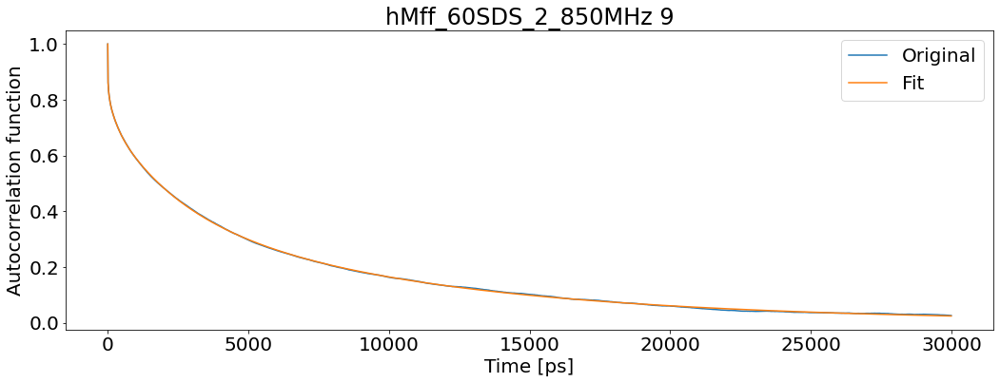

T1: 0.8084853451246281 T2: 0.09752062029844938 NOE: 0.5713492079409337


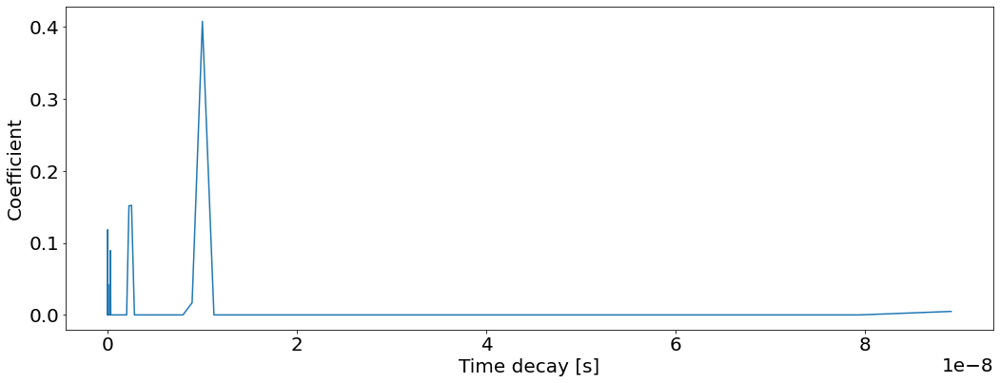

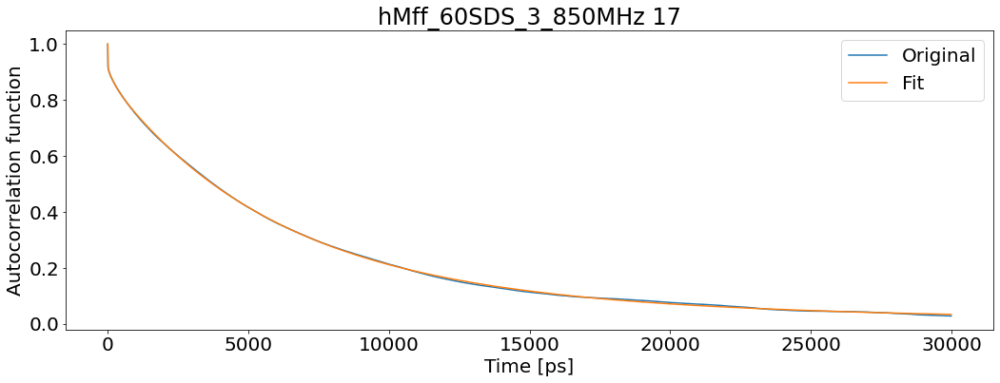

T1: 0.8513034846333043 T2: 0.07654572875605742 NOE: 0.7517774205585289


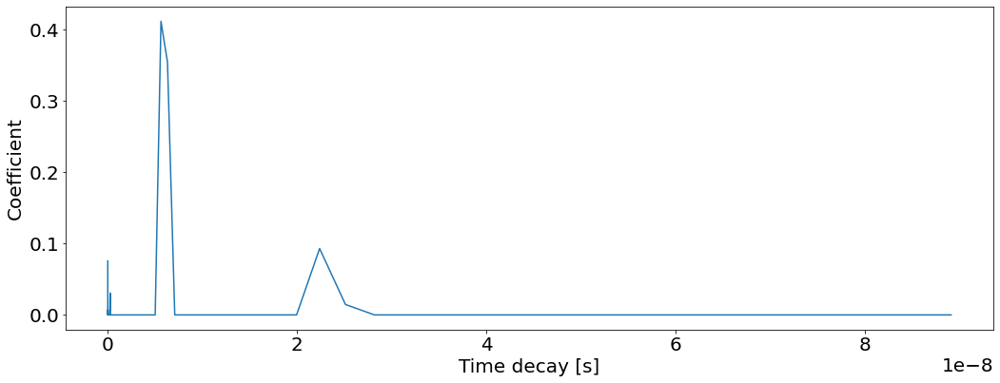

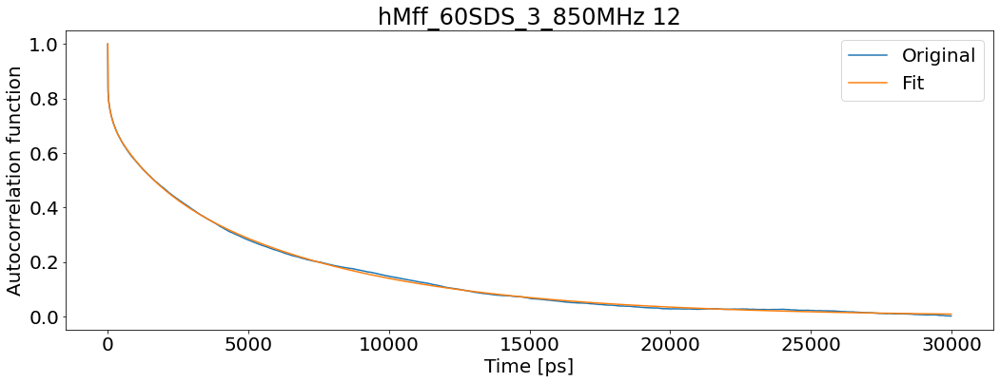

T1: 0.8716544492688271 T2: 0.12195672015593073 NOE: 0.5677074120101726


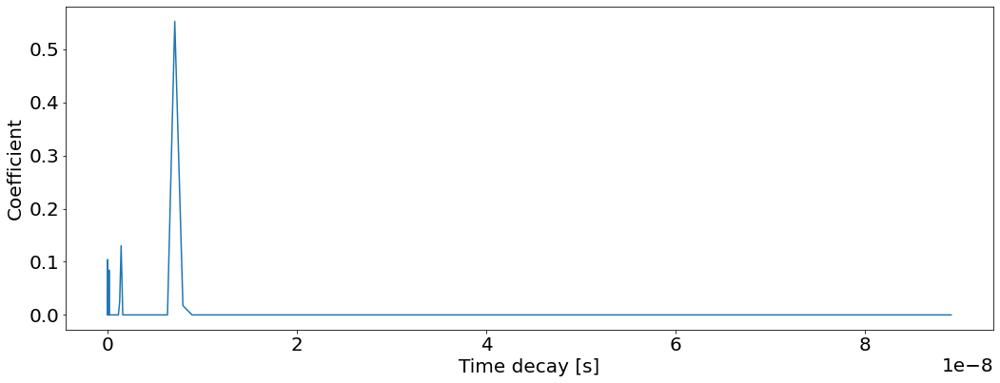

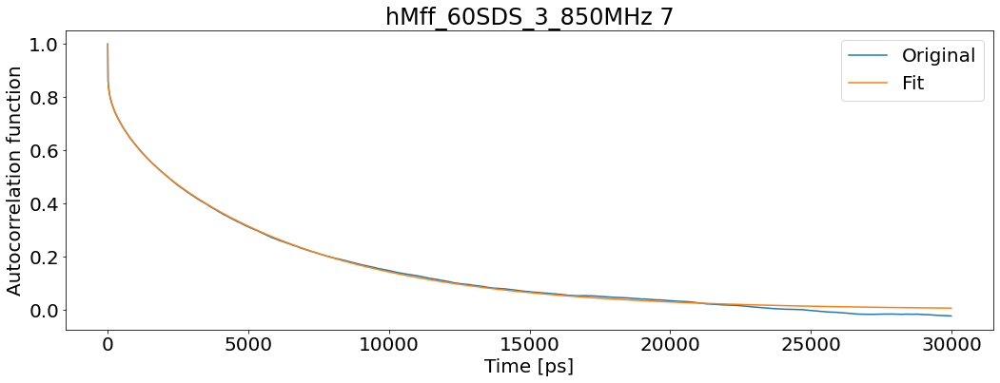

T1: 0.858202636840671 T2: 0.11732405750487293 NOE: 0.6261870276313655


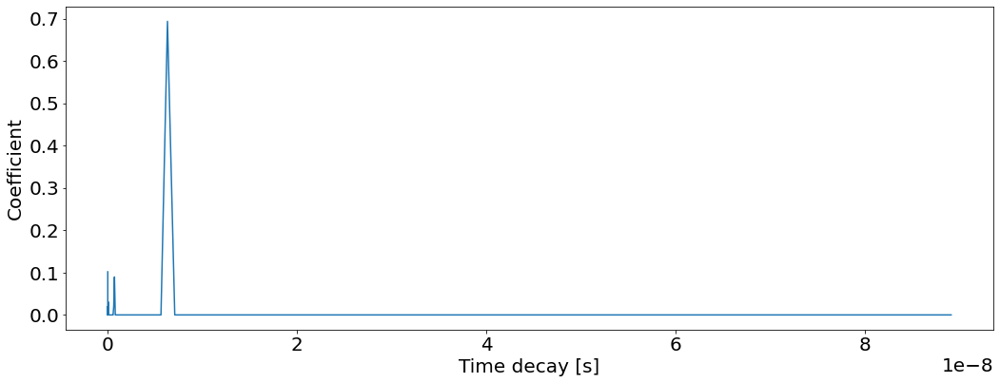

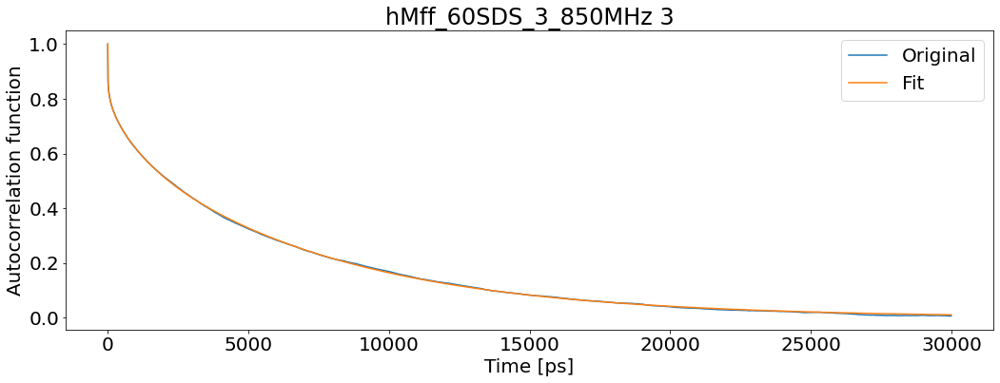

T1: 0.8886351127981174 T2: 0.10811129775079165 NOE: 0.6043359872070458


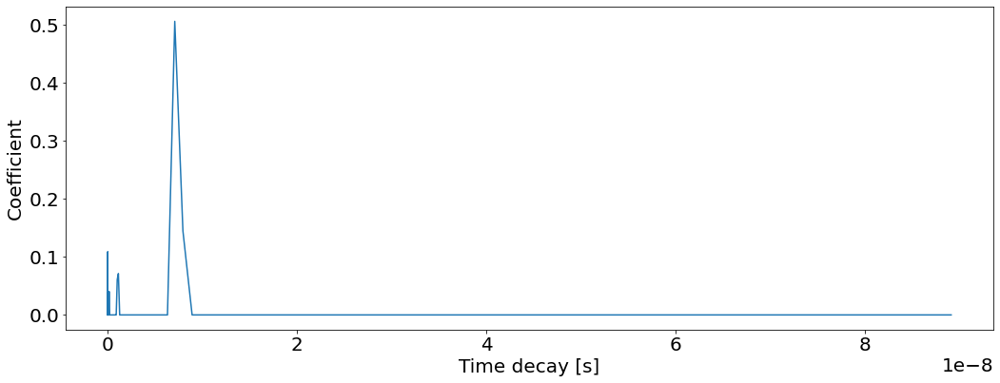

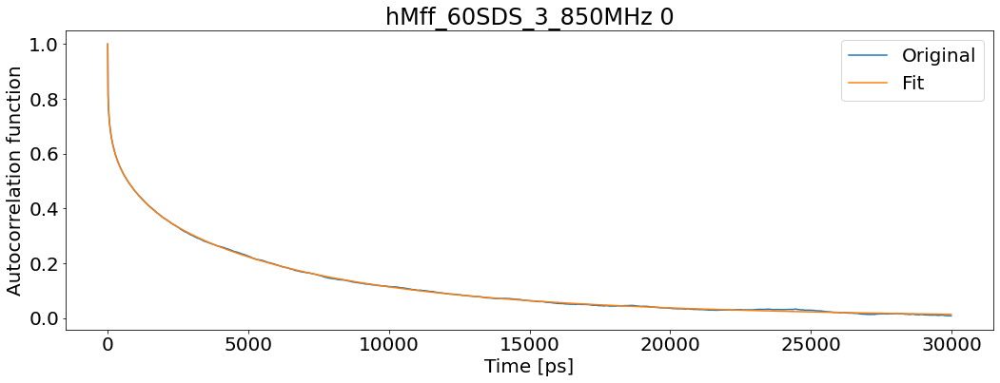

T1: 0.920838331524471 T2: 0.14008119356395898 NOE: 0.34066080263116516


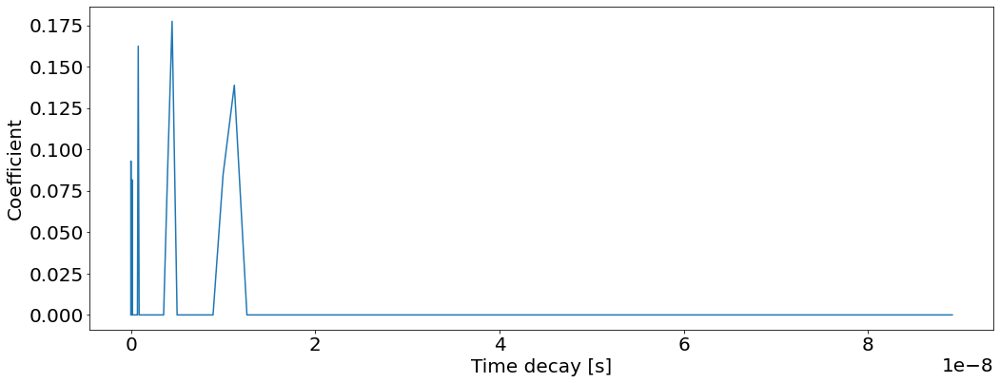

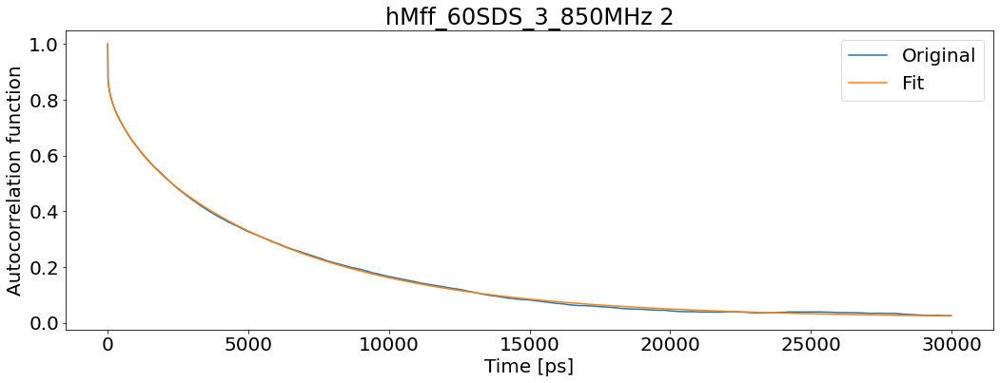

T1: 0.8435828819290286 T2: 0.08087182088267111 NOE: 0.642513259397991


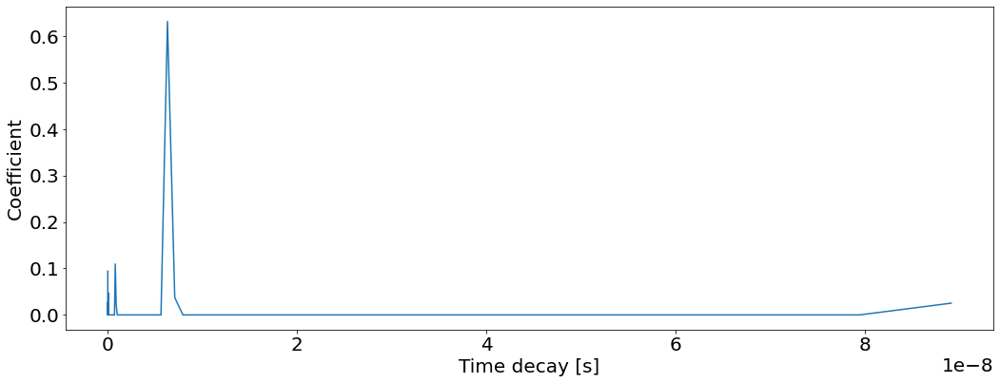

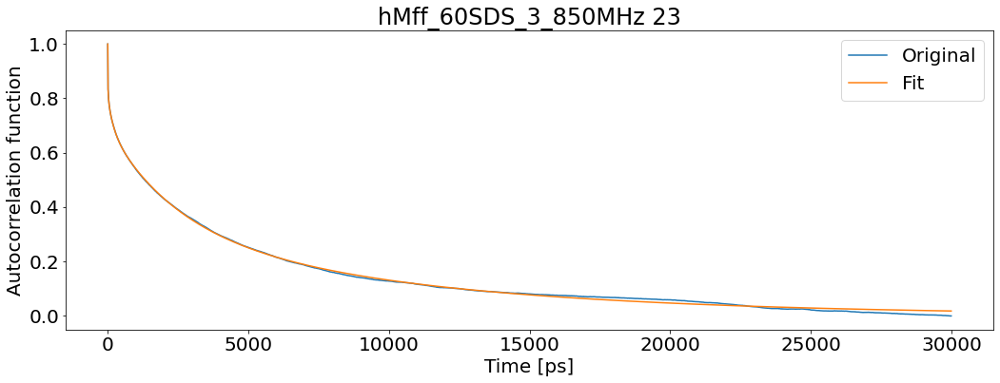

T1: 0.7828682996770239 T2: 0.1214328873143945 NOE: 0.535431883053237


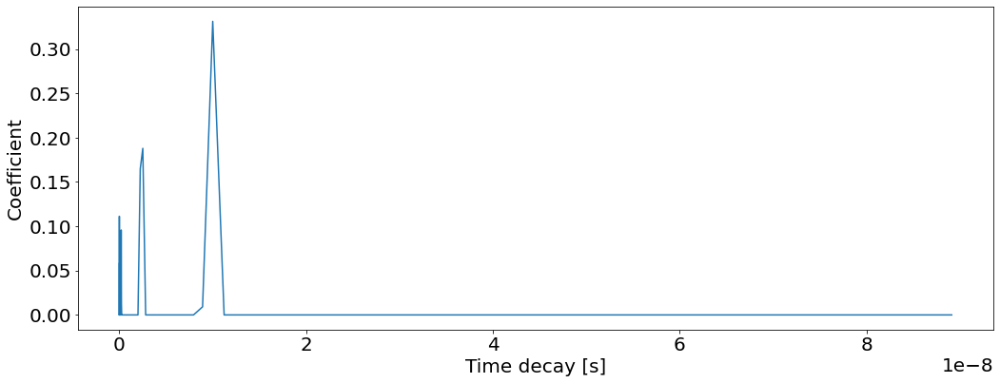

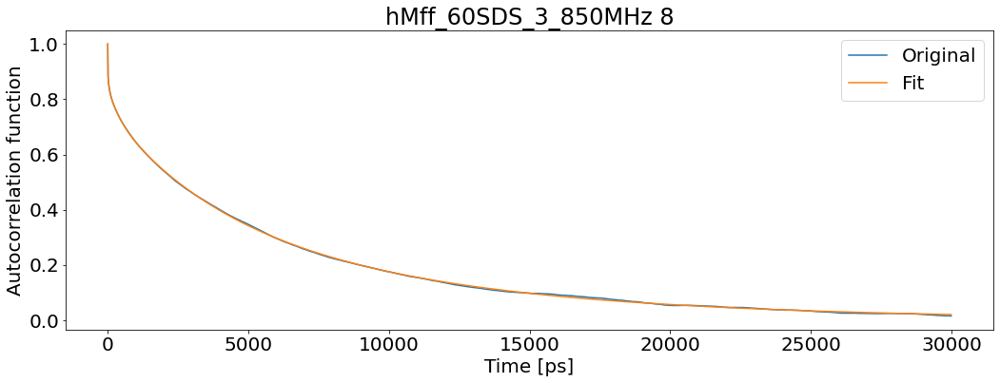

T1: 0.8514646281000094 T2: 0.09743536691005583 NOE: 0.6198573427758315


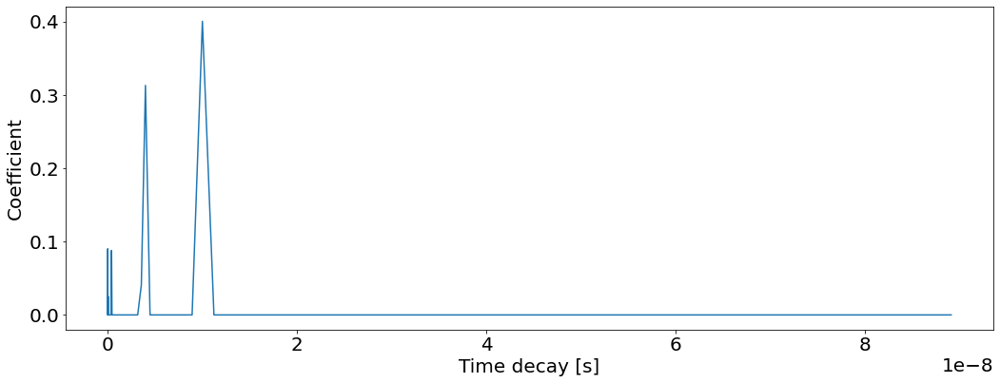

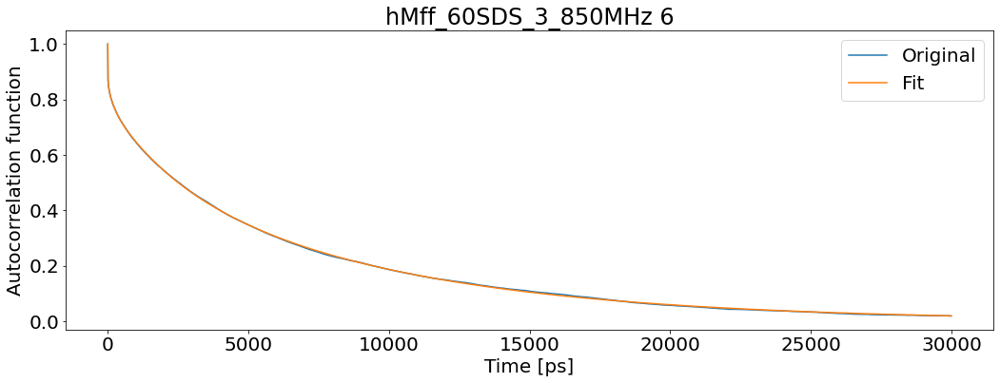

T1: 0.8562513691303402 T2: 0.09580063381641774 NOE: 0.6403245799106074


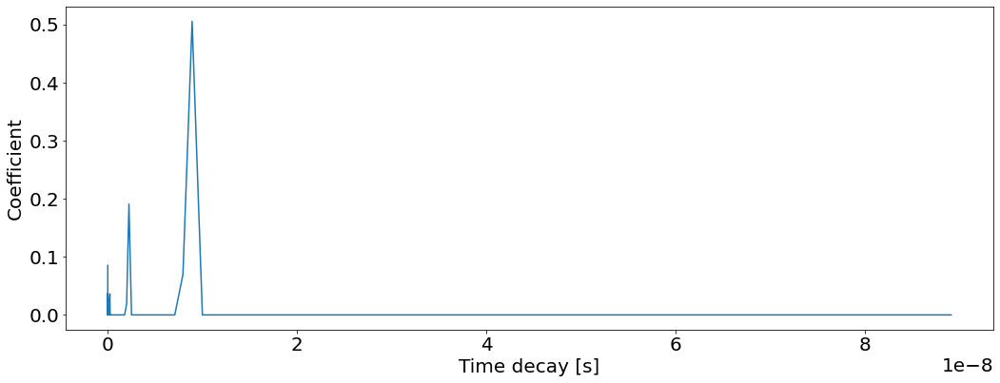

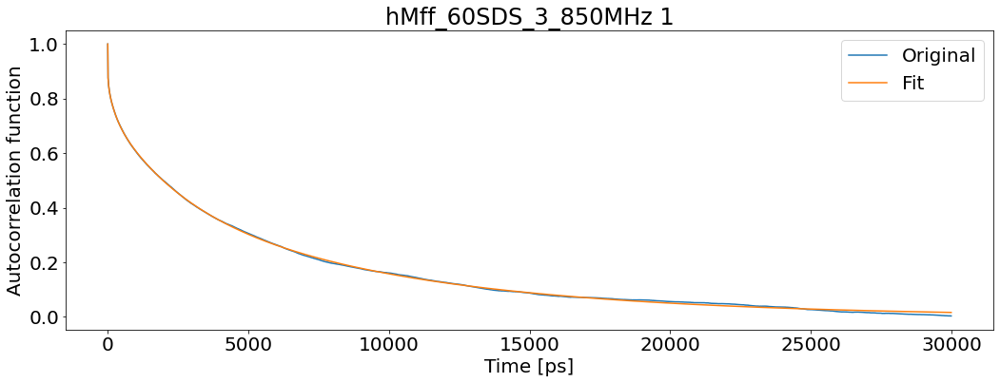

T1: 0.787463155101343 T2: 0.10668104494813217 NOE: 0.5744651413920507


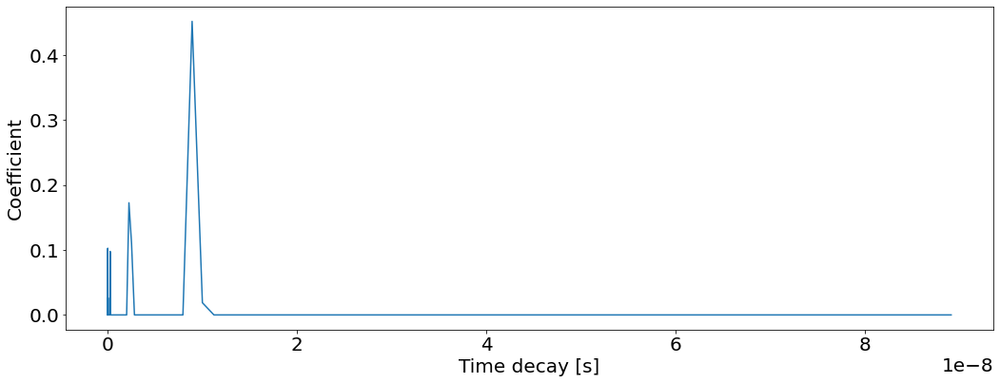

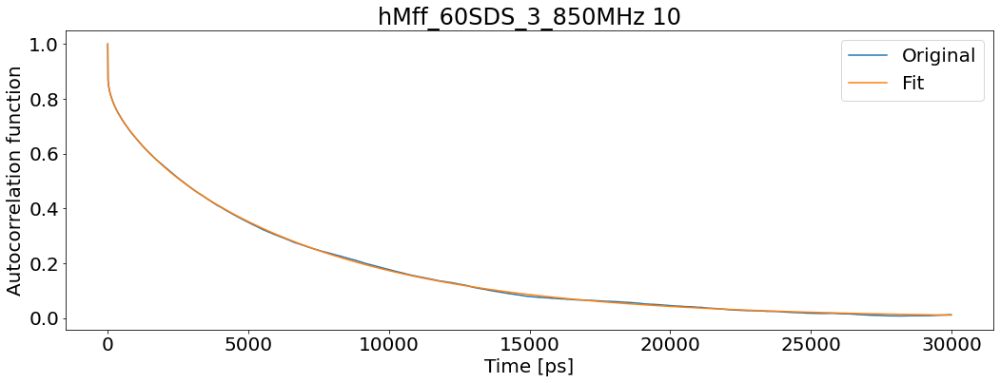

T1: 0.8810811357388889 T2: 0.10287485167666242 NOE: 0.6556092243074214


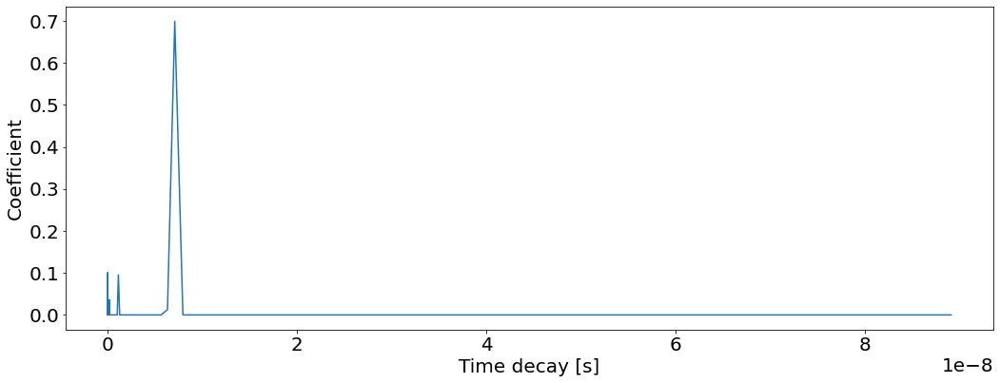

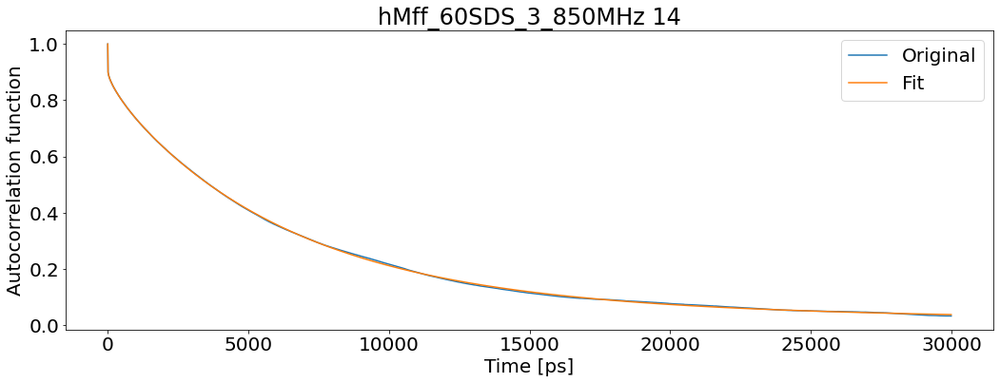

T1: 0.8789779217037021 T2: 0.07318071967911983 NOE: 0.7575086820997271


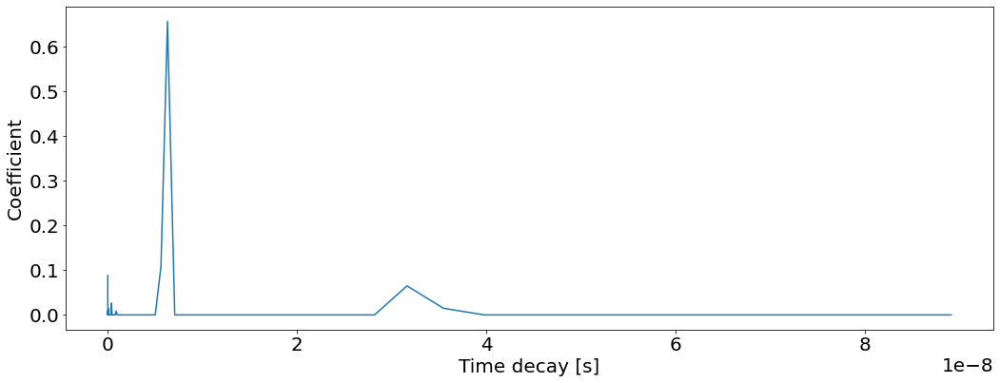

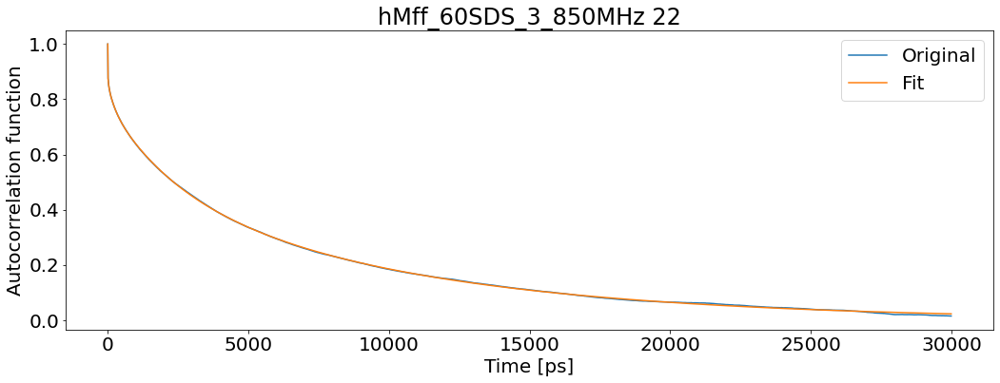

T1: 0.8205550523812051 T2: 0.09469946778269614 NOE: 0.6228404933614398


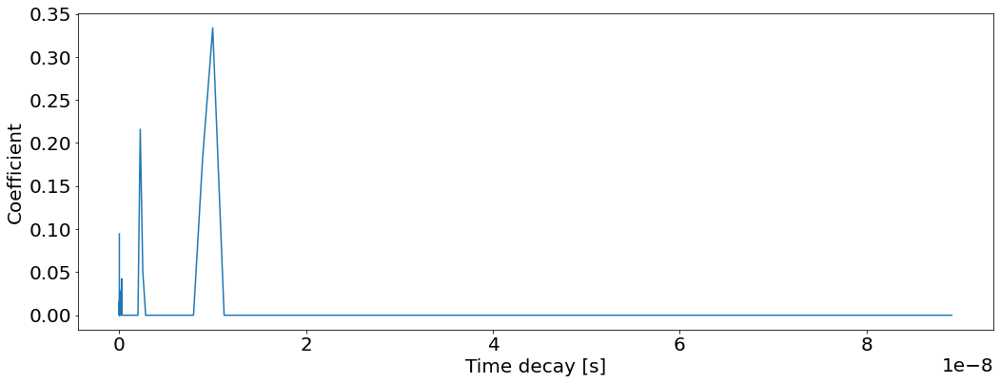

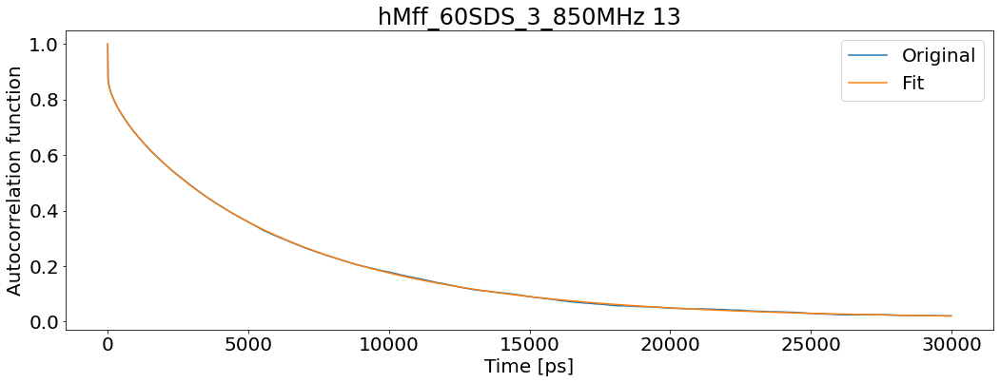

T1: 0.8537303454695149 T2: 0.08282656858793379 NOE: 0.6949638984366943


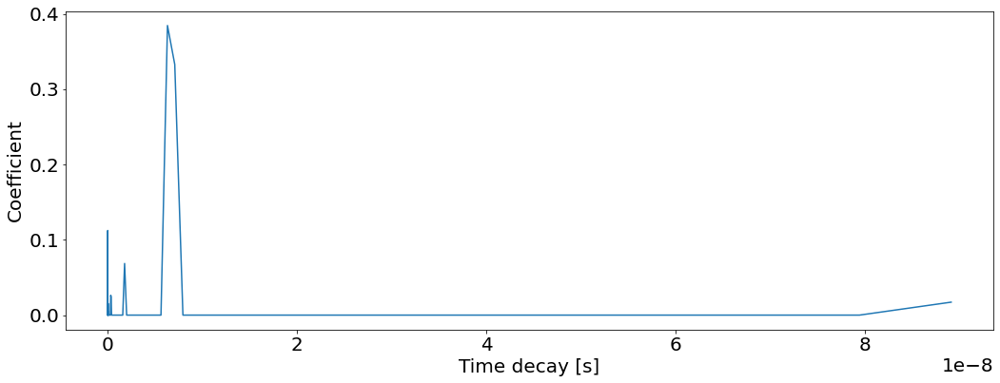

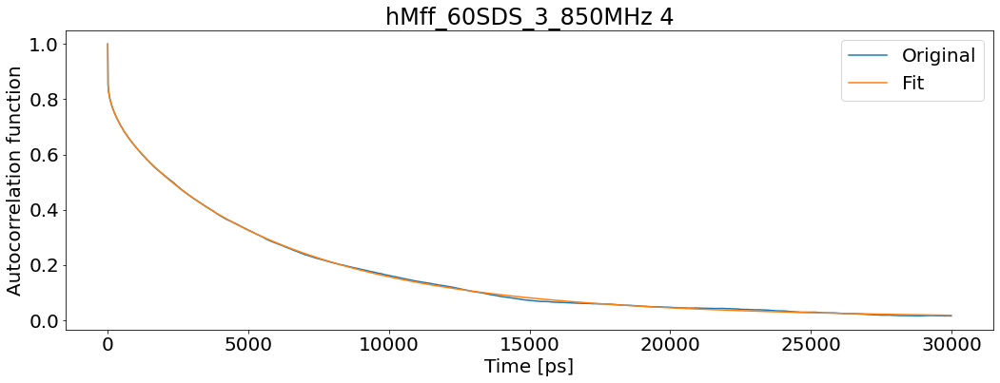

T1: 0.8680212472037817 T2: 0.10298649477741281 NOE: 0.6289148864818216


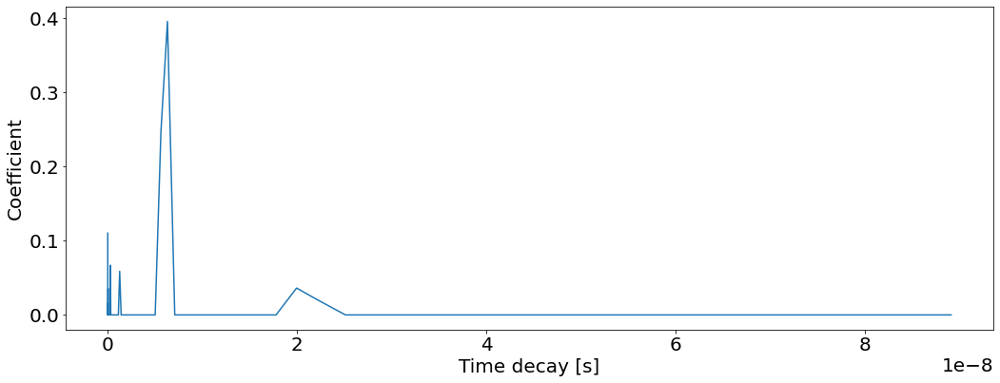

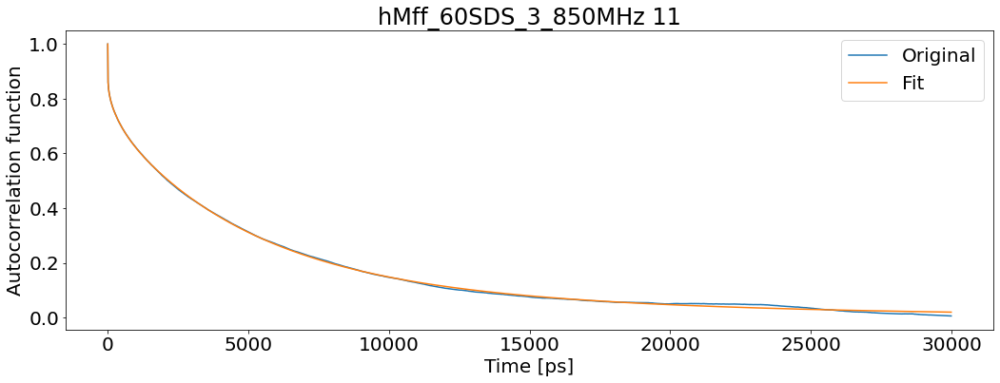

T1: 0.8267342967791395 T2: 0.10477958603207012 NOE: 0.6310205842586959


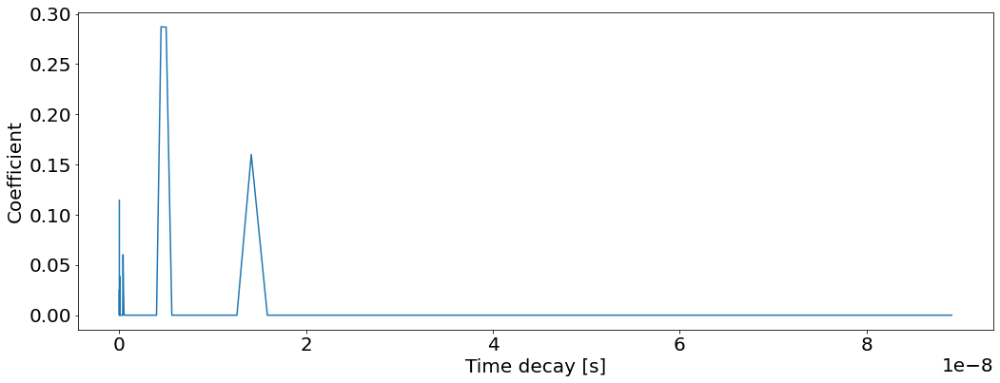

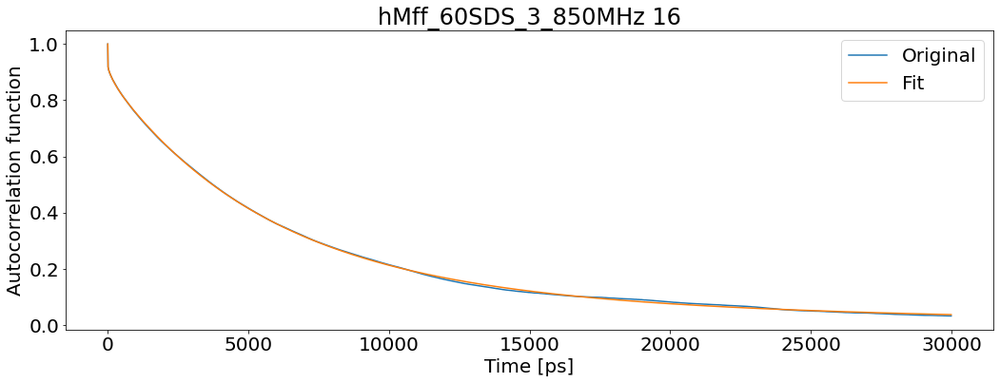

T1: 0.8342020467913617 T2: 0.07583929416337648 NOE: 0.7671164805342074


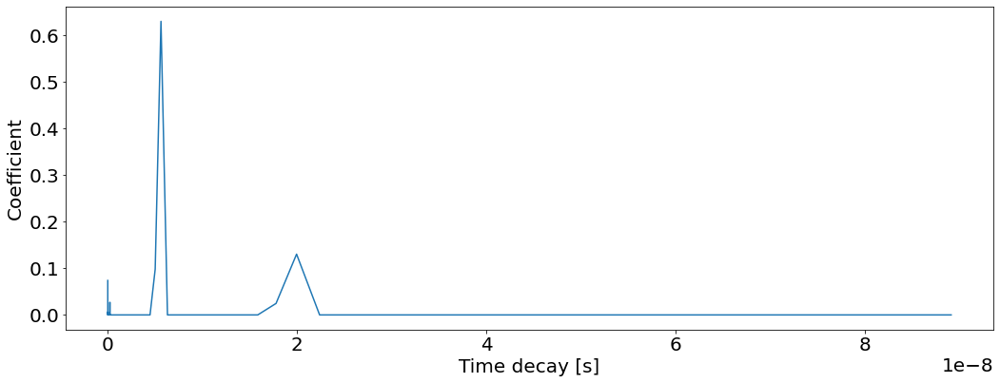

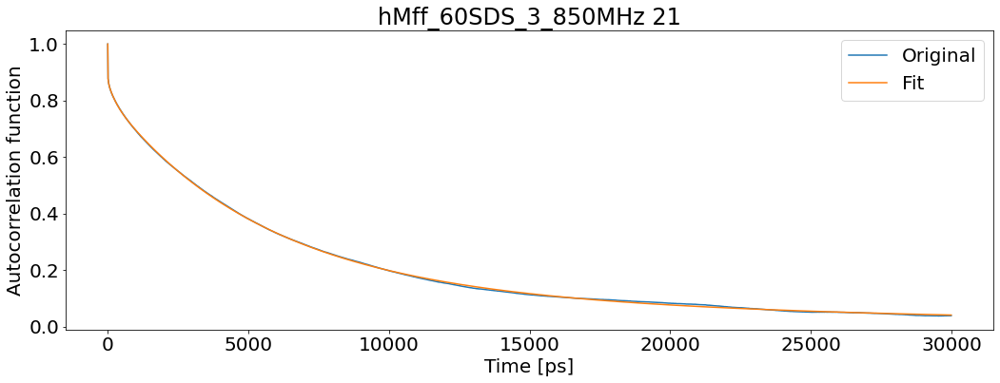

T1: 0.8744815582618672 T2: 0.07821864115095548 NOE: 0.7045539270036213


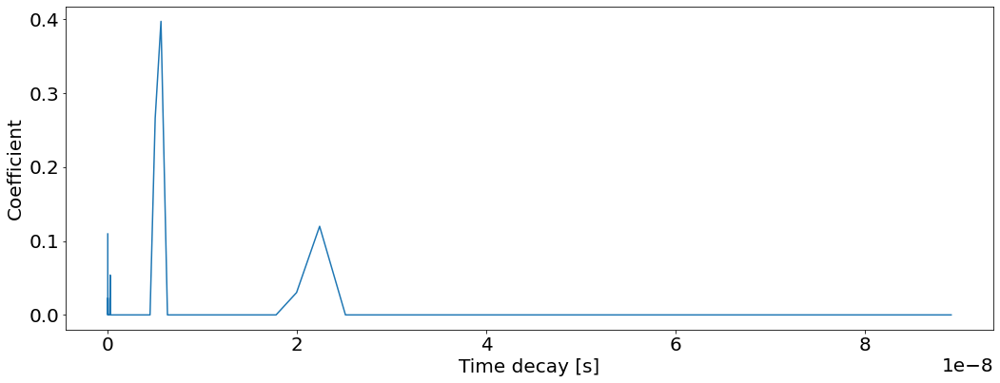

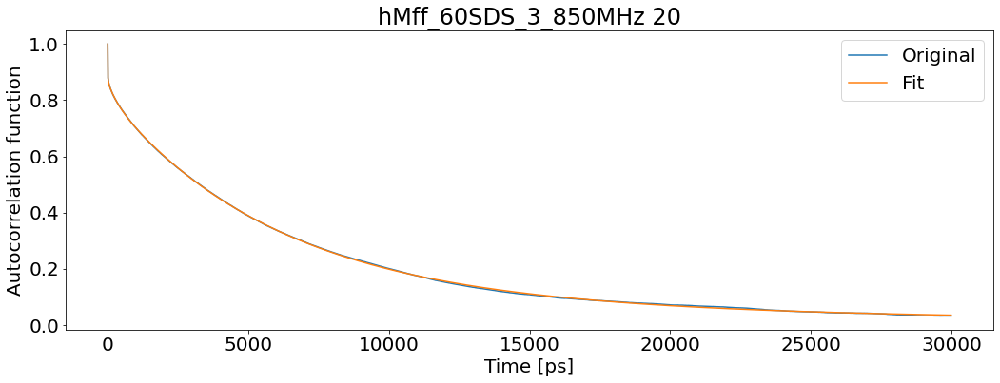

T1: 0.8943962779888257 T2: 0.07872366182305424 NOE: 0.7173033502717461


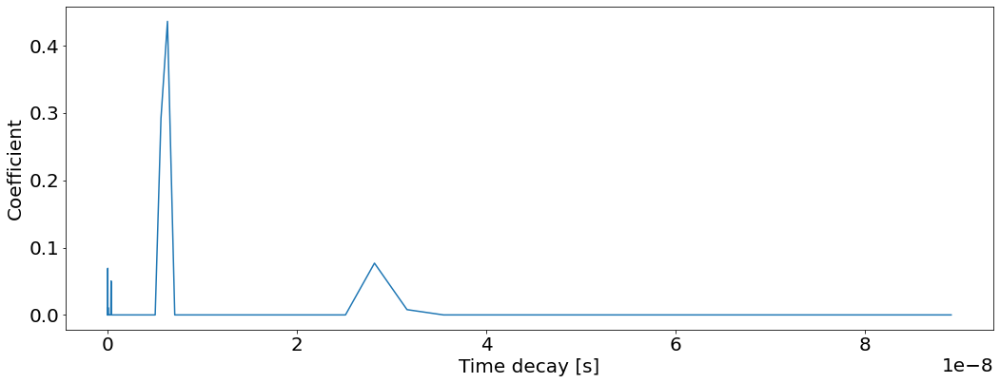

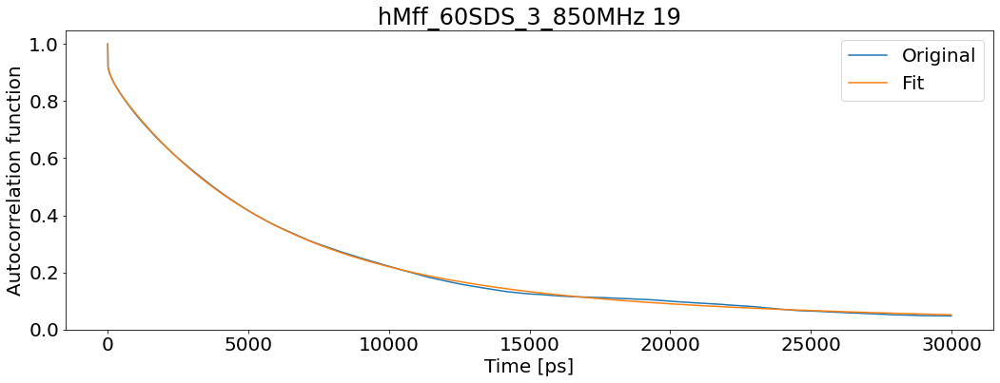

T1: 0.827707967817128 T2: 0.06801708339476878 NOE: 0.7715688509855126


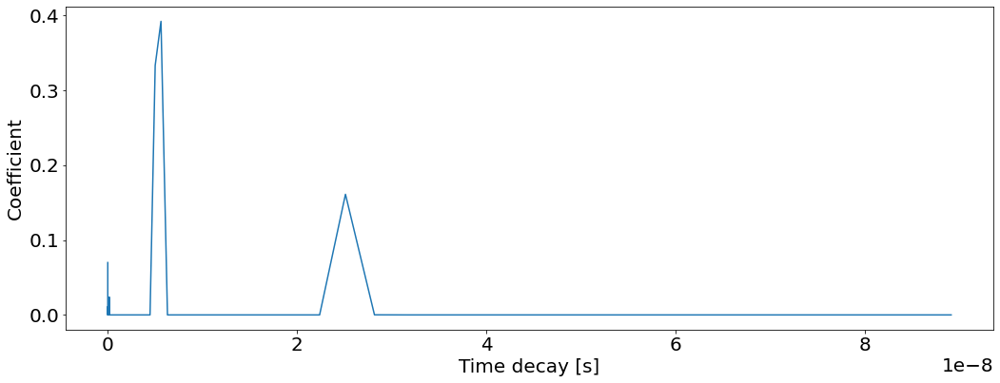

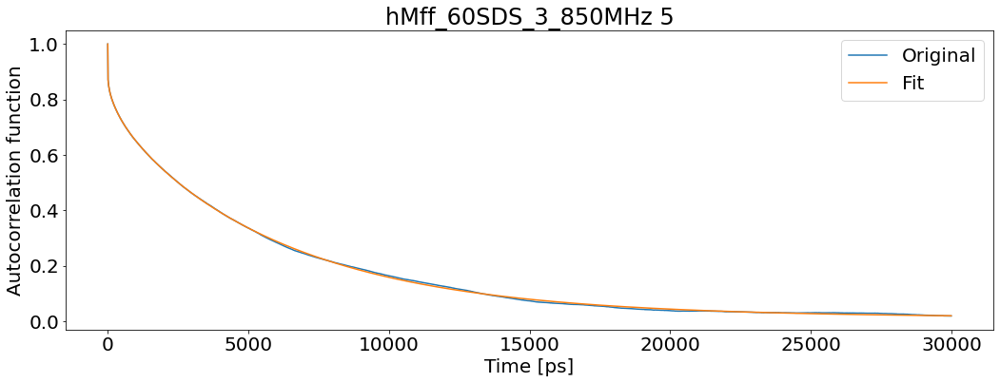

T1: 0.8436412996153457 T2: 0.08522347378441915 NOE: 0.6506293124723334


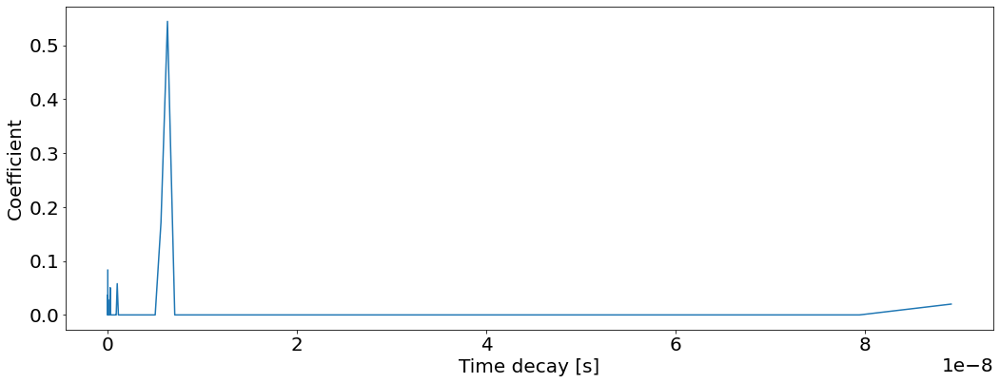

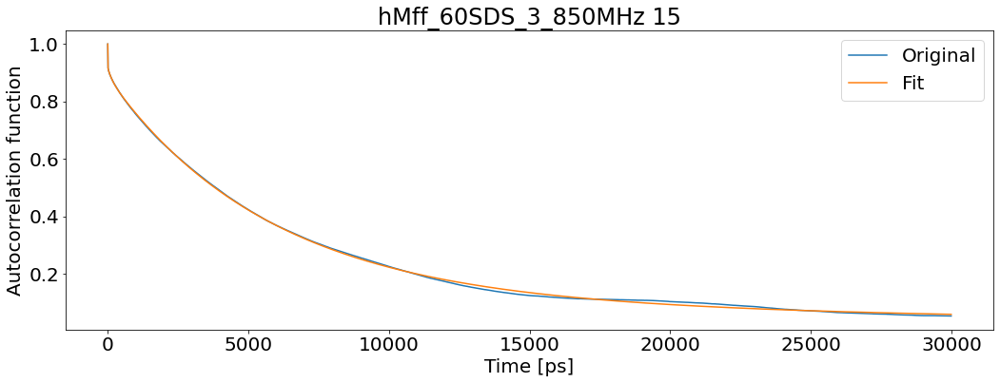

T1: 0.8477027952417464 T2: 0.05890865957548735 NOE: 0.7736912820801873


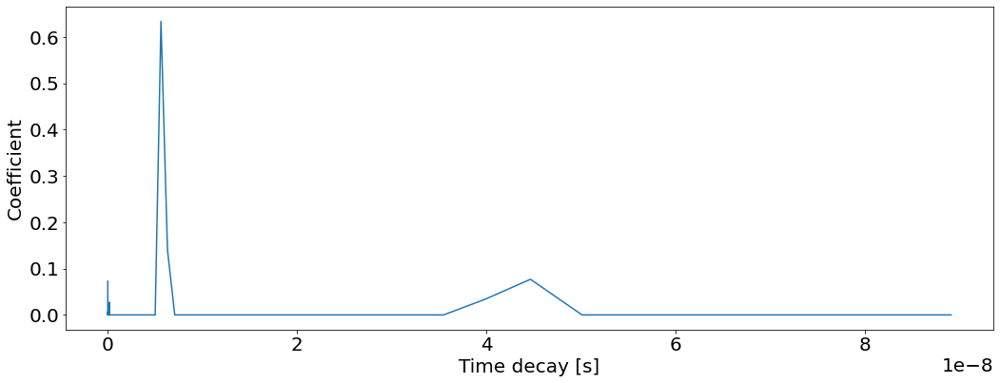

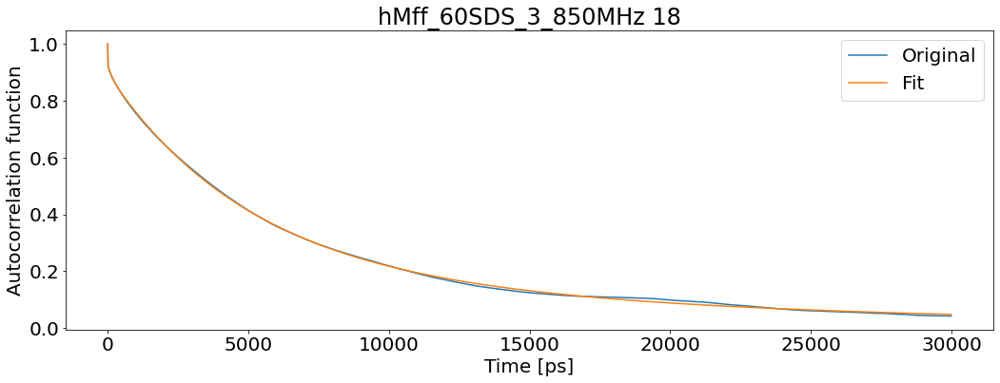

T1: 0.8057000126641883 T2: 0.07101872130252111 NOE: 0.7779159397960657


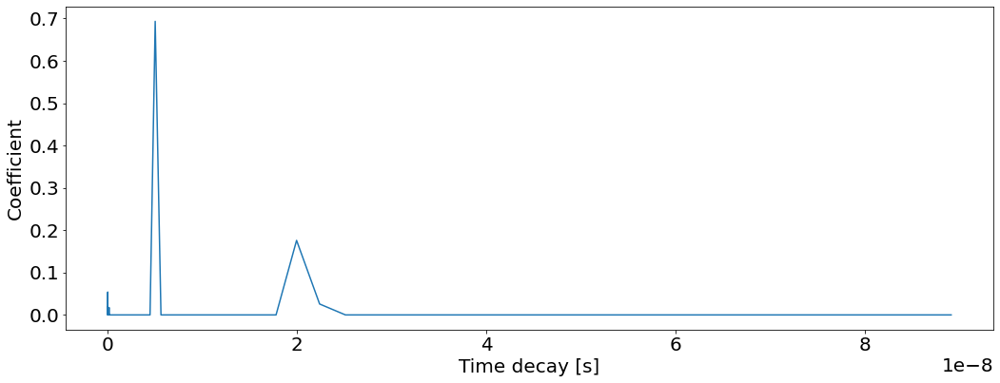

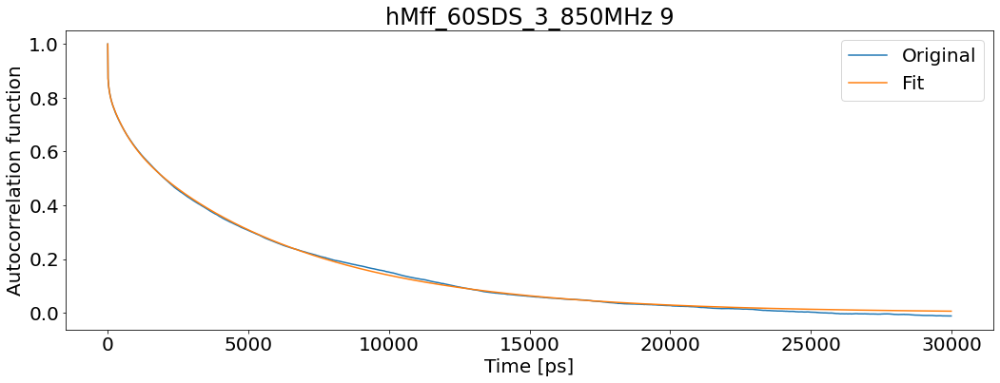

T1: 0.8408179375214003 T2: 0.11874555073466021 NOE: 0.6030346778434107


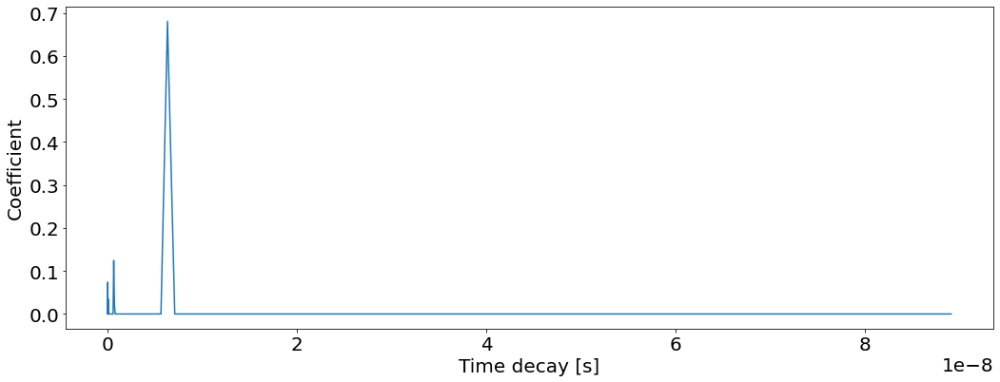

In [148]:
magn_field_MHz=850 # for values in MHz
magnetic_field=magn_field_MHz*2*np.pi/gammaH*10**6
aminoAcids_850=[]
for sds in all_systems:
    for replica in all_systems[sds]:
        folder_path=all_systems[sds][replica]
        output_name="hMff_"+sds+"_"+replica+"_"+str(magn_field_MHz)+"MHz"
        yaml_output=output_path+output_name+".yaml"
        
        aminoAcids_850.append(rt.analyze_all_in_folder(OP,smallest_corr_time, biggest_corr_time, N_exp_to_fit,analyze,magnetic_field,folder_path,nuclei,output_name))
        #rt.plot_T1_T2_noe(aminoAcids,yaml_output)

In [149]:
aminoAcids_850

[{8: <relaxation_times.GetRelaxationData at 0x7fdced019a50>,
  19: <relaxation_times.GetRelaxationData at 0x7fdce16caef0>,
  3: <relaxation_times.GetRelaxationData at 0x7fdcedb72440>,
  5: <relaxation_times.GetRelaxationData at 0x7fdced057eb0>,
  20: <relaxation_times.GetRelaxationData at 0x7fdce48b5600>,
  1: <relaxation_times.GetRelaxationData at 0x7fdce48b6860>,
  4: <relaxation_times.GetRelaxationData at 0x7fdced054790>,
  16: <relaxation_times.GetRelaxationData at 0x7fdced03b730>,
  10: <relaxation_times.GetRelaxationData at 0x7fdce19aa140>,
  17: <relaxation_times.GetRelaxationData at 0x7fdced0543d0>,
  13: <relaxation_times.GetRelaxationData at 0x7fdce19a8c70>,
  18: <relaxation_times.GetRelaxationData at 0x7fdce19aa770>,
  9: <relaxation_times.GetRelaxationData at 0x7fdce1c9f0a0>,
  0: <relaxation_times.GetRelaxationData at 0x7fdce258e7d0>,
  21: <relaxation_times.GetRelaxationData at 0x7fdce258f1f0>,
  23: <relaxation_times.GetRelaxationData at 0x7fdced3e4580>,
  12: <relaxati

<h4>3.3) Perform the calculations </h4>

In [126]:
"""Analyze individual correlation function - in case of lipids etc..."""
#input_corr_file="alphaCF.xvg"
#AA=rt.GetRelaxationData(OP,smallest_corr_time, biggest_corr_time, N_exp_to_fit,analyze,magnetic_field,input_corr_file,nuclei,output_name)

'Analyze individual correlation function - in case of lipids etc...'

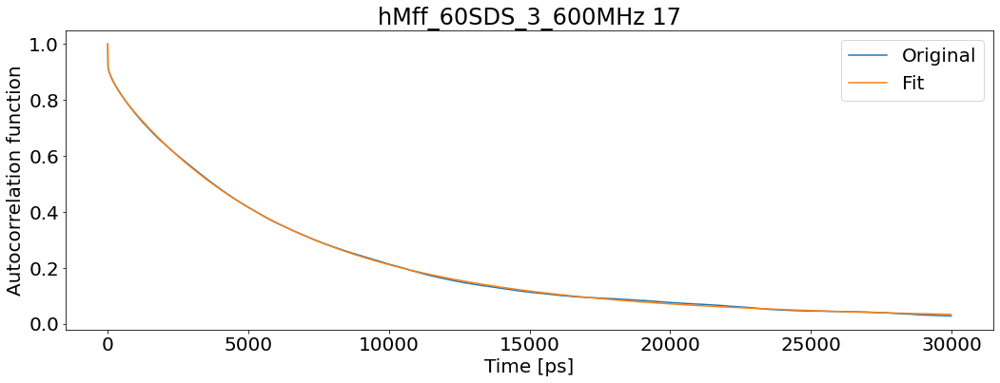

T1: 0.570808725761009 T2: 0.09084437427957838 NOE: 0.710355701500281


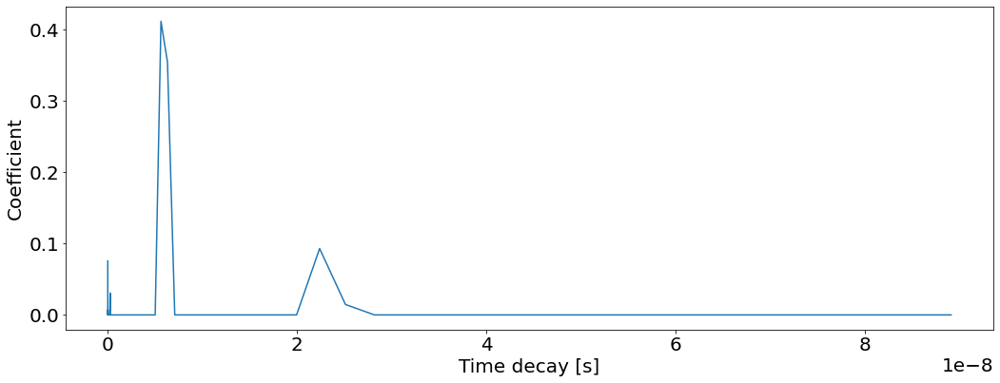

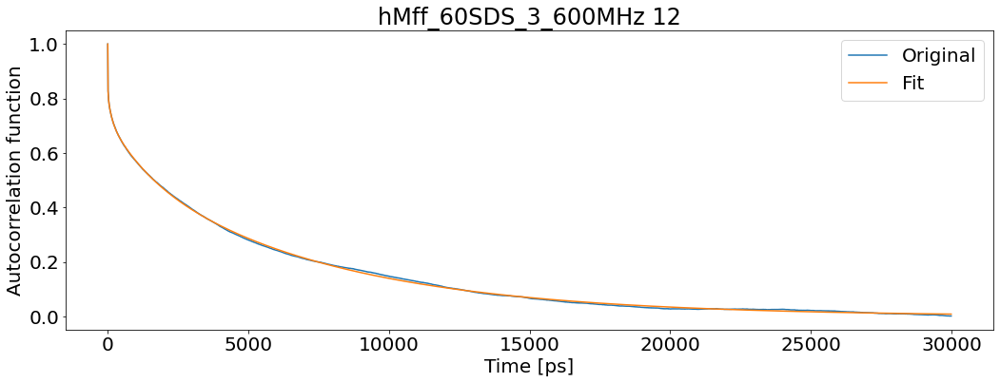

T1: 0.6516332281590103 T2: 0.1434614568577781 NOE: 0.49755676421116957


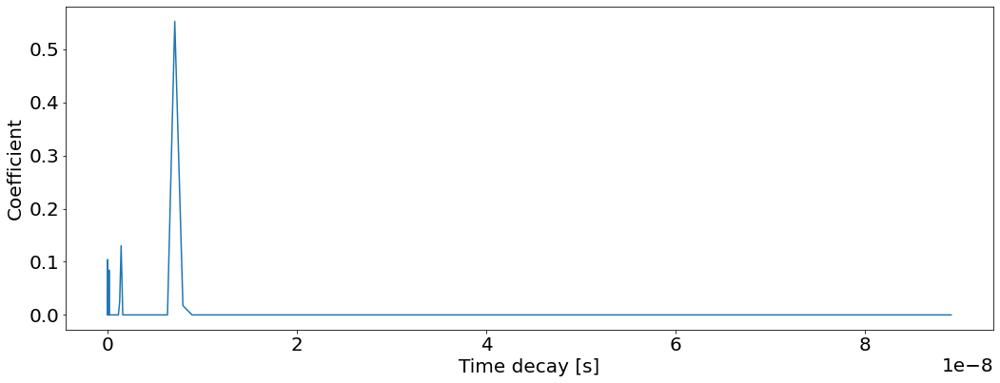

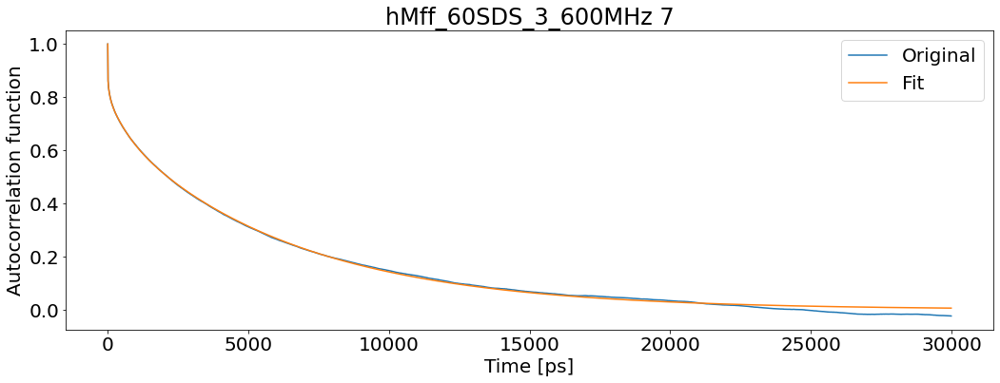

T1: 0.6083465250356584 T2: 0.13735454906886443 NOE: 0.5521800774245063


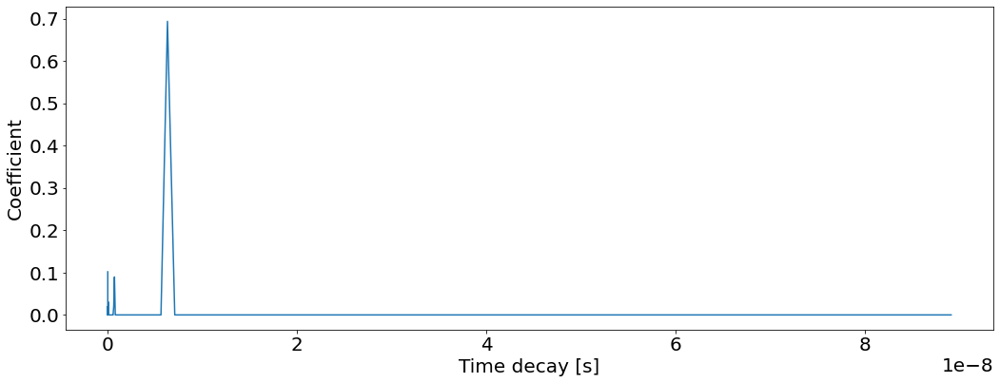

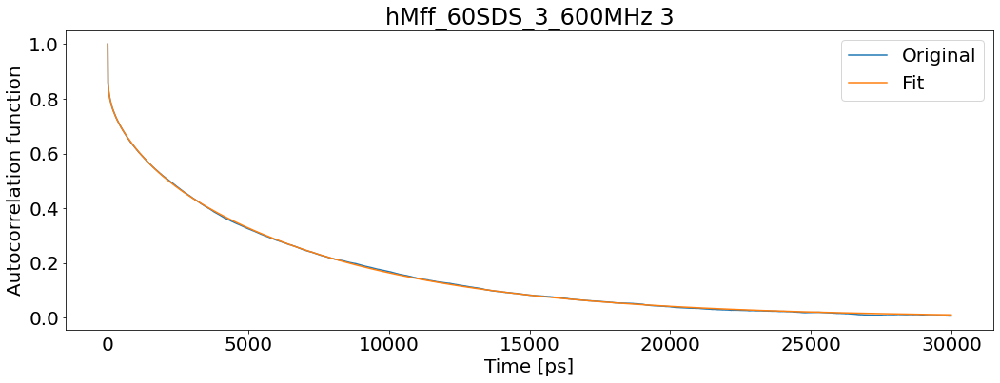

T1: 0.6477414254459205 T2: 0.1276308791235085 NOE: 0.5295591488458371


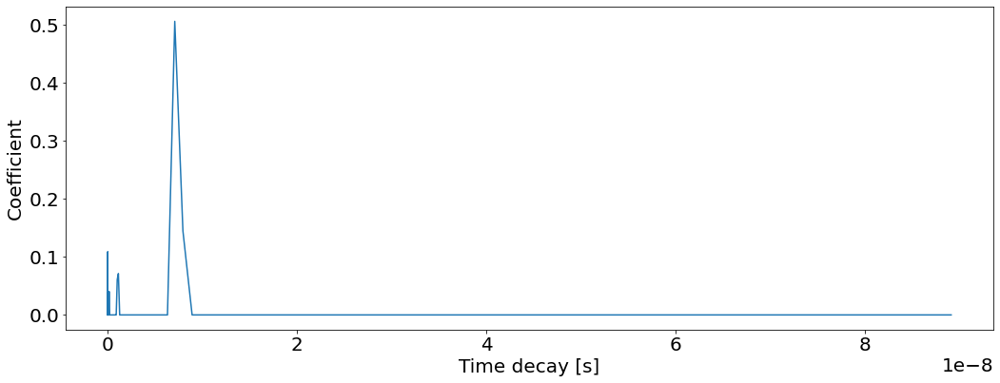

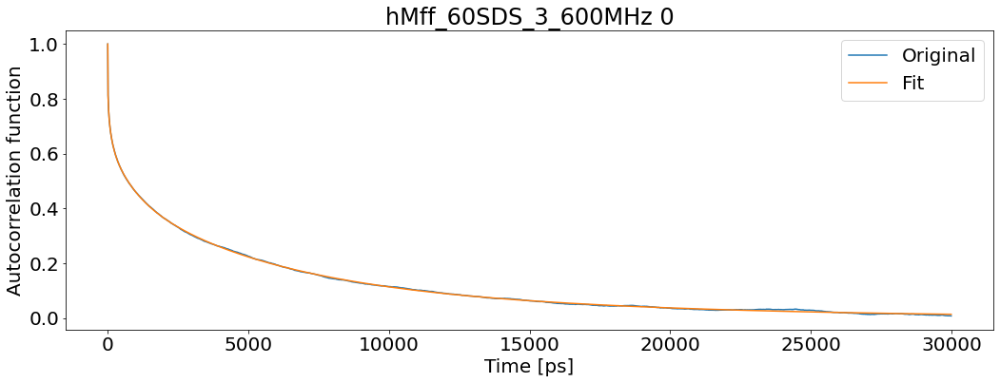

T1: 0.7203212370473573 T2: 0.1647803498926068 NOE: 0.22209298925452747


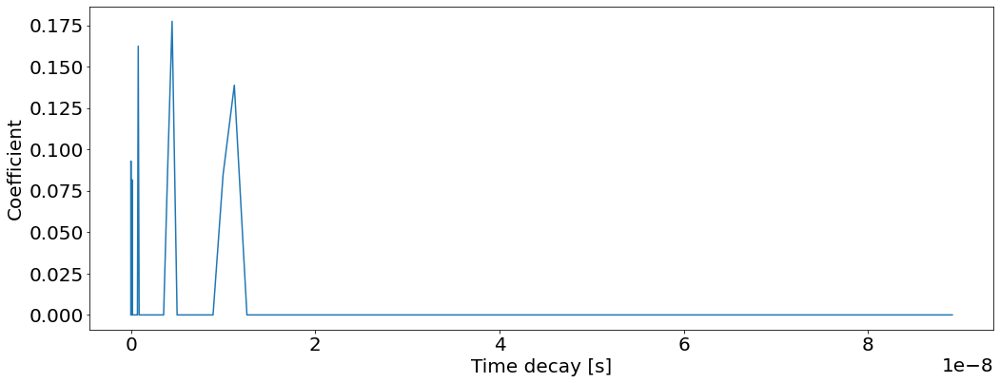

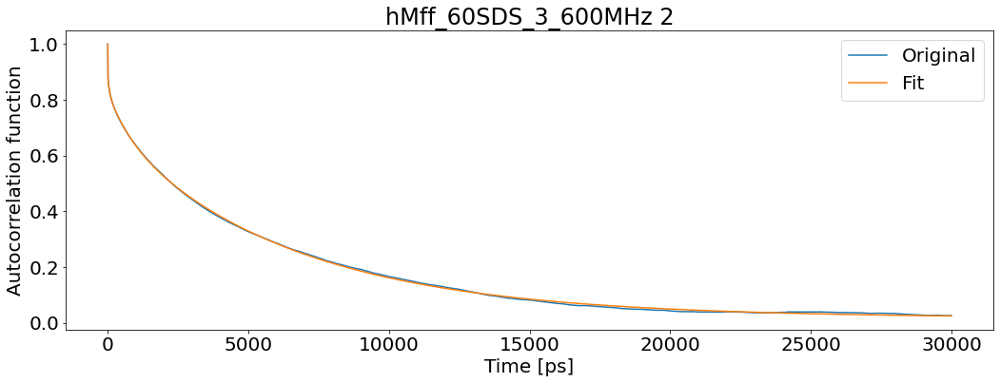

T1: 0.6077174046626725 T2: 0.0962569083851179 NOE: 0.555895471694076


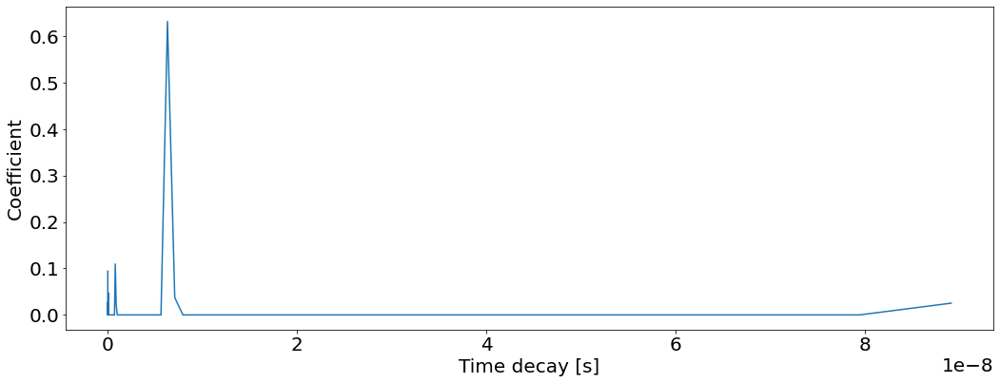

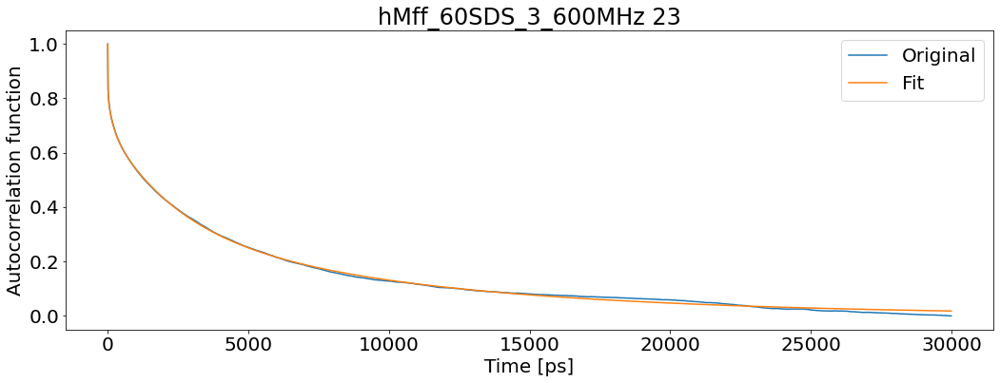

T1: 0.612363869766448 T2: 0.14286508519802416 NOE: 0.43657311081213457


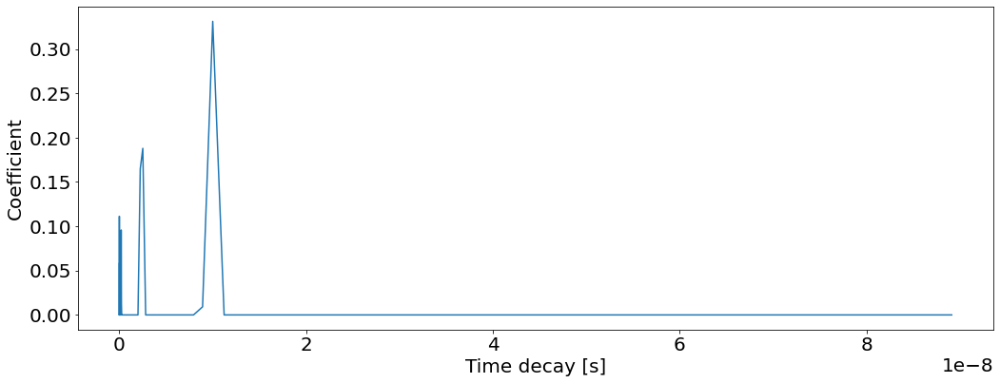

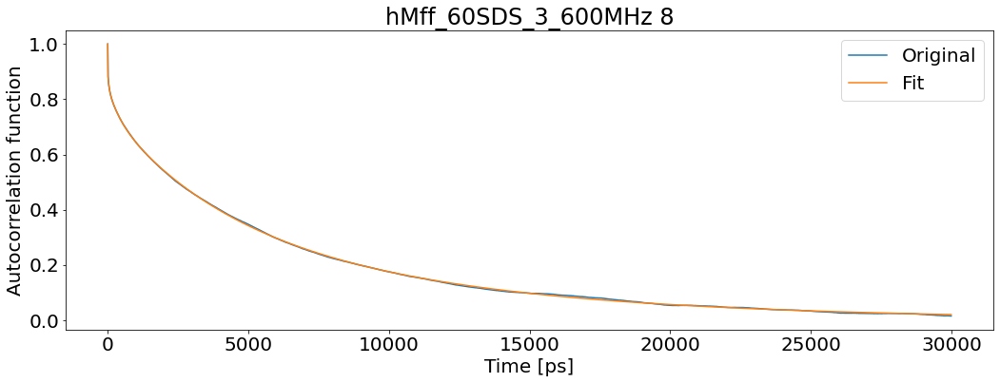

T1: 0.6054930470107162 T2: 0.11504499817477698 NOE: 0.5447168684664461


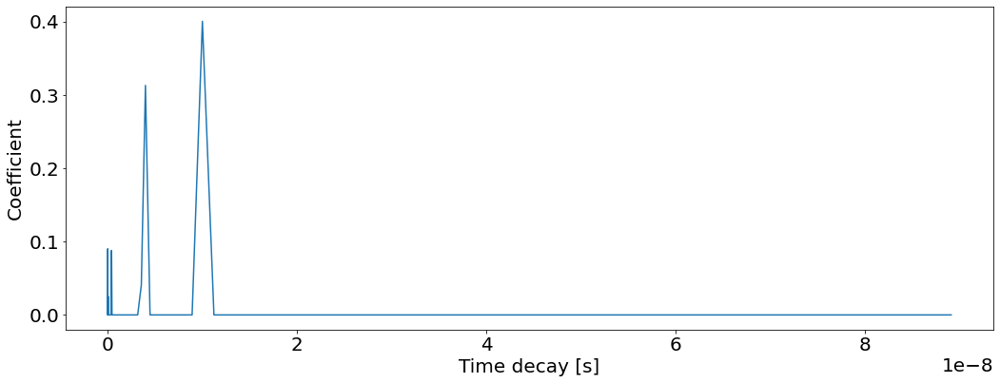

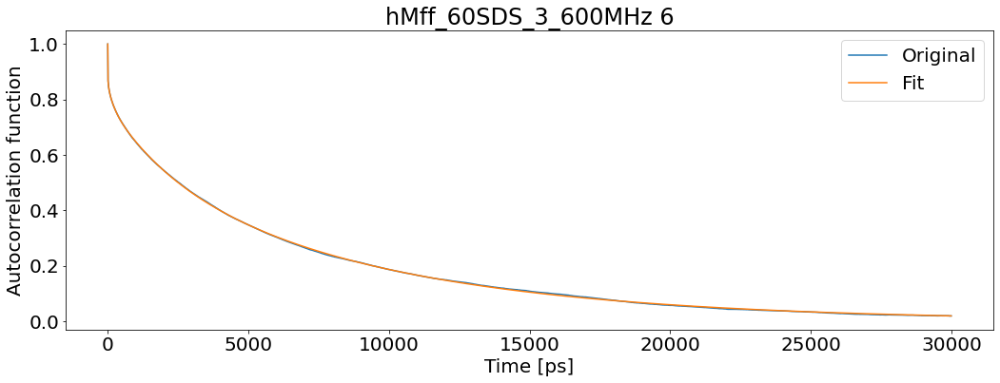

T1: 0.6285201679779897 T2: 0.11357698958122332 NOE: 0.5703270487243908


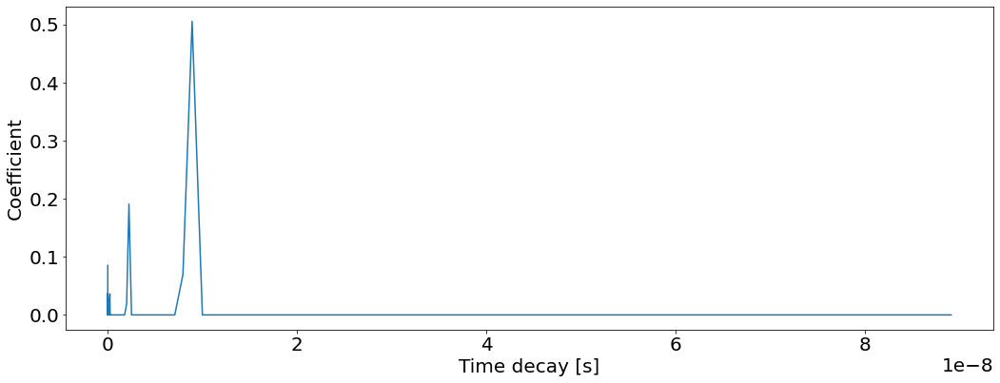

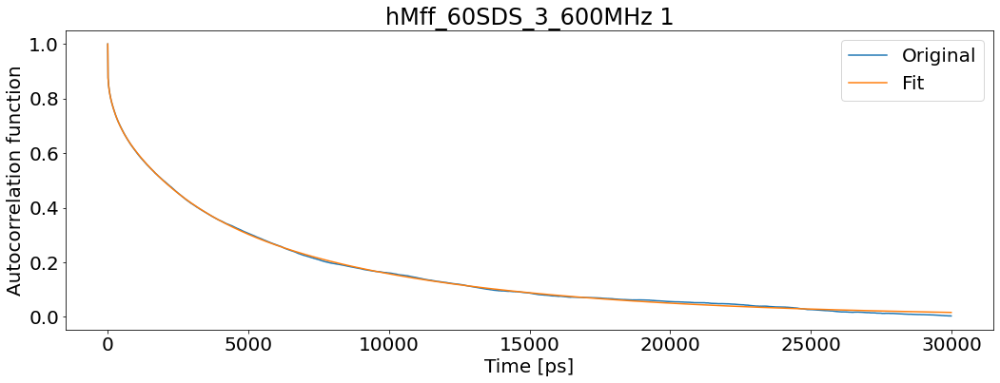

T1: 0.5964028717959717 T2: 0.1258246315247772 NOE: 0.4788044564922975


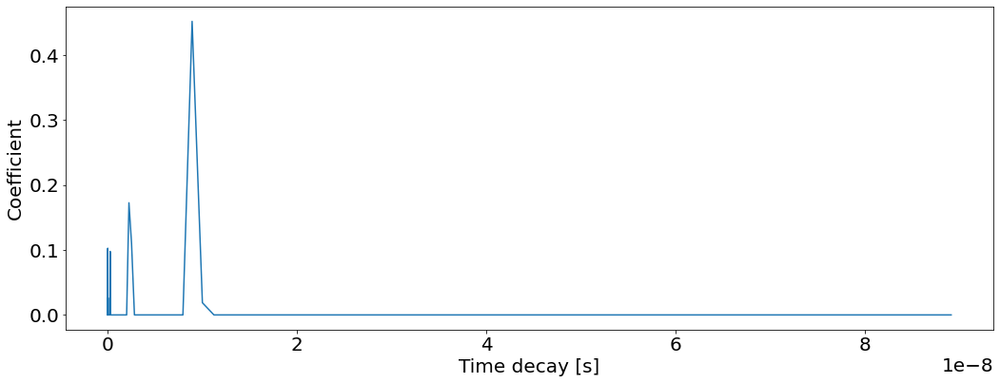

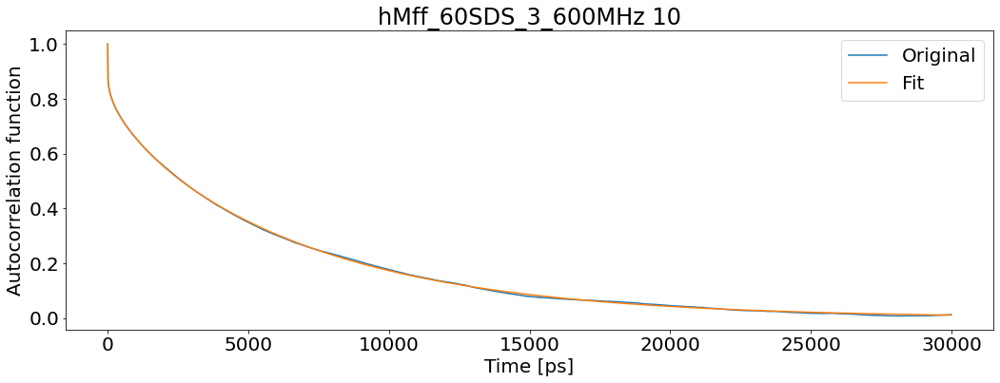

T1: 0.6238834516879123 T2: 0.12134983748008694 NOE: 0.5983417598694498


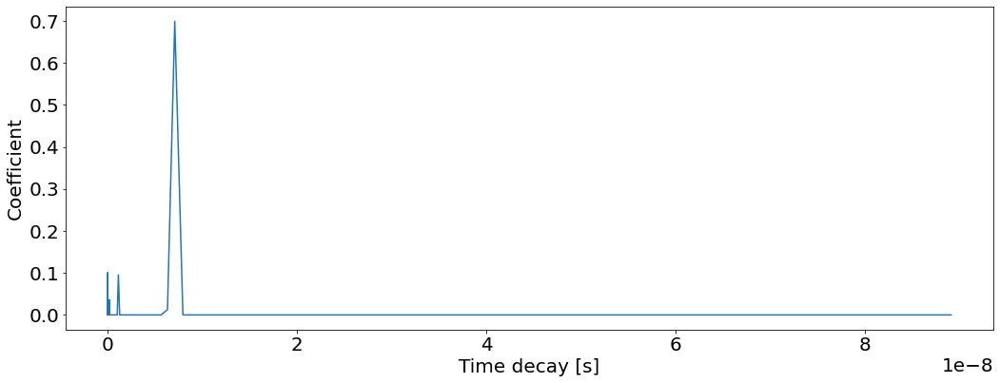

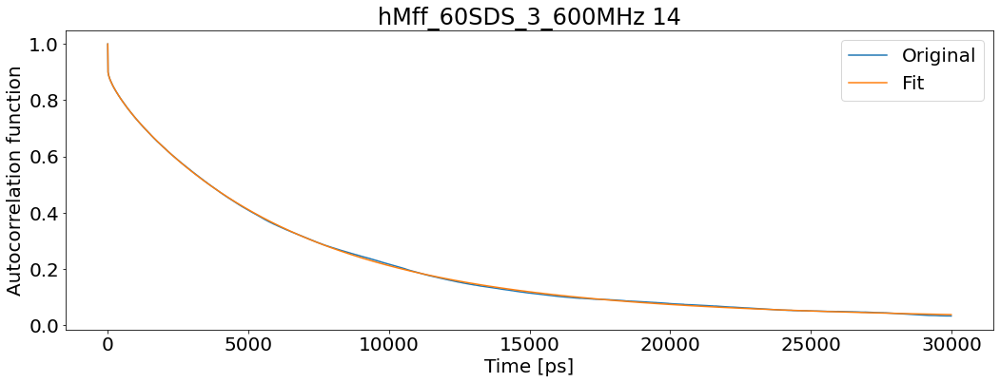

T1: 0.5914476408214773 T2: 0.08711302434169894 NOE: 0.7054732926701262


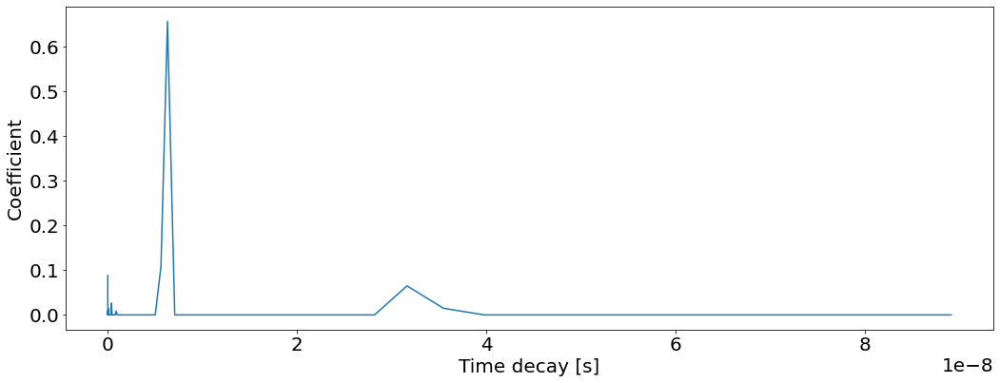

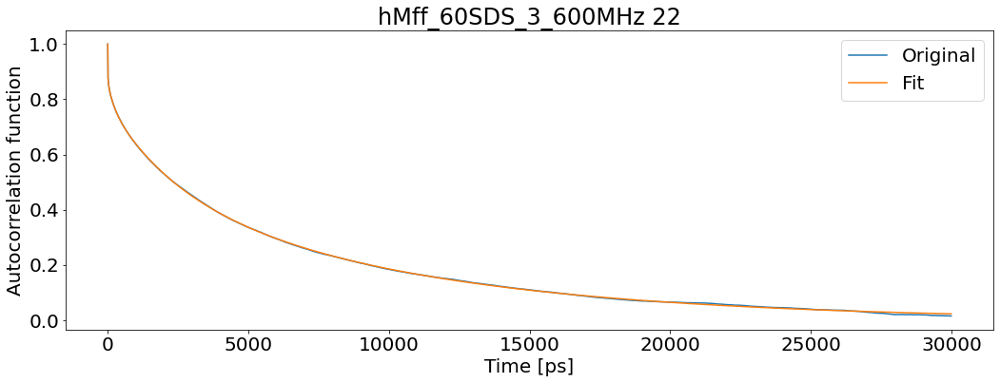

T1: 0.616334503649671 T2: 0.11235740834089228 NOE: 0.5342015089837296


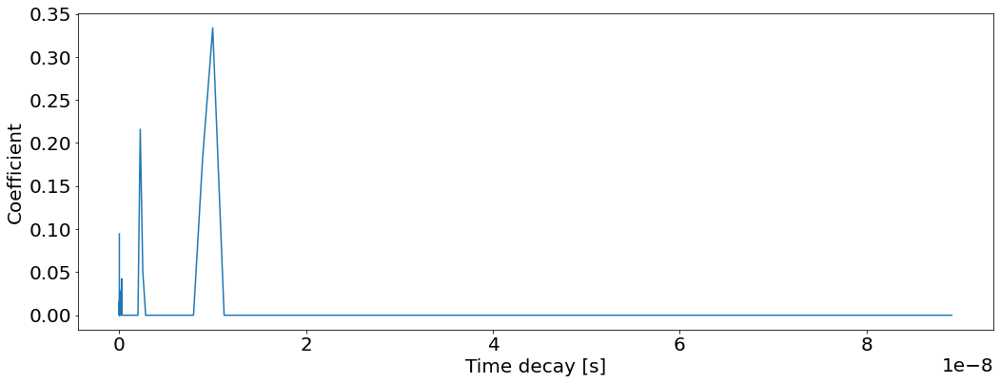

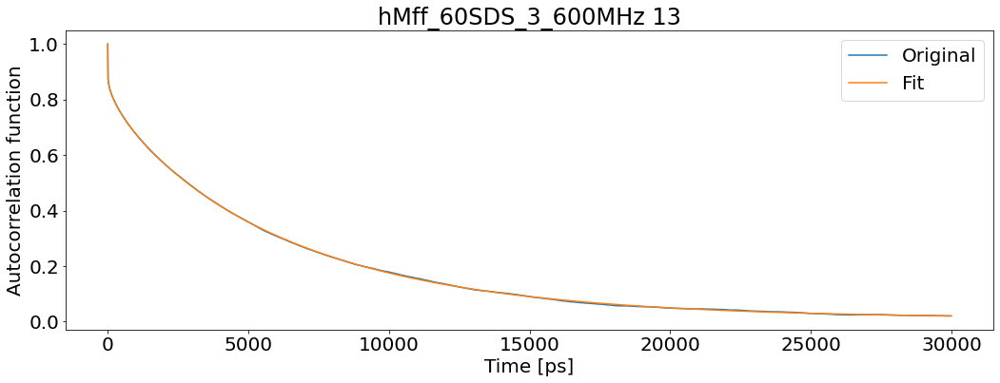

T1: 0.5955098742970429 T2: 0.09830776805068746 NOE: 0.632905899677559


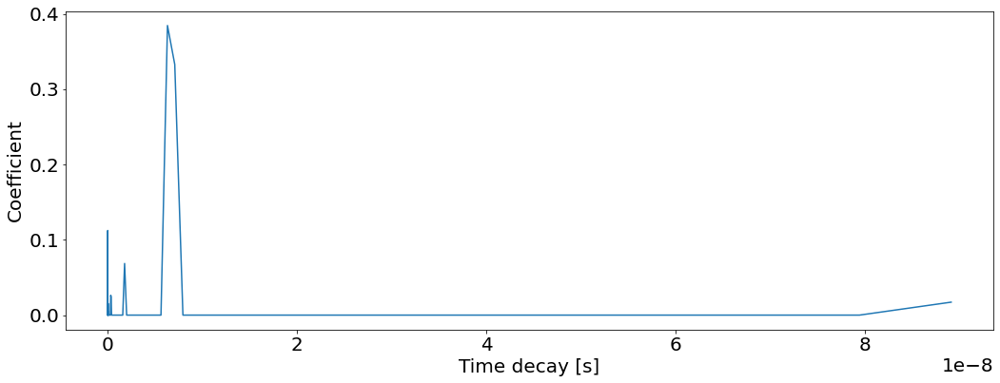

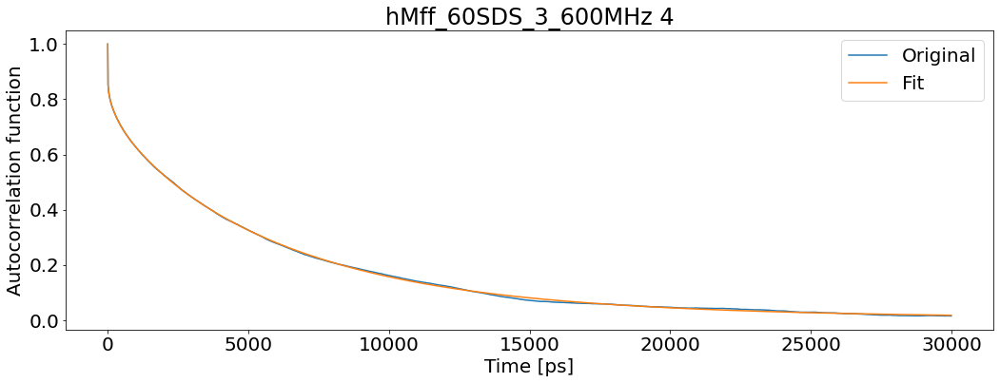

T1: 0.6136282248580711 T2: 0.12135033171466035 NOE: 0.5641219352238793


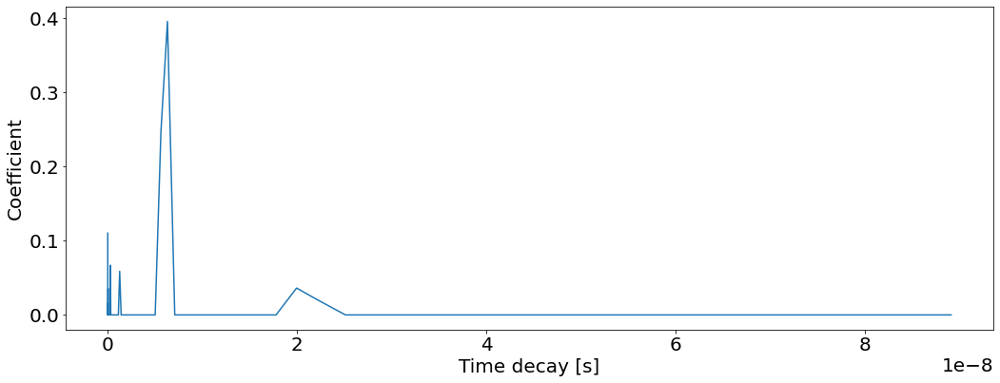

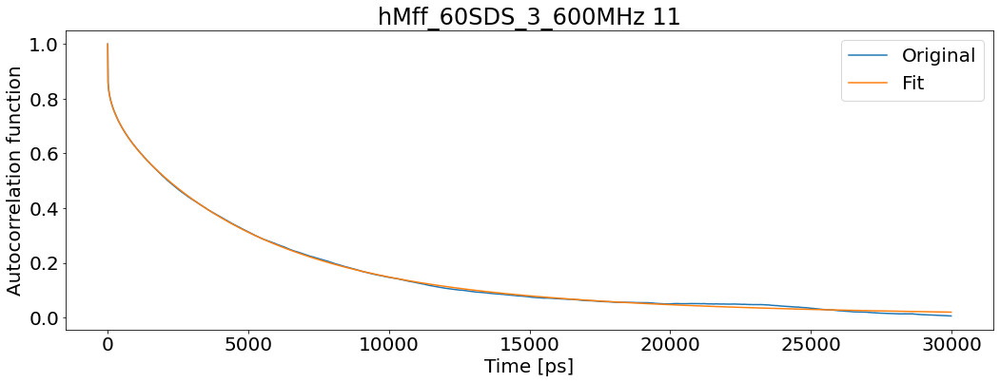

T1: 0.5851368005133348 T2: 0.12310363692462035 NOE: 0.5607851200968025


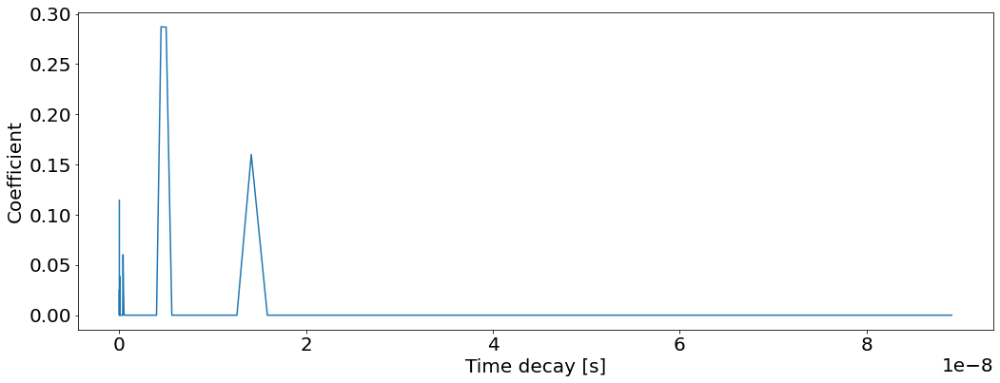

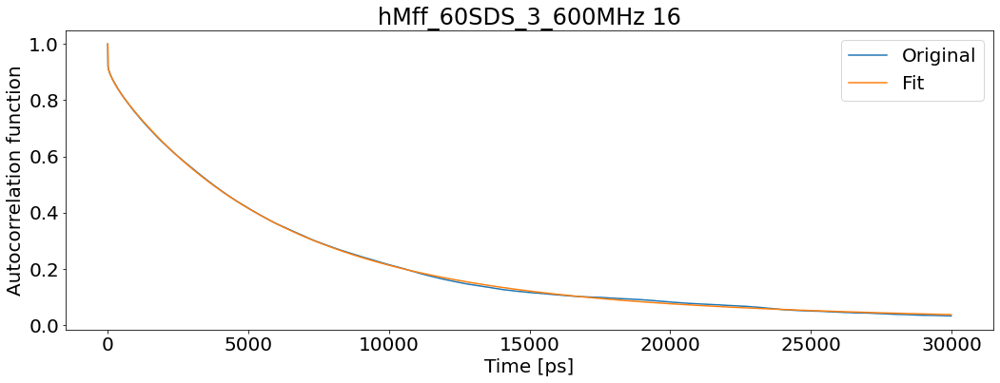

T1: 0.5621789249360778 T2: 0.09001141798782655 NOE: 0.7251526429198188


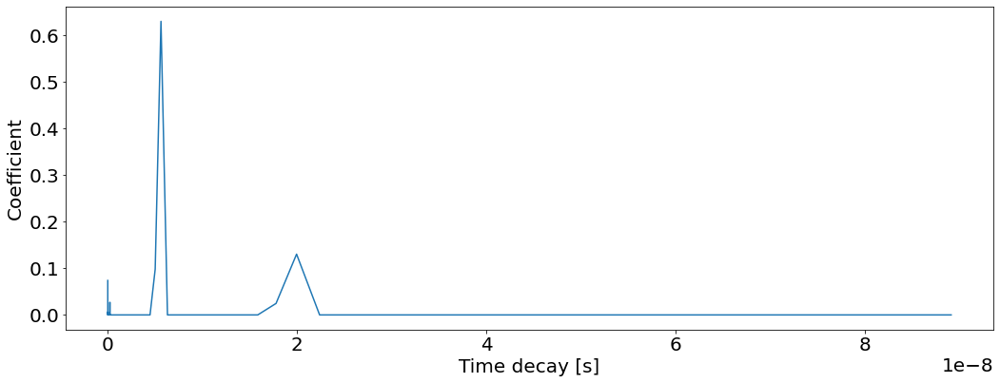

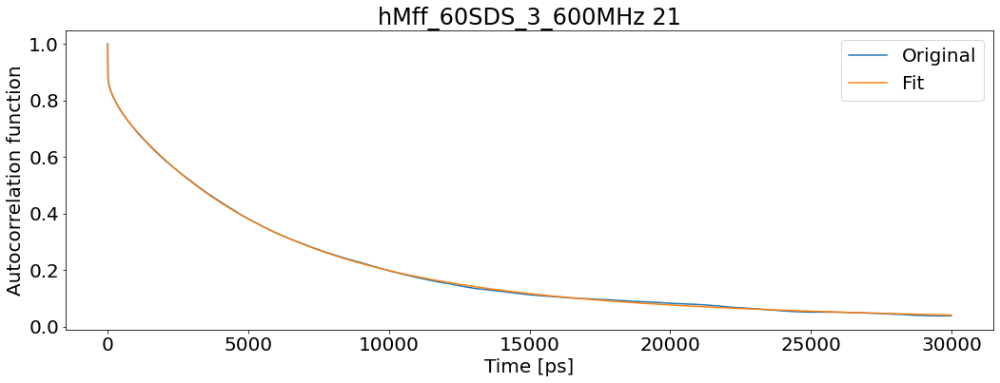

T1: 0.5968355225584216 T2: 0.0929627971038696 NOE: 0.6613427931953788


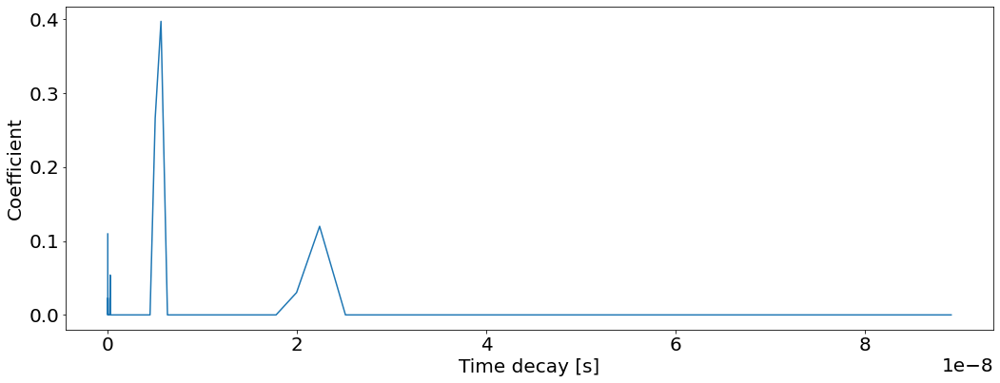

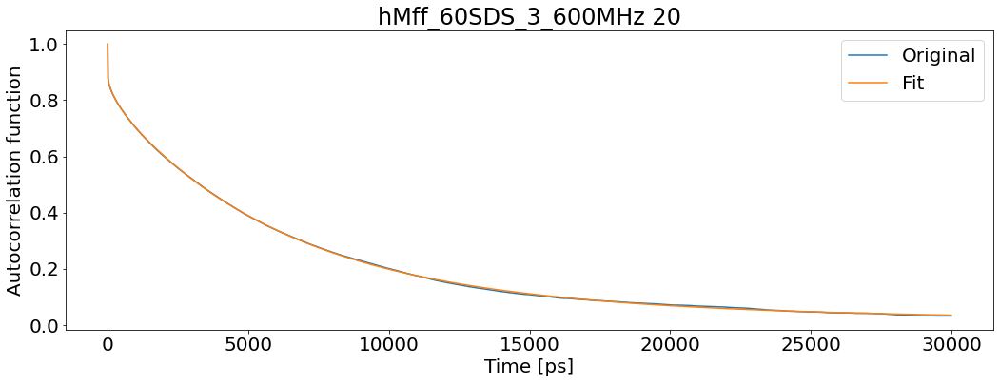

T1: 0.6043312559900412 T2: 0.09354390018832963 NOE: 0.6675413442088817


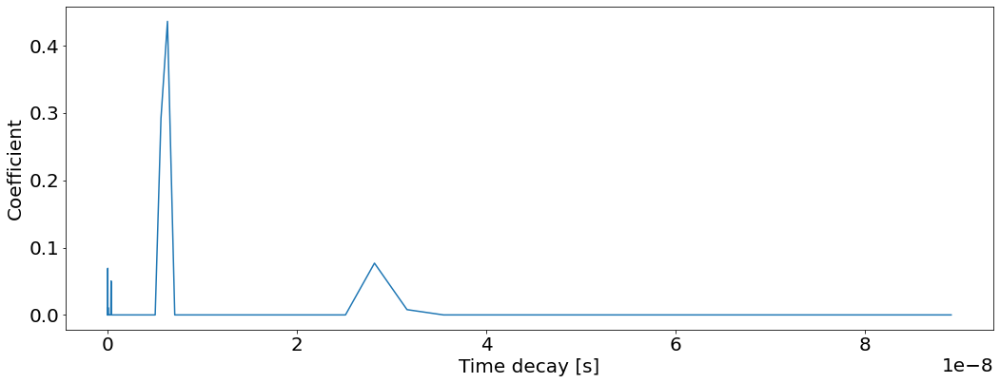

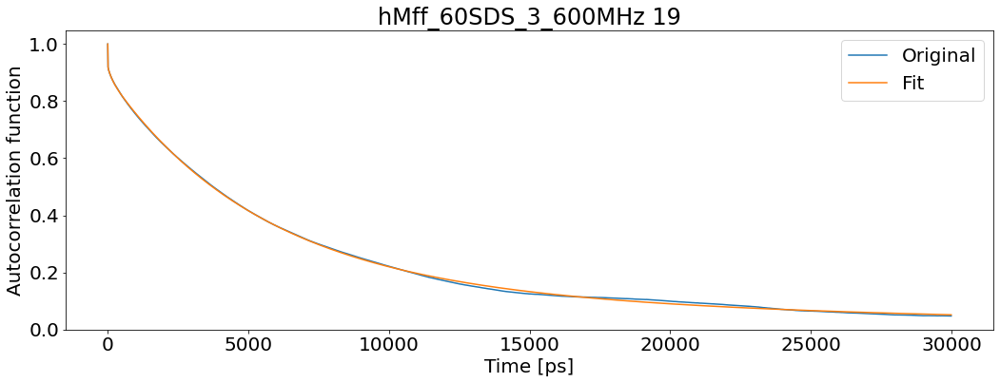

T1: 0.5609387072892682 T2: 0.0810565169327564 NOE: 0.733476215850209


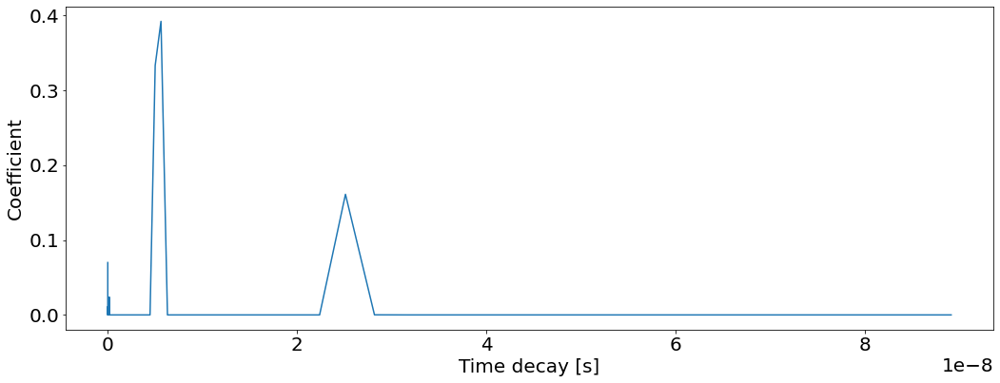

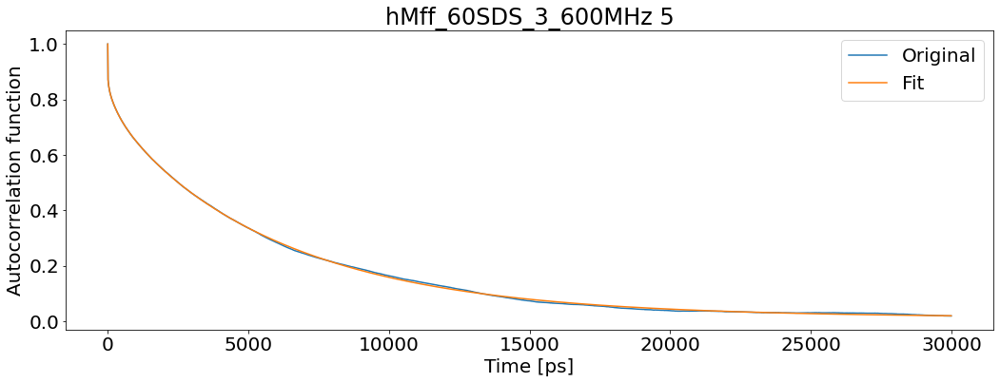

T1: 0.590981670452894 T2: 0.10101715666330527 NOE: 0.5895902465686864


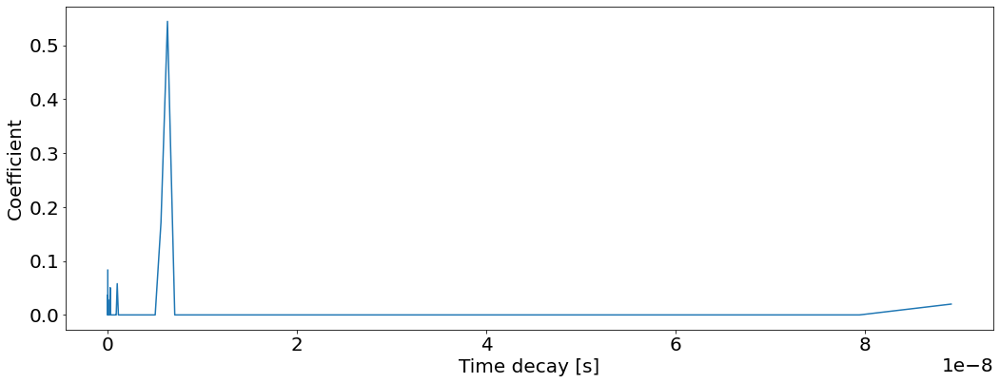

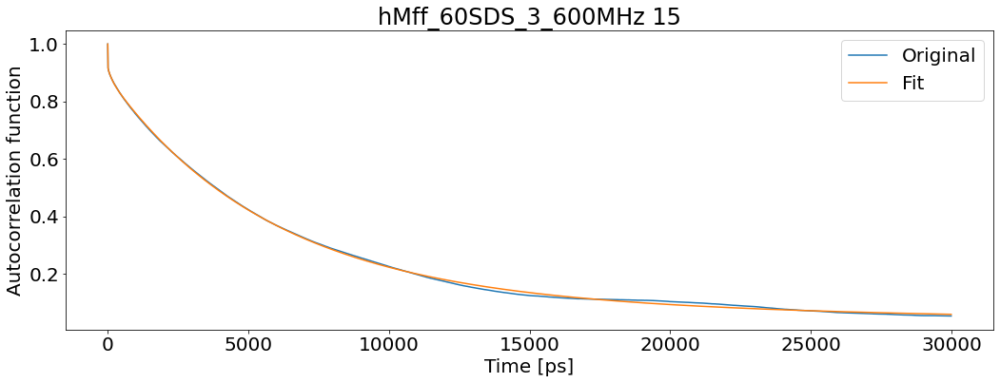

T1: 0.5694090400393425 T2: 0.07052894151301878 NOE: 0.7382108990231471


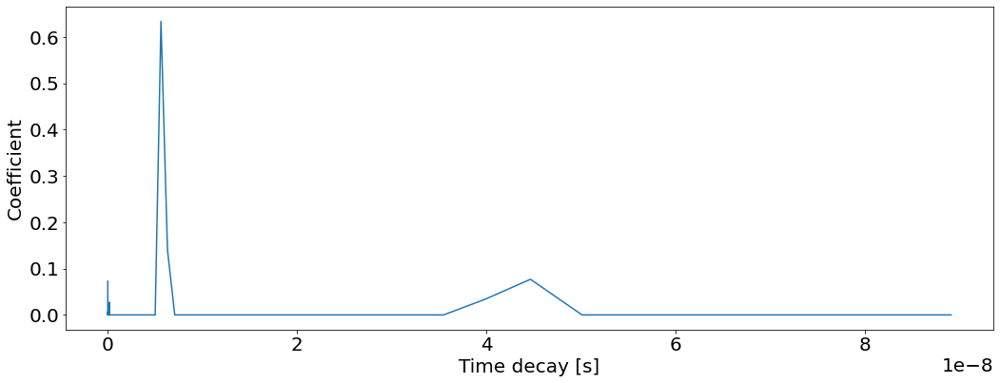

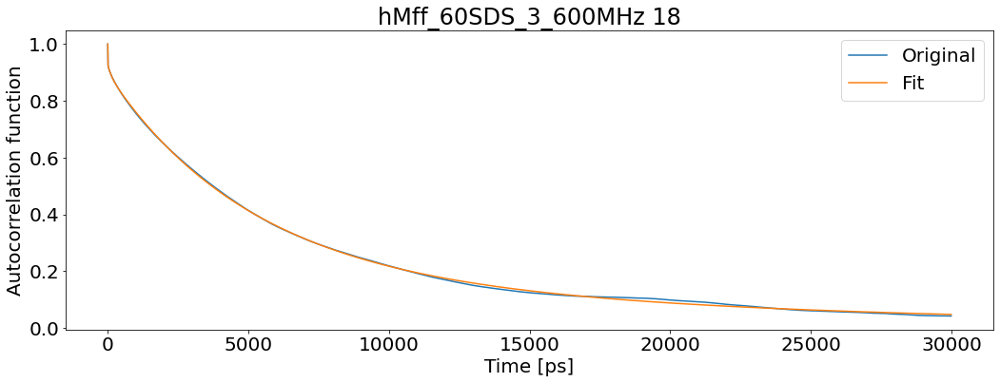

T1: 0.5493839746032444 T2: 0.0844701044072612 NOE: 0.7379680238376822


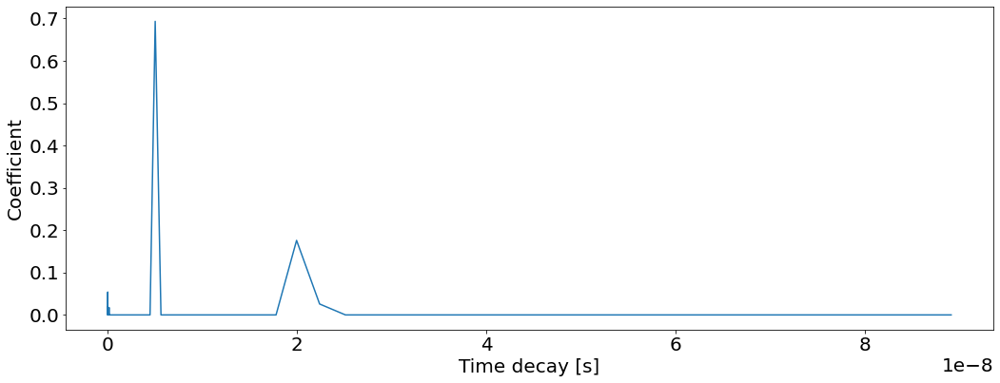

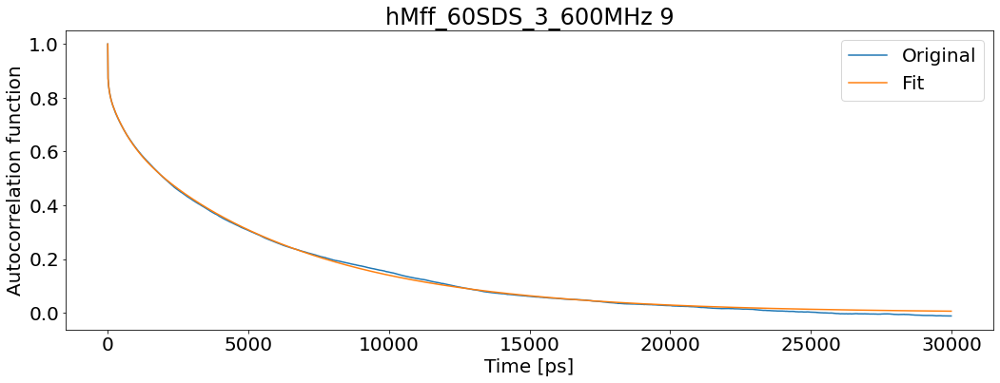

T1: 0.6026569905382145 T2: 0.13892232745197816 NOE: 0.5054554690803628


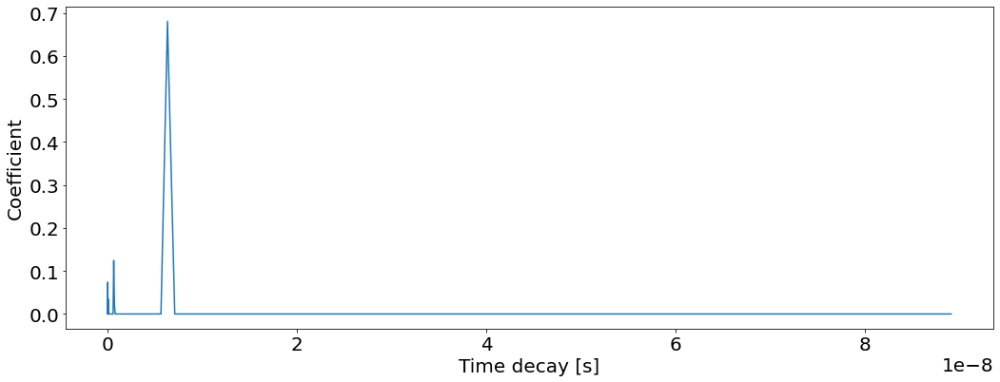

In [127]:
"""Analyze the whole content of a folder"""
aminoAcids=rt.analyze_all_in_folder(OP,smallest_corr_time, biggest_corr_time, N_exp_to_fit,analyze,magnetic_field,folder_path,nuclei,output_name)

<h3>4) Plot results</h3>

<h4>4.1) Plot T1, T2, hetNOE relaxation data</h4>

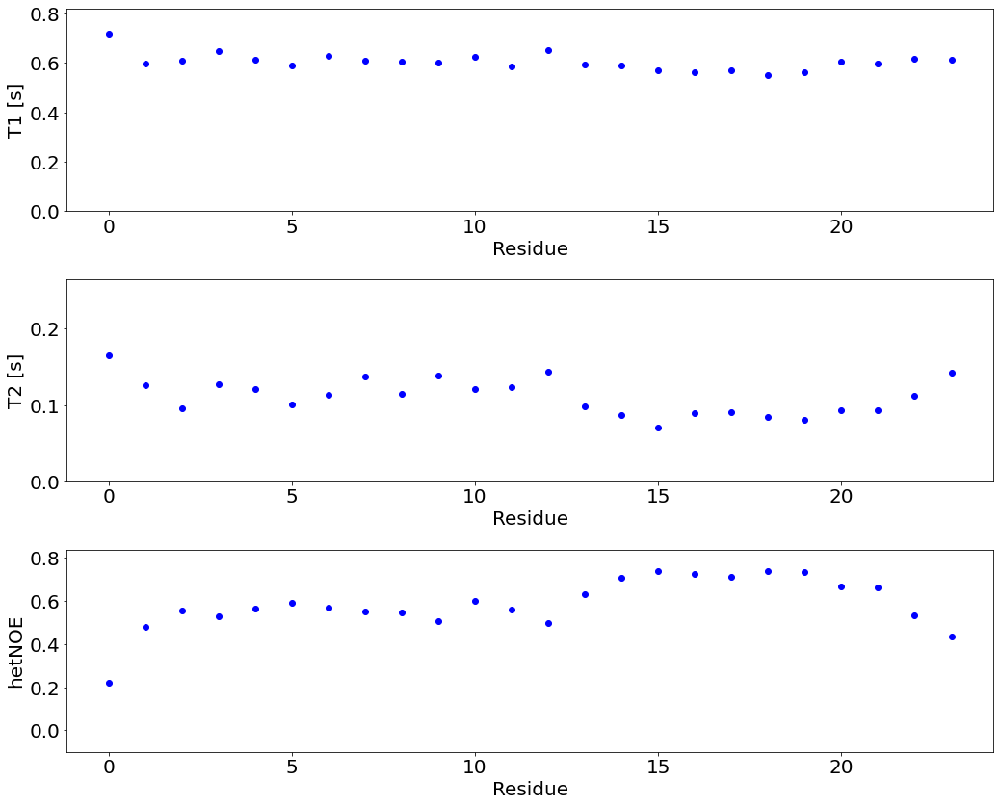

In [128]:
rt.plot_T1_T2_noe(aminoAcids,yaml_output)

<h4>4.2) Set y-axis range and categories to plot in different colors</h4>

In [13]:
merge=5 # number of consequent points to be merged (works on log scale!!)
groupTimes=[10**(-10),10**(-9),10**(-9)*5,10**(-8)] # groups points smaller than 1st value, 
                                                    #points between 1st and 2nd, 2nd and 3st....
                                                    #points bigger than the last value
ylim=[10**(-12),10**(-8)*2] # useful for observing details
#ylim=None # if None the whole range of available data is plotted
title="Time coefficients"
xlabel="Residue of hMff"

<h4>4.2) Plot dynamics</h4>

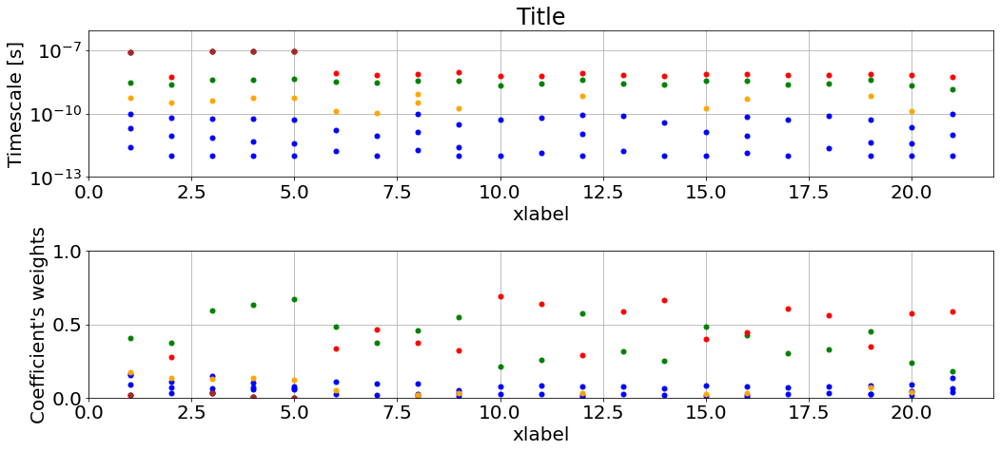

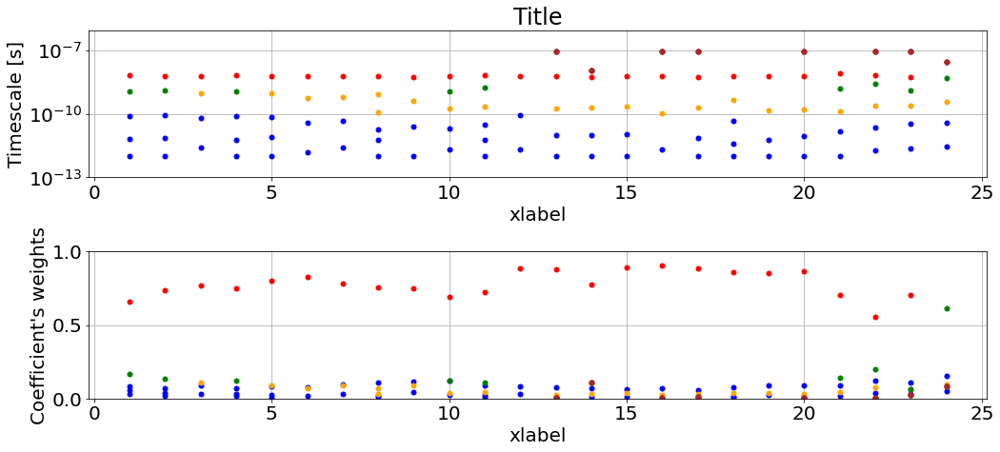

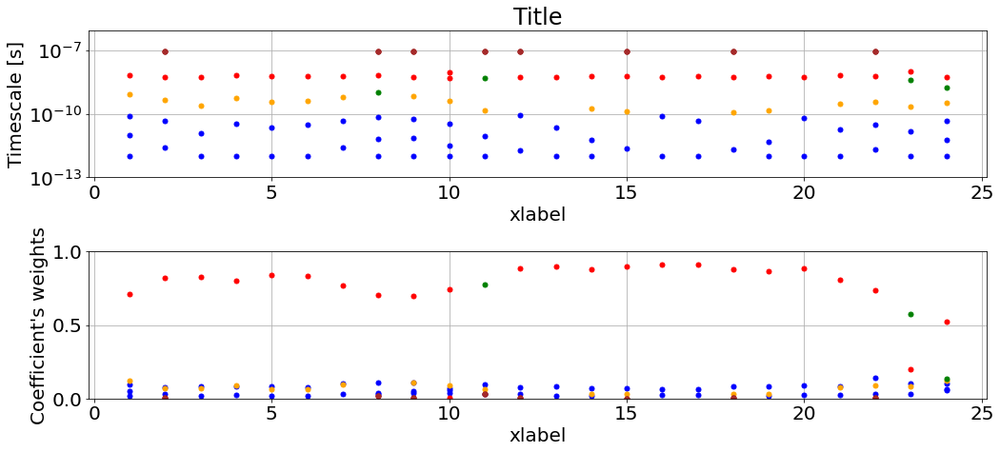

In [22]:
rt.PlotTimescales(aminoAcids_45_1,merge,groupTimes,title,xlabel,ylim=None)
rt.PlotTimescales(aminoAcids_45_2,merge,groupTimes,title,xlabel,ylim=None)
rt.PlotTimescales(aminoAcids_45_3,merge,groupTimes,title,xlabel,ylim=None)

<h3>Load data for comparison </h3>

In [16]:
save_dest="hMff_60SDS_1.yaml"
with open(save_dest) as yaml_file:
    hMff_60SDS_1= yaml.load(yaml_file,Loader=yaml.FullLoader)

save_dest="hMff_60SDS_2.yaml"
with open(save_dest) as yaml_file:
    hMff_60SDS_2= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
save_dest="hMff_60SDS_3.yaml"
with open(save_dest) as yaml_file:
    hMff_60SDS_3= yaml.load(yaml_file,Loader=yaml.FullLoader)
    

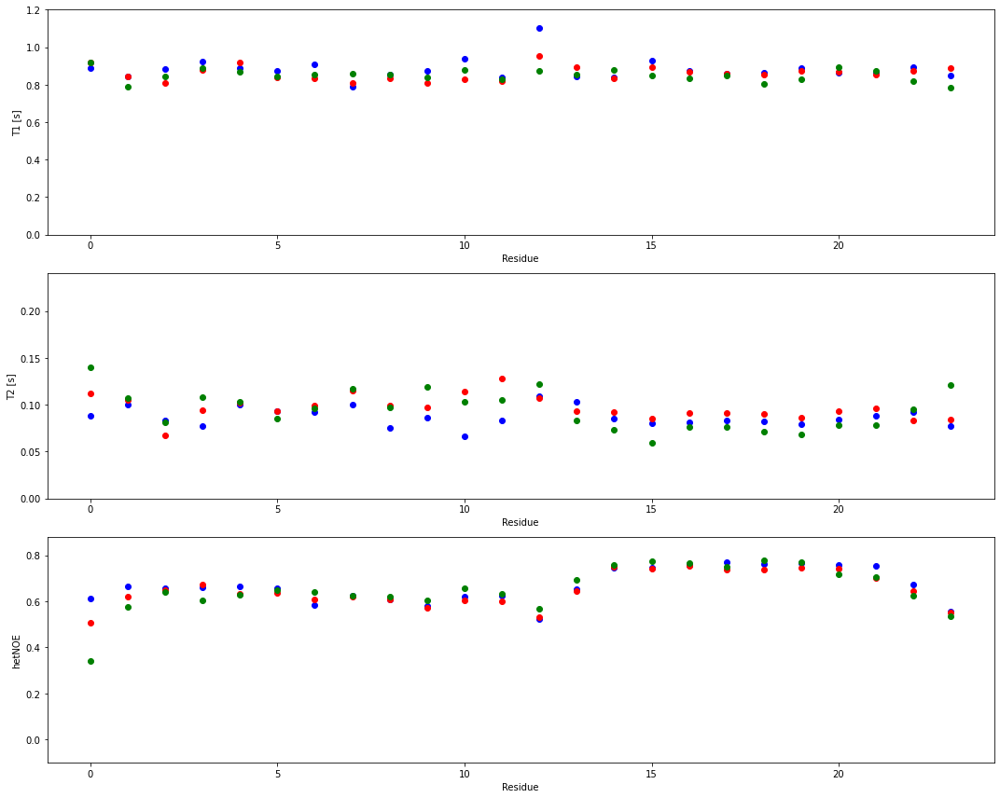

In [4]:
rt.plot_replicas(hMff_60SDS_1,hMff_60SDS_2,hMff_60SDS_3)

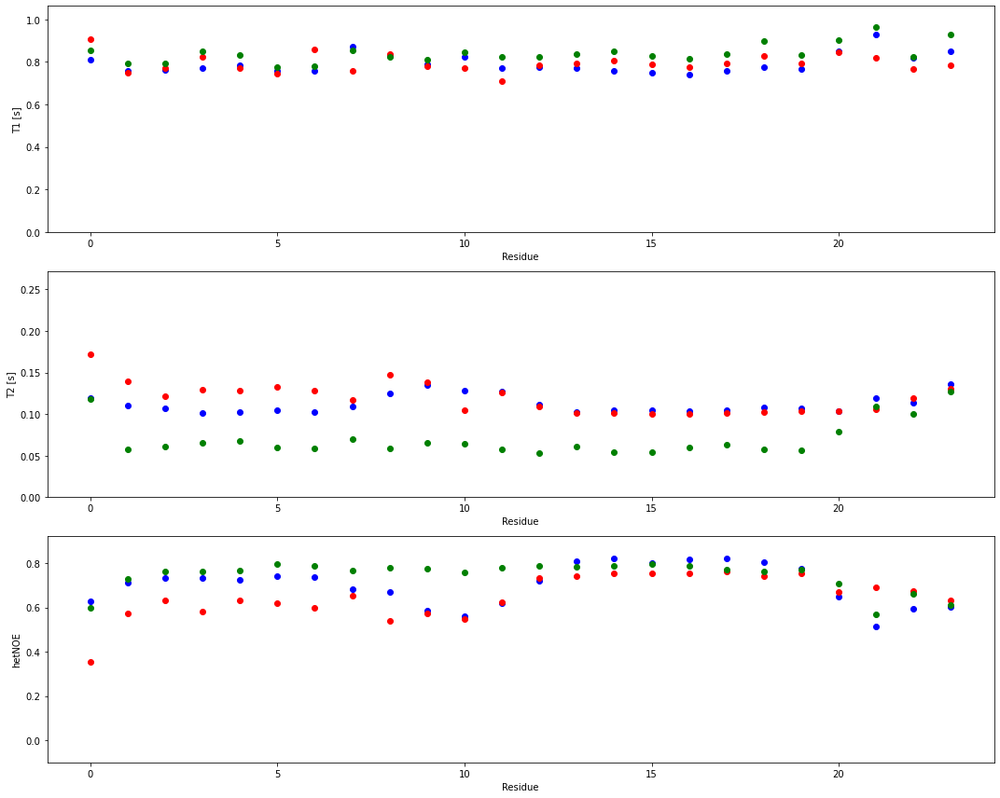

In [15]:
save_dest="hMff_50SDS_1.yaml"
with open(save_dest) as yaml_file:
    hMff_50SDS_1= yaml.load(yaml_file,Loader=yaml.FullLoader)

save_dest="hMff_50SDS_2.yaml"
with open(save_dest) as yaml_file:
    hMff_50SDS_2= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
save_dest="hMff_50SDS_3.yaml"
with open(save_dest) as yaml_file:
    hMff_50SDS_3= yaml.load(yaml_file,Loader=yaml.FullLoader)
rt.plot_replicas(hMff_50SDS_1,hMff_50SDS_2,
                 hMff_50SDS_3
                )    

In [14]:
save_dest="hMff_40SDS_1.yaml"
with open(save_dest) as yaml_file:
    hMff_40SDS_1= yaml.load(yaml_file,Loader=yaml.FullLoader)

save_dest="hMff_40SDS_2.yaml"
with open(save_dest) as yaml_file:
    hMff_40SDS_2= yaml.load(yaml_file,Loader=yaml.FullLoader)

save_dest="hMff_40SDS_3.yaml"
with open(save_dest) as yaml_file:
    hMff_40SDS_3= yaml.load(yaml_file,Loader=yaml.FullLoader)

save_dest="hMff_45SDS_1.yaml"
with open(save_dest) as yaml_file:
    hMff_45SDS_1= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
save_dest="hMff_45SDS_2.yaml"
with open(save_dest) as yaml_file:
    hMff_45SDS_2= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
save_dest="hMff_45SDS_3.yaml"
with open(save_dest) as yaml_file:
    hMff_45SDS_3= yaml.load(yaml_file,Loader=yaml.FullLoader)

In [144]:
save_dest="hMff_40SDS_1_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_40SDS_1= yaml.load(yaml_file,Loader=yaml.FullLoader)

save_dest="hMff_40SDS_2_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_40SDS_2= yaml.load(yaml_file,Loader=yaml.FullLoader)

save_dest="hMff_40SDS_3_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_40SDS_3= yaml.load(yaml_file,Loader=yaml.FullLoader)

save_dest="hMff_45SDS_1_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_45SDS_1= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
save_dest="hMff_45SDS_2_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_45SDS_2= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
save_dest="hMff_45SDS_3_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_45SDS_3= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
save_dest="hMff_50SDS_1_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_50SDS_1= yaml.load(yaml_file,Loader=yaml.FullLoader)

save_dest="hMff_50SDS_2_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_50SDS_2= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
save_dest="hMff_50SDS_3_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_50SDS_3= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
save_dest="hMff_60SDS_1_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_60SDS_1= yaml.load(yaml_file,Loader=yaml.FullLoader)

save_dest="hMff_60SDS_2_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_60SDS_2= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
save_dest="hMff_60SDS_3_1000MHz.yaml"
with open(save_dest) as yaml_file:
    hMff_60SDS_3= yaml.load(yaml_file,Loader=yaml.FullLoader)

In [20]:
save_dest="/home/local/nenciric/Documents/git/CorysPeptides/experimental_data/yamls/hMff_DSDS_first_samples_T1_114_850MHz.yaml"
with open(save_dest) as yaml_file:
    t1_hMff_SDS_850= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
save_dest="/home/local/nenciric/Documents/git/CorysPeptides/experimental_data/yamls/hMff_DSDS_first_samples_T2_120_850MHz.yaml"
with open(save_dest) as yaml_file:
    t2_hMff_SDS_850= yaml.load(yaml_file,Loader=yaml.FullLoader)
    
    
save_dest="/home/local/nenciric/Documents/git/CorysPeptides/experimental_data/yamls/hMff_DSDS_first_samples_hetNOE_220_850MHz.yaml"
with open(save_dest) as yaml_file:
    hetNOE_hMff_SDS_850= [yaml.load(yaml_file,Loader=yaml.FullLoader)]
    

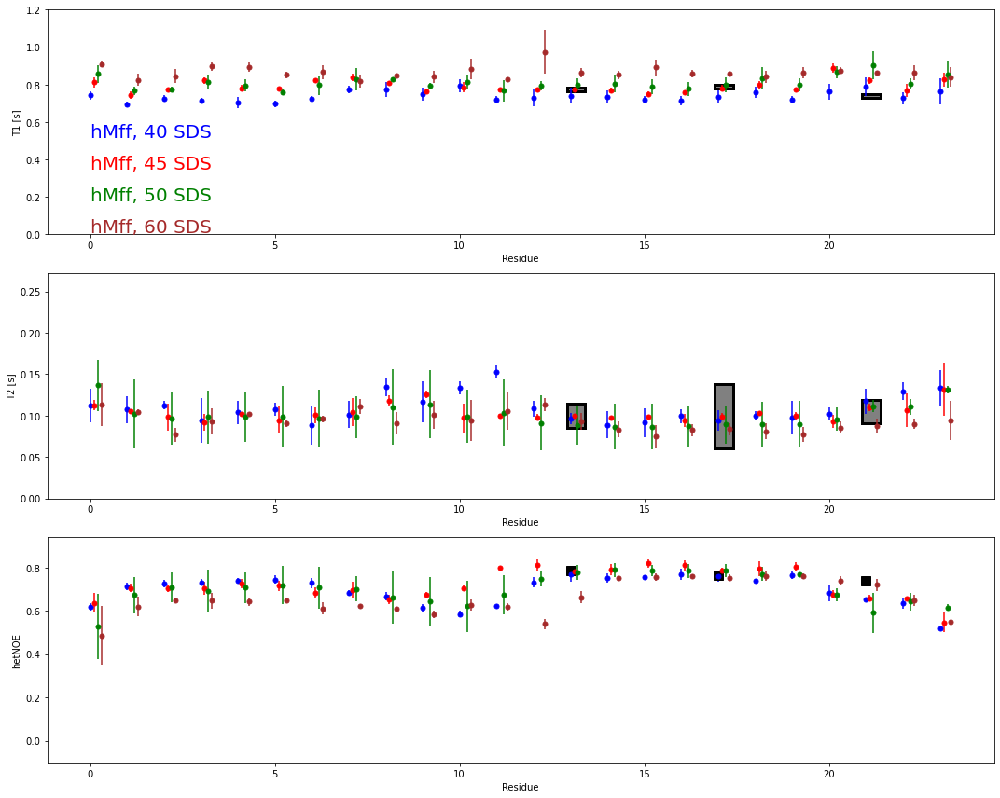

In [21]:
plot_replicas("hMff_40_45_50_60SDS_850MHz.pdf","average",3,hMff_40SDS_1,hMff_40SDS_2,hMff_40SDS_3,hMff_45SDS_1,hMff_45SDS_2,hMff_45SDS_3,hMff_50SDS_1,hMff_50SDS_2,hMff_50SDS_3,hMff_60SDS_1,hMff_60SDS_2,hMff_60SDS_3)

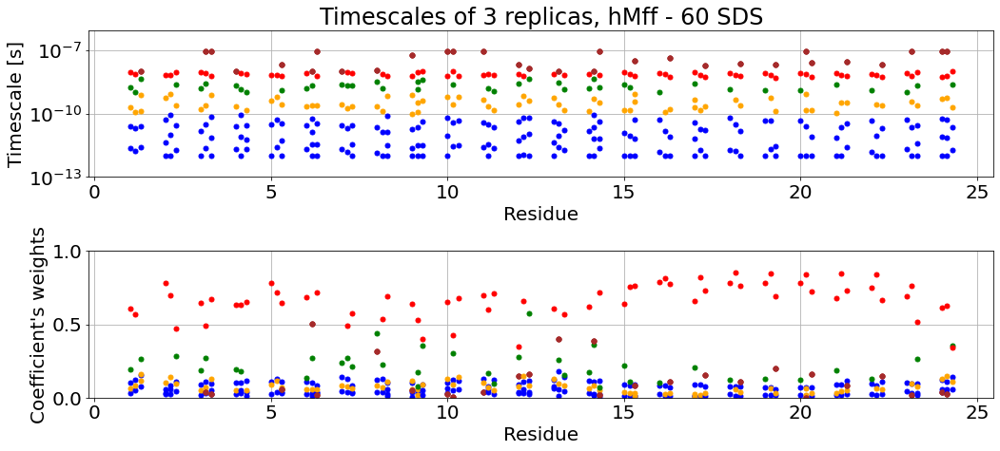

In [164]:
title="Timescales of 3 replicas, hMff - 60 SDS"
xlabel="Residue"
ylim=None
PlotTimescales_replicas(merge,groupTimes,title,xlabel,ylim,aminoAcids_850[9],aminoAcids_850[10],aminoAcids_850[11])

In [158]:
merge=5

In [18]:
def plot_replicas(save_name,plotType,number,*replicas):
    plt.rcParams["figure.figsize"] = [15.00, 12]
    plt.rcParams["figure.autolayout"] = True

    fig, (ax1, ax2, ax3) = plt.subplots(3)
    
    ax1.set_ylabel("T1 [s]")
    ax1.set_xlabel("Residue")
    ax2.set_ylabel("T2 [s]")
    ax2.set_xlabel("Residue")
    ax3.set_ylabel("hetNOE")
    ax3.set_xlabel("Residue")
    max_T1=0
    max_T2=0
    max_noe=0
    min_noe=0
    col=["blue","red","green","brown","gray"]
    colors=[]

    for peak in t1_hMff_SDS_850[0]["peaks"]:
        try:
            #ax1.errorbar(int(peak),t1_hMff_SDS_850[0]["peaks"][peak]["T1"],t1_hMff_SDS_850[0]["peaks"][peak]["error"],fmt="s",markersize=1,color="black")
            rect = patches.Rectangle((int(peak)-0.1, t1_hMff_SDS_850[0]["peaks"][peak]["T1"]+t1_hMff_SDS_850[0]["peaks"][peak]["error"]), 0.5, -2*t1_hMff_SDS_850[0]["peaks"][peak]["error"], linewidth=3, edgecolor='black', facecolor='gray')
            ax1.add_patch(rect)
        except:
            pass
        
        
    for peak in t2_hMff_SDS_850[0]["peaks"]:
        try:
            #ax2.errorbar(int(peak),t2_hMff_SDS_850[0]["peaks"][peak]["T2"],t2_hMff_SDS_850[0]["peaks"][peak]["error"],fmt="s",markersize=1,color="black")
            rect = patches.Rectangle((int(peak)-0.1, t2_hMff_SDS_850[0]["peaks"][peak]["T2"]+t2_hMff_SDS_850[0]["peaks"][peak]["error"]), 0.5, -2*t2_hMff_SDS_850[0]["peaks"][peak]["error"], linewidth=3, edgecolor='black', facecolor='gray')
            ax2.add_patch(rect)
        except:
            pass
        
    for peak in hetNOE_hMff_SDS_850[0]["peaks"]:
        try:
            ax3.errorbar(int(peak),hetNOE_hMff_SDS_850[0]["peaks"][peak]["hetNOE"],fmt="s",markersize=10,color="black")
            #rect = patches.Rectangle((int(peak)-0.1, t2_hMff_SDS_850[0]["peaks"][peak]["T2"]+t2_hMff_SDS_850[0]["peaks"][peak]["error"]), 0.5, -2*t2_hMff_SDS_850[0]["peaks"][peak]["error"], linewidth=3, edgecolor='black', facecolor='gray')
            #ax2.add_patch(rect)
        except:
            pass
    
    for colo in col:
        for nu in range(number):
            colors.append(colo)
            
    #colors=["blue","blue","blue","red","red","red","green","green","green","gray","gray","gray","brown","brown","brown"]
    averages={}
    for i in replicas[0]:
        averages[i]={}
        for j,replica in enumerate(replicas):
            if (j//number) not in averages[i]:
                averages[i][(j//number)]={}
                if "T1" not in averages[i][(j//number)]:
                    averages[i][(j//number)]["T1"]=[replica[i]["T1"]]
                    averages[i][(j//number)]["T2"]=[replica[i]["T2"]]
                    averages[i][(j//number)]["hetNOE"]=[replica[i]["hetNOE"]]
            else:
                averages[i][(j//number)]["T1"].append(replica[i]["T1"])
                averages[i][(j//number)]["T2"].append(replica[i]["T2"])
                averages[i][(j//number)]["hetNOE"].append(replica[i]["hetNOE"])
                
            if plotType=="all":
                ax1.plot(i+(0.1*(j//number)),replica[i]["T1"],"o",color=colors[j])
                ax2.plot(i+(0.1*(j//number)),replica[i]["T2"],"o",color=colors[j])
                ax3.plot(i+(0.1*(j//number)),replica[i]["hetNOE"],"o",color=colors[j])
            max_T2=max(max_T2,replica[i]["T2"])
            max_T1=max(max_T1,replica[i]["T1"])
            max_noe=max(max_noe,replica[i]["hetNOE"])
            min_noe=min(min_noe,replica[i]["hetNOE"])
        if plotType=="average":
            for j,exp in enumerate(averages[i]):
                ax1.errorbar(i+0.1*j,np.average(averages[i][exp]["T1"]),np.std(averages[i][exp]["T1"],ddof=1),fmt='o',markersize=5,color=col[j])
                ax2.errorbar(i+0.1*j,np.average(averages[i][exp]["T2"]),np.std(averages[i][exp]["T2"],ddof=1),fmt='o',markersize=5,color=col[j])
                ax3.errorbar(i+0.1*j,np.average(averages[i][exp]["hetNOE"]),np.std(averages[i][exp]["hetNOE"],ddof=1),fmt='o',markersize=5,color=col[j])
            
    ax1.set_ylim([0,max_T1+0.1 ])
    ax2.set_ylim([0,max_T2+0.1 ])
    ax3.set_ylim([min_noe-0.1,max_noe+0.1 ])
    ax1.text(0,0.52,"hMff, 40 SDS",color=col[0],fontsize=20)
    ax1.text(0,0.35,"hMff, 45 SDS",color=col[1],fontsize=20)
    ax1.text(0,0.18,"hMff, 50 SDS",color=col[2],fontsize=20)
    ax1.text(0,0.01,"hMff, 60 SDS",color=col[3],fontsize=20)
    
    
    
    plt.savefig(save_name)

In [7]:
def PlotTimescales_replicas(merge,groupTimes,title="Title",xlabel="xlabel",ylim=None,*aminoAcidsReplicas):
    plt.rcParams["figure.figsize"] = [15.00, 7]
    plt.rcParams["figure.autolayout"] = True
    plt.rcParams.update({'font.size': 20})

    
    
    fig, (ax1, ax2) = plt.subplots(2)

    ax1.title.set_text(title)
    

    ax1.grid(axis='x')
    ax1.set_yscale('log')
    ax1.set_ylabel("Timescale [s]")
    ax1.set_xlabel(xlabel)
    
    
    ax2.grid()
    ax2.set_ylim(0,1)
    ax2.set_ylabel("Coefficient's weights")
    ax2.set_xlabel(xlabel)
    
    for k,aminoAcids in enumerate(aminoAcidsReplicas):
        

        step_exp=(aminoAcids[0].biggest_corr_time-aminoAcids[0].smallest_corr_time)/aminoAcids[0].N_exp_to_fit
        Ctimes = 10 ** np.arange(aminoAcids[0].smallest_corr_time, aminoAcids[0].biggest_corr_time, step_exp)
        Ctimes = Ctimes * 0.001 * 10 ** (-9);
        Ctimes_list=[Ctimes]

        for i in range(len(aminoAcids)):
            Ctimes_list.append(aminoAcids[i].Coeffs)
            Ctimes=np.array(Ctimes_list)
            Ctimes=np.transpose(Ctimes)
        
        ax1.set_ylim(Ctimes[0,0]/10,Ctimes[-1,0]*10)

        working_Ctimes=np.copy(Ctimes)

        #ax1.set_ylim([10**(-12.4), 10**(-6.8)])
        if not ylim==None:
            ax1.set_ylim(ylim[0],ylim[1])

        """Plot the timescales, user specifies the merge to be used.
        The merge works as follow: The code finds the first timescale with
        weight bigger bigger than 0 and merges with 'merge' subsequent timescales.
        The final result is plotted as a weighted average of the merged points."""

        colors=["blue","orange","green","red","purple","brown","ping","gray","olive","cyan"]

        for residue in range(1,working_Ctimes.shape[1]):
            timescale=0
            while timescale < working_Ctimes.shape[0]:
                #print("{} {} \n".format(i, j))
                if working_Ctimes[timescale,residue]>0:
                    time_to_plot=working_Ctimes[timescale,0]
                    if merge>1:
                        time_to_plot=0
                        total_weight=0
                        for i in range(0,merge):
                            try:
                                time_to_plot+=working_Ctimes[timescale+i,0]*working_Ctimes[timescale+i,residue]
                                total_weight+=working_Ctimes[timescale+i,residue]
                            except:
                                pass
                        time_to_plot/=total_weight


                    if time_to_plot<groupTimes[0]:
                        ax1.plot(residue+k*0.15, time_to_plot, marker="o", markersize=5, markeredgecolor=colors[0], markerfacecolor=colors[0])
                    else:
                        for i in range(0,len(groupTimes)-1):
                            if time_to_plot>groupTimes[i] and time_to_plot<groupTimes[i+1]:
                                ax1.plot(residue+k*0.15, time_to_plot, marker="o", markersize=5, markeredgecolor=colors[i+1], markerfacecolor=colors[i+1])
                            elif time_to_plot>groupTimes[-1]:
                                ax1.plot(residue+k*0.15, time_to_plot, marker="o", markersize=5, markeredgecolor=colors[len(groupTimes)+1], markerfacecolor=colors[len(groupTimes)+1])

                    timescale+=merge-1
                timescale+=1






        for residue in range(1,working_Ctimes.shape[1]):
            timescale=0
            while timescale < working_Ctimes.shape[0]:
                #print("{} {} \n".format(i, j))
                if working_Ctimes[timescale,residue]>0:
                    time_to_plot=working_Ctimes[timescale,0]
                    if merge>1:
                        time_to_plot=0
                        total_weight=0
                        for i in range(1,merge):
                            try:
                                total_weight+=working_Ctimes[timescale,residue]
                                time_to_plot+=working_Ctimes[timescale,0]*working_Ctimes[timescale,residue]
                                working_Ctimes[timescale,residue]+=working_Ctimes[timescale+i,residue]

                            except:
                                pass
                        time_to_plot/=total_weight


                    if time_to_plot<groupTimes[0]:
                        ax2.plot(residue+k*0.15, working_Ctimes[timescale,residue], marker="o", markersize=5, markeredgecolor=colors[0], markerfacecolor=colors[0])
                    else:
                        for i in range(0,len(groupTimes)-1):
                            if time_to_plot>groupTimes[i] and time_to_plot<groupTimes[i+1]:
                                ax2.plot(residue+k*0.15, working_Ctimes[timescale,residue], marker="o", markersize=5, markeredgecolor=colors[i+1], markerfacecolor=colors[i+1])
                            elif time_to_plot>groupTimes[-1]:
                                ax2.plot(residue+k*0.15, working_Ctimes[timescale,residue], marker="o", markersize=5, markeredgecolor=colors[len(groupTimes)+1], markerfacecolor=colors[len(groupTimes)+1])
                    timescale+=merge-1
                timescale+=1

     
    
    plt.show()   



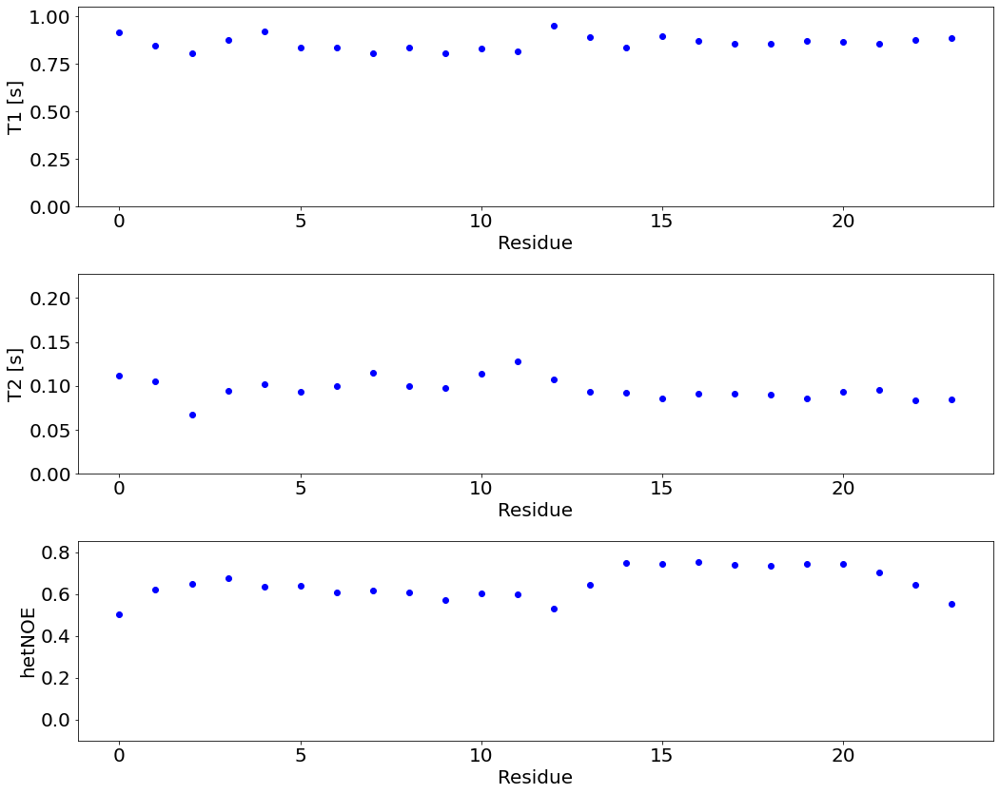

In [43]:
from heapq import heappush, heappop
plt.rcParams["figure.figsize"] = [15.00, 12]
plt.rcParams["figure.autolayout"] = True

fig, (ax1, ax2, ax3) = plt.subplots(3)


#ax1.grid()
ax1.set_ylabel("T1 [s]")
ax1.set_xlabel("Residue")
ax2.set_ylabel("T2 [s]")
ax2.set_xlabel("Residue")
ax3.set_ylabel("hetNOE")
ax3.set_xlabel("Residue")
max_T1=0
max_T2=0
max_noe=0
min_noe=0

relax_data={}


for i in aminoAcids:
    relax_data[i]={}
    relax_data[i]["T1"]=aminoAcids[i].T1
    relax_data[i]["T2"]=aminoAcids[i].T2
    relax_data[i]["hetNOE"]=aminoAcids[i].NOE
    
    ax1.plot(i,aminoAcids[i].T1,"o",color="blue")
    max_T1=max(max_T1,aminoAcids[i].T1)

    ax2.plot(i,aminoAcids[i].T2,"o",color="blue")
    max_T2=max(max_T2,aminoAcids[i].T2)

    ax3.plot(i,aminoAcids[i].NOE,"o",color="blue")
    max_noe=max(max_noe,aminoAcids[i].NOE)
    min_noe=min(min_noe,aminoAcids[i].NOE)
    
ax1.set_ylim([0,max_T1+0.1 ])
ax2.set_ylim([0,max_T2+0.1 ])
ax3.set_ylim([min_noe-0.1,max_noe+0.1 ])

plt.show()

<center><h1>Spin relaxation times as a function of field and dynamics</h1></center>

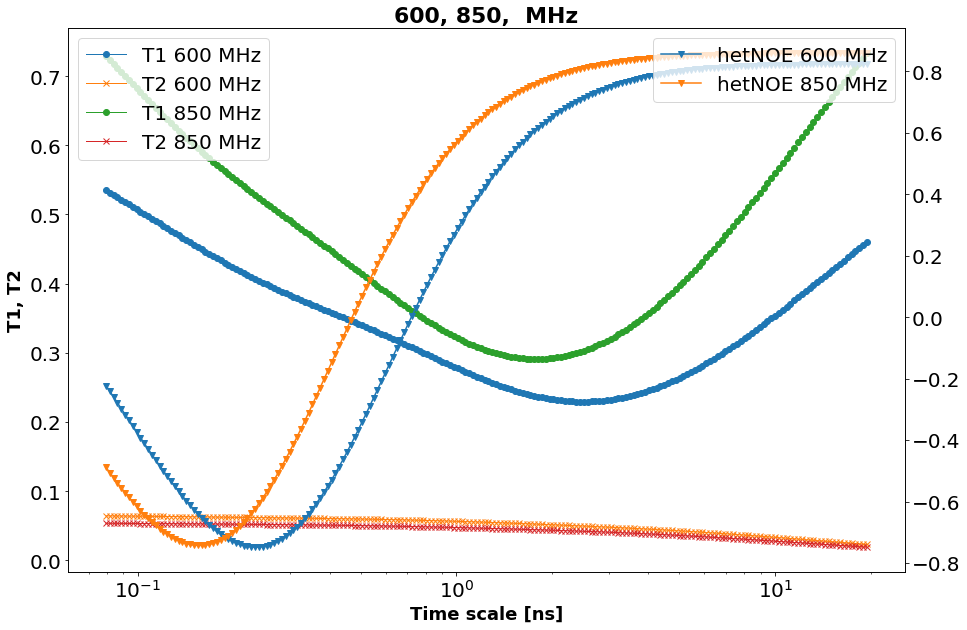

In [260]:
#plot relaxation times as a function of dynamics and magnetic field, only 2D plot, atm
magnetic_fields=[600,850]


smallest_corr_time=1.9 # enter in log scale -3 fs; 0 ps; 3 ns; 6 us;
biggest_corr_time=4.3 # same as above
N_exp_to_fit=200 # number of exponential functions to be fitted between the samlles and biggest corr time

step_exp=(biggest_corr_time-smallest_corr_time)/N_exp_to_fit
Ctimes = 10 ** np.arange(smallest_corr_time, biggest_corr_time, step_exp)
Ctimes = Ctimes * 0.001 * 10 ** (-9);

fig,ax = plt.subplots(figsize=(15, 10))
ax.set_xlabel("Time scale [ns]",fontsize=18, weight = 'bold')
ax.set_ylabel("T1, T2",fontsize=18, weight = 'bold')
ax.set_xscale('log')
ax2.set_ylabel("hetNOE",fontsize=18, weight = 'bold')
ax2.set_xscale('log')
ax2=ax.twinx()

title=""
for magn_field in magnetic_fields:
    magnetic_field=magn_field*2*np.pi/gammaH*10**6
    
    T1=[]
    T2=[]
    NOE=[]
    for time_scale in Ctimes:
        t1, t2, noe = rt.get_relaxation_N(magnetic_field,[1,1],[time_scale,10**-8],OP)
        T1.append(t1)
        T2.append(t2)
        NOE.append(noe)
        
    
    ax.plot(Ctimes*10**9,T1,label="T1 " + str(magn_field)+ " MHz",  marker="o", linewidth=1.0)
    ax.plot(Ctimes*10**9,T2,label="T2 " + str(magn_field)+ " MHz",   marker="x", linewidth=1.0)
    
    
    ax2.plot(Ctimes*10**9,NOE,label="hetNOE " + str(magn_field)+ " MHz",marker="v")
    title+= str(magn_field) + ", "
    

ax.set_title(str(title)+ " MHz",fontsize=22, weight = 'bold')
ax2.legend(loc='upper right')

ax.legend(loc='upper left')
plt.show()

In [22]:
directory = os.getcwd()

print(directory)

/home/local/nenciric/Documents/git/CorysPeptides/relaxation_times_micelles_replicas


In [1]:
import matplotlib.pyplot as plt
import sys
import os
import yaml
import numpy as np
sys.path.append('/home/local/nenciric/Documents/git/COR15A_Tobi/Analysis')
import ExperimentalRelaxationTimes as ERT
import matplotlib.patches as patches

In [18]:
name="hMff_DSDS_first_samples"
#field="600MHz"
field="850MHz"
#exp="T1"
exp="T2"
#exp="hetNOE"
expID="120"
author=["Ricky Nencini",  "ricky.nencini@helsinki.fi"]
path="/home/nenciric/Documents/git/CorysPeptides/experimental_data/850MHz/hMff_DSDS_first_samples/T2/120/DynamicCenter/"
info="hMff_DSDS_first_samples, experiment 120"
output="/home/nenciric/Documents/git/CorysPeptides/experimental_data/experiments.yaml"
prefix="T2_hMff_SDS_"
increments=300
#correct=[650.01349+10.72545,525.72467+135.0325] # correction for wrong offset of ppm, should be (0,0) if processing done correctly 
correct=[0,0]
coeffs=[] # different LP options processed at TopSpin
outputs=[]

experiments=ERT.add_exp_data(output,field,name,exp,expID,author,path,prefix,info,increments,correct,coeffs,outputs)


600 Mhz experiments: 


 
850 Mhz experiments:

hMff_DSDS_first_samples: 
 T1: 114, 
T2: 120, 



In [168]:
field="850MHz"

experiment="hMff_DSDS_first_samples"
relax="T2" # T1/T2
expID="120"

In [169]:
save_dest="/home/local/nenciric/Documents/git/CorysPeptides/experimental_data/yamls/"
save_dest=save_dest+experiment+"_"+relax+"_"+expID+"_"+field+".yaml"


path=experiments[field][experiment][relax][expID]["PATH"]
author=experiments[field][experiment][relax][expID]["AUTHOR"]
info=experiments[field][experiment][relax][expID]["INFO"]
prefix=experiments[field][experiment][relax][expID]["PREFIX"]
coeffs=experiments[field][experiment][relax][expID]["COEFF"]
outputs=experiments[field][experiment][relax][expID]["OUTPUTS"]
increments=experiments[field][experiment][relax][expID]["INCREMENTS"]
correct=experiments[field][experiment][relax][expID]["CORRECT"]

In [179]:
skip_points=1 # number of poits to be alway skipped for exponential fitting, stil checks if points after this
              # value are decreasing, so far seems fine to set to 0 for T1, 
              # but may be neccesary to set to 1 or 2 for T2 - DOES NOT SEEM TO BE IMPLEMENTED :(

Nfactor=6
maxDist = 0.25 # to be tuned 

reanalyze=False # analyze again even if analysis was already done before 
                # - rewrites all the hand made changes and other changes

In [180]:
if os.path.isfile(save_dest) and not reanalyze:
    with open(save_dest) as yaml_file:
        results= yaml.load(yaml_file,Loader=yaml.FullLoader)
        
    #comparison=ERT.compare_spectra(Nfactor,maxDist,*results)
    
else:
    print("Analyzing...")
    data_from_DynamicCenter=prefix+str(increments)+"incr_no_0coeff_0output.txt"
    data_from_DynamicCenter=path+data_from_DynamicCenter

    results=[ERT.t1_t2_relaxations(data_from_DynamicCenter,field,0,0,author,info,increments,skip_points,correct)]
    results.append(ERT.t1_t2_relaxations(data_from_DynamicCenter,field,0,0,author,info,increments,skip_points,correct))
    for coeff in coeffs:
        for outputP in outputs:
            data_from_DynamicCenter=prefix+str(increments)+"incr_no_"+str(coeff)+"coeff_"+str(outputP)+"output.txt"
            data_from_DynamicCenter=path+data_from_DynamicCenter
            results.append(ERT.t1_t2_relaxations(data_from_DynamicCenter,field,coeff,outputP,author,info,increments,skip_points,correct))

    comparison=ERT.compare_spectra(Nfactor,maxDist,*results)


    with open(save_dest, 'w') as f:
        yaml.dump(results,f, sort_keys=False)

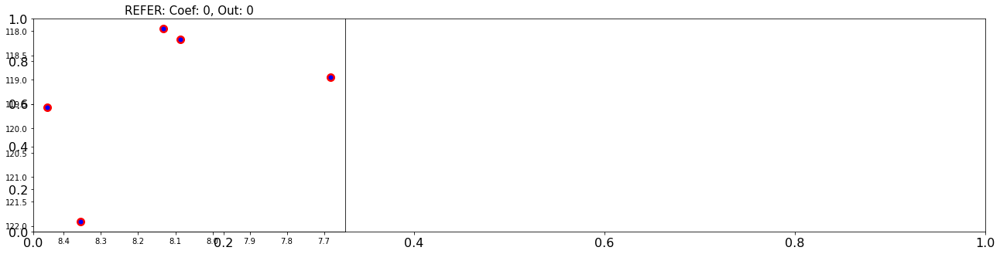

In [83]:
ERT.check_grouping_for_LP_t1t2(outputs,coeffs,comparison)

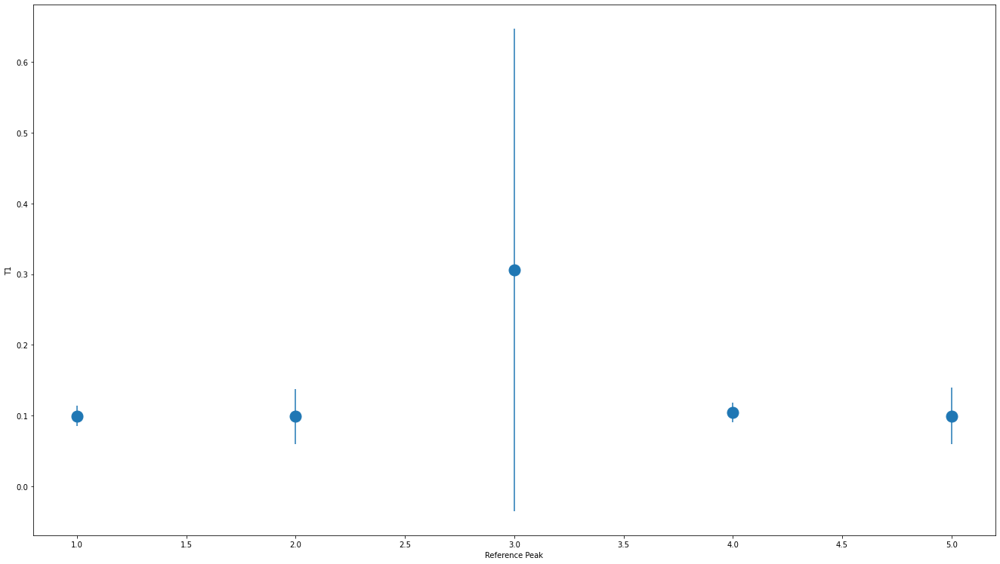

In [172]:
highlight=[0,0] # analysis to be highlited in the plot [COEFFICIENTS,OUTPUT_POINTS], 
                # ([0, 0] - no linear prediction, row data used)
ERT.plot_data(comparison,coeffs,outputs,highlight)

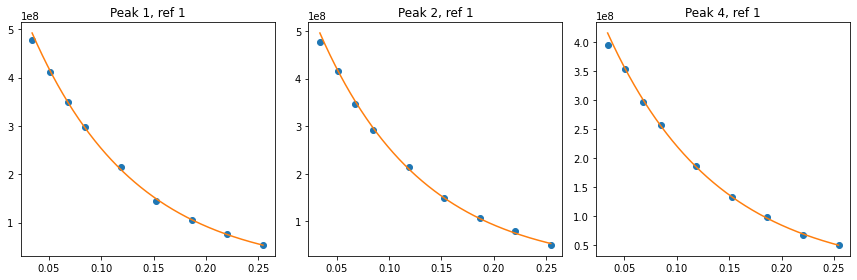

In [185]:
ERT.plot_fit_of_peaks(highlight,comparison,results[0])

In [181]:
for peak in results[0]["peaks"]:
    results[0]["peaks"][peak]["T2"]=float(-1/results[0]['peaks'][peak]["fit"][0][0])
    results[0]["peaks"][peak]["error"]=float(np.sqrt(float(results[0]['peaks'][peak]["fit"][1][0])/(int(len(results[0]['peaks'][peak]["points_used"][0]))-1)))
    
with open(save_dest,"w") as f:
    yaml.dump(results,f,sort_keys=False)

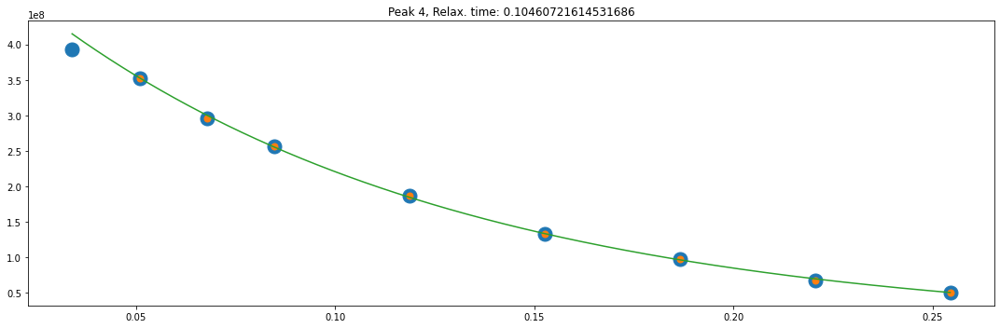

Use different points? Y/N
Y
Type points to be used, indexing from 0, end by END.
Another point?1
Another point?2
Another point?3
Another point?4
Another point?5
Another point?6
Another point?7
Another point?8
Another point?END


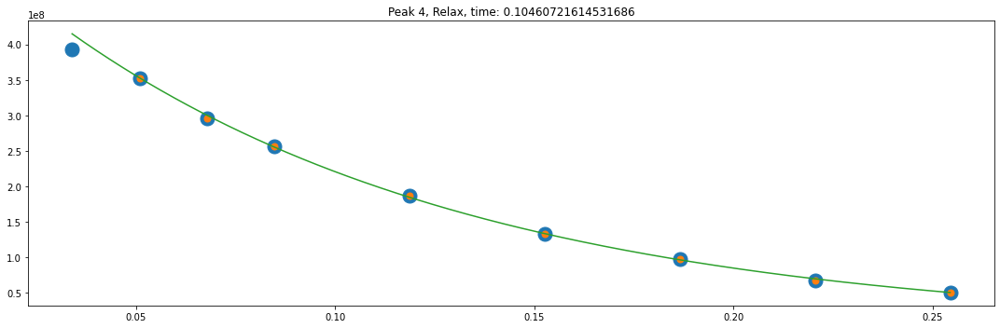

Use different points? Y/N
N


In [178]:
res=results[0]

#for peak in res["peaks"]:
#    ERT.analyze_single_peak(highlight,peak,save_dest,*results)
peak="4"
ERT.analyze_single_peak(highlight,peak,save_dest,results[0])
#comparison=ERT.compare_spectra(Nfactor,maxDist,*results)

0.09941135209687894  +-  0.014750088555469876
0.09878588837294784  +-  0.03878195823866983
0.10460721614531686  +-  0.013802166036750775


<Figure size 1332x756 with 0 Axes>

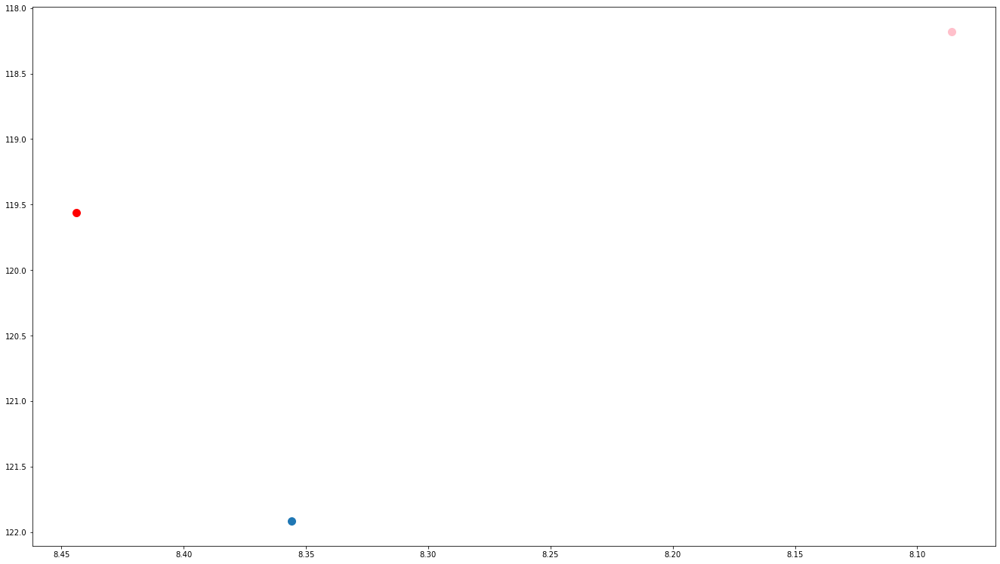

In [184]:
fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)
plt.rcParams["figure.figsize"] = [18.50, 10.50]
plt.rcParams["figure.autolayout"] = True
graph, (plot1) = plt.subplots(1, 1, figsize=(18.5, 10.5))
plot1.invert_xaxis()
plot1.invert_yaxis()
for peak in results[0]["peaks"]:
    print(float(-1/results[0]['peaks'][peak]["fit"][0][0])," +- ", np.sqrt(float(results[0]['peaks'][peak]["fit"][1][0])/(int(len(results[0]['peaks'][peak]["points_used"][0]))-1)))
    if peak=="1":
        plot1.plot(float(results[0]['peaks'][peak]["ppm"][1]),float(results[0]['peaks'][peak]["ppm"][0]),"o",markersize=10)
    if peak=="2":
        plot1.plot(float(results[0]['peaks'][peak]["ppm"][1]),float(results[0]['peaks'][peak]["ppm"][0]),"o",markersize=10,color="red")
    if peak=="3":
        plot1.plot(float(results[0]['peaks'][peak]["ppm"][1]),float(results[0]['peaks'][peak]["ppm"][0]),"o",markersize=10,color="green")
    if peak=="4":
        plot1.plot(float(results[0]['peaks'][peak]["ppm"][1]),float(results[0]['peaks'][peak]["ppm"][0]),"o",markersize=10,color="pink")
    if peak=="5":
        plot1.plot(float(results[0]['peaks'][peak]["ppm"][1]),float(results[0]['peaks'][peak]["ppm"][0]),"o",markersize=10,color="cyan")
          

In [5]:
name="hMff_DSDS_first_samples"
#field="600 MHz"
field="850MHz"
#exp="T1"
#exp="T2"
exp="hetNOE"
author=["Ricky Nencini",  "ricky.nencini@helsinki.fi"]
path="/home/nenciric/Documents/git/CorysPeptides/experimental_data/850MHz/hMff_DSDS_first_samples/hetNOE/220/"
info="hMff_DSDS_first_samples, experiment 220"
output="/home/nenciric/Documents/git/CorysPeptides/experimental_data/experiments.yaml"
exp_list=output
increments=256
expID="220"
correct=[0,0] # correction for wrong offset of ppm, should be (0,0) if processing done correctly 

coeffs=[0] # different LP options processed at TopSpin
outputs=[0]
imageDim=None
image=None

files=["hetNOE_hMff_SDS_256ncr_no_0coeff_0output_10220.txt","hetNOE_hMff_SDS_256ncr_no_0coeff_0output_10221.txt"]

experiments=ERT.add_noe_data(output,field,name,exp,author,path,files,info,increments,correct,coeffs,outputs,image,imageDim)

600 Mhz experiments: 


 
850 Mhz experiments:

hMff_DSDS_first_samples - T1, T2, hetNOE, 


In [6]:
field="850MHz"
experiment="hMff_DSDS_first_samples"

In [7]:
relax="hetNOE"
save_dest="/home/local/nenciric/Documents/git/CorysPeptides/experimental_data/yamls/"
save_dest=save_dest+experiment+"_"+relax+"_"+expID+"_"+field+".yaml"

<Figure size 1332x756 with 0 Axes>

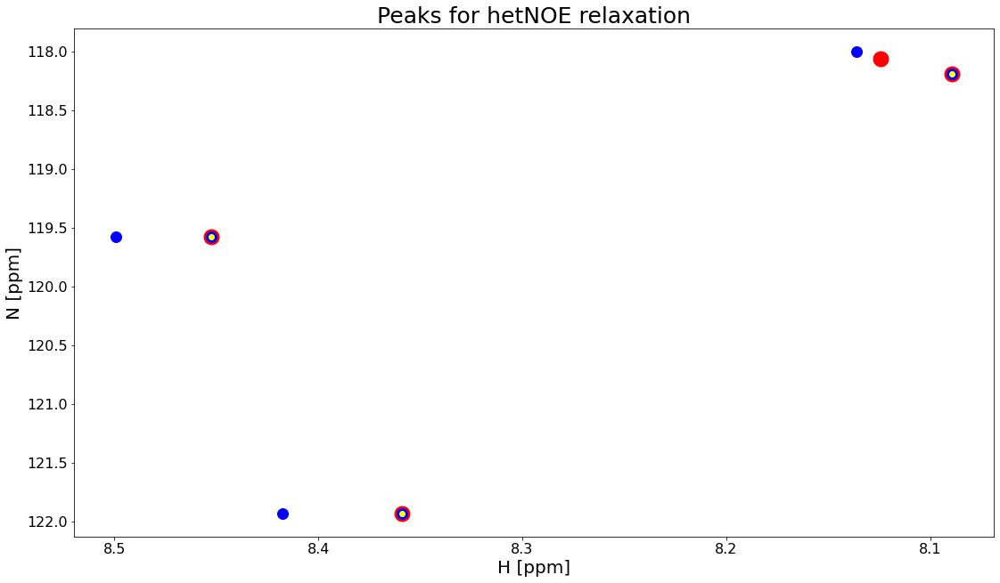

In [9]:
################################################
""" hetNOE analysis of WT COR15A from 600 MHz"""
################################################


Nfactor=6
maxDist = 0.15 # to be tuned that the yellow peaks in the spectra below make sense 

hetNoe, peaks1, peaks2 =ERT.process_hetNoe(exp_list,experiment,field,Nfactor,maxDist) ##  Nfactor is used to weight the N dimention 
                                                         #   with respect to H dimention. Values in literature
                                                         #   range between 0.1 and 0.45"""

"""If satisfied, save the data"""
with open(save_dest, 'w') as f:
    yaml.dump(hetNoe,f, sort_keys=False)

In [73]:
n=7+8
size = (1+2**8) * [0]
path = (1+2**8) * [0]
result = 0
for i in range(n, 0, -1):
    size[i] = 1 + size[2*i] + size[2*i+1]

In [75]:
for i in range(1, n+1):
    path[i] = 1 + path[i//2]

In [12]:
def count(n):
    result=0
    power=0
    for i in range(n):
        while i>2**(power)-1:
            power+=1
        result+=power-1
    
    return result
    # TODO

if __name__ == "__main__":
    print(count(4)) # 4
    print(count(7)) # 10
    print(count(123)) # 618
    print(count(999999999)) # 27926258178

1
7
611


KeyboardInterrupt: 

In [29]:
from heapq import heappush, heappop
from collections import deque

def count(a, b):
    b.sort()
    b=deque(b)
    lukuvalia = []

    for i in a:
        heappush(lukuvalia,(i[0],i[1]))
        
    get=deque()
    get_one=heappop(lukuvalia)
    while get_one[0]<=b[0]<=get_one[1]:
        try:
            get.append(get_one)
            get_one=heappop(lukuvalia)
        except:
            break
    return get
    # TODO

if __name__ == "__main__":
    print(count([(4,6)], [1, 7])) # 0
    print(count([(2,9), (1,8)], [5])) # 1
    print(count([(1,5), (6,8)], [5, 2])) # 1
    print(count([(6,6), (3,8), (2,5)], [4, 6, 5])) # 3
    print(count([(4,7), (2,6), (8,9), (1,10)], [11, 3, 8, 2, 6])) # 4
    print(count([(4,7), (2,6), (8,9), (5,7)], [11, 3, 8, 2, 6])) # 3

deque([])
deque([(1, 8), (2, 9)])
deque([(1, 5)])
deque([(2, 5), (3, 8)])
deque([(1, 10), (2, 6)])
deque([(2, 6)])
